# Define

In [1]:
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
import pandas as pd
import healpy as hp
from scipy.io import FortranFile as ff
from scipy.ndimage import gaussian_filter
import scipy
from astropy.utils.data import get_pkg_data_filename
from astropy.io import fits 
import pandas as pd
from scipy import interpolate
import corner
from scipy import stats
from ipywidgets import IntProgress
from IPython.display import display
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LinearSegmentedColormap

from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from matplotlib.colors import LogNorm
import matplotlib.patches as patches
from regions import PixCoord, CircleSkyRegion, CirclePixelRegion, RectangleSkyRegion, RectanglePixelRegion
import photutils
from photutils import CircularAperture, CircularAnnulus
from skimage.feature import peak_local_max
from skimage import data, img_as_float
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset


cFS = '#0047AB'
cnoFS ='#FF8C00' #(255./255.,140./255.,0/255.,1)

colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)



from matplotlib import rcParams
plt.rcParams["text.usetex"] = 'True'
rcParams['font.family'] = 'serif'
rcParams['font.serif'] = 'Times'
# rcParams['font.serif'] = ['Bitstream Vera Sans']
# rcParams['font.weight'] = 'bold'
plt.rcParams["xtick.direction"] = "in"
plt.rcParams["ytick.direction"] = "in"
plt.rcParams["xtick.minor.visible"] = "True"
plt.rcParams["ytick.minor.visible"] = "True"
plt.rc('font', size=15) 
plt.rc('text.latex', preamble=r'\usepackage{amsmath,newtxmath}')

# rcParams.keys() 

In [2]:
def measureEWabs(lam, vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)     
    if(np.sum(errA) == 0):
        fluxA[fluxA>1.0]=1.0
        EW = scipy.integrate.simps(fluxA[valid]-1, x = lam[valid])
        EWstd = 0
    else:
        mes = np.zeros(1000)
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            modFlux[modFlux>1] = 1
            modFlux[modFlux<0] = 0
            mes[i] =  scipy.integrate.simps(modFlux-1, x = lam[valid])
        EW = np.median(mes)
        EWstd = np.std(mes)
    return [EW, EWstd]

def measureEWemi(lam, vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)     
    if(np.sum(errA) == 0):
        fluxA[fluxA<1]=1
        EW = scipy.integrate.simps(fluxA[valid]-1, x = lam[valid])
        EWstd = 0
    else:
        mes = np.zeros(1000)
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            modFlux[modFlux<1] = 1
            mes[i] =  scipy.integrate.simps(modFlux-1, x = lam[valid])
        EW = np.median(mes)
        EWstd = np.std(mes)
    return [EW, EWstd]

def measureMinVel(vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)     
    if(np.sum(errA) == 0):
        modFlux = gaussian_filter(fluxA[valid], sigma = 0.)
        V = vel[valid][modFlux == np.min(modFlux)][0]
        Vstd = 0
        Fmin =  np.min(modFlux[(vel[valid]>=V-20) & (vel[valid] <=V+20)])
        Fstd = 0
    else:
        mes = np.zeros(1000)
        mes2 = np.zeros(1000)
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            mes[i] =  vel[valid][modFlux == np.min(modFlux)][0]
            mes2[i] =  np.median(modFlux[(vel[valid]>=mes[i]-20) & (vel[valid] <=mes[i]+20)])
        V = np.median(mes)
        Vstd = np.std(mes)        
        Fstd = np.std(mes2)
        Fmin = np.median(mes2)
    return [V, Vstd, Fmin, Fstd]

def measureMaxVel(vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)     
    if(np.sum(errA) == 0):
        modFlux = gaussian_filter(fluxA[valid], sigma = 0.)
        V = vel[valid][modFlux == np.max(modFlux)][0]
        Vstd = 0
        Fmin = np.max(modFlux)
        Fstd = 0
    else:
        mes = np.zeros(1000)
        mes2 = np.zeros(1000)
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            mes[i] =  vel[valid][modFlux == np.max(modFlux)][0]
            mes2[i] = np.median(modFlux[(vel[valid]>= mes[i]-20) & (vel[valid] <= mes[i]+20)])
        V = np.median(mes)
        Vstd = np.std(mes)        
        Fstd = np.std(mes2)
        Fmin = np.median(mes2)  
    return [V, Vstd, Fmin, Fstd]

def measureCenV(vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)  
    vel2= vel[valid]
    if(np.sum(errA) == 0): 
        modFlux = gaussian_filter(1-fluxA[valid], sigma = 0.)
        modFlux[modFlux<= 0] = 0
        vcen = vel2[np.cumsum(modFlux)>= 0.5*np.max(np.cumsum(modFlux))][0]
        vstd = 0
    else:
        mes = np.zeros(1000)
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            modFlux = 1 - modFlux
            modFlux[modFlux<= 0] = 0
            mes[i] =  vel2[np.cumsum(modFlux)>= 0.5*np.max(np.cumsum(modFlux))][0]
        vcen = np.median(mes)
        vstd = np.std(mes)        
    return [vcen, vstd]

In [3]:
galaxy = ['J0021_0052','J0036_3333','J0127_0619','J0144_0453','J0337_0502','J0405_3648','J0808_3948',
          'J0823_2806','J0926_4427','J0934_5514','J0938_5428','J0940_2935','J0942_3547','J0944_0038',
          'J0944_3442','J1016_3754','J1024_0524','J1025_3622','J1044_0353','J1105_4444','J1112_5503',
          'J1119_5130','J1129_2034','J1132_1411','J1132_5722','J1144_4012','J1148_2546','J1150_1501',
          'J1157_3220','J1200_1343','J1225_6109','J1253_0312','J1314_3452','J1323_0132','J1359_5726',
          'J1416_1223','J1418_2102','J1428_1653','J1429_0643','J1444_4237','J1448_0110','J1521_0759',
          'J1525_0757','J1545_0858','J1612_0817']

label  = ['j0021+0052','j0036-3333','j0127-0619','j0144+0453','j0337-0502','j0405-3648','j0808+3948',
          'j0823+2806','j0926+4427','j0934+5514','j0938+5428','j0940+2935','j0942+3547','j0944-0038',
          'j0944+3442','j1016+3754','j1024+0524','j1025+3622','j1044+0353','j1105+4444','j1112+5503',
          'j1119+5130','j1129+2034','j1132+1411','j1132+5722','j1144+4012','j1148+2546','j1150+1501',
          'j1157+3220','j1200+1343','j1225+6109','j1253-0312','j1314+3452','j1323-0132','j1359+5726',
          'j1416+1223','j1418+2102','j1428+1653','j1429+0643','j1444+4237','j1448-0110','j1521+0759',
          'j1525+0757','j1545+0858','j1612+0817']

z = np.array([0.098393,0.020598,0.005400,0.005200,0.013520,0.002800,0.091230,
              0.047223,0.180667,0.002500,0.102102,0.001675,0.014857,0.004776,
              0.020046,0.003879,0.033191,0.126500,0.012870,0.021540,0.131635,
              0.004458,0.004703,0.017637,0.005041,0.126947,0.045117,0.002448,
              0.010970,0.066750,0.002341,0.022723,0.002885,0.022464,0.033829,
              0.123156,0.008550,0.181666,0.173502,0.002300,0.027412,0.094261,
              0.075791,0.037724,0.149143])

df = pd.read_csv('../Classy/AnalysisClassy.csv')
res   =  df['resol'].values
MstarAp   =  df['MstarAper'].values
MstarTot  =  df['MstarTot'].values
SFRAp  =  df['SFRAper'].values
SFRTot  =  df['SFRTot'].values
aperSize = df['aper'].values
fractAp = df['fr50aper'].values
EWLya = df['EWtotLya'].values

h_cgs     = 6.6260755e-27  # [erg s]
c_cgs     = 2.99792458e10  # [cm/s]
c = 299792.458

cu_to_cm  = 0.218526280953331e26
cu_to_pc  = cu_to_cm/3.086e18

classy = pd.read_csv('../Classy/AnalysisClassy.csv')
ClassFluo =  pd.read_csv('csv/Classy_Fluo.csv')

offsiIIfluo1265 = ((1265.002-1260.42)/1260.42*c)
offcIIfluo1335 = ((1335.708-1334.5322)/1334.532*c)
wcII1334  = 1334.532
wsiII1260 = 1260.42
wLya = 1215.67

maskInc = (classy['EWSiII1260']<-2)  | (classy['EWCII334']<-2) |(classy['VminSiII1260']<-400) | (classy['VminCII334']<-400)
maskGal = classy['Galaxy'][maskInc].values

nGal = len(galaxy)
mask_all = []

for i in range(nGal):
    spec = '../Classy/%s/hlsp_classy_hst_cos_%s_multi_v1_coadded.fits'%(galaxy[i].replace("_", ""), label[i])
    gal   = fits.open(spec)
    HRB   = gal[10].data # Rest-frame, galactic extinction-corrected, co-added, binned high-resolution spectrum 
    mask  = HRB['MASK'].astype('bool')

    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']#[mask]
    flux   = data['flux']#[mask]
    fit    = gaussian_filter(data['fit'], sigma = 10)#[mask]
    fitori = gaussian_filter(data['fit'], sigma = 0)#[mask]
    err    = data['err']
    absflux = gaussian_filter(flux/fit,sigma = 0)

    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

    if label[i] == 'j0337-0502' :
        mask = mask | (abs(vcIId)<1000) | (abs(vsiIId) < 600)
        mask_all.append(mask)
    elif label[i] == 'j0405-3648':
        mask = mask & ~((vcIId < -500) & (vcIId > -1000)) & ~((vsiIId < -500) & (vsiIId > -1000))
        mask_all.append(mask)
    elif label[i] == 'j0823+2806':
        mask = mask | (abs(vsiIId) < 2000)
        mask_all.append(mask)
    elif label[i] == 'j0934+5514':
        mask = mask & ~((vcIId < -300) & (vcIId > -2000)) & ~((vsiIId < -300) & (vsiIId > -2000))
        mask_all.append(mask)
    elif label[i] == 'j0940+2935':
        mask = mask & ~((vcIId < -300) & (vcIId > -1200)) & ~((vsiIId < -300) & (vsiIId > -1200))
        mask_all.append(mask)
    elif label[i] == 'j0942+3547':
        mask = mask | (abs(vcIId)<1000) 
        mask_all.append(mask)
    elif label[i] == 'j0944+3442':
        mask = mask & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)
    elif label[i] ==  'j1016+3754':
        mask = mask & ~((vcIId < -600) & (vcIId > -1000))
        mask_all.append(mask)       
    elif label[i] == 'j1024+0524':
        mask = mask | (vsiIId < 300) | (vsiIId>700) 
        mask_all.append(mask)     
    elif label[i] == 'j1044+0353':
        mask = (mask | (vcIId < 1000)) & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)   
    elif label[i] == 'j1105+4444':
        mask = mask & ~((abs(vcIId)< 1500))
        mask_all.append(mask)    
    elif label[i] == 'j1132+1411':
        mask = mask | (vcIId < 00) 
        mask_all.append(mask)         
    elif label[i] == 'j1148+2546':
        mask = (mask & ~((abs(vcIId)< 1500))) | (abs(vsiIId) < 300) 
        mask_all.append(mask)  
    elif label[i] == 'j1157+3220':
        mask = mask & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)   
    elif label[i] == 'j1314+3452':
        mask = mask & ~((vcIId < -400) & (vcIId > -1000))
        mask_all.append(mask)   
    elif label[i] == 'j1359+5726':
        mask = mask & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)    
    elif label[i] == 'j1525+0757':
        mask = mask | ((abs(vsiIId)< 2000))
        mask_all.append(mask)        
    elif label[i] == 'j1545+0858':
        mask = mask | (vsiIId >-300) 
        mask_all.append(mask)      
    else:
        mask_all.append(mask)
        
        
    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-800) & (vsiIId<2000) 

    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]
    if(i == 4):
        absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
print(classy['Galaxy'][maskInc])

6     J0808+3948
7     J0823+2806
20    J1112+5503
25    J1144+4012
35    J1416+1223
42    J1525+0757
44    J1612+0817
Name: Galaxy, dtype: object


In [4]:
def read_file(Dir,FileName,ndir):
    f = ff('%s/%s_spectrum'%(Dir,FileName))
    n = f.read_ints()[0]
    aperture,lmin,lmax = f.read_reals('d')
    spec = np.zeros((ndir,n))
    spec[0,:] = f.read_reals('d')
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        spec[j,:] = f.read_reals('d')
    f.close()

    return lmin,lmax,n,spec

# To get the spectra, in the appropriate units
def read_spectrum_si(path_to_data, halo):
    f = ff('%s/%s/SiII_SMC/spectra_SiII_1260/IC_photons_%i_nphots'%(path_to_data,str(halo).zfill(5),
                                                                          1000000))
    a = f.read_ints()
    lum_per_packet = f.read_reals()
    f.close()
    lum_per_packet = lum_per_packet/a
    lmin,lmax,npix,phot_packets = \
        read_file('%s/%s/SiII_SMC/spectra_SiII_1260/'%(path_to_data,str(halo).zfill(5)),'output.out',ndirections)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux


def read_spectrum_c(path_to_data,halo):
    f = ff('%s/%s/CII_SMC/spectra_CII_1334/IC_photons_%i_nphots'%(path_to_data,str(halo).zfill(5),
                                                                          1000000))
    a = f.read_ints()
    lum_per_packet = f.read_reals()
    f.close()
    lum_per_packet = lum_per_packet/a
    lmin,lmax,npix,phot_packets = \
        read_file('%s/%s/CII_SMC/spectra_CII_1334/'%(path_to_data,str(halo).zfill(5)),'output.out',ndirections)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux


def read_cube(path,ndir):
    
    f = ff('%s/output.out_cube'%path,'r')
    nlbda,nxy = f.read_ints()
    lmin,lmax,imsize = f.read_reals('d')
    center = f.read_reals('d')
    cube = np.zeros((ndir,nxy,nxy,nlbda))
    cube1 = f.read_reals('d')
    cube[0] = cube1.reshape(nxy,nxy,nlbda)
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        f.read_reals('d')
        cube1 = f.read_reals('d')
        cube[j] = cube1.reshape((nxy,nxy,nlbda))
    f.close()
    
    f = ff('%s/IC_photons_16000000_nphots'%path,'r')
    nphot = f.read_ints()[0]
    total_lum = f.read_reals()
    f.close()
    
    l = np.linspace(lmin,lmax,nlbda)
    
    cube = cube*total_lum/nphot
    cube = cube*h_cgs*c_cgs / (l*1e-8)
    cube = cube/((lmax-lmin)/nlbda)   

    return nxy,imsize*cu_to_pc,l,cube

ndirections = 300
directions = np.zeros((ndirections,3))
for i in range(ndirections):
    directions[i,:] = hp.pix2vec(5,i)

# Reading galaxy properties and line properties

## 3 time steps

In [ ]:
# Global escape fractions, between 10 and 910 A
path_to_data = 'dat_files/'
fesc_148 = np.genfromtxt('%s/fesc_148.txt'%path_to_data,unpack=True,usecols=0)
fesc_156 = np.genfromtxt('%s/fesc_156.txt'%path_to_data,unpack=True,usecols=0)
fesc_164 = np.genfromtxt('%s/fesc_164.txt'%path_to_data,unpack=True,usecols=0)

# Escape fraction averaged between 890 and 910 A
fesc_900_148 = np.genfromtxt('%s/fesc_148.txt'%path_to_data,unpack=True,usecols=1)
fesc_900_156 = np.genfromtxt('%s/fesc_156.txt'%path_to_data,unpack=True,usecols=1)
fesc_900_164 = np.genfromtxt('%s/fesc_164.txt'%path_to_data,unpack=True,usecols=1)

## Covering fraction of HI (see definition in Mauerhofer+21)
CF_HI_148 = np.genfromtxt('%s/CF_HI_tau1_148.dat'%path_to_data,unpack=True)
CF_HI_156 = np.genfromtxt('%s/CF_HI_tau1_156.dat'%path_to_data,unpack=True)
CF_HI_164 = np.genfromtxt('%s/CF_HI_tau1_164.dat'%path_to_data,unpack=True)

# Absolute magnitudes at 1500A (observed, meaning including the effect of dust, which depends on viewing angle)
M1500_148 = np.genfromtxt('%s/magnitudes_148.dat'%path_to_data,unpack=True,usecols=0)
M1500_156 = np.genfromtxt('%s/magnitudes_156.dat'%path_to_data,unpack=True,usecols=0)
M1500_164 = np.genfromtxt('%s/magnitudes_164.dat'%path_to_data,unpack=True,usecols=0)

# Intrinsic magnitudes, before the effec of dust. Does not depend on viewing angle
intrinsic_M1500_148 = -20.3113
intrinsic_M1500_156 = -19.796
intrinsic_M1500_164 = -20.030
intrinsic_M1500     = np.array([-20.3113,-19.796,-20.030])


## CII line properties
res_flux_CII_148,EW_abs_CII_148,EW_fluo_CII_148,v_max_CII_148,v_center_CII_148,v90_CII_148 = \
    np.genfromtxt('%s/line_properties_CII_148.dat'%path_to_data,unpack=True,skip_header=1)
res_flux_CII_156,EW_abs_CII_156,EW_fluo_CII_156,v_max_CII_156,v_center_CII_156,v90_CII_156 = \
    np.genfromtxt('%s/line_properties_CII_156.dat'%path_to_data,unpack=True,skip_header=1)
res_flux_CII_164,EW_abs_CII_164,EW_fluo_CII_164,v_max_CII_164,v_center_CII_164,v90_CII_164 = \
    np.genfromtxt('%s/line_properties_CII_164.dat'%path_to_data,unpack=True,skip_header=1)

# gathering the three snapshots
res_flux_CII = np.append(res_flux_CII_148,res_flux_CII_156)
res_flux_CII = np.append(res_flux_CII,res_flux_CII_164)
EW_abs_CII = np.append(EW_abs_CII_148,EW_abs_CII_156)
EW_abs_CII = np.append(EW_abs_CII,EW_abs_CII_164)
EW_fluo_CII = np.append(EW_fluo_CII_148,EW_fluo_CII_156)
EW_fluo_CII = np.append(EW_fluo_CII,EW_fluo_CII_164)
v_max_CII = np.append(v_max_CII_148,v_max_CII_156)
v_max_CII = np.append(v_max_CII,v_max_CII_164)
v_center_CII = np.append(v_center_CII_148,v_center_CII_156)
v_center_CII = np.append(v_center_CII,v_center_CII_164)
v90_CII = np.append(v90_CII_148,v90_CII_156)
v90_CII = np.append(v90_CII,v90_CII_164)


## SiII line properties
res_flux_SiII_148,EW_abs_SiII_148,EW_fluo_SiII_148,v_max_SiII_148,v_center_SiII_148,v90_SiII_148 = \
    np.genfromtxt('%s/line_properties_SiII_148.dat'%path_to_data,unpack=True,skip_header=1)
res_flux_SiII_156,EW_abs_SiII_156,EW_fluo_SiII_156,v_max_SiII_156,v_center_SiII_156,v90_SiII_156 = \
    np.genfromtxt('%s/line_properties_SiII_156.dat'%path_to_data,unpack=True,skip_header=1)
res_flux_SiII_164,EW_abs_SiII_164,EW_fluo_SiII_164,v_max_SiII_164,v_center_SiII_164,v90_SiII_164 = \
    np.genfromtxt('%s/line_properties_SiII_164.dat'%path_to_data,unpack=True,skip_header=1)

# gathering the three snapshots
res_flux_SiII = np.append(res_flux_SiII_148,res_flux_SiII_156)
res_flux_SiII = np.append(res_flux_SiII,res_flux_SiII_164)
EW_abs_SiII = np.append(EW_abs_SiII_148,EW_abs_SiII_156)
EW_abs_SiII = np.append(EW_abs_SiII,EW_abs_SiII_164)
EW_fluo_SiII = np.append(EW_fluo_SiII_148,EW_fluo_SiII_156)
EW_fluo_SiII = np.append(EW_fluo_SiII,EW_fluo_SiII_164)
v_max_SiII = np.append(v_max_SiII_148,v_max_SiII_156)
v_max_SiII = np.append(v_max_SiII,v_max_SiII_164)
v_center_SiII = np.append(v_center_SiII_148,v_center_SiII_156)
v_center_SiII = np.append(v_center_SiII,v_center_SiII_164)
v90_SiII = np.append(v90_SiII_148,v90_SiII_156)
v90_SiII = np.append(v90_SiII,v90_SiII_164)


## LyB line properties
res_flux_lyb_148,EW_abs_lyb_148,v_max_lyb_148,v_center_lyb_148,v90_lyb_148 = \
    np.genfromtxt('%s/line_properties_lyb_148.dat'%path_to_data,unpack=True,skip_header=1)
res_flux_lyb_156,EW_abs_lyb_156,v_max_lyb_156,v_center_lyb_156,v90_lyb_156 = \
    np.genfromtxt('%s/line_properties_lyb_156.dat'%path_to_data,unpack=True,skip_header=1)
res_flux_lyb_164,EW_abs_lyb_164,v_max_lyb_164,v_center_lyb_164,v90_lyb_164 = \
    np.genfromtxt('%s/line_properties_lyb_164.dat'%path_to_data,unpack=True,skip_header=1)

# Gathering the three snapshots
res_flux_lyb = np.append(res_flux_lyb_148,res_flux_lyb_156)
res_flux_lyb = np.append(res_flux_lyb,res_flux_lyb_164)
EW_abs_lyb = np.append(EW_abs_lyb_148,EW_abs_lyb_156)
EW_abs_lyb = np.append(EW_abs_lyb,EW_abs_lyb_164)
v_max_lyb = np.append(v_max_lyb_148,v_max_lyb_156)
v_max_lyb = np.append(v_max_lyb,v_max_lyb_164)
v_center_lyb = np.append(v_center_lyb_148,v_center_lyb_156)
v_center_lyb = np.append(v_center_lyb,v_center_lyb_164)
v90_lyb = np.append(v90_lyb_148,v90_lyb_156)
v90_lyb = np.append(v90_lyb,v90_lyb_164)





In [7]:
plt.scatter(CII148['EWemiLR'], fesc_900_148[:-1])
plt.scatter(CII156['EWemiLR'], fesc_900_156[:-1])
plt.scatter(CII164['EWemiLR'], fesc_900_164[:-1])

plt.figure()
plt.scatter(CII148['EWemiLR'], fesc_148[:-1])
plt.scatter(CII156['EWemiLR'], fesc_156[:-1])
plt.scatter(CII164['EWemiLR'], fesc_164[:-1])

plt.figure()
plt.scatter(CII148['EWemiLR'], EW_fluo_CII_148[:-1])
plt.scatter(CII156['EWemiLR'], EW_fluo_CII_156[:-1])
plt.scatter(CII164['EWemiLR'], EW_fluo_CII_164[:-1])

plt.figure()
plt.scatter(CII148['EWabsLR'], EW_abs_CII_148[:-1])
plt.scatter(CII156['EWabsLR'], EW_abs_CII_156[:-1])
plt.scatter(CII164['EWabsLR'], EW_abs_CII_164[:-1])

NameError: name 'CII148' is not defined

## 75 time steps

In [10]:
fescM = np.zeros(75)
fesc900M = np.zeros(75)
fesc = np.zeros((75,300))
fesc900 = np.zeros((75,300))

EWabsSiIIfs = np.zeros((75,300))
EWemiSiIIfs = np.zeros((75,300))
VabsSiIIfs = np.zeros((75,300))
VcenSiIIfs = np.zeros((75,300))
VemiSiIIfs = np.zeros((75,300))
RSiIIfs = np.zeros((75,300))
EWabsCIIfs = np.zeros((75,300))
EWemiCIIfs = np.zeros((75,300))
VabsCIIfs = np.zeros((75,300))
VcenCIIfs = np.zeros((75,300))
VemiCIIfs = np.zeros((75,300))
RCIIfs = np.zeros((75,300))

EWabsSiIInf = np.zeros((75,300))
EWemiSiIInf = np.zeros((75,300))
VabsSiIInf = np.zeros((75,300))
VcenSiIInf = np.zeros((75,300))
VemiSiIInf = np.zeros((75,300))
RSiIInf = np.zeros((75,300))
EWabsCIInf = np.zeros((75,300))
EWemiCIInf = np.zeros((75,300))
VabsCIInf = np.zeros((75,300))
VcenCIInf = np.zeros((75,300))
VemiCIInf = np.zeros((75,300))
RCIInf = np.zeros((75,300))

EWabsSiIIdu = np.zeros((75,300))
EWemiSiIIdu = np.zeros((75,300))
VabsSiIIdu = np.zeros((75,300))
VcenSiIIdu = np.zeros((75,300))
VemiSiIIdu = np.zeros((75,300))
RSiIIdu = np.zeros((75,300))
EWabsCIIdu = np.zeros((75,300))
EWemiCIIdu = np.zeros((75,300))
VabsCIIdu = np.zeros((75,300))
VcenCIIdu = np.zeros((75,300))
VemiCIIdu = np.zeros((75,300))
RCIIdu = np.zeros((75,300))


EWabsSiIIdep = np.zeros((75,300))
EWemiSiIIdep = np.zeros((75,300))
VabsSiIIdep = np.zeros((75,300))
VcenSiIIdep = np.zeros((75,300))
VemiSiIIdep = np.zeros((75,300))
RSiIIdep = np.zeros((75,300))
EWabsCIIdep = np.zeros((75,300))
EWemiCIIdep = np.zeros((75,300))
VabsCIIdep = np.zeros((75,300))
VcenCIIdep = np.zeros((75,300))
VemiCIIdep = np.zeros((75,300))
RCIIdep = np.zeros((75,300))


for i in range(75):
    f = pd.read_csv('dat_files/fesc/fesc_%d.txt'%int(i+90), delimiter = ' ', skiprows=1, header= None)
#     print(f)
    fesc[i,:]    = f[0]
    fesc900[i,:] = f[1]

    fescM[i] = np.round(np.mean(fesc[i,:]),4)
    fesc900M[i] = np.round(np.mean(fesc900[i,:]),4)
    
    EWSiII = pd.read_csv(f'CII_SiII_nofine/Measurements/SiII_%d_300.csv'%(i+90))
    EWCII = pd.read_csv(f'CII_SiII_nofine/Measurements/CII_%d_300.csv'%(i+90))
    
    EWabsSiIInf[i] = EWSiII['EWabsLR']
    EWemiSiIInf[i] = EWSiII['EWemiLR']
    VabsSiIInf[i]  = EWSiII['VabsLR']
    VcenSiIInf[i]  = EWSiII['VcenLR']
    VemiSiIInf[i]  = EWSiII['VemiLR']
    RSiIInf[i]     = EWSiII['RabsLR']
    EWabsCIInf[i]  = EWCII['EWabsLR']
    EWemiCIInf[i]  = EWCII['EWemiLR']
    VabsCIInf[i]   = EWCII['VabsLR']
    VcenCIInf[i]   = EWCII['VcenLR']
    VemiCIInf[i]   = EWCII['VemiLR']
    RCIInf[i]      = EWCII['RabsLR']
    
    EWSiII = pd.read_csv(f'CII_SiII_fine/Measurements/SiII_%d_300.csv'%(i+90))
    EWCII = pd.read_csv(f'CII_SiII_fine/Measurements/CII_%d_300.csv'%(i+90))
    
    EWabsSiIIfs[i] = EWSiII['EWabsLR']
    EWemiSiIIfs[i] = EWSiII['EWemiLR']
    VabsSiIIfs[i]  = EWSiII['VabsLR']
    VcenSiIIfs[i]  = EWSiII['VcenLR']
    VemiSiIIfs[i]  = EWSiII['VemiLR']
    RSiIIfs[i]     = EWSiII['RabsLR']
    EWabsCIIfs[i]  = EWCII['EWabsLR']
    EWemiCIIfs[i]  = EWCII['EWemiLR']
    VabsCIIfs[i]   = EWCII['VabsLR']
    VcenCIIfs[i]   = EWCII['VcenLR']
    VemiCIIfs[i]   = EWCII['VemiLR']
    RCIIfs[i]      = EWCII['RabsLR']
    
    EWSiII = pd.read_csv(f'CII_SiII_ND/Measurements/SiII_%d_300.csv'%(i+90))
    EWCII = pd.read_csv(f'CII_SiII_ND/Measurements/CII_%d_300.csv'%(i+90))
    
    EWabsSiIIdu[i] = EWSiII['EWabsLR']
    EWemiSiIIdu[i] = EWSiII['EWemiLR']
    VabsSiIIdu[i]  = EWSiII['VabsLR']
    VcenSiIIdu[i]  = EWSiII['VcenLR']
    VemiSiIIdu[i]  = EWSiII['VemiLR']
    RSiIIdu[i]     = EWSiII['RabsLR']
    EWabsCIIdu[i]  = EWCII['EWabsLR']
    EWemiCIIdu[i]  = EWCII['EWemiLR']
    VabsCIIdu[i]   = EWCII['VabsLR']
    VcenCIIdu[i]   = EWCII['VcenLR']
    VemiCIIdu[i]   = EWCII['VemiLR']
    RCIIdu[i]      = EWCII['RabsLR']
    
    EWSiII = pd.read_csv(f'CII_SiII_depletion/Measurements/SiII_%d_300.csv'%(i+90))
    EWCII = pd.read_csv(f'CII_SiII_depletion/Measurements/CII_%d_300.csv'%(i+90))
    
    EWabsSiIIdep[i] = EWSiII['EWabsLR']
    EWemiSiIIdep[i] = EWSiII['EWemiLR']
    VabsSiIIdep[i]  = EWSiII['VabsLR']
    VcenSiIIdep[i]  = EWSiII['VcenLR']
    VemiSiIIdep[i]  = EWSiII['VemiLR']
    RSiIIdep[i]     = EWSiII['RabsLR']
    EWabsCIIdep[i]  = EWCII['EWabsLR']
    EWemiCIIdep[i]  = EWCII['EWemiLR']
    VabsCIIdep[i]   = EWCII['VabsLR']
    VcenCIIdep[i]   = EWCII['VcenLR']
    VemiCIIdep[i]   = EWCII['VemiLR']
    RCIIdep[i]      = EWCII['RabsLR']
#     print(fescM, fesc900M
# print(VcenSiIInf)
Mgas = np.zeros(75)
f = pd.read_csv('dat_files/Mgas.dat', delimiter = ' ', header= None)
Mgas = f[3][f[0]>=90].values

Mhalo = np.zeros(75)
f = pd.read_csv('dat_files/Mhalo.dat', delimiter = ' ', header= None)
Mhalo = f[1][f[0]>=90].values

Mstar = np.zeros(75)
f = pd.read_csv('dat_files/Mstar.dat', delimiter = ' ', header= None)
Mstar = f[3][f[0]>=90].values
# print(Mstar)
Zgas = np.zeros(75)
f = pd.read_csv('dat_files/Zgas.dat', delimiter = ' ', header= None)
Zgas = f[3][f[0]>=90].values

Zstar = np.zeros(75)
f = pd.read_csv('dat_files/Zstar.dat', delimiter = ' ', header= None)
Zstar = f[3][f[0]>=90].values

SFR10 = np.zeros(75)
f = pd.read_csv('dat_files/SFR_10.dat', delimiter = ' ', header= None)
SFR10 = f[3][f[0]>=90].values

SFR100 = np.zeros(75)
f = pd.read_csv('dat_files/SFR_100.dat', delimiter = ' ', header= None)
SFR100 = f[3][f[0]>=90].values

## 1 TS

In [6]:
EWabsSiIIdust = np.zeros(300)
EWemiSiIIdust = np.zeros(300)
VabsSiIIdust = np.zeros(300)
VcenSiIIdust = np.zeros(300)
VemiSiIIdust = np.zeros(300)
RSiIIdust = np.zeros(300)

EWabsSiIIcont = np.zeros(300)
EWemiSiIIcont = np.zeros(300)
VabsSiIIcont = np.zeros(300)
VcenSiIIcont = np.zeros(300)
VemiSiIIdcont = np.zeros(300)
RSiIIcont = np.zeros(300)


for i in range(1):

    EWSiII = pd.read_csv(f'new_dust_output_148/SiII_%d_300.csv'%(i+148))
    
    EWabsSiIIdust = EWSiII['EWabsLR']
    EWemiSiIIdust = EWSiII['EWemiLR']
    VabsSiIIdust  = EWSiII['VabsLR']
    VcenSiIIdust  = EWSiII['VcenLR']
    VemiSiIIdust  = EWSiII['VemiLR']
    RSiIIdust     = EWSiII['RabsLR']
    
    EWSiII = pd.read_csv(f'non_flat_continuum_output_148/SiII_%d_300.csv'%(i+148))
    
    EWabsSiIIcont = EWSiII['EWabsLR']
    EWemiSiIIcont = EWSiII['EWemiLR']
    VabsSiIIcont  = EWSiII['VabsLR']
    VcenSiIIcont  = EWSiII['VcenLR']
    VemiSiIIcont = EWSiII['VemiLR']
    RSiIIcont     = EWSiII['RabsLR']


# Measuring EW, R V min

## CLassy

### Absorption part

J0021_0052
-0.738689319377648 0.06293537815825045
-243.15730098364256 24.354735010198517
-0.7439695833926887 0.10819964234474752
-243.84162124628202 40.92684461925669


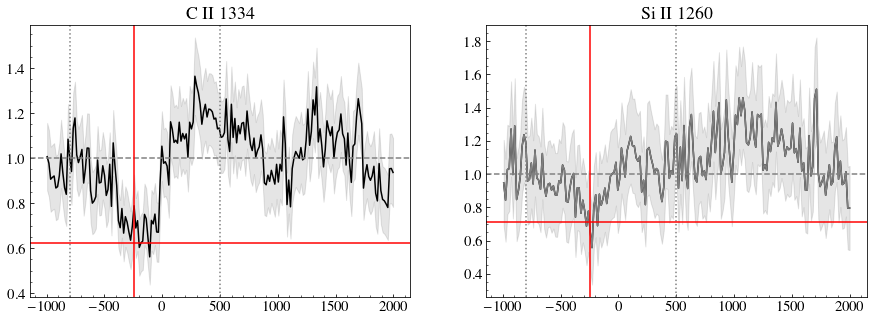

J0036_3333
-1.637806330080359 0.037681450160401364
-114.93227814718261 5.784318738688257
-1.058929921831993 0.02943041328033777
-201.03521533847024 8.723048194011062


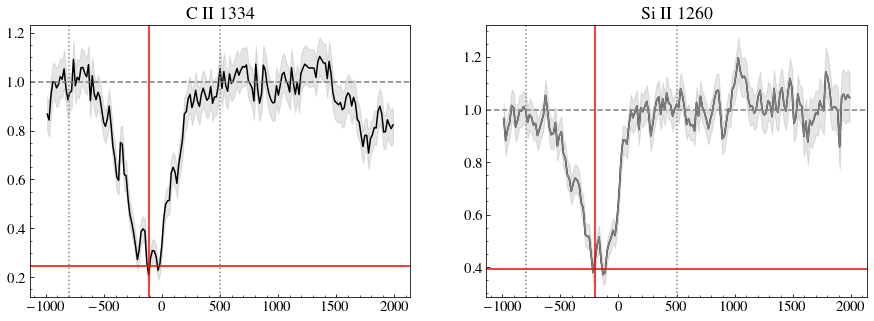

J0127_0619
-1.3834181963916055 0.08209718980063586
14.125598443073603 11.269924070137407
-1.3250600175036888 0.06764088133475134
-42.904133402952404 9.913366263775673


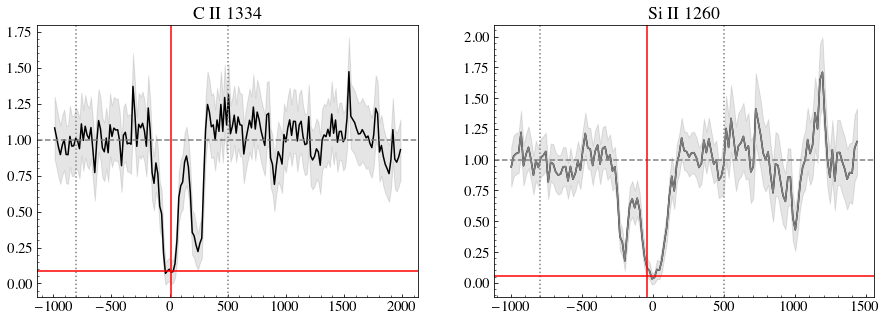

J0144_0453
-0.8505914096923131 0.06262076044274684
13.819822694827394 9.97203148581872
-0.7903557339320293 0.04645520117852855
3.20121560554123 9.395371118596588


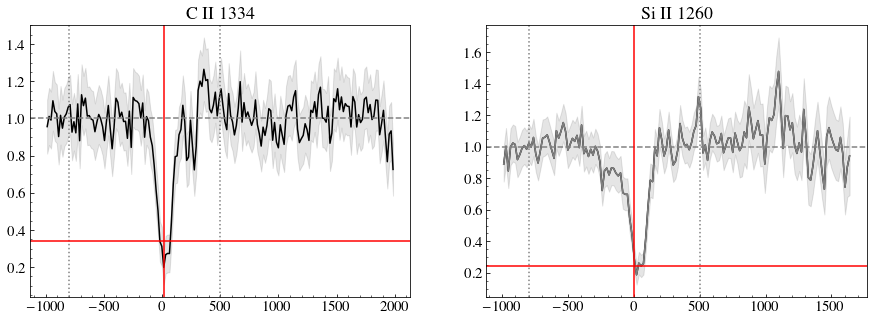

J0337_0502
-0.7799311640341346 0.035378112449497796
2.566666941022227 8.270419495239569
-0.9036541394466635 0.03416789661500614
-56.32404651037276 7.9566162737340145


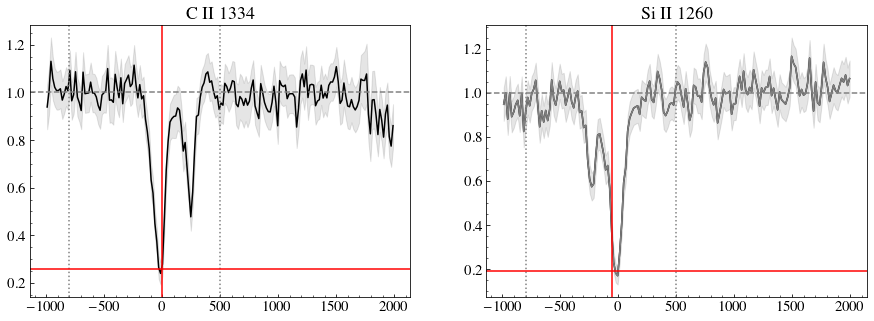

J0405_3648
-0.6466862158630766 0.06370003322847656
-18.698267776134312 20.610318680223525
-0.562329082469379 0.047231733047525024
-38.99040880727958 13.970053529086076


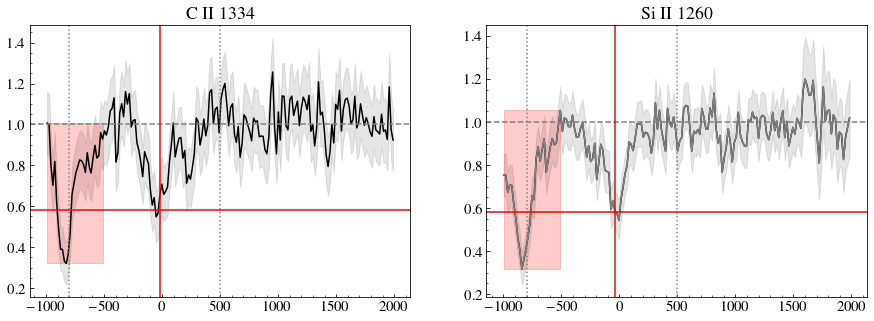

J0808_3948
-0.9329108909205482 0.04577387641755368
-544.9570780097006 22.987993572077237
-0.5710692877671486 0.04915204604932413
-553.3244408271728 23.426722283855945


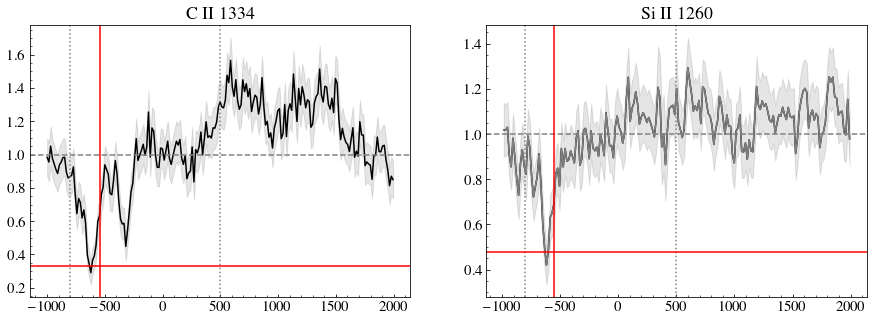

J0823_2806
-2.4579172088872685 0.05663037795156678
31.788341314068784 7.939411292232658
-2.4779593478547017 0.10235933661756116
-88.02247471149731 12.867526398432673


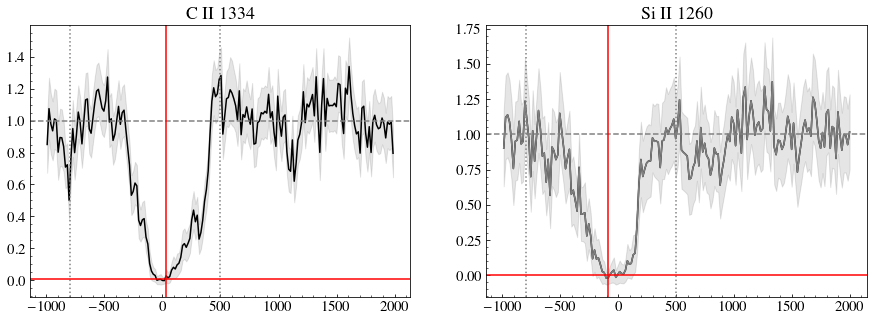

J0926_4427
-0.9000689917953624 0.08860196233206274
-268.4795742168836 25.17473744742929
-0.7692889013186691 0.06648514333544299
-339.45494981023563 19.21621756023535


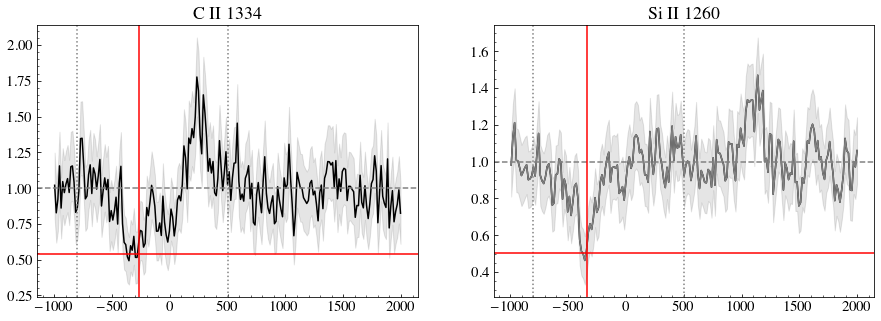

J0934_5514
-0.5825385392496568 0.02172399504609288
37.619199795625555 5.838165782297265
-0.501306024629121 0.015168193491761876
-6.377918578309145 2.6819281081792834


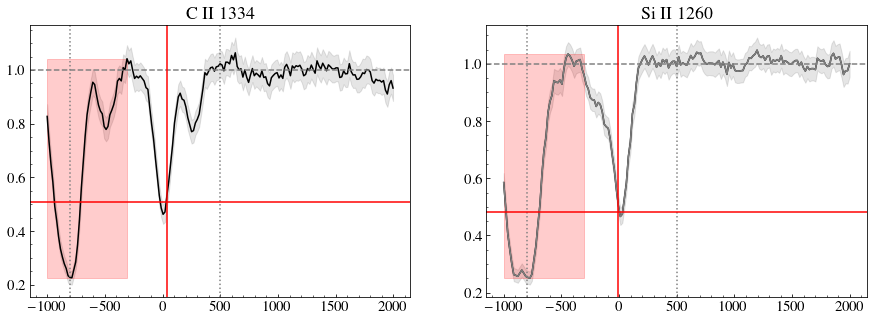

J0938_5428
-1.925020897521114 0.0609615580791839
-34.959188709787746 9.579354468863292
-2.0052167005724884 0.07395591770478388
-67.34412103281484 11.343967096937916


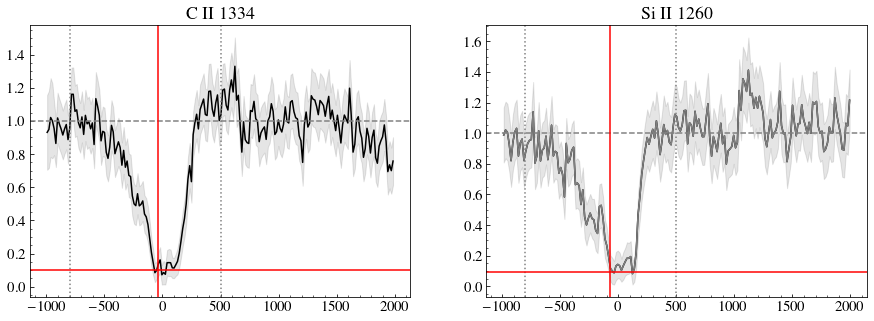

J0940_2935
-0.7436539164958497 0.059567747441151536
28.430278765563763 23.2577881793634
-0.7280726993553522 0.044217044037114794
-8.553072260050453 10.391359838650468


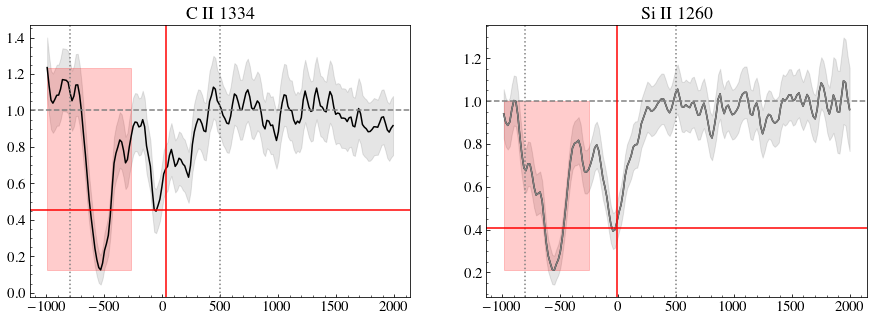

J0942_3547


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
<ipython-input-49-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-49-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


-0.4876788352634479 0.025340838023023803
-41.40210125612482 8.513652975757068
nocare


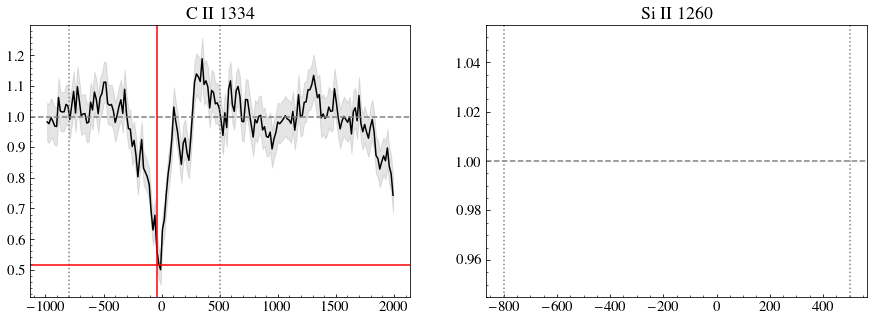

J0944_0038
-1.733320863773888 0.16768125717726282
-18.620888334470056 21.28584083778318
-1.7608932695913402 0.15748128866212666
-85.43002968854263 31.25575027905918


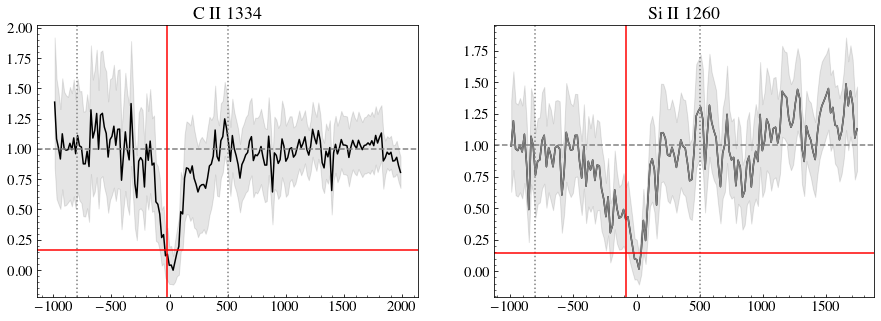

J0944_3442


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-49-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-49-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


-1.6425807540922706 0.17966607429627482
8.20484610442829 29.916888014728958
nocare


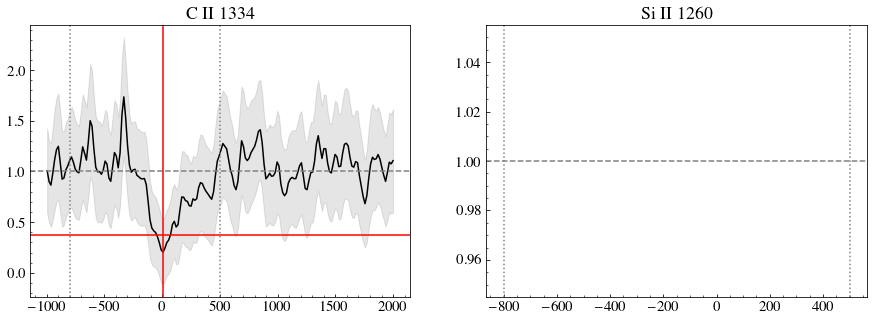

J1016_3754
-0.60994284694548 0.0721834945955838
7.222932962444736 23.516222308442686
-0.5254090302660414 0.062979623070201
-31.28337780678969 30.989086953103552


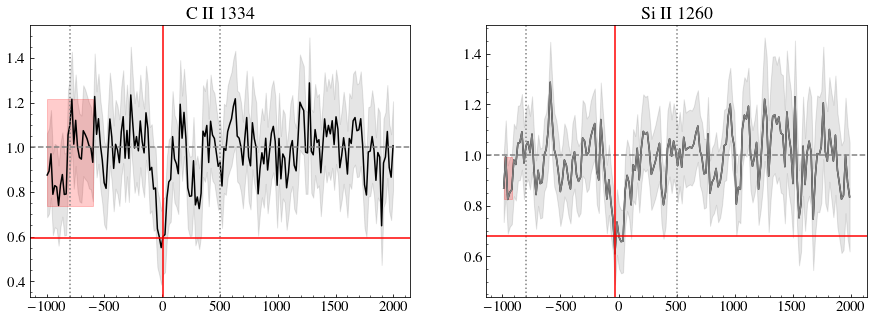

J1024_0524
nocare
-1.163465583839 0.047390660218603525
-81.72587004254996 9.080053545411188


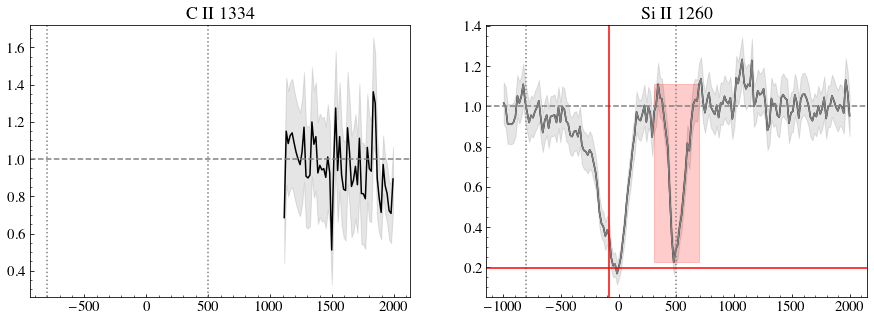

J1025_3622
-1.7223252980703223 0.06917970049911384
-129.54087568312565 10.546233918427394
-1.6616601236436832 0.1102359532761798
-165.79710962613413 20.610315649391275


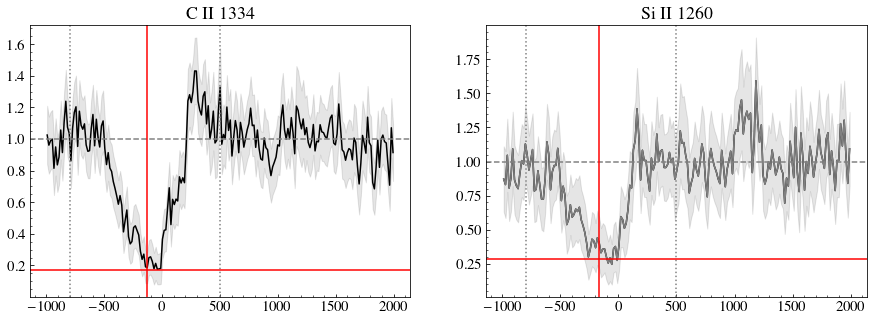

J1044_0353


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-49-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-49-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


-0.9791561945804661 0.04572990385494283
-69.7650918250854 7.885285819148361
nocare


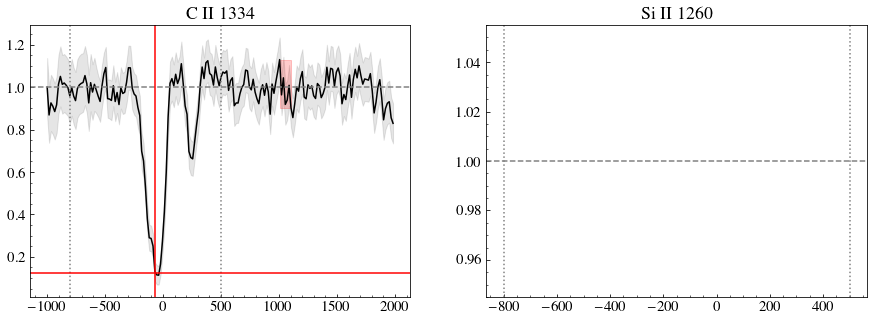

J1105_4444
nocare


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-49-11fa085e0fcc>:85: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]),
<ipython-input-49-11fa085e0fcc>:86: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fcII[~maskCII]), alpha=0.2, color= 'r')


-1.9074201714119976 0.05355981303536815
-112.69189500631094 8.236673298426156


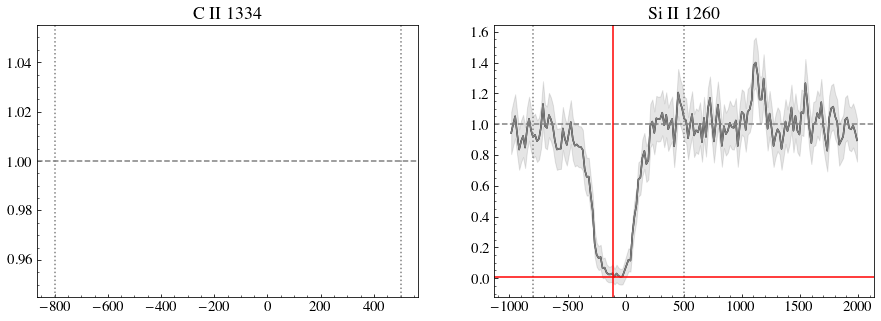

J1112_5503
-3.009632668894705 0.06205050452037987
-329.21324963767734 9.841012847697339
-2.750957641546483 0.11448493190635574
-282.9566671171341 21.632921081154887


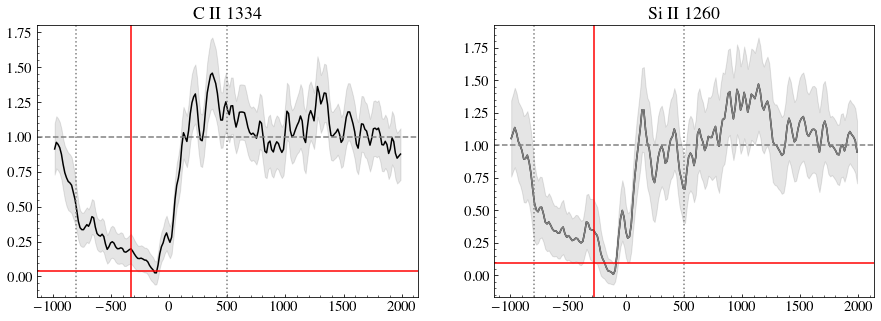

J1119_5130
-0.9991743164841813 0.058960823876529234
6.768299102853939 10.16734885040167
-0.7270244670320336 0.04132810232327229
-18.41436283479764 9.366089316506072


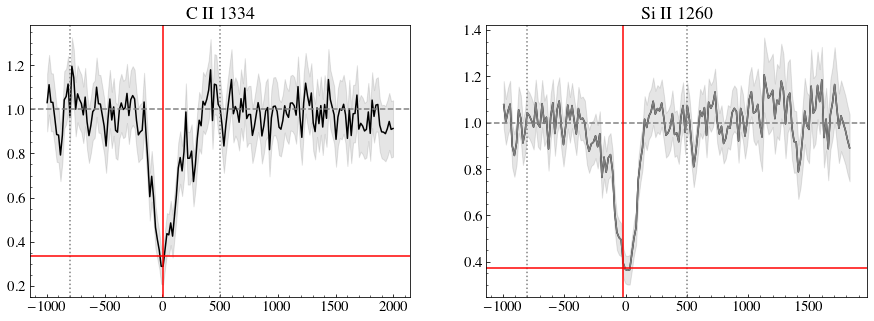

J1129_2034
-1.179717921186747 0.05752440854910478
42.336347459709984 8.666491324626923
-1.149442379956036 0.04806572516156296
-22.239799659419788 9.153813706747458


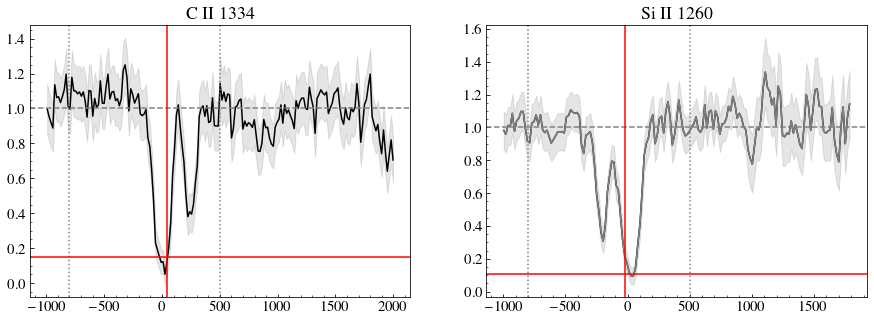

J1132_1411
-1.5837832312785667 0.0631665648900978
-23.93775327362522 9.093528455710294
nocare


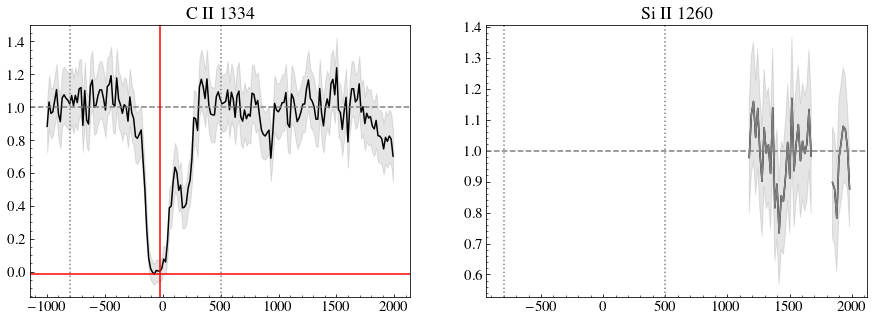

J1132_5722
-1.1059104766168946 0.12058579277402588
11.208424478709462 25.990619666819175
-0.8826519137755409 0.0910503675554484
-31.86722285516426 32.047615377833154


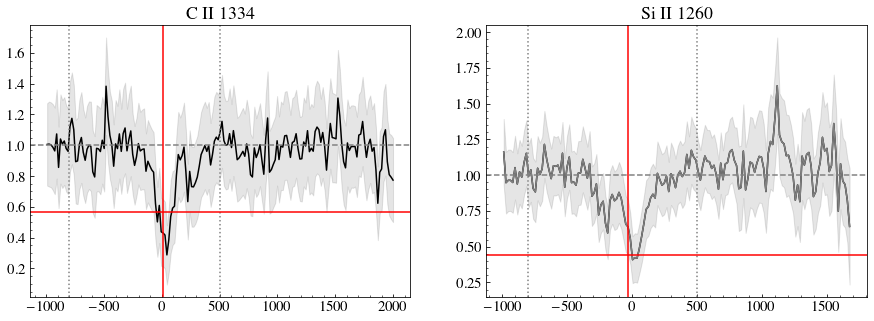

J1144_4012
-2.896044205307787 0.09488710303144686
-145.6848627073394 11.962563210927584
-2.74831109129213 0.1235415536411947
-193.99484357476533 18.088062251209593


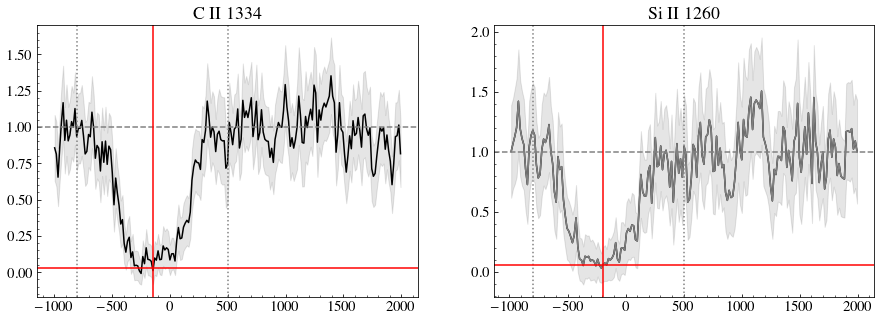

J1148_2546
nocare


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-49-11fa085e0fcc>:85: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]),
<ipython-input-49-11fa085e0fcc>:86: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fcII[~maskCII]), alpha=0.2, color= 'r')


-1.548358774893667 0.07266115968911695
-116.75033304993516 11.07924312013084


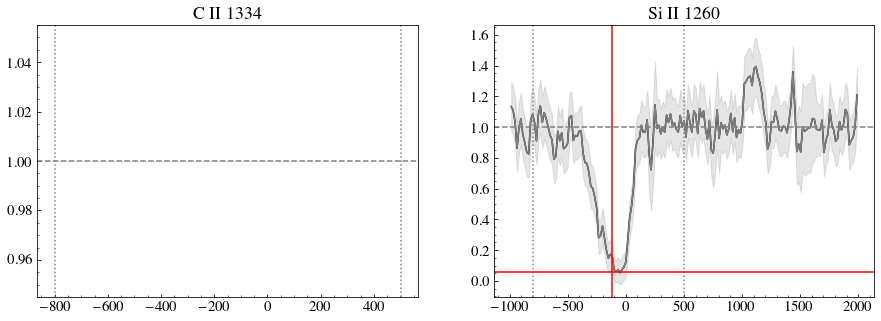

J1150_1501
-1.1826107909594605 0.044529653766124354
39.87483532835591 8.62518214580679
-1.0669337073465914 0.03334771561166812
-34.4370896702202 6.316045153620971


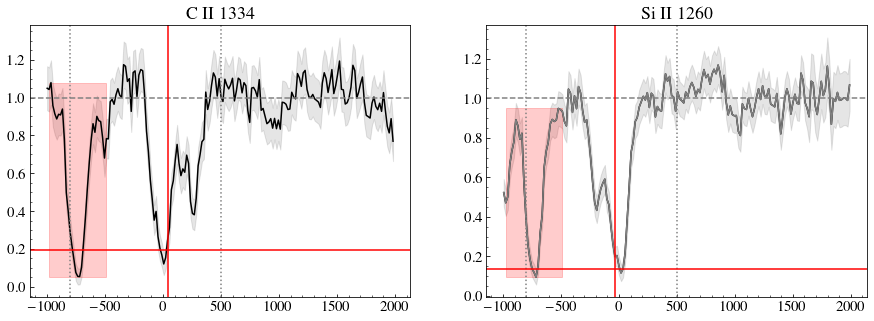

J1157_3220


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-49-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-49-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


-1.3849917417000048 0.0649934431790645
-175.94251418230536 15.499576436573816
nocare


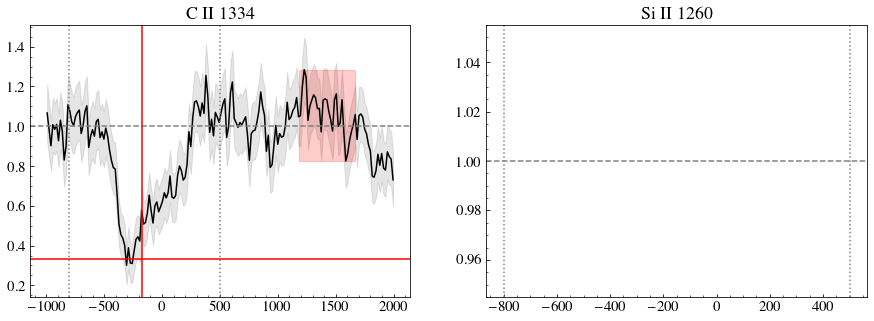

J1200_1343
nocare
-1.4446789324658167 0.07587728260451505
-136.0372538640194 11.95606005988647


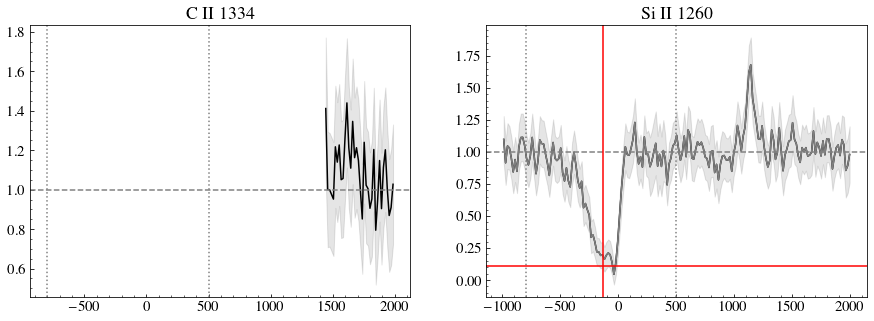

J1225_6109
-1.279622086678484 0.054981299225991
47.3833561957823 8.623927918020303
-1.179608791475307 0.044165175579426195
-16.4264583152413 7.718411483122225


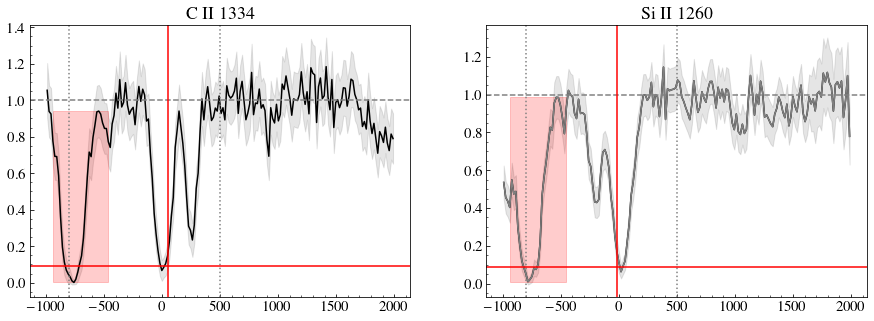

J1253_0312
-1.299083348153868 0.05144545576642532
-51.920946844778726 8.528900478362909
nocare


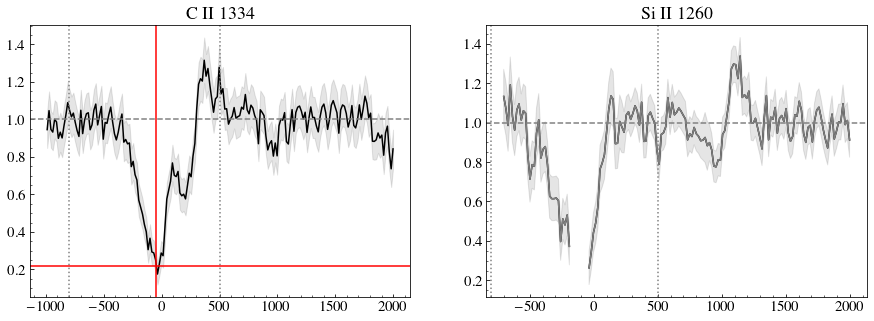

J1314_3452
-1.083365717460035 0.02460323021136669
-20.235223405204714 1.7932560993670756
-1.1228220270932425 0.023774384907797583
-75.52926352793516 5.902469555151488


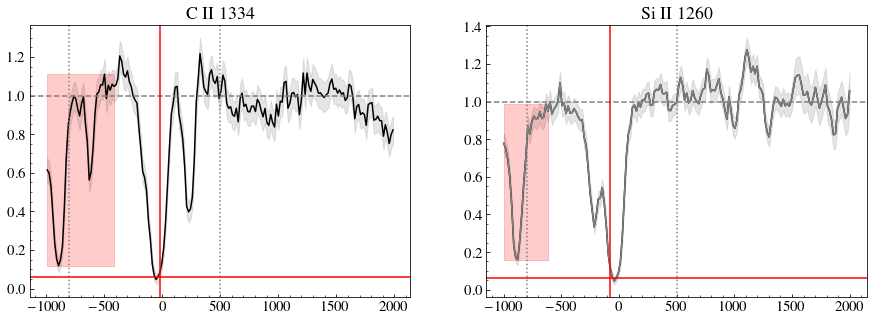

J1323_0132
-0.32343087878266663 0.06222350938048886
-298.9263095582345 84.75809110802595
nocare


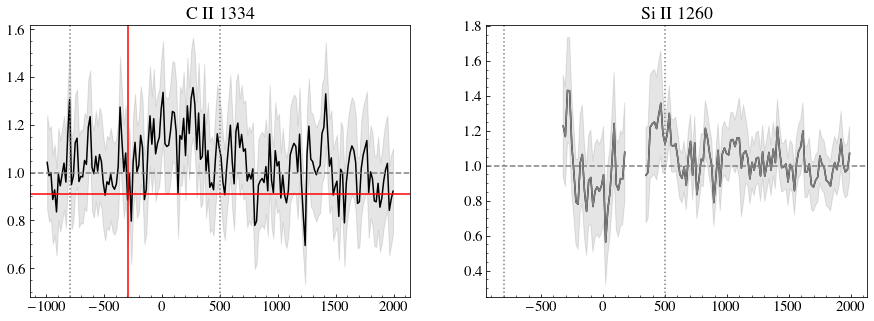

J1359_5726


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
<ipython-input-49-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-49-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


-2.035432836026726 0.04827061718512273
-147.85787421482536 7.283784952589434
nocare


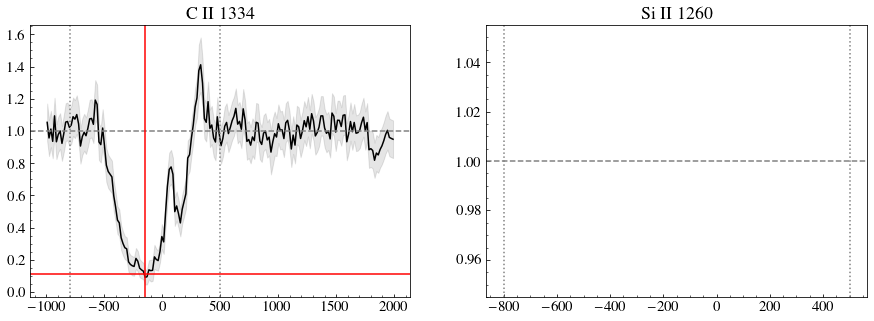

J1416_1223
-3.513658174200228 0.06427340068344442
-103.96147954748366 8.35625854227916
-2.745113022695374 0.09381134049980208
-97.00485694297205 14.384529887856404


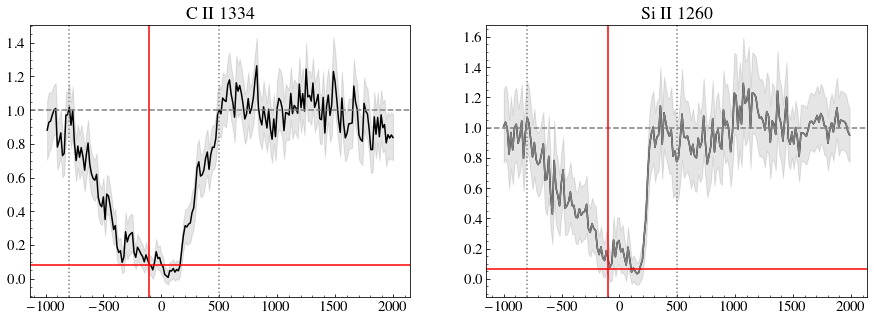

J1418_2102


<ipython-input-49-11fa085e0fcc>:98: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-49-11fa085e0fcc>:99: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


-0.9737203569754156 0.07603855456609224
23.385180734407488 13.033506707716695
-1.0960927384321528 0.09054290477896951
-7.071462081296075 14.055360286287158


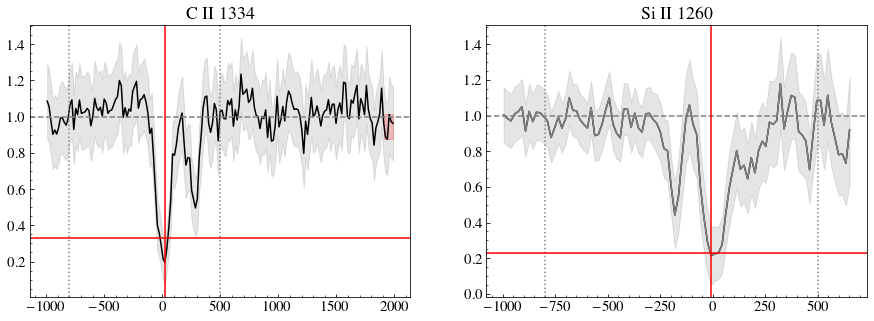

J1428_1653
-1.489080384310264 0.11289045973053899
-141.62081695875352 17.778970428728677
-1.2485794555517054 0.09455328213239858
-181.364253461435 20.262158385499305


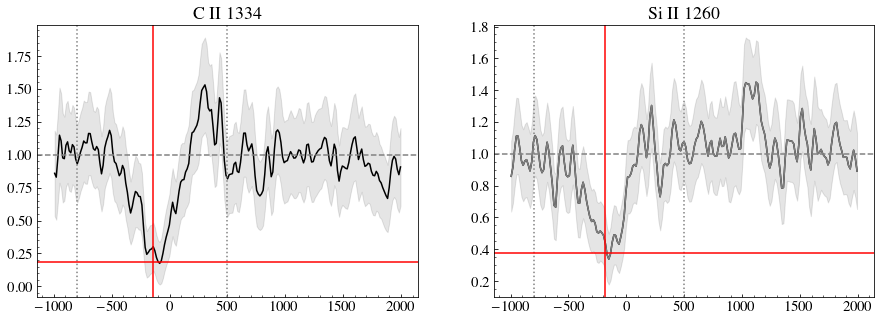

J1429_0643
-1.7374469452406118 0.09431291496880123
-141.23820778424167 14.844039211648125
-1.541090489301872 0.08531361052501743
-182.80928168510943 14.286188686074142


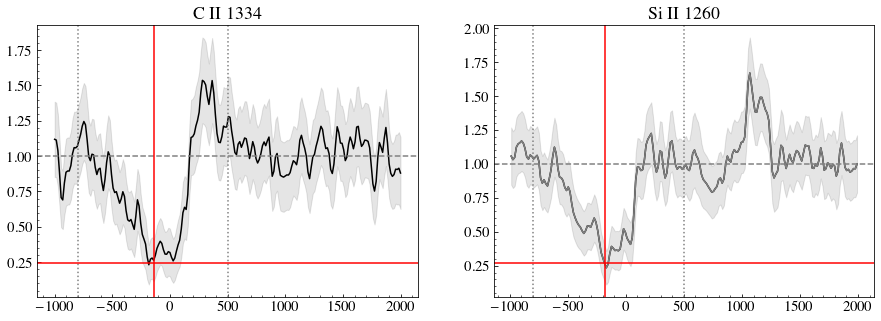

J1444_4237
-0.6731267259381106 0.05998171968811785
-41.239167116530396 10.906419555284891
-0.696228182032836 0.04372570779139997
-65.88820198209392 8.933504481056834


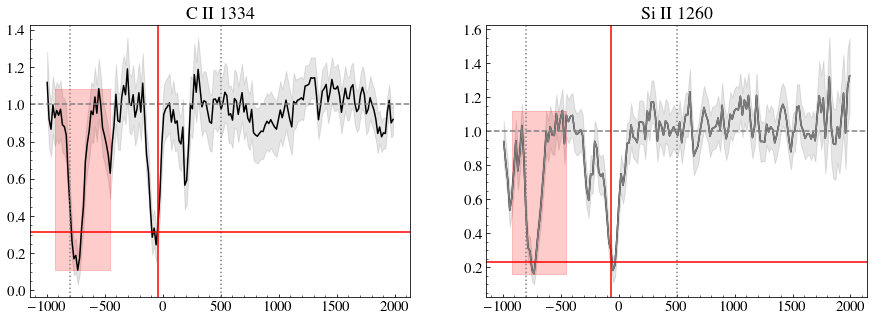

J1448_0110
nocare


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


-1.587661311109601 0.057423158947967706
-56.27833730645339 9.434594086822424


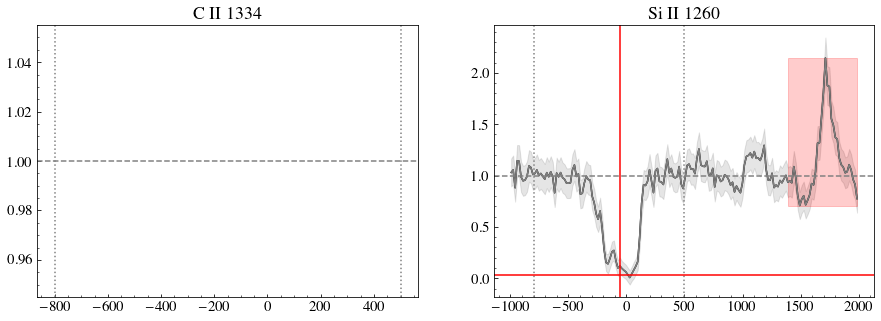

J1521_0759


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


-1.7664767273121846 0.055095115448230356
-89.6963380843685 7.54113159577288
nocare


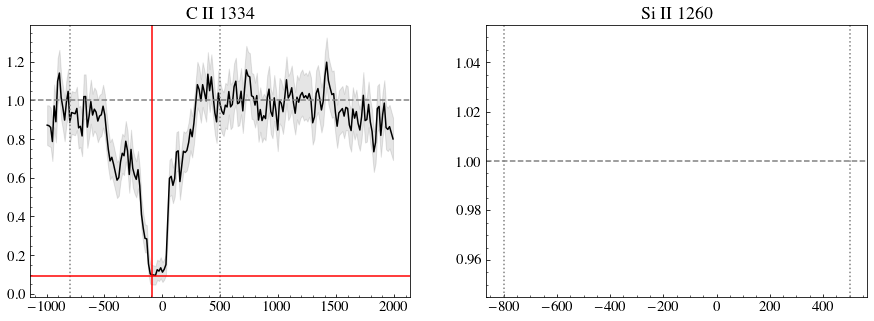

J1525_0757
-2.5535356241789913 0.07654353374051255
-327.9346039080769 9.754992286978661
-2.0301187273158874 0.11943093408323456
-346.24776414674704 25.34904683725556


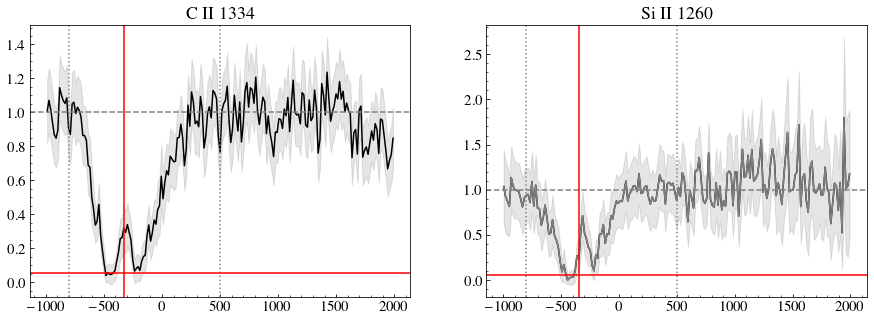

J1545_0858
nocare


/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,


-0.7993702496492892 0.06757825616174873
-37.3118620496284 10.524609078964163


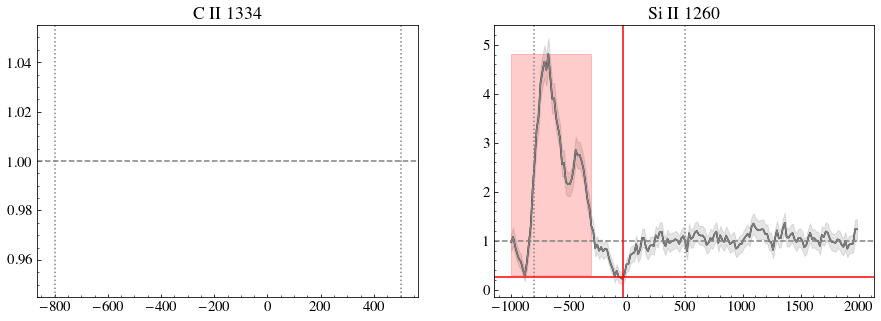

J1612_0817
-3.019267610131797 0.06844190525611245
-366.00823269983783 8.809122230242346
-2.4263643128639547 0.0665769313451145
-368.4942439870164 10.159228962717908


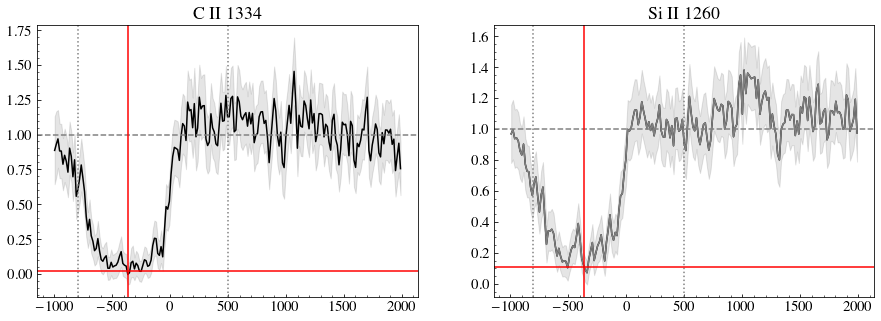

In [49]:
EWSi = np.zeros((45,2)) 
EWSi[EWSi == 0] = np.nan
EWC = np.zeros((45,2))
EWC[EWC == 0] = np.nan

FSi = np.zeros((45,2))
FSi[FSi == 0] = np.nan

FC = np.zeros((45,2))
FC[FC == 0] = np.nan

VSi = np.zeros((45,2))
VSi[VSi == 0] = np.nan

VC = np.zeros((45,2))
VC[VC == 0] = np.nan

for i in range(len(galaxy)):
   # i = 4
    spec = '../Classy/%s/hlsp_classy_hst_cos_%s_multi_v1_coadded.fits'%(galaxy[i].replace("_", ""), label[i])
    gal   = fits.open(spec)
#     print(galaxy[i])
#     if(galaxy[i] != 'J1323_0132'):
#         continue
    print(galaxy[i])
    HR    = gal[8].data  # Rest-frame, galactic extinction-corrected, co-added, high-resolution spectrum
    HRB   = gal[10].data # Rest-frame, galactic extinction-corrected, co-added, binned high-resolution spectrum 

    wH, fH, eH, snrH  = HR['WAVE'],  HR['FLUX DENSITY'],  HR['ERROR'],  HR['SNR']
    wHB,fHB,eHB,snrHB = HRB['WAVE'], HRB['FLUX DENSITY'], HRB['ERROR'], HRB['SNR']

    hduin         = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    hdr           = hduin[1].header
    data          = hduin[1].data
    mask          = mask_all[i]

    wave=data['wave']
    vcIId = (data['wave']/wcII1334 -1)*c
    vsiIId =  (data['wave']/wsiII1260 -1)*c

    flux = data['flux']
    
   # fit = gaussian_filter(data['fit'], sigma = 10)
    err = data['err']
   # absflux = gaussian_filter(data['flux']/fit,sigma = 1)
   # abserr = err/fit
    
    cutCIIall = (vcIId>-1000) & (vcIId<2000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<2000)     
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-800) | ((vcII > 800) & (vcII < 1500))) & maskCII
    if(label[i] == 'j0808+3948'):
        rmedCII = ((vcII>-100) & (vcII < 100)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-800) | ((vsiII > 300) & (vsiII < 500))| ((vsiII > 1600) & (vsiII < 2000))) & maskSiII
    if(label[i] == 'j0808+3948'):
        rmedSiII = ((vsiII>-200) & (vsiII < 100)) & maskSiII
#     if(label[i] == 'j1323-1032'):
#         rmedSiII = ((vsiII>1000) & (vsiII < 1600)) & maskSiII
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
    
    
    
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    axs[0].plot(vcII, fcII,  c='k', label = 'Observed')
    axs[0].fill_between(vcII,fcII-ecII/fmedCII, fcII+ecII/fmedCII,  color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
    axs[0].axhline(1, linestyle = '--', c = 'gray')
    axs[0].axvline(-800, linestyle = ':', c = 'gray')
    axs[0].axvline(500, linestyle = ':', c = 'gray')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), 
                        np.nanmax(fcII[~maskCII]), alpha=0.2, color= 'r')  
    

        
    axs[1].plot(vsiII, fsiII,   c = 'k' )
    axs[1].plot(vsiII, fsiII,   c = 'gray' )
    axs[1].fill_between(vsiII,fsiII-esiII/fmedSiII, fsiII+esiII/fmedSiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')
    axs[1].axhline(1, linestyle = '--', c = 'gray')
    axs[1].axvline(-800, linestyle = ':', c = 'gray')
    axs[1].axvline(500, linestyle = ':', c = 'gray')
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  
    
#     if(~np.isnan(np.sum(absflux[cutCIIall]/medc))):
    try:
        EWC[i][0], EWC[i][1] = measureEWabs(wave[cutCIIall][maskCII], vcII[maskCII], fcII.copy()[maskCII],
                                            (ecII.copy()/fmedCII)[maskCII],
                                 -800, 500)

        #if(label[i] == 'J1525+0757'):
        VC[i][0], VC[i][1], FC[i][0] ,FC[i][1] = measureMinVel(vcII[maskCII], fcII.copy()[maskCII], 
                                                               (ecII.copy()/fmedCII)[maskCII], -800, 00)

        VC[i][0], VC[i][1]  = measureCenV(vcII[maskCII], fcII.copy()[maskCII],  (ecII.copy()/fmedCII)[maskCII], -800, 500)
        if(label[i] == 'j1525+0757'):
            VC[i][0], VC[i][1]  =measureCenV(vcII[maskCII], fcII.copy()[maskCII],  (ecII.copy()/fmedCII)[maskCII], -800, 00)
#             print()
        axs[0].axvline(VC[i][0], c= 'r')
        axs[0].axhline(FC[i][0], c= 'r')
        print(EWC[i][0],EWC[i][1])

        print(VC[i][0],VC[i][1])
#         print(FC[i][0],FC[i][1])
#     limup = 1400
#     if i == 2:
#         limup =1250
    except:
        print('nocare')
    try:
        EWSi[i][0], EWSi[i][1] = measureEWabs(wave[cutSiIIall][maskSiII], vsiII[maskSiII], fsiII.copy()[maskSiII],
                                              (esiII.copy()/fmedSiII)[maskSiII],    -800, 500)
        VSi[i][0], VSi[i][1], FSi[i][0],FSi[i][1] = measureMinVel(vsiII[maskSiII], fsiII.copy()[maskSiII],
                                                                  (esiII.copy()/fmedSiII)[maskSiII], -800, 500)

        VSi[i][0], VSi[i][1]  = measureCenV(vsiII[maskSiII], fsiII.copy()[maskSiII], (esiII.copy()/fmedSiII)[maskSiII], -800, 500)

        axs[1].axvline(VSi[i][0], c= 'r')
        axs[1].axhline(FSi[i][0], c= 'r')
        print(EWSi[i][0],EWSi[i][1])

        print(VSi[i][0],VSi[i][1])
#         print(FSi[i][0],FSi[i][1])
    except:
        print('nocare')
    plt.show()


In [15]:
df = pd.DataFrame(np.vstack((galaxy,EWC[:,0],EWC[:,1], EWSi[:,0],EWSi[:,1], 
                   VC[:,0],VC[:,1], VSi[:,0],VSi[:,1],  
                   FC[:,0], FC[:,1],FSi[:,0],FSi[:,1])).T) # A is a numpy 2d array
C=['Galaxy','EWCII','ErrEWCII', 'EWSiII', 'ErrEWSiII', 'VcenCII', 'ErrVcenCII',
                   'VcenSiII', 'ErrVcenSiII', 'RCII', 'ErrRCII', 'RSiII', 'ErrRSiII']
df.to_csv("csv/Classy_Abs_V2.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

### Emission features

In [ ]:
EWfluoSi = np.zeros((45,2)) 
EWfluoSi[EWfluoSi == 0] = np.nan
EWfluoC = np.zeros((45,2))
EWfluoC[EWfluoC == 0] = np.nan

FfluoSi = np.zeros((45,2))
FfluoSi[FfluoSi == 0] = np.nan

FfluoC = np.zeros((45,2))
FfluoC[FfluoC == 0] = np.nan

VfluoSi = np.zeros((45,2))
VfluoSi[VfluoSi == 0] = np.nan

VfluoC = np.zeros((45,2))
VfluoC[VfluoC == 0] = np.nan

for i in range(len(galaxy)):
    spec = '../Classy/%s/hlsp_classy_hst_cos_%s_multi_v1_coadded.fits'%(galaxy[i].replace("_", ""), label[i])
    gal   = fits.open(spec)
    print(galaxy[i])
    HR    = gal[8].data  # Rest-frame, galactic extinction-corrected, co-added, high-resolution spectrum
    HRB   = gal[10].data # Rest-frame, galactic extinction-corrected, co-added, binned high-resolution spectrum 

    wH, fH, eH, snrH  = HR['WAVE'],  HR['FLUX DENSITY'],  HR['ERROR'],  HR['SNR']
    wHB,fHB,eHB,snrHB = HRB['WAVE'], HRB['FLUX DENSITY'], HRB['ERROR'], HRB['SNR']

    hduin         = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    hdr           = hduin[1].header
    data          = hduin[1].data
    mask          = mask_all[i]

    wave=data['wave']
    vcIId = (data['wave']/wcII1334 -1)*c
    vsiIId =  (data['wave']/wsiII1260 -1)*c

    flux = data['flux']
    
   # fit = gaussian_filter(data['fit'], sigma = 10)
    err = data['err']
   # absflux = gaussian_filter(data['flux']/fit,sigma = 1)
   # abserr = err/fit
    
    cutCIIall = (vcIId>-1000) & (vcIId<2000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<2000)     
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 700)) & maskCII
    if(label[i] == 'j0808+3948'):
        rmedCII = ((vcII>-100) & (vcII < 100)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)) | (vsiII > 1500)) & maskSiII
    if(label[i] == 'j0808+3948'):
        rmedSiII = ((vsiII>-200) & (vsiII < 100)) & maskSiII
    if(label[i] == 'j1112+5503'):
        rmedSiII = ((vsiII>1500)) & maskSiII
    if(label[i] == 'j1323-0132'):
        rmedSiII = ((vsiII>1200)& (vsiII < 1700)) & maskSiII
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
    
    limup = 1300
    if i == 2:
        limup =1250  
    
    limdown = 700
    if(label[i] == 'j1132+5722' or label[i] == 'j0127-0619' ):
        print(label[i])
        limdown = 900
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    axs[0].plot(vcII, fcII,  c='k', label = 'Observed')
    axs[0].fill_between(vcII,fcII-ecII/fmedCII, fcII+ecII/fmedCII,  color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
    axs[0].axhline(1, linestyle = '--', c = 'gray')
    axs[0].axvline(-200, linestyle = ':', c = 'gray')
    axs[0].axvline(800, linestyle = ':', c = 'gray')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), 
                        np.nanmax(fcII[~maskCII]), alpha=0.2, color= 'r')  
    

        
    axs[1].plot(vsiII, fsiII,   c = 'k' )
    axs[1].plot(vsiII, fsiII,   c = 'gray' )
    axs[1].fill_between(vsiII,fsiII-esiII/fmedSiII, fsiII+esiII/fmedSiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')
    axs[1].axhline(1, linestyle = '--', c = 'gray')
    axs[1].axvline(600, linestyle = ':', c = 'gray')
    axs[1].axvline(limup, linestyle = ':', c = 'gray')
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  
        
        
    try:
        EWfluoC[i][0], EWfluoC[i][1] = measureEWemi( wave[cutCIIall][maskCII], vcII[maskCII], fcII.copy()[maskCII],
                                            (ecII.copy()/fmedCII)[maskCII],      00, 600)

        VfluoC[i][0], VfluoC[i][1], FfluoC[i][0],FfluoC[i][1] = measureMaxVel(vcII[maskCII], fcII.copy()[maskCII],
                                            (ecII.copy()/fmedCII)[maskCII],     00, 600)
        axs[0].axvline(VfluoC[i][0], c= 'r')
        print(EWfluoC[i][0], EWfluoC[i][1])
    except:
        print('no puedo')
        
    try:

        EWfluoSi[i][0], EWfluoSi[i][1] = measureEWemi(wave[cutSiIIall][maskSiII], vsiII[maskSiII], fsiII.copy()[maskSiII],
                                              (esiII.copy()/fmedSiII)[maskSiII], limdown, limup)
        VfluoSi[i][0], VfluoSi[i][1], FfluoSi[i][0],FfluoSi[i][1] = measureMaxVel(vsiII[maskSiII], fsiII.copy()[maskSiII],
                                              (esiII.copy()/fmedSiII)[maskSiII],   limdown, limup)
        axs[1].axvline(VfluoSi[i][0], c= 'r')
        print(EWfluoSi[i][0], EWfluoSi[i][1])
    except:
        print('no puedo')
        
    plt.show()

In [43]:
import pandas as pd
df = pd.DataFrame(np.vstack((galaxy,EWfluoC[:,0],EWfluoC[:,1], EWfluoSi[:,0],EWfluoSi[:,1], 
                   VfluoC[:,0],VfluoC[:,1], VfluoSi[:,0],VfluoSi[:,1],  
                   FfluoC[:,0],FfluoSi[:,0])).T) # A is a numpy 2d array
C=['Galaxy','EWFluoCII','ErrEWFluoCII', 'EWFluoSiII', 'ErrEWFluoSiII', 'VFluoCII', 'ErrVFluoCII',
                   'VFluoSiII', 'ErrVFluoSiII', 'FmaxFluoCII', 'FmaxFluoSiII']
df.to_csv("csv/Classy_Fluo2.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

## Reading and plotting spectra - 3 time steps - 1728 directions

In [4]:
h_cgs     = 6.6260755e-27  # [erg s]
c_cgs     = 2.99792458e10  # [cm/s]
c = 299792.458

# Directions in which the galaxy has been observed:
# The angular momentum of the galaxy is roughly along the (0,0,1) direction. ->
# -> Face-on = ~parallel to (0,0,1), edge-on = ~perpendicular to (0,0,1)
directions = np.zeros((1728,3))
for i in range(1728):
    directions[i,:] = hp.pix2vec(12,i)

# Function to read the binary files
def read_file(Dir,FileName,ndir):
    f = ff('%s/%s_spectrum'%(Dir,FileName))
    n = f.read_ints()[0]
    aperture,lmin,lmax = f.read_reals('d')
    spec = np.zeros((ndir,n))
    spec[0,:] = f.read_reals('d')
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        spec[j,:] = f.read_reals('d')
    f.close()

    return lmin,lmax,n,spec

# To get the spectra, in the appropriate units
def read_spectrum(output,spec,path_to_data):
    lum_per_packet = np.genfromtxt('%s/IC_photons_%s_%i'%(path_to_data,spec,output))
    lmin,lmax,npix,phot_packets = read_file(path_to_data,'output_%s_%i.out'%(spec,output),1728)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux

In [266]:
path_to_data = './data/'   # To change if you move the data

line    = 'CII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 164    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 


# velocity of the center of mass, to correct for the movement of the galaxy in the simulation box:
v_cm = np.genfromtxt('%s/vcm_%i.dat'%(path_to_data,output)) 
# l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
l, flux = read_spectrum(output,line,path_to_data) 

In [ ]:
path_to_data = './data/'   # To change if you move the data

line    = 'CII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 164    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 


# velocity of the center of mass, to correct for the movement of the galaxy in the simulation box:
v_cm = np.genfromtxt('%s/vcm_%i.dat'%(path_to_data,output)) 
# l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
l, flux = read_spectrum(output,line,path_to_data) 

ndir = 1727 #(idir 0 and 1 in 148)
EWabsLR = np.zeros(ndir)
EWabsHR = np.zeros(ndir)
EWemiLR = np.zeros(ndir)
EWemiHR = np.zeros(ndir)
VabsLR = np.zeros(ndir)
VabsHR = np.zeros(ndir)
VemiLR = np.zeros(ndir)
VemiHR = np.zeros(ndir)
FabsLR = np.zeros(ndir)
FabsHR = np.zeros(ndir)
FemiLR = np.zeros(ndir)
FemiHR = np.zeros(ndir)
for idir in range(ndir):
    
#idir = 995 # to choose a direction of observation, between 0 and 1727

    # To correct for the movement of the galaxy in the simulation box (not useful for the continuum):
    l_systemic = l + np.dot(directions[idir,:],v_cm)/c_cgs*1e5*np.mean(l) 

    # Plotting the spectrum in the selected direction:
    #fig,ax = plt.subplots(figsize=(8,5))
    # The flux drops down on the far-left and far-right sides, ignore this part
    vcII   = (l_systemic/1334.532 -1)*c
    sigma_pixel = 50 / ((vcII[50]-vcII[49]))
#     model = gaussian_filter(flux[idir,:], sigma = sigma_pixel)
    fluxdir = flux[idir,:]
    model = gaussian_filter(fluxdir, sigma = sigma_pixel)
    fluxdir /= np.median(fluxdir)
#     mask=(vcII>1500) & (vcII < 2000)

   # plt.plot(vcII,flux[idir,:]/np.median(flux[idir,:]))
    model = model/np.median(model)

   # plt.plot(vcII,flux[idir,:]/np.median(flux[idir,:]))
    plt.plot(vcII,model/np.median(model))

    EWabsHR[idir], oo = measureEWabs(l_systemic, vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -800, 500)
    EWabsLR[idir], oo = measureEWabs(l_systemic, vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -800, 500)
   # print(EWabsHR,EWabsLR)

    EWemiHR[idir], oo = measureEWemi(l_systemic, vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -200, 800)
    EWemiLR[idir], oo = measureEWemi(l_systemic, vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -200, 800)
   # print(EWemiHR,EWemiLR)
    
    VabsHR[idir], oo, FabsHR[idir] = measureMinVel(vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -800, 500)
    VabsLR[idir], oo , FabsLR[idir] = measureMinVel(vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -800, 500)
   # print(VabsHR,FabsHR)
  #  print(VabsLR,FabsLR)

    VemiHR[idir], oo, FemiHR[idir] = measureMaxVel(vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -200, 800)
    VemiLR[idir], oo, FemiLR[idir] = measureMaxVel(vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -200, 800)
#     print(VemiHR,FemiHR)
#     print(VemiLR,FemiLR)    

    
# plt.xlabel(r'$\lambda$ [A]',fontsize=16)
# plt.ylabel(r'flux [erg/s/A]',fontsize=16)
# plt.show()
# plt.close()

In [176]:
import pandas as pd
df = pd.DataFrame(np.vstack((np.linspace(0,1726,1727),EWabsHR,EWabsLR, EWemiHR, EWemiLR, VabsHR, VabsLR, VemiHR,
                   VemiLR, FabsHR, FabsLR, FemiHR, FemiLR)).T) # A is a numpy 2d array
C=['dir','EWabsHR','EWabsLR', 'EWemiHR', 'EWemiLR', 'VabsHR', 'VabsLR', 'VemiHR',
                   'VemiLR', 'FabsHR', 'FabsLR', 'FemiHR', 'FemiLR']
df.to_csv("csv/CII_164.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

In [ ]:
path_to_data = './data/'   # To change if you move the data

line    = 'SiII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 156    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 


# velocity of the center of mass, to correct for the movement of the galaxy in the simulation box:
v_cm = np.genfromtxt('%s/vcm_%i.dat'%(path_to_data,output)) 
# l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
l, flux = read_spectrum(output,line,path_to_data) 

ndir = 1727 #(idir 0 and 1 in 148)
EWabsLR = np.zeros(ndir)
EWabsHR = np.zeros(ndir)
EWemiLR = np.zeros(ndir)
EWemiHR = np.zeros(ndir)
VabsLR = np.zeros(ndir)
VabsHR = np.zeros(ndir)
VemiLR = np.zeros(ndir)
VemiHR = np.zeros(ndir)
FabsLR = np.zeros(ndir)
FabsHR = np.zeros(ndir)
FemiLR = np.zeros(ndir)
FemiHR = np.zeros(ndir)
for idir in range(ndir):
    
#idir = 995 # to choose a direction of observation, between 0 and 1727

    # To correct for the movement of the galaxy in the simulation box (not useful for the continuum):
    l_systemic = l + np.dot(directions[idir,:],v_cm)/c_cgs*1e5*np.mean(l) 

    # Plotting the spectrum in the selected direction:
    #fig,ax = plt.subplots(figsize=(8,5))
    # The flux drops down on the far-left and far-right sides, ignore this part
    vcII   = (l_systemic/1260.42 -1)*c
    sigma_pixel = 50 / ((vcII[50]-vcII[49]))
    fluxdir = flux[idir,:]
    model = gaussian_filter(fluxdir, sigma = sigma_pixel)
    fluxdir /= np.median(fluxdir)
#     mask=(vcII>1500) & (vcII < 2000)

   # plt.plot(vcII,flux[idir,:]/np.median(flux[idir,:]))
    model = model/np.median(model)
    plt.plot(vcII,model)
    EWabsHR[idir], oo = measureEWabs(l_systemic, vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -1000, 500)
    EWabsLR[idir], oo = measureEWabs(l_systemic, vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -1000, 500)
   # print(EWabsHR,EWabsLR)

    EWemiHR[idir], oo = measureEWemi(l_systemic, vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             600, 1400)
    EWemiLR[idir], oo = measureEWemi(l_systemic, vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             600, 1400)
   # print(EWemiHR,EWemiLR)
    
    VabsHR[idir], oo, FabsHR[idir] = measureMinVel(vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             -1000, 500)
    VabsLR[idir], oo , FabsLR[idir] = measureMinVel(vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             -1000, 500)
   # print(VabsHR,FabsHR)
  #  print(VabsLR,FabsLR)

    VemiHR[idir], oo, FemiHR[idir] = measureMaxVel(vcII, fluxdir.copy(), np.zeros(len(flux[idir,:])),
                             600, 1400)
    VemiLR[idir], oo, FemiLR[idir] = measureMaxVel(vcII, model.copy(), np.zeros(len(flux[idir,:])),
                             600, 1400)
#     print(VemiHR,FemiHR)
#     print(VemiLR,FemiLR)    

plt.axhline(1)
plt.axvline(1400)
plt.axvline(600)

# plt.xlabel(r'$\lambda$ [A]',fontsize=16)
# plt.ylabel(r'flux [erg/s/A]',fontsize=16)
# plt.show()
# plt.close()

In [143]:
import pandas as pd
df = pd.DataFrame(np.vstack((np.linspace(0,1726,1727),EWabsHR,EWabsLR, EWemiHR, EWemiLR, VabsHR, VabsLR, VemiHR,
                   VemiLR, FabsHR, FabsLR, FemiHR, FemiLR)).T) # A is a numpy 2d array
C=['dir','EWabsHR','EWabsLR', 'EWemiHR', 'EWemiLR', 'VabsHR', 'VabsLR', 'VemiHR',
                   'VemiLR', 'FabsHR', 'FabsLR', 'FemiHR', 'FemiLR']
df.to_csv("csv/SiII_148.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

## Reading and measuring - 75 time steps - 300 directions - No fine structure

### Reading functions

In [5]:
n_halos = 75
n_phots = np.append(np.logspace(7,6,20), 1000000*np.ones(n_halos-20)).astype(int)

ndirections = 300
directions = np.zeros((ndirections,3))
for i in range(ndirections):
    directions[i,:] = hp.pix2vec(5,i)


Text(0, 0.5, 'flux [erg/s/A]')

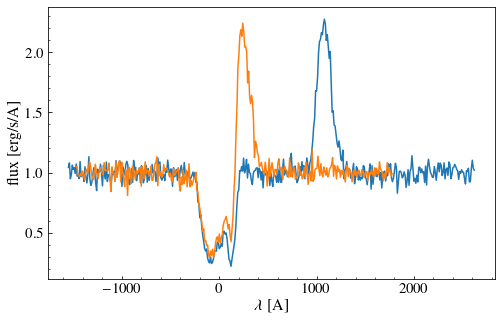

In [630]:
path_to_data = './CII_SiII'   # To change if you move the data

line    = 'CII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 96    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 

v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

l, flux = read_spectrum_si(path_to_data,output) 
idir = 113 # to choose a direction of observation, between 0 and ndirections-1

l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/1260.42 -1)*c

fig,ax = plt.subplots(figsize=(8,5))
plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]))
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)

l, flux = read_spectrum_c(path_to_data,output) 
idir = 113 # to choose a direction of observation, between 0 and ndirections-1

l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/1334.532 -1)*c

plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]))
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)



### Measuring

IntProgress(value=0, max=75)

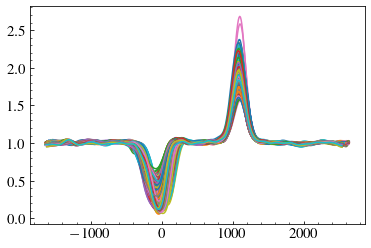

In [7]:
path_to_data = './CII_SiII'   # To change if you move the data

nout = 75
ndir = 300 

EWabsLRC = np.zeros((nout,ndir))
EWabsHRC = np.zeros((nout,ndir))
RabsLRC  = np.zeros((nout,ndir))
RabsHRC  = np.zeros((nout,ndir))
VabsLRC = np.zeros((nout,ndir))
VabsHRC = np.zeros((nout,ndir))
VcenLRC = np.zeros((nout,ndir))
VcenHRC = np.zeros((nout,ndir))
EWemiLRC = np.zeros((nout,ndir))
EWemiHRC = np.zeros((nout,ndir))
VemiLRC = np.zeros((nout,ndir))
VemiHRC = np.zeros((nout,ndir))
FemiLRC = np.zeros((nout,ndir))
FemiHRC = np.zeros((nout,ndir))

EWabsLRSi = np.zeros((nout,ndir))
EWabsHRSi = np.zeros((nout,ndir))
RabsLRSi  = np.zeros((nout,ndir))
RabsHRSi  = np.zeros((nout,ndir))
VabsLRSi = np.zeros((nout,ndir))
VabsHRSi = np.zeros((nout,ndir))
VcenLRSi = np.zeros((nout,ndir))
VcenHRSi = np.zeros((nout,ndir))
EWemiLRSi = np.zeros((nout,ndir))
EWemiHRSi = np.zeros((nout,ndir))
VemiLRSi = np.zeros((nout,ndir))
VemiHRSi = np.zeros((nout,ndir))
FemiLRSi = np.zeros((nout,ndir))
FemiHRSi = np.zeros((nout,ndir))

f = IntProgress(min=0, max=nout) # instantiate the bar
display(f) # display the bar

v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

for output in range(90,165,1):
    f.value += 1# output = 142
    l_c, flux_c = read_spectrum_c(path_to_data,output )
    l_si, flux_si = read_spectrum_si(path_to_data,output )
    vGal = v_cm[:,output-90]

    for idir in range(300):
        l_sys_c = l_c + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_c)
        l_sys_c =l_sys_c[1:]
        vcII   = (l_sys_c/1334.532 -1)*c
        sigma_pixel = 71 /2.355/ ((vcII[50]-vcII[49]))
        
        fluxdir = flux_c[idir,1:]
        fluxdir /= np.nanmedian(fluxdir[(vcII>1000)])
        
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1000)])
            
        EWabsHRC[output-90, idir], oo = measureEWabs(l_sys_c, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     -800, 500)
        EWabsLRC[output-90,idir], oo = measureEWabs(l_sys_c, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                    -800, 500)

        EWemiHRC[output-90,idir], oo = measureEWemi(l_sys_c, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                    -200, 800)
        EWemiLRC[output-90,idir], oo = measureEWemi(l_sys_c, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                    -200, 800)

        VabsHRC[output-90,idir], oo, RabsHRC[output-90,idir] = measureMinVel(vcII, fluxdir.copy(), 
                                                                             np.zeros(len(fluxdir)), -800, 500)
        VabsLRC[output-90,idir], oo , RabsLRC[output-90,idir] = measureMinVel(vcII, model.copy(), 
                                                                              np.zeros(len(fluxdir)), -800, 500)
        
        VcenHRC[output-90,idir] = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -800, 500)
        VcenLRC[output-90,idir] = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -800, 500)

        
        VemiHRC[output-90,idir], oo, FemiHRC[output-90,idir] = measureMaxVel(vcII, fluxdir.copy(), 
                                                                             np.zeros(len(fluxdir)), -200, 800)
        VemiLRC[output-90,idir], oo, FemiLRC[output-90,idir] = measureMaxVel(vcII, model.copy(), 
                                                                             np.zeros(len(fluxdir)), -200, 800)
                
        l_sys_si = l_si + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_si) 
        l_sys_si =l_sys_si[1:]

        vcII   = (l_sys_si/1260.42 -1)*c
        sigma_pixel = 50 / ((vcII[50]-vcII[49]))
        
        fluxdir = flux_si[idir,1:]
        fluxdir/= np.nanmedian(fluxdir[(vcII>1500)])
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1500)])
        
        
        if(output == 102):
            plt.plot(vcII,model)

        EWabsHRSi[output-90,idir], oo = measureEWabs(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                     -1000, 500)
        EWabsLRSi[output-90,idir], oo = measureEWabs(l_sys_si, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                     -1000, 500)

        EWemiHRSi[output-90,idir], oo = measureEWemi(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     600, 1400)
        EWemiLRSi[output-90,idir], oo = measureEWemi(l_sys_si, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                     600, 1400)

        VabsHRSi[output-90,idir], oo, RabsHRSi[output-90,idir] = measureMinVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), -1000, 500)
        VabsLRSi[output-90,idir], oo , RabsLRSi[output-90,idir] = measureMinVel(vcII, model.copy(), 
                                                                                np.zeros(len(fluxdir)), -1000, 500)

        VcenHRSi[output-90,idir] = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -1000, 500)
        VcenLRSi[output-90,idir] = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -1000, 500)
        
        
        VemiHRSi[output-90,idir], oo, FemiHRSi[output-90,idir] = measureMaxVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        VemiLRSi[output-90,idir], oo, FemiLRSi[output-90,idir] = measureMaxVel(vcII, model.copy(), 
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        if(FemiHRSi[output-90,idir]<1.15):
             VemiHRSi[output-90,idir] = np.nan
        if(FemiLRSi[output-90,idir]<1.15):
             VemiLRSi[output-90,idir] = np.nan       
        if(FemiHRC[output-90,idir]<1.15):
             VemiHRC[output-90,idir] = np.nan
        if(FemiLRC[output-90,idir]<1.15):
             VemiLRC[output-90,idir] = np.nan  


### Save

In [8]:
for i in range(75):
    df = pd.DataFrame(np.vstack((np.linspace(0,299,300),  
                                 EWabsHRC[i,:], EWabsLRC[i,:], 
                                 EWemiHRC[i,:], EWemiLRC[i,:], 
                                 VabsHRC[i,:], VabsLRC[i,:], 
                                 VcenHRC[i,:], VcenLRC[i,:], 
                                 VemiHRC[i,:], VemiLRC[i,:],
                                 RabsHRC[i,:], RabsLRC[i,:], 
                                 FemiHRC[i,:], FemiLRC[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    df.to_csv("CII_SiII/CII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 
    
    dff = pd.DataFrame(np.vstack((np.linspace(0,299,300), 
                                  EWabsHRSi[i,:], EWabsLRSi[i,:], 
                                  EWemiHRSi[i,:], EWemiLRSi[i,:], 
                                  VabsHRSi[i,:], VabsLRSi[i,:],
                                  VcenHRSi[i,:], VcenLRSi[i,:], 
                                  VemiHRSi[i,:], VemiLRSi[i,:], 
                                  RabsHRSi[i,:], RabsLRSi[i,:], 
                                  FemiHRSi[i,:], FemiLRSi[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    dff.to_csv("CII_SiII/SiII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 

## Reading and measuring - 75 time steps - 300 directions (with fine structure)

### Reading spectra

Text(0, 0.5, 'flux [erg/s/A]')

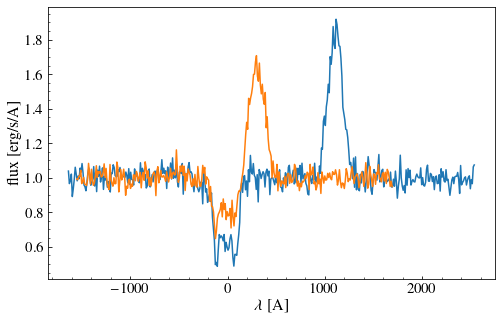

In [28]:
path_to_data = './CII_SiII_fine'   # To change if you move the data

line    = 'CII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 156   # 148, 156 or 164 (A,B and C in Mauerhofer+21). 

v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

l, flux = read_spectrum_si(path_to_data,output) 
idir = 200 # to choose a direction of observation, between 0 and ndirections-1

l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/1260.42 -1)*c

fig,ax = plt.subplots(figsize=(8,5))
plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]))
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)

l, flux = read_spectrum_c(path_to_data,output) 
idir = 200 # to choose a direction of observation, between 0 and ndirections-1

l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/1334.532 -1)*c

plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]))
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)



#### Quick comparison to old 3 time steps simu

In [12]:
directions_1 = np.zeros((1728,3))
for i in range(1728):
    directions_1[i,:] = hp.pix2vec(12,i)

# Function to read the binary files
def read_file(Dir,FileName,ndir):
    f = ff('%s/%s_spectrum'%(Dir,FileName))
    n = f.read_ints()[0]
    aperture,lmin,lmax = f.read_reals('d')
    spec = np.zeros((ndir,n))
    spec[0,:] = f.read_reals('d')
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        spec[j,:] = f.read_reals('d')
    f.close()

    return lmin,lmax,n,spec

# To get the spectra, in the appropriate units
def read_spectrum(output,spec,path_to_data):
    lum_per_packet = np.genfromtxt('%s/IC_photons_%s_%i'%(path_to_data,spec,output))
    lmin,lmax,npix,phot_packets = read_file(path_to_data,'output_%s_%i.out'%(spec,output),1728)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux

path_to_data = './data/'   # To change if you move the data

line    = 'CII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 148    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 


# velocity of the center of mass, to correct for the movement of the galaxy in the simulation box:
v_cm1 = np.genfromtxt('%s/vcm_%i.dat'%(path_to_data,output)) 
# l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
l_1, flux_1 = read_spectrum(output,line,path_to_data) 
l_sys_1 = l_1 + np.dot(directions_1[0,:],v_cm1)/c_cgs*1e5*np.mean(l_1) 



600 [0.96064536 0.         0.27777778] [0.96378882 0.         0.26666667]
0.0222846441947695
0.04461538461532655


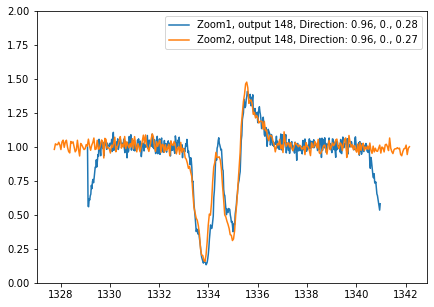

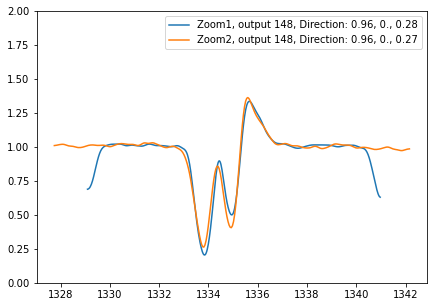

In [13]:
for idx in range(100,101):
    minind = np.min(np.linalg.norm(directions_1-directions[idx], axis = 1))
    ind = np.argmin(np.linalg.norm(directions_1-directions[idx], axis = 1))
   # print(ind, minind)
   # print(directions_1[ind],directions[idx])
# idx = 140
print(ind, directions_1[ind],directions[idx])
l_sys_1 = l_1 + np.dot(directions_1[ind,:],v_cm1)/c_cgs*1e5*np.mean(l_1) 
l_sys_2 = l + np.dot(directions[idx,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(l) 
print(l_sys_1[1]-l_sys_1[0])
print(l_sys_2[1]-l_sys_2[0])

plt.figure(figsize  = (7,5))
plt.plot(l_sys_1, flux_1[ind,:]/np.median(flux_1[ind,:]), label = 'Zoom1, output 148, Direction: 0.96, 0., 0.28')
plt.plot(l_sys_2[1:], flux[idx,1:]/np.median(flux[idx,1:]), label = 'Zoom2, output 148, Direction: 0.96, 0., 0.27')
plt.ylim(0,2)
plt.legend()
plt.figure(figsize  = (7,5))
plt.plot(l_sys_1, gaussian_filter(flux_1[ind,:]/np.median(flux_1[ind,:]),sigma = 6), label = 'Zoom1, output 148, Direction: 0.96, 0., 0.28')
plt.plot(l_sys_2[1:], gaussian_filter(flux[idx,1:]/np.median(flux[idx,1:]), sigma = 3.), label = 'Zoom2, output 148, Direction: 0.96, 0., 0.27')
plt.ylim(0,2)
plt.legend()

### Measuring

In [39]:
path_to_data = './CII_SiII_fine/'   # To change if you move the data

nout = 75
ndir = 300 #(idir 0 and 1 in 148)
# ndir = 75

EWabsLRC = np.zeros((nout,ndir))
EWabsHRC = np.zeros((nout,ndir))
RabsLRC  = np.zeros((nout,ndir))
RabsHRC  = np.zeros((nout,ndir))
VabsLRC = np.zeros((nout,ndir))
VabsHRC = np.zeros((nout,ndir))
VcenLRC = np.zeros((nout,ndir))
VcenHRC = np.zeros((nout,ndir))
EWemiLRC = np.zeros((nout,ndir))
EWemiHRC = np.zeros((nout,ndir))
VemiLRC = np.zeros((nout,ndir))
VemiHRC = np.zeros((nout,ndir))
FemiLRC = np.zeros((nout,ndir))
FemiHRC = np.zeros((nout,ndir))

EWabsLRSi = np.zeros((nout,ndir))
EWabsHRSi = np.zeros((nout,ndir))
RabsLRSi  = np.zeros((nout,ndir))
RabsHRSi  = np.zeros((nout,ndir))
VabsLRSi = np.zeros((nout,ndir))
VabsHRSi = np.zeros((nout,ndir))
VcenLRSi = np.zeros((nout,ndir))
VcenHRSi = np.zeros((nout,ndir))
EWemiLRSi = np.zeros((nout,ndir))
EWemiHRSi = np.zeros((nout,ndir))
VemiLRSi = np.zeros((nout,ndir))
VemiHRSi = np.zeros((nout,ndir))
FemiLRSi = np.zeros((nout,ndir))
FemiHRSi = np.zeros((nout,ndir))

f = IntProgress(min=0, max=nout) # instantiate the bar
display(f) # display the bar

v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)
rMods = 61
# fig, axs = plt.subplots(1,2, figsize = (10,5))
#for output in range(90,165,1):
for output in range(90,165,1):
    f.value += 1# output = 142
    l_c, flux_c = read_spectrum_c(path_to_data,output )
    l_si, flux_si = read_spectrum_si(path_to_data,output )
    vGal = v_cm[:,output-90]

    for idir in range(300):
        l_sys_c = l_c + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_c)
        l_sys_c =l_sys_c[1:]
        vcII   = (l_sys_c/wcII1334 -1)*c
        sigma_pixel = rMods / 2.355 / ((vcII[50]-vcII[49]))
        
        fluxdir = flux_c[idir,1:]
        fluxdir /= np.nanmedian(fluxdir[(vcII>1000)])
        
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1000)])
            
        EWabsHRC[output-90, idir], oo = measureEWabs(l_sys_c, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     -800, 500)
        EWabsLRC[output-90,idir], oo = measureEWabs(l_sys_c, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                    -800, 500)

        EWemiHRC[output-90,idir], oo = measureEWemi(l_sys_c, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                    -200, 800)
        EWemiLRC[output-90,idir], oo = measureEWemi(l_sys_c, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                    -200, 800)

        VabsHRC[output-90,idir], oo, RabsHRC[output-90,idir], ooo = measureMinVel(vcII, fluxdir.copy(), 
                                                                             np.zeros(len(fluxdir)), -800, 500)
        VabsLRC[output-90,idir], oo , RabsLRC[output-90,idir], ooo = measureMinVel(vcII, model.copy(), 
                                                                              np.zeros(len(fluxdir)), -800, 500)
        
        VcenHRC[output-90,idir],oo = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -800, 500)
        VcenLRC[output-90,idir],oo = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -800, 500)

        
        VemiHRC[output-90,idir], oo, FemiHRC[output-90,idir], ooo = measureMaxVel(vcII, fluxdir.copy(), 
                                                                             np.zeros(len(fluxdir)), -200, 800)
        VemiLRC[output-90,idir], oo, FemiLRC[output-90,idir], ooo = measureMaxVel(vcII, model.copy(), 
                                                                             np.zeros(len(fluxdir)), -200, 800)
                
        l_sys_si = l_si + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_si) 
        l_sys_si =l_sys_si[1:]

        vcII   = (l_sys_si/1260.42 -1)*c
        sigma_pixel = rMods / 2.355/ ((vcII[50]-vcII[49]))
        
        fluxdir = flux_si[idir,1:]
        fluxdir/= np.nanmedian(fluxdir[(vcII>1500)])
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1500)])
        
        
        #if(output == 102):
       # axs[1].plot(vcII,model)

        EWabsHRSi[output-90,idir], oo = measureEWabs(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                     -800, 500)
        EWabsLRSi[output-90,idir], oo = measureEWabs(l_sys_si, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                     -800, 500)

        EWemiHRSi[output-90,idir], oo = measureEWemi(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     600, 1400)
        EWemiLRSi[output-90,idir], oo = measureEWemi(l_sys_si, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                     600, 1400)

        VabsHRSi[output-90,idir], oo, RabsHRSi[output-90,idir],ooo = measureMinVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), -800, 500)
        VabsLRSi[output-90,idir], oo , RabsLRSi[output-90,idir],ooo = measureMinVel(vcII, model.copy(), 
                                                                                np.zeros(len(fluxdir)), -800, 500)

        VcenHRSi[output-90,idir],oo = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -800, 500)
        VcenLRSi[output-90,idir],oo = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -800, 500)
        
        
        VemiHRSi[output-90,idir], oo, FemiHRSi[output-90,idir],oooo = measureMaxVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        VemiLRSi[output-90,idir], oo, FemiLRSi[output-90,idir],ooo = measureMaxVel(vcII, model.copy(), 
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        if(FemiHRSi[output-90,idir]<1.15):
             VemiHRSi[output-90,idir] = np.nan
        if(FemiLRSi[output-90,idir]<1.15):
             VemiLRSi[output-90,idir] = np.nan       
        if(FemiHRC[output-90,idir]<1.15):
             VemiHRC[output-90,idir] = np.nan
        if(FemiLRC[output-90,idir]<1.15):
             VemiLRC[output-90,idir] = np.nan  


IntProgress(value=0, max=75)

In [40]:
for i in range(75):
    df = pd.DataFrame(np.vstack((np.linspace(0,299,300),  
                                 EWabsHRC[i,:], EWabsLRC[i,:], 
                                 EWemiHRC[i,:], EWemiLRC[i,:], 
                                 VabsHRC[i,:], VabsLRC[i,:], 
                                 VcenHRC[i,:], VcenLRC[i,:], 
                                 VemiHRC[i,:], VemiLRC[i,:],
                                 RabsHRC[i,:], RabsLRC[i,:], 
                                 FemiHRC[i,:], FemiLRC[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    df.to_csv("CII_SiII_fine/CII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 
    
    dff = pd.DataFrame(np.vstack((np.linspace(0,299,300), 
                                  EWabsHRSi[i,:], EWabsLRSi[i,:], 
                                  EWemiHRSi[i,:], EWemiLRSi[i,:], 
                                  VabsHRSi[i,:], VabsLRSi[i,:],
                                  VcenHRSi[i,:], VcenLRSi[i,:], 
                                  VemiHRSi[i,:], VemiLRSi[i,:], 
                                  RabsHRSi[i,:], RabsLRSi[i,:], 
                                  FemiHRSi[i,:], FemiLRSi[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    dff.to_csv("CII_SiII_fine/SiII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 

## Reading - measuring - 75 TS - 300 Dir - New dust

### Reading spectra

Text(0, 0.5, 'flux [erg/s/A]')

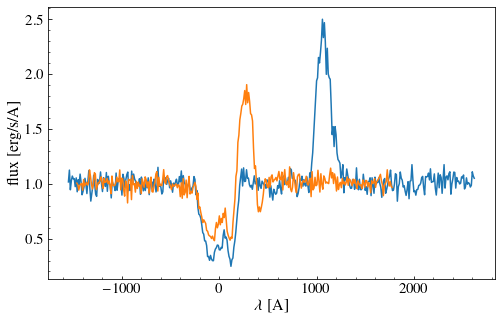

In [8]:
path_to_data = './CII_SiII_ND'   # To change if you move the data

line    = 'CII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 96    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 

v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

l, flux = read_spectrum_si(path_to_data,output) 
idir = 113 # to choose a direction of observation, between 0 and ndirections-1

l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/1260.42 -1)*c

fig,ax = plt.subplots(figsize=(8,5))
plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]))
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)

l, flux = read_spectrum_c(path_to_data,output) 
idir = 113 # to choose a direction of observation, between 0 and ndirections-1

l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/1334.532 -1)*c

plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]))
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)



In [148]:
path_to_data = './CII_SiII_ND/'   # To change if you move the data

nout = 75
ndir = 300 #(idir 0 and 1 in 148)
# ndir = 75

EWabsLRC = np.zeros((nout,ndir))
EWabsHRC = np.zeros((nout,ndir))
RabsLRC  = np.zeros((nout,ndir))
RabsHRC  = np.zeros((nout,ndir))
VabsLRC = np.zeros((nout,ndir))
VabsHRC = np.zeros((nout,ndir))
VcenLRC = np.zeros((nout,ndir))
VcenHRC = np.zeros((nout,ndir))
EWemiLRC = np.zeros((nout,ndir))
EWemiHRC = np.zeros((nout,ndir))
VemiLRC = np.zeros((nout,ndir))
VemiHRC = np.zeros((nout,ndir))
FemiLRC = np.zeros((nout,ndir))
FemiHRC = np.zeros((nout,ndir))

EWabsLRSi = np.zeros((nout,ndir))
EWabsHRSi = np.zeros((nout,ndir))
RabsLRSi  = np.zeros((nout,ndir))
RabsHRSi  = np.zeros((nout,ndir))
VabsLRSi = np.zeros((nout,ndir))
VabsHRSi = np.zeros((nout,ndir))
VcenLRSi = np.zeros((nout,ndir))
VcenHRSi = np.zeros((nout,ndir))
EWemiLRSi = np.zeros((nout,ndir))
EWemiHRSi = np.zeros((nout,ndir))
VemiLRSi = np.zeros((nout,ndir))
VemiHRSi = np.zeros((nout,ndir))
FemiLRSi = np.zeros((nout,ndir))
FemiHRSi = np.zeros((nout,ndir))

f = IntProgress(min=0, max=nout) # instantiate the bar
display(f) # display the bar
rMods = 61
v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)
# fig, axs = plt.subplots(1,2, figsize = (10,5))
#for output in range(90,165,1):
for output in range(90,165,1):
    f.value += 1# output = 142
    l_c, flux_c = read_spectrum_c(path_to_data,output )
    l_si, flux_si = read_spectrum_si(path_to_data,output )
    vGal = v_cm[:,output-90]

    for idir in range(300):
        l_sys_c = l_c + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_c)
        l_sys_c =l_sys_c[1:]
        vcII   = (l_sys_c/wcII1334 -1)*c
        sigma_pixel = rMods / 2.355 / ((vcII[50]-vcII[49]))
        
        fluxdir = flux_c[idir,1:]
        fluxdir /= np.nanmedian(fluxdir[(vcII>1000)])
        
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1000)])
            
        EWabsHRC[output-90, idir], oo = measureEWabs(l_sys_c, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     -800, 500)
        EWabsLRC[output-90,idir], oo = measureEWabs(l_sys_c, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                    -800, 500)

        EWemiHRC[output-90,idir], oo = measureEWemi(l_sys_c, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                    -200, 800)
        EWemiLRC[output-90,idir], oo = measureEWemi(l_sys_c, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                    -200, 800)

        VabsHRC[output-90,idir], oo, RabsHRC[output-90,idir], ooo = measureMinVel(vcII, fluxdir.copy(), 
                                                                             np.zeros(len(fluxdir)), -800, 500)
        VabsLRC[output-90,idir], oo , RabsLRC[output-90,idir], ooo = measureMinVel(vcII, model.copy(), 
                                                                              np.zeros(len(fluxdir)), -800, 500)
        
        VcenHRC[output-90,idir],oo = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -800, 500)
        VcenLRC[output-90,idir],oo = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -800, 500)

        
        VemiHRC[output-90,idir], oo, FemiHRC[output-90,idir], ooo = measureMaxVel(vcII, fluxdir.copy(), 
                                                                             np.zeros(len(fluxdir)), -200, 800)
        VemiLRC[output-90,idir], oo, FemiLRC[output-90,idir], ooo = measureMaxVel(vcII, model.copy(), 
                                                                             np.zeros(len(fluxdir)), -200, 800)
                
        l_sys_si = l_si + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_si) 
        l_sys_si =l_sys_si[1:]

        vcII   = (l_sys_si/1260.42 -1)*c
        sigma_pixel = rMods / 2.355/ ((vcII[50]-vcII[49]))
        
        fluxdir = flux_si[idir,1:]
        fluxdir/= np.nanmedian(fluxdir[(vcII>1500)])
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1500)])
        
        
        #if(output == 102):
       # axs[1].plot(vcII,model)

        EWabsHRSi[output-90,idir], oo = measureEWabs(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                     -800, 500)
        EWabsLRSi[output-90,idir], oo = measureEWabs(l_sys_si, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                     -800, 500)

        EWemiHRSi[output-90,idir], oo = measureEWemi(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     600, 1400)
        EWemiLRSi[output-90,idir], oo = measureEWemi(l_sys_si, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                     600, 1400)

        VabsHRSi[output-90,idir], oo, RabsHRSi[output-90,idir],ooo = measureMinVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), -800, 500)
        VabsLRSi[output-90,idir], oo , RabsLRSi[output-90,idir],ooo = measureMinVel(vcII, model.copy(), 
                                                                                np.zeros(len(fluxdir)), -800, 500)

        VcenHRSi[output-90,idir],oo = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -800, 500)
        VcenLRSi[output-90,idir],oo = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -800, 500)
        
        
        VemiHRSi[output-90,idir], oo, FemiHRSi[output-90,idir],oooo = measureMaxVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        VemiLRSi[output-90,idir], oo, FemiLRSi[output-90,idir],ooo = measureMaxVel(vcII, model.copy(), 
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        if(FemiHRSi[output-90,idir]<1.15):
             VemiHRSi[output-90,idir] = np.nan
        if(FemiLRSi[output-90,idir]<1.15):
             VemiLRSi[output-90,idir] = np.nan       
        if(FemiHRC[output-90,idir]<1.15):
             VemiHRC[output-90,idir] = np.nan
        if(FemiLRC[output-90,idir]<1.15):
             VemiLRC[output-90,idir] = np.nan  


IntProgress(value=0, max=75)

In [149]:
for i in range(75):
    df = pd.DataFrame(np.vstack((np.linspace(0,299,300),  
                                 EWabsHRC[i,:], EWabsLRC[i,:], 
                                 EWemiHRC[i,:], EWemiLRC[i,:], 
                                 VabsHRC[i,:], VabsLRC[i,:], 
                                 VcenHRC[i,:], VcenLRC[i,:], 
                                 VemiHRC[i,:], VemiLRC[i,:],
                                 RabsHRC[i,:], RabsLRC[i,:], 
                                 FemiHRC[i,:], FemiLRC[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    df.to_csv("CII_SiII_ND/CII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 
    
    dff = pd.DataFrame(np.vstack((np.linspace(0,299,300), 
                                  EWabsHRSi[i,:], EWabsLRSi[i,:], 
                                  EWemiHRSi[i,:], EWemiLRSi[i,:], 
                                  VabsHRSi[i,:], VabsLRSi[i,:],
                                  VcenHRSi[i,:], VcenLRSi[i,:], 
                                  VemiHRSi[i,:], VemiLRSi[i,:], 
                                  RabsHRSi[i,:], RabsLRSi[i,:], 
                                  FemiHRSi[i,:], FemiLRSi[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    dff.to_csv("CII_SiII_ND/SiII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 

## Reading - measuring - 75 TS - 300 Dir - Depletion + vturb


### Reading spectra

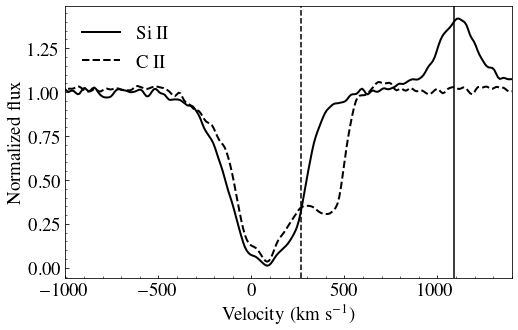

In [52]:
path_to_data = './CII_SiII_depletion'   # To change if you move the data

line    = 'CII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 101    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 

v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

l, flux = read_spectrum_si(path_to_data,output) 
idir = 58 # to choose a direction of observation, between 0 and ndirections-1

l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/1260.42 -1)*c

fig,ax = plt.subplots(figsize=(8,5))
plt.plot(vcII,gaussian_filter(flux[idir,1:]/np.median(flux[idir,1:]),sigma = 1.5), lw = 2, color = 'k',
        label = r'Si II')
plt.xlabel(r'Velocity (km s$^{-1}$)',fontsize=19)
plt.ylabel(r'Normalized flux',fontsize=19)

l, flux = read_spectrum_c(path_to_data,output) 
# idir = 140 # to choose a direction of observation, between 0 and ndirections-1

l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/1334.532 -1)*c

plt.plot(vcII,gaussian_filter(flux[idir,1:]/np.median(flux[idir,1:]),sigma = 1.5), lw = 2, color = 'k', ls = '--',
        label = r'C II')

plt.xlim(-1000, 1400)
plt.axvline(offcIIfluo1335, c = 'k', ls = '--')
plt.axvline(offsiIIfluo1265, c = 'k', ls = '-')
plt.legend(frameon = False, fontsize = 19)
plt.tick_params(labelsize = 19)
plt.savefig('Plots/compSiIICIIsim_large.pdf', bbox_inches = 'tight')

In [15]:
path_to_data = './CII_SiII_depletion/'   # To change if you move the data

nout = 75
ndir = 300 #(idir 0 and 1 in 148)
# ndir = 75

EWabsLRC = np.zeros((nout,ndir))
EWabsHRC = np.zeros((nout,ndir))
RabsLRC  = np.zeros((nout,ndir))
RabsHRC  = np.zeros((nout,ndir))
VabsLRC = np.zeros((nout,ndir))
VabsHRC = np.zeros((nout,ndir))
VcenLRC = np.zeros((nout,ndir))
VcenHRC = np.zeros((nout,ndir))
EWemiLRC = np.zeros((nout,ndir))
EWemiHRC = np.zeros((nout,ndir))
VemiLRC = np.zeros((nout,ndir))
VemiHRC = np.zeros((nout,ndir))
FemiLRC = np.zeros((nout,ndir))
FemiHRC = np.zeros((nout,ndir))

EWabsLRSi = np.zeros((nout,ndir))
EWabsHRSi = np.zeros((nout,ndir))
RabsLRSi  = np.zeros((nout,ndir))
RabsHRSi  = np.zeros((nout,ndir))
VabsLRSi = np.zeros((nout,ndir))
VabsHRSi = np.zeros((nout,ndir))
VcenLRSi = np.zeros((nout,ndir))
VcenHRSi = np.zeros((nout,ndir))
EWemiLRSi = np.zeros((nout,ndir))
EWemiHRSi = np.zeros((nout,ndir))
VemiLRSi = np.zeros((nout,ndir))
VemiHRSi = np.zeros((nout,ndir))
FemiLRSi = np.zeros((nout,ndir))
FemiHRSi = np.zeros((nout,ndir))

f = IntProgress(min=0, max=nout) # instantiate the bar
display(f) # display the bar
rMods = 61
v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)
# fig, axs = plt.subplots(1,2, figsize = (10,5))
#for output in range(90,165,1):
for output in range(90,165,1):
    f.value += 1# output = 142
    l_c, flux_c = read_spectrum_c(path_to_data,output )
    l_si, flux_si = read_spectrum_si(path_to_data,output )
    vGal = v_cm[:,output-90]

    for idir in range(300):
        l_sys_c = l_c + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_c)
        l_sys_c =l_sys_c[1:]
        vcII   = (l_sys_c/wcII1334 -1)*c
        sigma_pixel = rMods / 2.355 / ((vcII[50]-vcII[49]))
        
        fluxdir = flux_c[idir,1:]
        fluxdir /= np.nanmedian(fluxdir[(vcII>1000)])
        
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1000)])
            
        EWabsHRC[output-90, idir], oo = measureEWabs(l_sys_c, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     -800, 500)
        EWabsLRC[output-90,idir], oo = measureEWabs(l_sys_c, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                    -800, 500)

        EWemiHRC[output-90,idir], oo = measureEWemi(l_sys_c, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                    -200, 800)
        EWemiLRC[output-90,idir], oo = measureEWemi(l_sys_c, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                    -200, 800)

        VabsHRC[output-90,idir], oo, RabsHRC[output-90,idir], ooo = measureMinVel(vcII, fluxdir.copy(), 
                                                                             np.zeros(len(fluxdir)), -800, 500)
        VabsLRC[output-90,idir], oo , RabsLRC[output-90,idir], ooo = measureMinVel(vcII, model.copy(), 
                                                                              np.zeros(len(fluxdir)), -800, 500)
        
        VcenHRC[output-90,idir],oo = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -800, 500)
        VcenLRC[output-90,idir],oo = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -800, 500)

        
        VemiHRC[output-90,idir], oo, FemiHRC[output-90,idir], ooo = measureMaxVel(vcII, fluxdir.copy(), 
                                                                             np.zeros(len(fluxdir)), -200, 800)
        VemiLRC[output-90,idir], oo, FemiLRC[output-90,idir], ooo = measureMaxVel(vcII, model.copy(), 
                                                                             np.zeros(len(fluxdir)), -200, 800)
                
        l_sys_si = l_si + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_si) 
        l_sys_si =l_sys_si[1:]

        vcII   = (l_sys_si/1260.42 -1)*c
        sigma_pixel = rMods / 2.355/ ((vcII[50]-vcII[49]))
        
        fluxdir = flux_si[idir,1:]
        fluxdir/= np.nanmedian(fluxdir[(vcII>1500)])
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1500)])
        
        
        #if(output == 102):
       # axs[1].plot(vcII,model)

        EWabsHRSi[output-90,idir], oo = measureEWabs(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                     -800, 500)
        EWabsLRSi[output-90,idir], oo = measureEWabs(l_sys_si, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                     -800, 500)

        EWemiHRSi[output-90,idir], oo = measureEWemi(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     600, 1400)
        EWemiLRSi[output-90,idir], oo = measureEWemi(l_sys_si, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                     600, 1400)

        VabsHRSi[output-90,idir], oo, RabsHRSi[output-90,idir],ooo = measureMinVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), -800, 500)
        VabsLRSi[output-90,idir], oo , RabsLRSi[output-90,idir],ooo = measureMinVel(vcII, model.copy(), 
                                                                                np.zeros(len(fluxdir)), -800, 500)

        VcenHRSi[output-90,idir],oo = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -800, 500)
        VcenLRSi[output-90,idir],oo = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -800, 500)
        
        
        VemiHRSi[output-90,idir], oo, FemiHRSi[output-90,idir],oooo = measureMaxVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        VemiLRSi[output-90,idir], oo, FemiLRSi[output-90,idir],ooo = measureMaxVel(vcII, model.copy(), 
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        if(FemiHRSi[output-90,idir]<1.15):
             VemiHRSi[output-90,idir] = np.nan
        if(FemiLRSi[output-90,idir]<1.15):
             VemiLRSi[output-90,idir] = np.nan       
        if(FemiHRC[output-90,idir]<1.15):
             VemiHRC[output-90,idir] = np.nan
        if(FemiLRC[output-90,idir]<1.15):
             VemiLRC[output-90,idir] = np.nan  


IntProgress(value=0, max=75)

In [16]:
for i in range(75):
    df = pd.DataFrame(np.vstack((np.linspace(0,299,300),  
                                 EWabsHRC[i,:], EWabsLRC[i,:], 
                                 EWemiHRC[i,:], EWemiLRC[i,:], 
                                 VabsHRC[i,:], VabsLRC[i,:], 
                                 VcenHRC[i,:], VcenLRC[i,:], 
                                 VemiHRC[i,:], VemiLRC[i,:],
                                 RabsHRC[i,:], RabsLRC[i,:], 
                                 FemiHRC[i,:], FemiLRC[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    df.to_csv("CII_SiII_depletion/CII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 
    
    dff = pd.DataFrame(np.vstack((np.linspace(0,299,300), 
                                  EWabsHRSi[i,:], EWabsLRSi[i,:], 
                                  EWemiHRSi[i,:], EWemiLRSi[i,:], 
                                  VabsHRSi[i,:], VabsLRSi[i,:],
                                  VcenHRSi[i,:], VcenLRSi[i,:], 
                                  VemiHRSi[i,:], VemiLRSi[i,:], 
                                  RabsHRSi[i,:], RabsLRSi[i,:], 
                                  FemiHRSi[i,:], FemiLRSi[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    dff.to_csv("CII_SiII_depletion/SiII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 

## Reading - measuring - 1 TS - 300 directions

### New dust

findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.


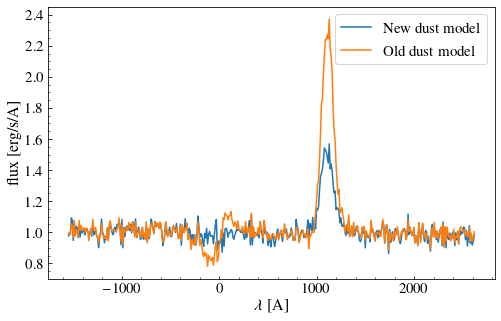

In [11]:
path_to_data = './new_dust_output_148/'   # To change if you move the data
output  = 148    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 
v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

f = ff('./new_dust_output_148/IC_photons_1000000_nphots')    
a = f.read_ints()
lum_per_packet = f.read_reals()
f.close()
lum_per_packet = lum_per_packet/a
lmin,lmax,npix,phot_packets = \
    read_file( './new_dust_output_148/','output.out', ndirections)
dl   = (lmax - lmin) / npix                  # [A] 
l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
flux = flux / dl                             # [erg / s / A / phot packet]
flux = flux * phot_packets                   # [erg / s/ A]

idir = 0 # to choose a direction of observation, between 0 and ndirections-1

l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/1260.42 -1)*c

fig,ax = plt.subplots(figsize=(8,5))
plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]), label='New dust model')
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)


path_to_data = './CII_SiII_fine/'   # To change if you move the data

l, flux = read_spectrum_si(path_to_data,output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wsiII1260 -1)*c

plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]), label='Old dust model')
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)
plt.legend()


In [ ]:
path_to_data = './CII_SiII_fine/'   # To change if you move the data

nout = 1
ndir = 300 #(idir 0 and 1 in 148)
# ndir = 75

EWabsLRSi = np.zeros((nout,ndir))
EWabsHRSi = np.zeros((nout,ndir))
RabsLRSi  = np.zeros((nout,ndir))
RabsHRSi  = np.zeros((nout,ndir))
VabsLRSi = np.zeros((nout,ndir))
VabsHRSi = np.zeros((nout,ndir))
VcenLRSi = np.zeros((nout,ndir))
VcenHRSi = np.zeros((nout,ndir))
EWemiLRSi = np.zeros((nout,ndir))
EWemiHRSi = np.zeros((nout,ndir))
VemiLRSi = np.zeros((nout,ndir))
VemiHRSi = np.zeros((nout,ndir))
FemiLRSi = np.zeros((nout,ndir))
FemiHRSi = np.zeros((nout,ndir))

f = IntProgress(min=0, max=nout) # instantiate the bar
display(f) # display the bar

v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)
# fig, axs = plt.subplots(1,2, figsize = (10,5))
#for output in range(90,165,1):
for output in range(148,149,1):
    f.value += 1# output = 142
    f = ff('./new_dust_output_148/IC_photons_1000000_nphots')    
    a = f.read_ints()
    lum_per_packet = f.read_reals()
    f.close()
    lum_per_packet = lum_per_packet/a
    lmin,lmax,npix,phot_packets = \
        read_file( './new_dust_output_148/','output.out', ndirections)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]

    vGal = v_cm[:,output-90]

    for idir in range(300):
        l_sys_si = l + np.dot(directions[idir,:], vGal)/c_cgs*1e5*np.mean(l)
        l_sys_si =l_sys_si[1:]

        vcII   = (l_sys_si/1260.42 -1)*c
        sigma_pixel = 71 / 2.355/ ((vcII[50]-vcII[49]))
        
        fluxdir = flux[idir,1:]
        fluxdir/= np.nanmedian(fluxdir[(vcII>1500)])
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1500)])
        
        plt.plot(vcII,model)
        #if(output == 102):
       # axs[1].plot(vcII,model)

        EWabsHRSi[output-148,idir], oo = measureEWabs(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                     -1000, 500)
        EWabsLRSi[output-148,idir], oo = measureEWabs(l_sys_si, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                     -1000, 500)

        EWemiHRSi[output-148,idir], oo = measureEWemi(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     600, 1400)
        EWemiLRSi[output-148,idir], oo = measureEWemi(l_sys_si, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                     600, 1400)

        VabsHRSi[output-148,idir], oo, RabsHRSi[output-148,idir] = measureMinVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), -1000, 500)
        VabsLRSi[output-148,idir], oo , RabsLRSi[output-148,idir] = measureMinVel(vcII, model.copy(), 
                                                                                np.zeros(len(fluxdir)), -1000, 500)

        VcenHRSi[output-148,idir] = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -1000, 500)
        VcenLRSi[output-148,idir] = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -1000, 500)
        
        
        VemiHRSi[output-148,idir], oo, FemiHRSi[output-148,idir] = measureMaxVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        VemiLRSi[output-148,idir], oo, FemiLRSi[output-148,idir] = measureMaxVel(vcII, model.copy(), 
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        if(FemiHRSi[output-148,idir]<1.15):
             VemiHRSi[output-148,idir] = np.nan
        if(FemiLRSi[output-148,idir]<1.15):
             VemiLRSi[output-148,idir] = np.nan       
#         if(FemiHRC[output-90,idir]<1.15):
#              VemiHRC[output-90,idir] = np.nan
#         if(FemiLRC[output-90,idir]<1.15):
#              VemiLRC[output-90,idir] = np.nan  


In [22]:
for i in range(1):
#     df = pd.DataFrame(np.vstack((np.linspace(0,299,300),  
#                                  EWabsHRC[i,:], EWabsLRC[i,:], 
#                                  EWemiHRC[i,:], EWemiLRC[i,:], 
#                                  VabsHRC[i,:], VabsLRC[i,:], 
#                                  VcenHRC[i,:], VcenLRC[i,:], 
#                                  VemiHRC[i,:], VemiLRC[i,:],
#                                  RabsHRC[i,:], RabsLRC[i,:], 
#                                  FemiHRC[i,:], FemiLRC[i,:])).T) # A is a numpy 2d array
#     C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
#        'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
#        'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
#     df.to_csv("CII_SiII_fine/CII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 
    
    dff = pd.DataFrame(np.vstack((np.linspace(0,299,300), 
                                  EWabsHRSi[i,:], EWabsLRSi[i,:], 
                                  EWemiHRSi[i,:], EWemiLRSi[i,:], 
                                  VabsHRSi[i,:], VabsLRSi[i,:],
                                  VcenHRSi[i,:], VcenLRSi[i,:], 
                                  VemiHRSi[i,:], VemiLRSi[i,:], 
                                  RabsHRSi[i,:], RabsLRSi[i,:], 
                                  FemiHRSi[i,:], FemiLRSi[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    dff.to_csv("new_dust_output_148/SiII_%d_300.csv"%(i+148), sep=',', header= C, index=False) 

### Diff continuum

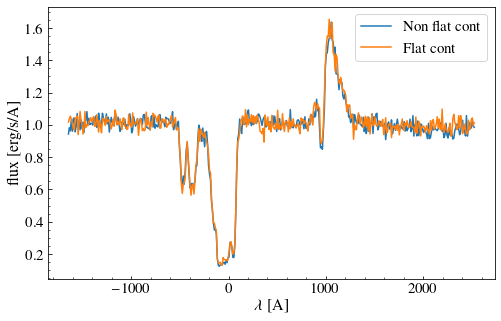

In [26]:
path_to_data = './non_flat_continuum_output_148/'   # To change if you move the data
output  = 148    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 
v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

f = ff('./new_dust_output_148/IC_photons_1000000_nphots')    
a = f.read_ints()
lum_per_packet = f.read_reals()
f.close()
lum_per_packet = lum_per_packet/a
lmin,lmax,npix,phot_packets = \
    read_file( './non_flat_continuum_output_148/','output.out', ndirections)
dl   = (lmax - lmin) / npix                  # [A] 
l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
flux = flux / dl                             # [erg / s / A / phot packet]
flux = flux * phot_packets                   # [erg / s/ A]

idir = 200 # to choose a direction of observation, between 0 and ndirections-1

l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/1260.42 -1)*c

fig,ax = plt.subplots(figsize=(8,5))
plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]), label='Non flat cont')
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)


path_to_data = './CII_SiII_fine/'   # To change if you move the data

l, flux = read_spectrum_si(path_to_data,output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wsiII1260 -1)*c

plt.plot(vcII,flux[idir,1:]/np.median(flux[idir,1:]), label='Flat cont')
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)
plt.legend()


In [ ]:
path_to_data = './CII_SiII_fine/'   # To change if you move the data

nout = 1
ndir = 300 #(idir 0 and 1 in 148)
# ndir = 75

EWabsLRSi = np.zeros((nout,ndir))
EWabsHRSi = np.zeros((nout,ndir))
RabsLRSi  = np.zeros((nout,ndir))
RabsHRSi  = np.zeros((nout,ndir))
VabsLRSi = np.zeros((nout,ndir))
VabsHRSi = np.zeros((nout,ndir))
VcenLRSi = np.zeros((nout,ndir))
VcenHRSi = np.zeros((nout,ndir))
EWemiLRSi = np.zeros((nout,ndir))
EWemiHRSi = np.zeros((nout,ndir))
VemiLRSi = np.zeros((nout,ndir))
VemiHRSi = np.zeros((nout,ndir))
FemiLRSi = np.zeros((nout,ndir))
FemiHRSi = np.zeros((nout,ndir))

f = IntProgress(min=0, max=nout) # instantiate the bar
display(f) # display the bar

v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)
# fig, axs = plt.subplots(1,2, figsize = (10,5))
#for output in range(90,165,1):
for output in range(148,149,1):
    f.value += 1# output = 142
    f = ff('./non_flat_continuum_output_148/IC_photons_1000000_nphots')    
    a = f.read_ints()
    lum_per_packet = f.read_reals()
    f.close()
    lum_per_packet = lum_per_packet/a
    lmin,lmax,npix,phot_packets = \
        read_file( './non_flat_continuum_output_148/','output.out', ndirections)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]

    vGal = v_cm[:,output-90]

    for idir in range(300):
        l_sys_si = l + np.dot(directions[idir,:], vGal)/c_cgs*1e5*np.mean(l)
        l_sys_si =l_sys_si[1:]

        vcII   = (l_sys_si/1260.42 -1)*c
        sigma_pixel = 71 / 2.355/ ((vcII[50]-vcII[49]))
        
        fluxdir = flux[idir,1:]
        fluxdir/= np.nanmedian(fluxdir[(vcII>1500)])
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
        model = model/np.nanmedian(model[(vcII>1500)])
        
        plt.plot(vcII,model)
        #if(output == 102):
       # axs[1].plot(vcII,model)

        EWabsHRSi[output-148,idir], oo = measureEWabs(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)), 
                                                     -1000, 500)
        EWabsLRSi[output-148,idir], oo = measureEWabs(l_sys_si, vcII, model.copy(),   np.zeros(len(fluxdir)),
                                                     -1000, 500)

        EWemiHRSi[output-148,idir], oo = measureEWemi(l_sys_si, vcII, fluxdir.copy(), np.zeros(len(fluxdir)),
                                                     600, 1400)
        EWemiLRSi[output-148,idir], oo = measureEWemi(l_sys_si, vcII, model.copy()  , np.zeros(len(fluxdir)),
                                                     600, 1400)

        VabsHRSi[output-148,idir], oo, RabsHRSi[output-148,idir] = measureMinVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), -1000, 500)
        VabsLRSi[output-148,idir], oo , RabsLRSi[output-148,idir] = measureMinVel(vcII, model.copy(), 
                                                                                np.zeros(len(fluxdir)), -1000, 500)

        VcenHRSi[output-148,idir] = measureCenV(vcII, fluxdir.copy(), np.zeros(len(fluxdir)), -1000, 500)
        VcenLRSi[output-148,idir] = measureCenV(vcII, model.copy(), np.zeros(len(fluxdir)), -1000, 500)
        
        
        VemiHRSi[output-148,idir], oo, FemiHRSi[output-148,idir] = measureMaxVel(vcII, fluxdir.copy(),
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        VemiLRSi[output-148,idir], oo, FemiLRSi[output-148,idir] = measureMaxVel(vcII, model.copy(), 
                                                                               np.zeros(len(fluxdir)), 600, 1400)
        if(FemiHRSi[output-148,idir]<1.15):
             VemiHRSi[output-148,idir] = np.nan
        if(FemiLRSi[output-148,idir]<1.15):
             VemiLRSi[output-148,idir] = np.nan       
#         if(FemiHRC[output-90,idir]<1.15):
#              VemiHRC[output-90,idir] = np.nan
#         if(FemiLRC[output-90,idir]<1.15):
#              VemiLRC[output-90,idir] = np.nan  


In [28]:
for i in range(1):
#     df = pd.DataFrame(np.vstack((np.linspace(0,299,300),  
#                                  EWabsHRC[i,:], EWabsLRC[i,:], 
#                                  EWemiHRC[i,:], EWemiLRC[i,:], 
#                                  VabsHRC[i,:], VabsLRC[i,:], 
#                                  VcenHRC[i,:], VcenLRC[i,:], 
#                                  VemiHRC[i,:], VemiLRC[i,:],
#                                  RabsHRC[i,:], RabsLRC[i,:], 
#                                  FemiHRC[i,:], FemiLRC[i,:])).T) # A is a numpy 2d array
#     C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
#        'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
#        'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
#     df.to_csv("CII_SiII_fine/CII_%d_300.csv"%(i+90), sep=',', header= C, index=False) 
    
    dff = pd.DataFrame(np.vstack((np.linspace(0,299,300), 
                                  EWabsHRSi[i,:], EWabsLRSi[i,:], 
                                  EWemiHRSi[i,:], EWemiLRSi[i,:], 
                                  VabsHRSi[i,:], VabsLRSi[i,:],
                                  VcenHRSi[i,:], VcenLRSi[i,:], 
                                  VemiHRSi[i,:], VemiLRSi[i,:], 
                                  RabsHRSi[i,:], RabsLRSi[i,:], 
                                  FemiHRSi[i,:], FemiLRSi[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWabsHR', 'EWabsLR', 'EWemiHR', 'EWemiLR', 
       'VabsHR', 'VabsLR', 'VcenHR', 'VcenLR', 
       'VemiHR', 'VemiLR', 'RabsHR', 'RabsLR', 'FemiHR', 'FemiLR']
    dff.to_csv("non_flat_continuum_output_148/SiII_%d_300.csv"%(i+148), sep=',', header= C, index=False) 

## Cube measurements

In [5]:
nxy,imsize,lcubecII,cubecII = read_cube('./data_cubes_output_148/CII_dep/',300)
print(nxy)
nxy,imsize,lcubeSiII,cubeSiII = read_cube('./data_cubes_output_148/SiII_dep/',300)

64


### Line measurements as function of r

In [29]:
## Light curves + spectra in increasing rings
EWabsCII = np.zeros((300,64))
RabsCII  = np.zeros((300,64))
VcenCII  = np.zeros((300,64))
EWemiCII = np.zeros((300,64))
VemiCII = np.zeros((300,64))
FemiCII = np.zeros((300,64))
ContMedCII = np.zeros((300,64))
EWabsSiII = np.zeros((300,64))
RabsSiII  = np.zeros((300,64))
VcenSiII  = np.zeros((300,64))
EWemiSiII = np.zeros((300,64))
VemiSiII = np.zeros((300,64))
FemiSiII = np.zeros((300,64))
ContMedSiII = np.zeros((300,64))

for idir in range(300):


#     spec = np.sum(cube[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1
    lsyscII    = lcubecII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubecII[1:]) 
    vcII_s  = (lsyscII/wcII1334-1)*c
    
    lsyssiII    = lcubeSiII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiII[1:]) 
    vsiII_s  = (lsyssiII/wsiII1260-1)*c
    
    imagecontcII = np.sum(cubecII[idir,:,:,55:57],axis=(2))#/ (imsize/nxy)**2 
#     imagecontsiII = np.sum(cubeSiII[idir,:,:,55:57],axis=(2))#/ (imsize/nxy)**2 

    y,x = np.where(imagecontcII == np.max(imagecontcII))
    sigma_pixelcII = 70 / 2.355 / ((vcII_s[50]-vcII_s[49]))
    sigma_pixelsiII = 70 / 2.355 / ((vsiII_s[50]-vsiII_s[49]))

    for rad in range(1,64):
        
        aperture = CircularAperture([x[0],y[0]], r=rad) 
        aperture_masks = aperture.to_mask(method='center') # create mask
        fimageoricII = cubecII[idir,:,:,1:].copy()
        fimagecII = []
        for i in range(fimageoricII.shape[-1]):
            fimagecII.append(aperture_masks.multiply(fimageoricII[:,:,i]))
 
        fimageorisiII = cubeSiII[idir,:,:,1:].copy()
        fimagesiII = []
        for i in range(fimageorisiII.shape[-1]):
            fimagesiII.append(aperture_masks.multiply(fimageorisiII[:,:,i]))
            
        spec_centercII = np.sum(np.asarray(fimagecII)[:,:,:],axis=(1,2))
        spec_centersiII = np.sum(np.asarray(fimagesiII)[:,:,:],axis=(1,2))

        rmedCII = ((vcII_s<-500) | (vcII_s > 700)) 
        fmedCII = np.nanmedian(spec_centercII[rmedCII])
        spec_centercII /= fmedCII
        ContMedCII[idir, rad] =  fmedCII
        
        rmedSiII =  ((vsiII_s<-500) | (vsiII_s > 1500)) 
        fmedSiII = np.nanmedian(spec_centersiII[rmedSiII])
        spec_centersiII /= fmedSiII
        ContMedSiII[idir, rad] =  fmedSiII
        
        
        modelcii = gaussian_filter(spec_centercII, sigma = sigma_pixelcII)
        modelsiii = gaussian_filter(spec_centersiII, sigma = sigma_pixelsiII)

       # #if(rad <= 15):
        #    plt.plot(vcII_s,spec_center)
        EWabsCII[idir, rad], oo = measureEWabs(lsyscII, vcII_s, modelcii.copy(), np.zeros(len(modelcii)),
                                                     -800, 500)
        EWabsSiII[idir, rad], oo = measureEWabs(lsyssiII, vsiII_s, modelsiii.copy(), np.zeros(len(modelsiii)),
                                                     -800, 500)
        
        EWemiCII[idir, rad], oo = measureEWemi(lsyscII, vcII_s, modelcii.copy(), np.zeros(len(modelcii)), 
                                                    -200, 800)
        EWemiSiII[idir, rad], oo = measureEWemi(lsyssiII, vsiII_s, modelsiii.copy(), np.zeros(len(modelsiii)), 
                                                    600, 1400)
        
        aa, oo, RabsCII[idir, rad], ooo = measureMinVel(vcII_s, modelcii.copy(), 
                                                                             np.zeros(len(modelcii)), -800, 500)
        aa, oo , RabsSiII[idir, rad], ooo = measureMinVel(vsiII_s, modelsiii.copy(), 
                                                                              np.zeros(len(modelsiii)), -800, 500)
        
        VcenCII[idir,rad], oo = measureCenV(vcII_s, modelcii.copy(), np.zeros(len(modelcii)), -800, 500)
        VcenSiII[idir,rad], oo = measureCenV(vsiII_s, modelsiii.copy(), np.zeros(len(modelsiii)), -800, 500)
        
#         if(RabsCII[idir, rad] < 0.05):
#             plt.plot(vsiII_s,modelsiii )
# #             plt.show()
#             break
        VemiCII[idir, rad], oo, FemiCII[idir, rad], ooo = measureMaxVel(vcII_s, modelcii.copy(), 
                                                                np.zeros(len(modelcii)), -200, 800)
  
        VemiSiII[idir, rad], oo, FemiSiII[idir, rad], ooo = measureMaxVel(vsiII_s, modelsiii.copy(), 
                                                                np.zeros(len(modelsiii)), 600, 1400)
          
        
#         VemiHRSi[output-90,idir], oo, FemiHRSi[output-90,idir],oooo = measureMaxVel(vcII, fluxdir.copy(),
#                                                                                np.zeros(len(fluxdir)), 600, 1400)
#         VemiLRSi[output-90,idir], oo, FemiLRSi[output-90,idir],ooo = measureMaxVel(vcII, model.copy(), 
#                                                                                np.zeros(len(fluxdir)), 600, 1400)

In [30]:
for i in range(300):
    df = pd.DataFrame(np.vstack((np.arange(1,64,1),  
                                 EWabsCII[i,1:], EWemiCII[i,1:], 
                                 VcenCII[i,1:], VemiCII[i,1:], 
                                 RabsCII[i,1:], FemiCII[i,1:], ContMedCII[i,1:])).T) # A is a numpy 2d array
    C=['r', 'EWabs', 'EWemi',  'Vcen', 'Vemi', 'Rabs', 'Femi', 'Cont']
    df.to_csv("csv/CII_image_%d.csv"%(i), sep=',', header= C, index=False) 
    

    df = pd.DataFrame(np.vstack((np.arange(1,64,1),  
                                 EWabsSiII[i,1:], EWemiSiII[i,1:], 
                                 VcenSiII[i,1:], VemiSiII[i,1:], 
                                 RabsSiII[i,1:], FemiSiII[i,1:], ContMedSiII[i,1:])).T) # A is a numpy 2d array
    C=['r', 'EWabs', 'EWemi',  'Vcen', 'Vemi', 'Rabs', 'Femi', 'Cont']
    df.to_csv("csv/SiII_image_%d.csv"%(i), sep=',', header= C, index=False) 
    

### Light_curve (interval)

In [112]:
## Light curves + spectra in increasing rings
nrad = 50
rrad  = np.zeros(nrad)

ndir = 300

rfluxcontcii = np.zeros((ndir,nrad))
totalcontcii= np.zeros((ndir,nrad))
rfluxfluocii = np.zeros((ndir,nrad))
totalfluocii = np.zeros((ndir,nrad))
rfluxcontsiii = np.zeros((ndir,nrad))
totalcontsiii= np.zeros((ndir,nrad))
rfluxfluosiii = np.zeros((ndir,nrad))
totalfluosiii = np.zeros((ndir,nrad))

for idir in range(ndir):


#     spec = np.sum(cube[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1
    lsyscII    = lcubecII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubecII[1:]) 
    vcII_s  = (lsyscII/wcII1334-1)*c
    
    lsyssiII    = lcubeSiII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiII[1:]) 
    vsiII_s  = (lsyssiII/wsiII1260-1)*c
    
    imagecontcII = np.sum(cubecII[idir,:,:,40:50],axis=(2))#/ (imsize/nxy)**2 
#     imagecontsiII = np.sum(cubeSiII[idir,:,:,55:57],axis=(2))#/ (imsize/nxy)**2 

    y,x = np.where(imagecontcII == np.max(imagecontcII))


    fimageoricII = cubecII[idir,:,:,1:].copy()
    fimageorisiII = cubeSiII[idir,:,:,1:].copy()

    
    aperture = CircularAperture([x[0],y[0]], r=1) 
    aperture_masks = aperture.to_mask(method='center') # create mask
    fimagecII = []
    for i in range(fimageoricII.shape[-1]):
        fimagecII.append(aperture_masks.multiply(fimageoricII[:,:,i]))
 
    fimagesiII = []
    for i in range(fimageorisiII.shape[-1]):
        fimagesiII.append(aperture_masks.multiply(fimageorisiII[:,:,i]))

    fimagecII = np.asarray(fimagecII)
    fimagesiII = np.asarray(fimagesiII)
    
#     maskcII = (vcII_s>234)  & (vcII_s < 294)
    maskcII = (vcII_s>250)  & (vcII_s < 310)
#     print(np.arange(0,len(maskcII),1)[maskcII][0])
    fcontcII =  np.nansum(fimagecII[10:10+sum(maskcII==1),:,:], axis = 0)
    ffluocII =  np.nansum(fimagecII[maskcII,:,:], axis = 0) - fcontcII

    masksiII = (vsiII_s>1070)  & (vsiII_s < 1130)
    
    fcontsiII =  np.nansum(fimagesiII[10:10+sum(masksiII==1),:,:], axis = 0)
    ffluosiII =  np.nansum(fimagesiII[masksiII,:,:], axis = 0) - fcontsiII
#     plt.imshow(np.log(fcontcII))
#     plt.figure()
#     plt.imshow(np.log(ffluocII))
    
#     plt.figure()
#     plt.plot(vcII_s, np.sum(fimagecII[:,:,:], axis = (1,2)))
#     plt.axvline(vcII_s[174])
#     plt.axvline(vcII_s[174])
#     plt.axvline(310)

    rrad[0]      = 0.5

    rfluxcontcii[idir, 0] = np.sum(fcontcII)
    totalcontcii[idir, 0] = rfluxcontcii[idir,0]
    rfluxfluocii[idir, 0] = np.sum(ffluocII[ffluocII>0])#[ffluocII>0]
    totalfluocii[idir, 0] = rfluxfluocii[idir,0]
    
    rfluxcontsiii[idir, 0] = np.sum(fcontsiII)
    totalcontsiii[idir, 0] = rfluxcontsiii[idir,0]
    rfluxfluosiii[idir, 0] = np.sum(ffluosiII[ffluosiII>0]) #[ffluosiII>0]
    totalfluosiii[idir, 0] = rfluxfluosiii[idir,0]
    
    # plt.imshow(fimage2)
    for kk in range(1,nrad):
        ppix1 = kk 
        ppix2 = (kk+1) 
        aperture2 = CircularAnnulus([x[0],y[0]], r_in=ppix1, r_out=ppix2) 
        aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask
        fimagecII = []
        for i in range(fimageoricII.shape[-1]):
            fimagecII.append(aperture_masks2.multiply(fimageoricII[:,:,i]))

        fimagesiII = []
        for i in range(fimageorisiII.shape[-1]):
            fimagesiII.append(aperture_masks2.multiply(fimageorisiII[:,:,i]))

        fimagecII = np.asarray(fimagecII)
        fimagesiII = np.asarray(fimagesiII)

#         maskcII = (vcII_s>214)  & (vcII_s < 314)

        fcontcII =  np.nansum(fimagecII[10:10+sum(maskcII==1),:,:], axis = 0)
        ffluocII =  np.nansum(fimagecII[maskcII,:,:], axis = 0) - fcontcII

        
#         masksiII = (vsiII_s>1040)  & (vsiII_s < 1140)
    
        fcontsiII =  np.nansum(fimagesiII[10:10+sum(masksiII==1),:,:], axis = 0)
        ffluosiII =  np.nansum(fimagesiII[masksiII,:,:], axis = 0) - fcontsiII
        rrad[kk]  = kk + 1
        rfluxcontcii[idir,kk] = np.nansum(fcontcII)
        totalcontcii[idir,kk] = totalcontcii[idir,kk-1] + rfluxcontcii[idir,kk]
        rfluxfluocii[idir,kk] = np.nansum(ffluocII[ffluocII>0]) #[ffluocII>0]
        totalfluocii[idir,kk] = totalfluocii[idir,kk-1] + rfluxfluocii[idir,kk]    
 
        rfluxcontsiii[idir,kk] = np.nansum(fcontsiII)
        totalcontsiii[idir,kk] = totalcontsiii[idir,kk-1] + rfluxcontsiii[idir,kk]
        rfluxfluosiii[idir,kk] = np.nansum(ffluosiII[ffluosiII>0]) #[ffluosiII>0]
        totalfluosiii[idir,kk] = totalfluosiii[idir,kk-1] + rfluxfluosiii[idir,kk]  
        
# f  = interpolate.interp1d(rrad, rfluxcontcii)
# ft = interpolate.interp1d(rrad, totalcontcii)
# xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)
# ynew  = f(xnew)   # use interpolation function returned by `interp1d`
# ytnew = ft(xnew) 
# plt.figure(figsize = (10,8))
# plt.plot(xnew,ynew)
# plt.plot(xnew,ytnew)

# #         print(rflux)
# #         zero_flux = np.max(rflux)*0.05
# #         r100s = xnew[(xnew > 1) & (ynew >= 0.99*zero_flux) & (ynew <= 1.01*zero_flux)  ]
# # print(0.9999* np.max(totalcontcii))
# # r100s = xnew[(xnew > 1) & (ytnew == 0.9999* np.max(totalcontcii)) ]
# # r100  = r100s
# # if len(r100s > 1): r100 = r100s[0]

# half_flux = np.max(ytnew)/2.0
# plt.axvline(xnew[(xnew > 1) & (np.round(ytnew,1) >= half_flux)][0])
# print(half_flux,xnew[(xnew > 1) & (np.round(ytnew,1) >= half_flux)][0])
# r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnew,1) >= half_flux)]) #& (np.round(ytnew,1) < half_flux*1.0)
# r50 = r50s
# if len(r50s > 1): r50 = r50s[0]
# r50  = np.round(r50,3)


# plt.figure(figsize = (10,8))
# plt.plot(rrad*(imsize/nxy),np.log10(rfluxcontcii),label='Light Profile at continuum')
# plt.plot(rrad*(imsize/nxy),np.log10(rfluxfluocii),label='Light Profile at ~1335*')
# plt.axvline(r50)
# # plt.axvline((imsize/nxy)*r100)

# plt.xlabel('Radius (parsec)', fontsize = 18)
# plt.ylabel('Surface brightness', fontsize = 18)
# plt.legend()
# plt.xlim(-10,5500)

(0.0, 5500.0)

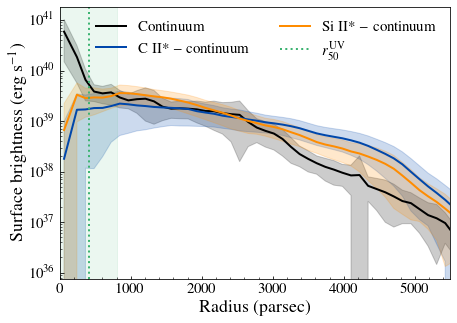

In [113]:


meanrfluxcII = np.nanmean(rfluxcontcii, axis = 0)
stdrfluxcII = np.nanstd(rfluxcontcii, axis = 0)
stdrfluxcII[(meanrfluxcII-stdrfluxcII)< 0] = stdrfluxcII[(meanrfluxcII-stdrfluxcII)< 0]*0.6
stdrfluxcII = gaussian_filter(stdrfluxcII,sigma = 1)
meantotfcII = np.mean(totalcontcii, axis = 0)

meanrfluxsiII = np.nanmean(rfluxcontsiii, axis = 0)
stdrfluxsiII = np.nanstd(rfluxcontsiii, axis = 0)
stdrfluxsiII[(meanrfluxsiII-stdrfluxsiII)< 0] = stdrfluxsiII[(meanrfluxsiII-stdrfluxsiII)< 0]*0.6
# stdrfluxsiII = gaussian_filter(stdrfluxsiII,sigma = 1)


meantotfsiII = np.mean(totalcontsiii, axis = 0)
r50cii = np.zeros(300)
r50siii = np.zeros(300)

for i in range(300):
    
    xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)

    f  = interpolate.interp1d(rrad, rfluxcontcii[i])
    ft = interpolate.interp1d(rrad, totalcontcii[i])
    ynewcii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewcii = ft(xnew) 
#     print(len(rrad), len(rfluxcontcii[i]))
    f  = interpolate.interp1d(rrad, rfluxcontsiii[i])
    ft = interpolate.interp1d(rrad, totalcontsiii[i])
    ynewsiii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewsiii = ft(xnew) 

    half_fluxcii = np.max(ytnewcii)/2.0
    half_fluxsiii = np.max(ytnewsiii)/2.0

#     print(half_fluxcii,half_fluxsiii)
    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewcii,1) >= half_fluxcii)])
#     r50cii = r50s
    if len(r50s > 1): r50cii[i] = r50s[0]
    else: r50cii[i] = r50s

    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewsiii,1) >= half_fluxsiii)])
#     r50siii = r50s
    if len(r50s > 1): r50siii[i] = r50s[0]
    else: r50siii[i] = r50s

plt.figure(figsize = (7,5))
plt.plot(rrad*(imsize/nxy),meanrfluxsiII,label='Continuum', c = 'k', linewidth = 2)
plt.fill_between(rrad*(imsize/nxy),meanrfluxsiII+stdrfluxsiII,
                 meanrfluxsiII - stdrfluxsiII, color= 'k', alpha = 0.2)
plt.plot(rrad*(imsize/nxy),np.nanmean(rfluxfluocii, axis = 0),label='C II* $-$ continuum', color = cFS, linewidth = 2)
plt.fill_between(rrad*(imsize/nxy),np.nanmean(rfluxfluocii, axis = 0)+np.nanstd(rfluxfluocii, axis = 0),
                 np.nanmean(rfluxfluocii, axis = 0)- np.nanstd(rfluxfluocii, axis = 0),
                 color = cFS, alpha = 0.2)

plt.plot(rrad*(imsize/nxy),np.nanmean(rfluxfluosiii, axis = 0),label='Si II* $-$ continuum',color = cnoFS, linewidth = 2)
plt.fill_between(rrad*(imsize/nxy),np.nanmean(rfluxfluosiii, axis = 0)+np.nanstd(rfluxfluosiii, axis = 0),
                 np.nanmean(rfluxfluosiii, axis = 0) - np.nanstd(rfluxfluosiii, axis = 0),
                                                                 color = cnoFS, alpha = 0.2)

plt.axvline(np.nanmean(r50cii), label = r'$r_{50}^{\rm UV}$', color = 'mediumseagreen', linestyle = ':', linewidth = 2 )

plt.axvspan(np.nanmean(r50cii)-np.nanstd(r50cii), np.nanmean(r50cii)+np.nanstd(r50cii),color = 'mediumseagreen',
           alpha = 0.1)
# plt.axvline(np.mean(r50siii))
plt.yscale('log')
# plt.axvline((imsize/nxy)*r100)

plt.xlabel('Radius (parsec)', fontsize = 18)
plt.ylabel('Surface brightness (erg s$^{-1}$)', fontsize = 18)
plt.legend(frameon=False, ncol=2)
plt.xlim(-0,5500)
# plt.savefig('Plots/lightcurves.pdf', bbox_inches = 'tight')

In [114]:
df = pd.DataFrame(np.vstack((rrad, meanrfluxcII, stdrfluxcII ,
                             np.nanmean(rfluxfluocii, axis = 0), np.nanstd(rfluxfluocii, axis = 0) ,
                            meanrfluxsiII, stdrfluxsiII ,
                             np.nanmean(rfluxfluosiii, axis = 0), np.nanstd(rfluxfluosiii, axis = 0))).T) # A is a numpy 2d array
C= ['rrad', 'meanrcontcII', 'stdrcontcII', 'meanrfluocII', 'stdrfluocII',
    'meanrcontsiII', 'stdrcontsiII', 'meanrfluosiII', 'stdrfluosiII',]
df.to_csv("csv/UVimage_lightcurve64_interval.csv", sep=',', header= C, index=False) 

### Light curve 1 pixel

In [14]:
# nxy,imsize,lcubecII,cubecII = read_cube('./data_cubes_output_148/CII_dep/',300)
# print(nxy)
nxy,imsize,lcubeSiII,cubeSiII = read_cube('./data_cubes_output_148/SiII_dep/',300)

In [7]:
## Light curves + spectra in increasing rings
# nxy,imsize,lcubecII,cubecII = read_cube('./data_cubes_output_148/CII3/',300)
# print(nxy)
# nxy,imsize,lcubeSiII,cubeSiII = read_cube('./data_cubes_output_148/SiII3/',300)
nrad = 50
rrad  = np.zeros(nrad)
v_cm = np.genfromtxt('./dat_files/vcm_90_164.dat',unpack=True)

ndir = 300

rfluxcontcii = np.zeros((ndir,nrad))
totalcontcii= np.zeros((ndir,nrad))
rfluxfluocii = np.zeros((ndir,nrad))
totalfluocii = np.zeros((ndir,nrad))
rfluxcontsiii = np.zeros((ndir,nrad))
totalcontsiii= np.zeros((ndir,nrad))
rfluxfluosiii = np.zeros((ndir,nrad))
totalfluosiii = np.zeros((ndir,nrad))

for idir in range(ndir):


#     spec = np.sum(cube[idir,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1
    lsyscII    = lcubecII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubecII[1:]) 
    vcII_s  = (lsyscII/wcII1334-1)*c
    
    lsyssiII    = lcubeSiII[1:] + np.dot(directions[idir,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiII[1:]) 
    vsiII_s  = (lsyssiII/wsiII1260-1)*c
    
    imagecontcII = np.sum(cubecII[idir,:,:,40:50],axis=(2))#/ (imsize/nxy)**2 
#     imagecontsiII = np.sum(cubeSiII[idir,:,:,55:57],axis=(2))#/ (imsize/nxy)**2 

    y,x = np.where(imagecontcII == np.max(imagecontcII))


    fimageoricII = cubecII[idir,:,:,1:].copy()
    fimageorisiII = cubeSiII[idir,:,:,1:].copy()

    
    aperture = CircularAperture([x[0],y[0]], r=1) 
    aperture_masks = aperture.to_mask(method='center') # create mask
    fimagecII = []
    for i in range(fimageoricII.shape[-1]):
        fimagecII.append(aperture_masks.multiply(fimageoricII[:,:,i]))
 
    fimagesiII = []
    for i in range(fimageorisiII.shape[-1]):
        fimagesiII.append(aperture_masks.multiply(fimageorisiII[:,:,i]))

    fimagecII = np.asarray(fimagecII)
    fimagesiII = np.asarray(fimagesiII)
    
#     maskcII = (vcII_s>234)  & (vcII_s < 294)
    maskcII = (vcII_s>260)  #& (vcII_s < 310)
    idxcII = np.arange(0,len(maskcII),1)[maskcII][0]
#     print(np.arange(0,len(maskcII),1)[maskcII][0])
    fcontcII =  fimagecII[20,:,:]
    ffluocII =  fimagecII[idxcII,:,:] - fcontcII

    #masksiII = (vsiII_s>1060)  & (vsiII_s < 1120)
    masksiII = (vsiII_s>1088)  #& (vsiII_s < 1120)
    idxsiII = np.arange(0,len(masksiII),1)[masksiII][0]

    fcontsiII =  fimagesiII[20,:,:]
    ffluosiII =  fimagesiII[idxsiII,:,:] - fcontsiII
#     plt.imshow(np.log(fcontcII))
#     plt.figure()
#     plt.imshow(np.log(ffluocII))
    
#     plt.figure()
#     plt.plot(vcII_s, np.sum(fimagecII[:,:,:], axis = (1,2)))
#     plt.axvline(vcII_s[174])
#     plt.axvline(vcII_s[174])
#     plt.axvline(310)

    rrad[0]      = 0.5

    rfluxcontcii[idir, 0] = np.sum(fcontcII)
    totalcontcii[idir, 0] = rfluxcontcii[idir,0]
    rfluxfluocii[idir, 0] = np.sum(ffluocII[ffluocII>0])#[ffluocII>0]
    totalfluocii[idir, 0] = rfluxfluocii[idir,0]
    
    rfluxcontsiii[idir, 0] = np.sum(fcontsiII)
    totalcontsiii[idir, 0] = rfluxcontsiii[idir,0]
    rfluxfluosiii[idir, 0] = np.sum(ffluosiII[ffluosiII>0]) #[ffluosiII>0]
    totalfluosiii[idir, 0] = rfluxfluosiii[idir,0]
    
    # plt.imshow(fimage2)
    for kk in range(1,nrad):
        ppix1 = kk 
        ppix2 = (kk+1) 
        aperture2 = CircularAnnulus([x[0],y[0]], r_in=ppix1, r_out=ppix2) 
        aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask
        fimagecII = []
        for i in range(fimageoricII.shape[-1]):
            fimagecII.append(aperture_masks2.multiply(fimageoricII[:,:,i]))

        fimagesiII = []
        for i in range(fimageorisiII.shape[-1]):
            fimagesiII.append(aperture_masks2.multiply(fimageorisiII[:,:,i]))

        fimagecII = np.asarray(fimagecII)
        fimagesiII = np.asarray(fimagesiII)

#         maskcII = (vcII_s>214)  & (vcII_s < 314)

        fcontcII =  fimagecII[20,:,:]
        ffluocII =  fimagecII[idxcII,:,:] - fcontcII

        
#         masksiII = (vsiII_s>1040)  & (vsiII_s < 1140)
    
        fcontsiII =  fimagesiII[20,:,:]
        ffluosiII =  fimagesiII[idxsiII,:,:] - fcontsiII
        rrad[kk]  = kk + 1
        rfluxcontcii[idir,kk] = np.nansum(fcontcII)
        totalcontcii[idir,kk] = totalcontcii[idir,kk-1] + rfluxcontcii[idir,kk]
        rfluxfluocii[idir,kk] = np.nansum(ffluocII[ffluocII>0]) #[ffluocII>0]
        totalfluocii[idir,kk] = totalfluocii[idir,kk-1] + rfluxfluocii[idir,kk]    
 
        rfluxcontsiii[idir,kk] = np.nansum(fcontsiII)
        totalcontsiii[idir,kk] = totalcontsiii[idir,kk-1] + rfluxcontsiii[idir,kk]
        rfluxfluosiii[idir,kk] = np.nansum(ffluosiII[ffluosiII>0]) #[ffluosiII>0]
        totalfluosiii[idir,kk] = totalfluosiii[idir,kk-1] + rfluxfluosiii[idir,kk]  
        


NameError: name 'EWemiCIIim' is not defined

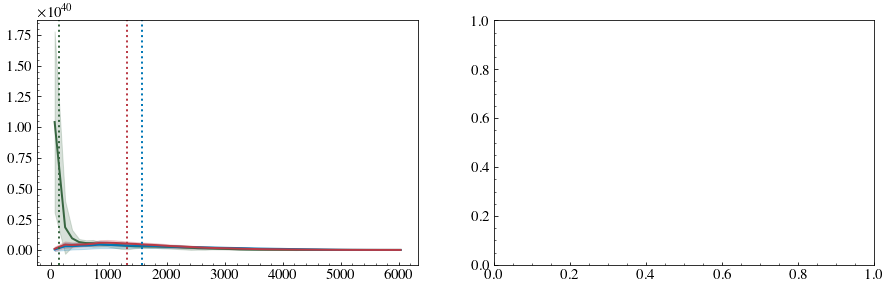

In [18]:


meanrfluxcII = np.nanmedian(rfluxcontcii, axis = 0)
stdrfluxcII = np.nanstd(rfluxcontcii, axis = 0)
stdrfluxcII[(meanrfluxcII-stdrfluxcII)< 0] = stdrfluxcII[(meanrfluxcII-stdrfluxcII)< 0]*0.6
stdrfluxcII = gaussian_filter(stdrfluxcII,sigma = 1)
meantotfcII = np.mean(totalcontcii, axis = 0)

meanrfluxsiII = np.nanmedian(rfluxcontsiii, axis = 0)
stdrfluxsiII = np.nanstd(rfluxcontsiii, axis = 0)
stdrfluxsiII[(meanrfluxsiII-stdrfluxsiII)< 0] = stdrfluxsiII[(meanrfluxsiII-stdrfluxsiII)< 0]*0.6
# stdrfluxsiII = gaussian_filter(stdrfluxsiII,sigma = 1)


meantotfsiII = np.median(totalcontsiii, axis = 0)
r50cii = np.zeros(300)
r50siii = np.zeros(300)
r50fluocii = np.zeros(300)
r50fluosiii = np.zeros(300)


for i in range(300):
    
    xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)

    f  = interpolate.interp1d(rrad, rfluxcontcii[i])
    ft = interpolate.interp1d(rrad, totalcontcii[i])
    ynewcii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewcii = ft(xnew) 

    
    f  = interpolate.interp1d(rrad, rfluxcontsiii[i])
    ft = interpolate.interp1d(rrad, totalcontsiii[i])
    ynewsiii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewsiii = ft(xnew) 

    half_fluxcii = np.max(ytnewcii)/2.0
    half_fluxsiii = np.max(ytnewsiii)/2.0

#     print(half_fluxcii,half_fluxsiii)
    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewcii,1) >= half_fluxcii)])
#     r50cii = r50s
    if len(r50s > 1): r50cii[i] = r50s[0]
    else: r50cii[i] = r50s

    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewsiii,1) >= half_fluxsiii)])
#     r50siii = r50s
    if len(r50s > 1): r50siii[i] = r50s[0]
    else: r50siii[i] = r50s
        
        
# FLUO TIME
    xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)

    f  = interpolate.interp1d(rrad, rfluxfluocii[i])
    ft = interpolate.interp1d(rrad, totalfluocii[i])
    ynewcii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewcii = ft(xnew) 

    
    f  = interpolate.interp1d(rrad, rfluxfluosiii[i])
    ft = interpolate.interp1d(rrad, totalfluosiii[i])
    ynewsiii  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnewsiii = ft(xnew) 

    half_fluxcii = np.max(ytnewcii)/2.0
    half_fluxsiii = np.max(ytnewsiii)/2.0

#     print(half_fluxcii,half_fluxsiii)
    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewcii,1) >= half_fluxcii)])
#     r50cii = r50s
    if len(r50s > 1): r50fluocii[i] = r50s[0]
    else: r50fluocii[i] = r50s

    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewsiii,1) >= half_fluxsiii)])
#     r50siii = r50s
    if len(r50s > 1): r50fluosiii[i] = r50s[0]
    else: r50fluosiii[i] = r50s

        

fig, (ax1, ax2) = plt.subplots(1,2,figsize = (15,4.5))
ax1.plot(rrad*(imsize/nxy),meanrfluxsiII,label='UV Continuum', c = '#386641', linewidth = 2)
ax1.fill_between(rrad*(imsize/nxy),meanrfluxsiII+stdrfluxsiII,
                 meanrfluxsiII - stdrfluxsiII, color= '#386641', alpha = 0.2)
ax1.plot(rrad*(imsize/nxy),np.nanmean(rfluxfluocii, axis = 0),label='C II*$\lambda$1335', color = "#0077B6",
         linewidth = 2)
ax1.fill_between(rrad*(imsize/nxy),np.nanmean(rfluxfluocii, axis = 0)+np.nanstd(rfluxfluocii, axis = 0),
                 np.nanmean(rfluxfluocii, axis = 0)- np.nanstd(rfluxfluocii, axis = 0),
                 color = '#0077B6', alpha = 0.2)

ax1.plot(rrad*(imsize/nxy),np.nanmean(rfluxfluosiii, axis = 0),label='Si II*$\lambda$1265',color = "#BA3B46", 
         linewidth = 2)
ax1.fill_between(rrad*(imsize/nxy),np.nanmean(rfluxfluosiii, axis = 0)+np.nanstd(rfluxfluosiii, axis = 0),
                 np.nanmean(rfluxfluosiii, axis = 0) - np.nanstd(rfluxfluosiii, axis = 0),
                                                                 color = '#BA3B46', alpha = 0.2)

ax1.axvline(np.nanmedian(r50siii), label = r'$r_{50}^{\rm UV}$', color = '#386641', linestyle = ':', linewidth = 2 )
ax1.axvline(np.nanmedian(r50fluocii), label = r'$r_{50}^{\rm C\ II*}$', color = '#0077B6', linestyle = ':', linewidth = 2 )
ax1.axvline(np.nanmedian(r50fluosiii), label = r'$r_{50}^{\rm Si\ II*}$', color = '#BA3B46', linestyle = ':', linewidth = 2 )


ax2.plot(np.arange(1,64,1)*120-80, np.mean(EWemiCIIim[:,:], axis =0), color = '#0077B6', label = 'C II* 1335')
# plt.plot(np.arange(1,64,1)*120, np.mean(EWabs[:10,1:], axis =0))
ax2.fill_between(np.arange(1,64,1)*120-80,np.mean(EWemiCIIim[:,:], axis =0)-np.std(EWemiCIIim[:,:], axis =0),
                 np.mean(EWemiCIIim[:,:], axis =0)+np.std(EWemiCIIim[:,:], axis =0), alpha = 0.2, color = '#0077B6')
ax2.plot(np.arange(1,64,1)*120-80, np.mean(EWemiSiIIim[:,:], axis =0), color = '#BA3B46', label = 'Si II* 1265' )
# plt.plot(np.arange(1,64,1)*120, np.mean(EWabs[:10,1:], axis =0))
ax2.fill_between(np.arange(1,64,1)*120-80,np.mean(EWemiSiIIim[:,:], axis =0)-np.std(EWemiSiIIim[:,:], axis =0),
                 np.mean(EWemiSiIIim[:,:], axis =0)+np.std(EWemiSiIIim[:,:], axis =0), alpha = 0.2, color = '#BA3B46')
# plt.subplots_adjust(hspace = 0.1)
# plt.axvline(160, label = r'$r_{50}^{\rm UV}$', color = '#386641', linestyle = ':', linewidth = 2 )
# plt.axvline(1589.5335068817576, label = r'$r_{50}^{\rm C\ II*}$', color = '#0077B6', linestyle = ':', linewidth = 2 )
# plt.axvline(1262, label = r'$r_{50}^{\rm Si\ II*}$', color = '#BA3B46', linestyle = ':', linewidth = 2 )
ax2.axvline(160,  color = '#386641', linestyle = ':', linewidth = 2 )
ax2.axvline(1560, color = '#0077B6', linestyle = ':', linewidth = 2 )
ax2.axvline(1305,color = '#BA3B46', linestyle = ':', linewidth = 2 )

# plt.axvspan(269-297, 269+297,color = 'k',
#            alpha = 0.1)

ax2.set_xlim(0,5500)
ax2.set_xlabel(r'Radius (parsec)', fontsize = 18)
ax2.set_ylabel(r'EW ($\rm \AA$)', fontsize = 18)
# ax2.legend(frameon=False, fontsize = 18, ncol = 1, loc = (0,1))

# plt.axvspan(np.nanmean(r50cii)-np.nanstd(r50cii), np.nanmean(r50cii)+np.nanstd(r50cii),color = 'k',
#            alpha = 0.1)
# plt.axvspan(np.nanmean(r50fluocii)-np.nanstd(r50fluocii), np.nanmean(r50fluocii)+np.nanstd(r50fluocii),color = 'k',
#            alpha = 0.1)
# plt.axvspan(np.nanmean(r50fluosiii)-np.nanstd(r50fluosiii), np.nanmean(r50fluosiii)+np.nanstd(r50fluosiii),color = 'k',
#            alpha = 0.1)
# plt.axvline(np.nanmean(r50opt), label = r'$r_{50}^{\rm Opt}$', color = 'purple', linestyle = ':', linewidth = 2 )

# plt.axvspan(np.nanmean(r50opt)-np.nanstd(r50opt), np.nanmean(r50opt)+np.nanstd(r50opt),color = 'purple',
#            alpha = 0.1)
# plt.axvline(np.mean(r50siii))
ax1.set_yscale('log')
# plt.axvline((imsize/nxy)*r100)

ax1.set_xlabel('Radius (parsec)', fontsize = 18)
ax1.set_ylabel('Surface brightness (erg s$^{-1}$)', fontsize = 18)
ax1.legend(frameon=False, ncol=6, loc = (0.1,1))
ax1.set_xlim(-0,5500)
# plt.savefig('Plots/lightcurves_EWs_dep.pdf', bbox_inches = 'tight')

In [19]:
print(np.nanmedian(r50cii), np.nanstd(r50cii))
print(np.nanmedian(r50fluocii), np.nanstd(r50fluocii))
print(np.nanmedian(r50fluosiii), np.nanstd(r50fluosiii))

xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)

f  = interpolate.interp1d(rrad, meanrfluxsiII)
ft = interpolate.interp1d(rrad, np.mean(totalcontsiii, axis = 0))
ynewcii  = f(xnew)   # use interpolation function returned by `interp1d`
ytnewcii = ft(xnew) 
half_flux = np.max(meanrfluxsiII)/2.0
#     print(half_fluxcii,half_fluxsiii)
r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnewcii,1) >= half_fluxcii)])   
print(r50s)
# print(r50siii)

154.37047714784896 402.7080846087514
1560.5890424165361 383.80541251170007
1305.5159493167698 181.9727604473374
[ 120.60193527  121.80795462  123.01397398 ... 6026.47870553 6027.68472488
 6028.89074424]


In [9]:
df = pd.DataFrame(np.vstack((rrad, meanrfluxcII, stdrfluxcII ,
                             np.nanmean(rfluxfluocii, axis = 0), np.nanstd(rfluxfluocii, axis = 0) ,
                            meanrfluxsiII, stdrfluxsiII ,
                             np.nanmean(rfluxfluosiii, axis = 0), np.nanstd(rfluxfluosiii, axis = 0))).T) # A is a numpy 2d array
C= ['rrad', 'meanrcontcII', 'stdrcontcII', 'meanrfluocII', 'stdrfluocII',
    'meanrcontsiII', 'stdrcontsiII', 'meanrfluosiII', 'stdrfluosiII',]
df.to_csv("csv/UVimage_lightcurve64_1pix.csv", sep=',', header= C, index=False) 

### Light profile 1 pixel continuum

In [10]:
# nxy,imsize,lcubecII,cubecII = read_cube('./data_cubes_output_148/CII_dep/',300)


f = ff('./CII_cube_3500A/output.out_cube','r')
nlbda,nxyopt = f.read_ints()
lmin,lmax,imsizeopt = f.read_reals('d')
center = f.read_reals('d')
cubeopt = np.zeros((300 ,nxyopt,nxyopt,nlbda))
cube1 = f.read_reals('d')
cubeopt[0] = cube1.reshape(nxyopt,nxyopt,nlbda)
for j in range(1,300):
    f.read_ints()
    f.read_reals('d')
    f.read_reals('d')
    cube1 = f.read_reals('d')
    cubeopt[j] = cube1.reshape((nxyopt,nxyopt,nlbda))
f.close()

f = ff('./CII_cube_3500A/IC_photons_1000000_nphots','r')
nphot = f.read_ints()[0]
total_lum = f.read_reals()
f.close()

l = np.linspace(lmin,lmax,nlbda)

cubeopt = cubeopt*total_lum/nphot
cubeopt =cubeopt*h_cgs*c_cgs / (l*1e-8)
cubeopt = cubeopt/((lmax-lmin)/nlbda)   


# nxy,imsize,lcubeSiII,cubeSiII = read_cube('./cube_3500A/',300)
print(nxy,nxyopt,imsize,imsizeopt )

64 512 7718.5238573924435 0.00109


In [11]:
## Light curves + spectra in increasing rings
nrad = 50
rrad  = np.zeros(nrad)



rfluxcont = np.zeros((300,nrad))
totalcont= np.zeros((300,nrad))

for idir in range(300):

    imagecontcII = cubeopt[idir,:,:,0]#/ (imsize/nxy)**2 
    y,x = np.where(imagecontcII == np.max(imagecontcII))
    fimagecont = cubeopt[idir,:,:,0].copy()

#     plt.imshow(imagecontcII)
#     plt.scatter(x[0],y[0], c = 'r', s = 100, marker = 'x')
    aperture = CircularAperture([x[0],y[0]], r=8) 
    aperture_masks = aperture.to_mask(method='center') # create mask
    fimagecontap = aperture_masks.multiply(fimagecont)
 
    rrad[0]      = 0.5

    rfluxcont[idir, 0] = np.sum(fimagecontap)
    totalcont[idir, 0] = rfluxcont[idir,0]
#     plt.figure()
#     plt.imshow(fimagecontap)
    # plt.imshow(fimage2)
    for kk in range(1,nrad):
        ppix1 = 8*kk 
        ppix2 = (8*kk+1) 
        aperture2 = CircularAnnulus([x[0],y[0]], r_in=ppix1, r_out=ppix2) 
        aperture_masks2 = aperture2.to_mask(method='subpixel') # create mask
        fimagecontap = aperture_masks2.multiply(fimagecont)
        
        rrad[kk]  = kk + 1
        rfluxcont[idir,kk] = np.sum(fimagecontap)
        totalcont[idir,kk] = totalcont[idir,kk-1] + rfluxcont[idir,kk]



findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.


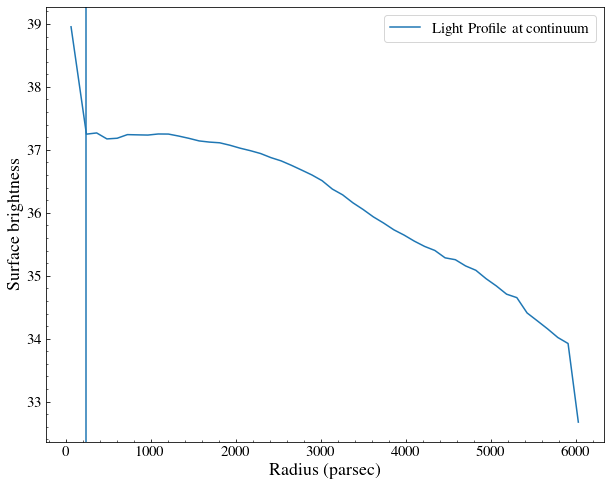

In [12]:
meanrflux = np.nanmedian(rfluxcont, axis = 0)
stdrflux = np.nanstd(rfluxcont, axis = 0)
meantotf = np.nanmedian(totalcont, axis = 0)

xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)

f  = interpolate.interp1d(rrad, meanrflux)
ft = interpolate.interp1d(rrad, meantotf)
ynew  = f(xnew)   # use interpolation function returned by `interp1d`
ytnew = ft(xnew)

r50opt = np.zeros(300)

for i in range(300):
    
    xnew  = np.arange(np.min(rrad), np.max(rrad), 0.01)

    f  = interpolate.interp1d(rrad, rfluxcont[i])
    ft = interpolate.interp1d(rrad, totalcont[i])
    ynew  = f(xnew)   # use interpolation function returned by `interp1d`
    ytnew = ft(xnew) 


    half_fluxopt = (0.95*np.max(ytnew))/2.0

#     print(half_fluxcii,half_fluxsiii)
    r50s = (imsize/nxy)*( xnew[(xnew > 1) & (np.round(ytnew,1) >= 0.95*half_fluxopt)])
#     r50cii = r50s
    if len(r50s > 1): r50opt[i] = r50s[0]
    else: r50opt[i] = r50s


# half_fluxopt = np.max(ytnew)/2.0
# print(half_fluxopt)

# r50s = (imsize/nxy)*(xnew[(np.round(ytnew,1) >= half_fluxopt)])
# r50opt = r50s
# if len(r50s > 1): r50opt = r50s[0]

plt.figure(figsize = (10,8))
plt.plot(rrad*(imsize/nxy),np.log10(meanrflux),label='Light Profile at continuum')
plt.axvline(np.mean(r50opt))

# plt.axvline((imsize/nxy)*r100)

plt.xlabel('Radius (parsec)', fontsize = 18)
plt.ylabel('Surface brightness', fontsize = 18)
plt.legend()
# plt.xlim(-10,5500)

In [90]:
# df = pd.DataFrame(np.vstack((rrad, meanrflux, stdrflux , meantotf)).T) # A is a numpy 2d array
# C=['rrad', 'meanrflux', 'stdrflux',  'meantotf',]
# df.to_csv("csv/Optimage_lightcurve64.csv", sep=',', header= C, index=False) 

df = pd.DataFrame(np.vstack((rrad, meanrflux, stdrflux , meantotf)).T) # A is a numpy 2d array
C=['rrad', 'meanrflux', 'stdrflux',  'meantotf',]
df.to_csv("csv/Optimage_lightcurve512.csv", sep=',', header= C, index=False) 


In [25]:
print(np.nanmedian(r50cii))
print(np.nanmedian(r50opt))

154.37047714784896
120.60193527175699


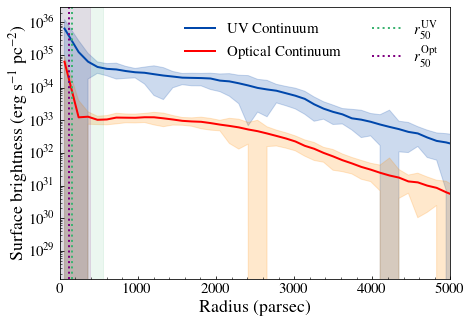

In [26]:
plt.figure(figsize = (7,5))

# df = pd.read_csv('csv/UVimage_lightcurve64_interval.csv')
# meanrfluxsiII = df['meanrcontsiII']
# stdrfluxsiII = df['stdrcontsiII']/(120*120)
plt.plot(rrad*(imsize/nxy),meanrfluxcII/(120*120),label='UV Continuum', c = cFS, linewidth = 2)
plt.fill_between(rrad*(imsize/nxy),meanrfluxsiII/(120*120)+stdrfluxsiII/(120*120),
                 meanrfluxsiII/(120*120) - stdrfluxsiII/(120*120), color= cFS, alpha = 0.2)

plt.plot(rrad*(imsize/nxy),meanrflux/(120*120),label='Optical Continuum', c = 'r', linewidth = 2)
plt.fill_between(rrad*(imsize/nxy),meanrflux/(120*120)+stdrflux/(120*120),
                 meanrflux/(120*120) - stdrflux/(120*120), color= cnoFS, alpha = 0.2)

plt.axvline(np.nanmedian(r50cii), label = r'$r_{50}^{\rm UV}$', color = 'mediumseagreen', linestyle = ':', linewidth = 2 )

plt.axvspan(np.nanmedian(r50cii)-np.nanstd(r50cii), np.nanmedian(r50cii)+np.nanstd(r50cii),color = 'mediumseagreen',
           alpha = 0.1)

plt.axvline(np.nanmedian(r50opt), label = r'$r_{50}^{\rm Opt}$', color = 'purple', linestyle = ':', linewidth = 2 )

plt.axvspan(np.nanmedian(r50opt)-np.nanstd(r50opt), np.nanmedian(r50opt)+np.nanstd(r50opt),color = 'purple',
           alpha = 0.1)
# plt.axvline(np.mean(r50siii))
plt.yscale('log')
# plt.axvline((imsize/nxy)*r100)

plt.xlabel('Radius (parsec)', fontsize = 18)
plt.ylabel('Surface brightness (erg s$^{-1}$ pc$^{-2}$)', fontsize = 18)
plt.legend(frameon=False, ncol=2)
plt.xlim(-0,5000)
plt.savefig('Plots/compUV_opt.pdf', bbox_inches = 'tight')

In [ ]:
# Function to read the binary files
h_cgs     = 6.6260755e-27  # [erg s]
c_cgs     = 2.99792458e10  # [cm/s]

n_halos = 200
n_phots = np.append(np.logspace(7,6,20), 1000000*np.ones(n_halos-20)).astype(int)
# Directions in which the galaxy has been observed:
# The angular momentum of the galaxy is roughly along the (0,0,1) direction. ->
# -> Face-on = ~parallel to (0,0,1), edge-on = ~perpendicular to (0,0,1)
ndirections = 108
directions = np.zeros((ndirections,3))
for i in range(ndirections):
    directions[i,:] = hp.pix2vec(3,i)
    

def read_file(Dir,FileName,ndir):
    f = ff('%s/%s_spectrum'%(Dir,FileName))
    n = f.read_ints()[0]
    aperture,lmin,lmax = f.read_reals('d')
    spec = np.zeros((ndir,n))
    spec[0,:] = f.read_reals('d')
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        spec[j,:] = f.read_reals('d')
    f.close()

    return lmin,lmax,n,spec

# To get the spectra, in the appropriate units
def read_spectrum(path_to_data,halo):
    f = ff('%s/Halo_%i/SiII_BARE_GR_S/spectra_SiII_1260/IC_photons_%i_nphots'%(path_to_data,halo,n_phots[halo-1]))
    a = f.read_ints()
    lum_per_packet = f.read_reals()
    f.close()
    lum_per_packet = lum_per_packet/a
    lmin,lmax,npix,phot_packets = \
        read_file('%s/Halo_%i/SiII_BARE_GR_S/spectra_SiII_1260/'%(path_to_data,halo),'output.out',ndirections)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux


In [ ]:
# To change if you move the data
path_to_data = './Sphinx20 - SiII 1260/spectra'  

## Choose a halo between 1 and 200
halo         = 5

v_halo = np.genfromtxt('./Sphinx20 - SiII 1260/v_halo.dat',unpack=True)[:,halo-1]
print(v_halo)
# l is a 1D array of wavelength in A, flux is a 2D array, ndirections*n_lambda, of flux in erg/s/A:
l, flux = read_spectrum(path_to_data,halo) 
print(len(l), len(v_halo))
idir = 109 # to choose a direction of observation, between 0 and ndirections-1

# To correct for the movement of the galaxy in the simulation box (not useful for the continuum):
l_systemic = l + np.dot(directions[idir,:],v_halo)/c_cgs*1e5*np.mean(l) 

# Plotting the spectrum in the selected direction:
fig,ax = plt.subplots(figsize=(8,5))
# The flux drops down on the far-left and far-right sides, ignore this part
plt.plot(l_systemic[1:],flux[idir,1:])
plt.xlabel(r'$\lambda$ [A]',fontsize=16)
plt.ylabel(r'flux [erg/s/A]',fontsize=16)
plt.show()
plt.close()


In [247]:
path_to_data = './Sphinx20 - SiII 1260/spectra'   # To change if you move the data

EWabsLR = np.zeros(ndirections*n_halos)
EWabsHR = np.zeros(ndirections*n_halos)
EWemiLR = np.zeros(ndirections*n_halos)
EWemiHR = np.zeros(ndirections*n_halos)
VabsLR = np.zeros(ndirections*n_halos)
VabsHR = np.zeros(ndirections*n_halos)
VemiLR = np.zeros(ndirections*n_halos)
VemiHR = np.zeros(ndirections*n_halos)
FabsLR = np.zeros(ndirections*n_halos)
FabsHR = np.zeros(ndirections*n_halos)
FemiLR = np.zeros(ndirections*n_halos)
FemiHR = np.zeros(ndirections*n_halos)
# velocity of the center of mass, to correct for the movement of the galaxy in the simulation box:
for i in range(n_halos):
    v_halo = np.genfromtxt('./Sphinx20 - SiII 1260/v_halo.dat',unpack=True)[:,i]
    # l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:

    #print(i)
    for idir in range(ndirections):
        l, flux = read_spectrum(path_to_data,i+1) 
        l_systemic = l + np.dot(directions[idir,:],v_halo)/c_cgs*1e5*np.mean(l) 
        l_systemic = l_systemic[1:]
    # Plotting the spectrum in the selected direction:
    #fig,ax = plt.subplots(figsize=(8,5))
    # The flux drops down on the far-left and far-right sides, ignore this part
        vcII   = (l_systemic/1260.42 -1)*c
        sigma_pixel = 50 / ((vcII[50]-vcII[49]))
        model = gaussian_filter(flux[idir,1:], sigma = sigma_pixel)


       # plt.plot(vcII,flux[idir,:]/np.median(flux[idir,:]))
        #plt.plot(vcII,model/np.median(model))

        EWabsHR[i*ndirections+idir], oo = measureEWabs(l_systemic, vcII, flux[idir,1:]/np.median(flux[idir,1:]), np.zeros(len(flux[idir,1:])),
                                 -1000, 500)
        EWabsLR[i*ndirections+idir], oo = measureEWabs(l_systemic, vcII, model/np.median(model), np.zeros(len(flux[idir,1:])),
                                 -1000, 500)
       # print(EWabsHR,EWabsLR)

        EWemiHR[i*ndirections+idir], oo = measureEWemi(l_systemic, vcII, flux[idir,1:]/np.median(flux[idir,1:]), np.zeros(len(flux[idir,1:])),
                                 -1000, 2000)
        EWemiLR[i*ndirections+idir], oo = measureEWemi(l_systemic, vcII, model/np.median(model), np.zeros(len(flux[idir,1:])),
                                 -1000, 2000)
       # print(EWemiHR,EWemiLR)

        VabsHR[i*ndirections+idir], oo, FabsHR[idir] = measureMinVel(vcII, flux[idir,1:]/np.median(flux[idir,1:]), np.zeros(len(flux[idir,1:])),
                                 -1000, 500)
        VabsLR[i*ndirections+idir], oo , FabsLR[idir] = measureMinVel(vcII, model/np.median(model), np.zeros(len(flux[idir,1:])),
                                 -1000, 500)
       # print(VabsHR,FabsHR)
      #  print(VabsLR,FabsLR)

        VemiHR[i*ndirections+idir], oo, FemiHR[idir] = measureMaxVel(vcII, flux[idir,1:]/np.median(flux[idir,1:]), np.zeros(len(flux[idir,1:])),
                                 -1000, 2000)
        VemiLR[i*ndirections+idir], oo, FemiLR[idir] = measureMaxVel(vcII, model/np.median(model), np.zeros(len(flux[idir,1:])),
                                 -1000, 2000)
#     print(VemiHR,FemiHR)
#     print(VemiLR,FemiLR)    

    
# plt.xlabel(r'$\lambda$ [A]',fontsize=16)
# plt.ylabel(r'flux [erg/s/A]',fontsize=16)
# plt.show()
# plt.close()

In [248]:
import pandas as pd
df = pd.DataFrame(np.vstack((np.linspace(0,108*200-1,108*200),EWabsHR,EWabsLR, EWemiHR, EWemiLR, VabsHR, VabsLR, VemiHR,
                   VemiLR, FabsHR, FabsLR, FemiHR, FemiLR)).T) # A is a numpy 2d array
C=['idx','EWabsHR','EWabsLR', 'EWemiHR', 'EWemiLR', 'VabsHR', 'VabsLR', 'VemiHR',
                   'VemiLR', 'FabsHR', 'FabsLR', 'FemiHR', 'FemiLR']
df.to_csv("SiII_sphynx_200halos.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

# Visualization

## 3 ts to 75 time steps - FS / no FS

In [ ]:
directions_1 = np.zeros((1728,3))
for i in range(1728):
    directions_1[i,:] = hp.pix2vec(12,i)

# Function to read the binary files
def read_file(Dir,FileName,ndir):
    f = ff('%s/%s_spectrum'%(Dir,FileName))
    n = f.read_ints()[0]
    aperture,lmin,lmax = f.read_reals('d')
    spec = np.zeros((ndir,n))
    spec[0,:] = f.read_reals('d')
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        spec[j,:] = f.read_reals('d')
    f.close()

    return lmin,lmax,n,spec

# To get the spectra, in the appropriate units
def read_spectrum(output,spec,path_to_data):
    lum_per_packet = np.genfromtxt('%s/IC_photons_%s_%i'%(path_to_data,spec,output))
    lmin,lmax,npix,phot_packets = read_file(path_to_data,'output_%s_%i.out'%(spec,output),1728)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux

path_to_data = './data/'   # To change if you move the data

line    = 'CII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 148    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 


# velocity of the center of mass, to correct for the movement of the galaxy in the simulation box:
v_cm1 = np.genfromtxt('%s/vcm_%i.dat'%(path_to_data,output)) 
# l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
l_1, flux_1 = read_spectrum(output,line,path_to_data) 
l_sys_1 = l_1 + np.dot(directions_1[0,:],v_cm1)/c_cgs*1e5*np.mean(l_1) 

n_halos = 75

# Directions in which the galaxy has been observed:
# The angular momentum of the galaxy is roughly along the (0,0,1) direction. ->
# -> Face-on = ~parallel to (0,0,1), edge-on = ~perpendicular to (0,0,1)
ndirections = 300
directions_2 = np.zeros((ndirections,3))
for i in range(ndirections):
    directions_2[i,:] = hp.pix2vec(5,i)
#print(directions)

def read_file(Dir,FileName,ndir):
    f = ff('%s/%s_spectrum'%(Dir,FileName))
    n = f.read_ints()[0]
    aperture,lmin,lmax = f.read_reals('d')
    spec = np.zeros((ndir,n))
    spec[0,:] = f.read_reals('d')
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        spec[j,:] = f.read_reals('d')
    f.close()

    return lmin,lmax,n,spec


def read_spectrum_c(path_to_data,halo):
    f = ff('%s/%s/CII_SMC/spectra_CII_1334/IC_photons_%i_nphots'%(path_to_data,str(halo).zfill(5),
                                                                          1000000))
    a = f.read_ints()
    lum_per_packet = f.read_reals()
    f.close()
    lum_per_packet = lum_per_packet/a
    lmin,lmax,npix,phot_packets = \
        read_file('%s/%s/CII_SMC/spectra_CII_1334/'%(path_to_data,str(halo).zfill(5)),'output.out',ndirections)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux

path_to_data = './CII_SiII'   # To change if you move the data

line    = 'CII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)
output  = 148    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 

v_cm2 = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

l_2, flux_2 = read_spectrum_c(path_to_data,output) 
# print(len(flux), flux[:,108])
# idir = 0 # to choose a direction of observation, between 0 and ndirections-1

# To correct for the movement of the galaxy in the simulation box (not useful for the continuum):
l_sys_2 = l_2 + np.dot(directions[0,:],v_cm2[:,output-90])/c_cgs*1e5*np.mean(l_2) 
# print(directions[idir,:])

for idx in range(100,101):
    minind = np.min(np.linalg.norm(directions_1-directions_2[idx], axis = 1))
    ind = np.argmin(np.linalg.norm(directions_1-directions_2[idx], axis = 1))
    print(ind, minind)
    print(directions_1[ind],directions_2[idx])
# idx = 140
l_sys_1 = l_1 + np.dot(directions_1[ind,:],v_cm1)/c_cgs*1e5*np.mean(l_1) 
l_sys_2 = l_2 + np.dot(directions_2[idx,:],v_cm2[:,output-90])/c_cgs*1e5*np.mean(l_2) 

plt.figure(figsize  = (7,5))
plt.plot(l_sys_1, flux_1[ind,:]/np.median(flux_1[ind,:]), label = 'Zoom1, output 148, Direction: 0.96, 0., 0.28')
plt.plot(l_sys_2[1:], flux_2[idx,1:]/np.median(flux_2[idx,1:]), label = 'Zoom2, output 148, Direction: 0.96, 0., 0.27')
plt.ylim(0,2)
plt.legend()
plt.figure(figsize  = (7,5))
plt.plot(l_sys_1, gaussian_filter(flux_1[ind,:]/np.median(flux_1[ind,:]),sigma = 7), label = 'Zoom1, output 148, Direction: 0.96, 0., 0.28')
plt.plot(l_sys_2[1:], gaussian_filter(flux_2[idx,1:]/np.median(flux_2[idx,1:]), sigma = 7), label = 'Zoom2, output 148, Direction: 0.96, 0., 0.27')
plt.ylim(0,2)
plt.legend()

## 75 time steps - FS / no FS

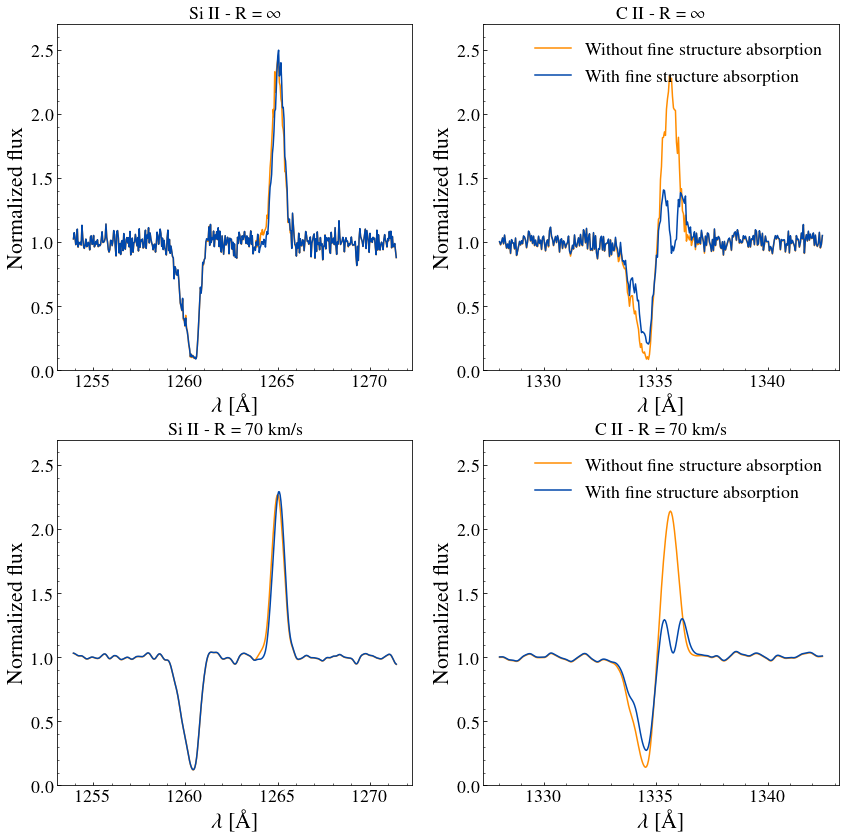

In [499]:
# Overlapping C II and Si II line for FS and not FS
fig,((ax0, ax1), (ax2,ax3)) = plt.subplots(2,2, figsize=(14,14))
fs = 22
output  = 96    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 
idir = 3 # to choose a direction of observation, between 0 and ndirections-1
v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

l, flux = read_spectrum_si('./CII_SiII',output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wsiII1260 -1)*c
sigma_pixel = 70/(vcII[1]-vcII[0])/2.355

ax0.plot(l_systemic[1:],flux[idir,1:]/np.median(flux[idir,1:]), label ='Without fine structure absorption', c = cnoFS)

l, flux = read_spectrum_si('./CII_SiII_fine',output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wsiII1260 -1)*c
ax0.plot(l_systemic[1:],flux[idir,1:]/np.median(flux[idir,1:]), label ='With fine structure absorption', c = cFS)

ax0.set_xlabel(r'$\lambda$ [$\rm \AA$]',fontsize=fs)
ax0.set_ylabel(r'Normalized flux',fontsize=fs)
ax0.set_title(r'Si II - R = $\infty$')
# ax0.legend(frameon=False, fontsize = 18)

l, flux = read_spectrum_c('./CII_SiII',output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wcII1334 -1)*c
ax1.plot(l_systemic[1:],flux[idir,1:]/np.median(flux[idir,1:]), label ='Without fine structure absorption', c = cnoFS)

l, flux = read_spectrum_c('./CII_SiII_fine',output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wcII1334 -1)*c
ax1.plot(l_systemic[1:],flux[idir,1:]/np.median(flux[idir,1:]), label ='With fine structure absorption', c = cFS)

ax1.set_xlabel(r'$\lambda$ [$\rm \AA$]',fontsize=fs)
ax1.set_ylabel(r'Normalized flux',fontsize=fs)
ax1.set_title(r'C II - R = $\infty$')
ax1.legend(frameon=False, fontsize = 18)
ax0.set_ylim(0,2.7)
ax1.set_ylim(0,2.7)
ax0.tick_params(axis='both', which='major', labelsize=18)
ax1.tick_params(axis='both', which='major', labelsize=18)
##### Bottom

l, flux = read_spectrum_si('./CII_SiII',output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wsiII1260 -1)*c
ax2.plot(l_systemic[1:],gaussian_filter(flux[idir,1:],sigma = sigma_pixel)/np.median(flux[idir,1:]), label ='No FS', c = cnoFS)

l, flux = read_spectrum_si('./CII_SiII_fine',output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wsiII1260 -1)*c
ax2.plot(l_systemic[1:],gaussian_filter(flux[idir,1:],sigma = sigma_pixel)/np.median(flux[idir,1:]), label ='FS', c = cFS)

ax2.set_xlabel(r'$\lambda$ [$\rm \AA$]',fontsize=fs)
ax2.set_ylabel(r'Normalized flux',fontsize=fs)
ax2.set_title(r'Si II - R = 70 km/s')
# ax2.legend(frameon=False, fontsize = 18)

l, flux = read_spectrum_c('./CII_SiII',output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wcII1334 -1)*c
ax3.plot(l_systemic[1:],gaussian_filter(flux[idir,1:],sigma = sigma_pixel)/np.median(flux[idir,1:]), 
         label ='Without fine structure absorption', c = cnoFS)

l, flux = read_spectrum_c('./CII_SiII_fine',output) 
l_systemic = l + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(l) 
vcII   = (l_systemic[1:]/wcII1334 -1)*c
ax3.plot(l_systemic[1:],gaussian_filter(flux[idir,1:],sigma = sigma_pixel)/np.median(flux[idir,1:]), 
         label ='With fine structure absorption', c = cFS)

ax3.set_xlabel(r'$\lambda$ [$\rm \AA$]',fontsize=fs)
ax3.set_ylabel(r'Normalized flux',fontsize=fs)
ax3.set_title('C II - R = 70 km/s')
ax3.legend(frameon=False, fontsize = 18)
ax2.set_ylim(0,2.7)
ax3.set_ylim(0,2.7)
ax2.tick_params(axis='both', which='major', labelsize=18)
ax3.tick_params(axis='both', which='major', labelsize=18)

plt.savefig('LineExamples.pdf', bbox_inches = 'tight')

## CLASSY correl

### Check CLASSY stellar continuum

In [6]:
nGal = len(galaxy)
mask_all = []

for i in range(nGal):
    print(label[i])
    spec = '../Classy/%s/hlsp_classy_hst_cos_%s_multi_v1_coadded.fits'%(galaxy[i].replace("_", ""), label[i])
    gal   = fits.open(spec)
    HRB   = gal[10].data # Rest-frame, galactic extinction-corrected, co-added, binned high-resolution spectrum 
    mask  = HRB['MASK'].astype('bool')

    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']#[mask]
    flux   = data['flux']#[mask]
    fit    = gaussian_filter(data['fit'], sigma = 10)#[mask]
    fitori = gaussian_filter(data['fit'], sigma = 0)#[mask]
    err    = data['err']
    absflux = gaussian_filter(flux/fit,sigma = 0)

    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

    if label[i] == 'j0337-0502' :
        mask = mask | (abs(vcIId)<1000) | (abs(vsiIId) < 600)
        mask_all.append(mask)
    elif label[i] == 'j0405-3648':
        mask = mask & ~((vcIId < -500) & (vcIId > -1000)) & ~((vsiIId < -500) & (vsiIId > -1000))
        mask_all.append(mask)
    elif label[i] == 'j0823+2806':
        mask = mask | (abs(vsiIId) < 2000)
        mask_all.append(mask)
    elif label[i] == 'j0934+5514':
        mask = mask & ~((vcIId < -400) & (vcIId > -1000))
        mask_all.append(mask)
    elif label[i] == 'j0942+3547':
        mask = mask | (abs(vcIId)<1000) 
        mask_all.append(mask)
    elif label[i] == 'j0944+3442':
        mask = mask & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)
    elif label[i] ==  'j1016+3754':
        mask = mask & ~((vcIId < -600) & (vcIId > -1000))
        mask_all.append(mask)       
    elif label[i] == 'j1024+0524':
        mask = mask | (vsiIId < 300) | (vsiIId>700) 
        mask_all.append(mask)     
    elif label[i] == 'j1044+0353':
        mask = (mask | (vcIId < 1000)) & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)   
    elif label[i] == 'j1105+4444':
        mask = mask & ~((abs(vcIId)< 1500))
        mask_all.append(mask)    
    elif label[i] == 'j1132+1411':
        mask = mask | (vcIId < 00) 
        mask_all.append(mask)         
    elif label[i] == 'j1148+2546':
        mask = (mask & ~((abs(vcIId)< 1500))) | (abs(vsiIId) < 300) 
        mask_all.append(mask)  
    elif label[i] == 'j1157+3220':
        mask = mask & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)   
    elif label[i] == 'j1314+3452':
        mask = mask & ~((vcIId < -400) & (vcIId > -1000))
        mask_all.append(mask)   
    elif label[i] == 'j1359+5726':
        mask = mask & ~((abs(vsiIId)< 2000))
        mask_all.append(mask)    
    elif label[i] == 'j1545+0858':
        mask = mask | (vsiIId >-300) 
        mask_all.append(mask)      
    else:
        mask_all.append(mask)
        
        
    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-800) & (vsiIId<2000) 

    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]
    if(i == 4):
        absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
    #absflux /= np.median(absflux[cutSiIIall])
    
#     fig, axs = plt.subplots(1,2,figsize=(15,5))
#     axs[0].plot(vcIId[cutCIIall], flux[cutCIIall]/np.nanmedian(flux[cutCIIall]),     c='k', label = 'Observed',drawstyle='steps-mid')
#     axs[0].plot(vcIId[cutCIIall], absflux[cutCIIall]/np.nanmedian(absflux[cutCIIall]),  c=cnoFS, label = 'Continuum divided',drawstyle='steps-mid')
#     axs[0].plot(vcIId[cutCIIall], fitori[cutCIIall]/np.nanmedian(fitori[cutCIIall]),      c='gray', label = 'SB99 HR', linestyle = ':')
#     axs[0].plot(vcIId[cutCIIall], fit[cutCIIall]/np.nanmedian(fit[cutCIIall]),      c='forestgreen', label = 'SB99 smoothed')
# #     axs[0].plot(vcIId[cutCIIall], )
#     axs[0].fill_between(vcIId[cutCIIall][~maskCII], np.nanmin(flux[cutCIIall]/np.nanmedian(flux[cutCIIall])), 
#                         np.nanmax(flux[cutCIIall]/np.nanmedian(flux[cutCIIall])), alpha=0.2, color= 'r')

#     axs[0].set_title('C II 1334')
#     axs[0].legend(frameon=False, fontsize = 15)
    
#     axs[1].plot(vsiIId[cutSiIIall], flux[cutSiIIall]/np.nanmedian(flux[cutSiIIall]),     c='k', label = 'Observed',drawstyle='steps-mid')
#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall]/np.nanmedian(absflux[cutSiIIall]),  c=cnoFS, label = 'Continuum divided',drawstyle='steps-mid')
#     axs[1].plot(vsiIId[cutSiIIall], fitori[cutSiIIall]/np.nanmedian(fitori[cutSiIIall]),      c='gray', label = 'SB99 HR', linestyle = ':')
#     axs[1].plot(vsiIId[cutSiIIall], fit[cutSiIIall]/np.nanmedian(fit[cutSiIIall]),      c='forestgreen', label = 'SB99 smoothed')
#     axs[1].fill_between(vsiIId[cutSiIIall][~maskSiII], np.nanmin(flux[cutSiIIall]/np.nanmedian(flux[cutSiIIall])), 
#                         np.nanmax(flux[cutSiIIall]/np.nanmedian(flux[cutSiIIall])), alpha=0.2, color= 'r')  
#     axs[1].set_title('Si II 1260')

# #     axs[2].plot(vLyad[cutLyaall], absflux[cutLyaall],  c='k')
# #     axs[2].fill_between(vLyad[cutLyaall],absflux[cutLyaall]-err[cutLyaall],absflux[cutLyaall]+err[cutLyaall],
# #                         color = 'k', alpha = 0.1)
# #     axs[2].set_title('Lyman-alpha')
# #     axs[2].set_ylim(0, np.max([2,np.nanmax(absflux[abs(vLyad) < 1000])]))
 
#     plt.suptitle(label[i])
#     plt.show()
#     plt.savefig(galaxy[i]+'match.pdf', bbox_inches = 'tight')


j0021+0052
j0036-3333
j0127-0619
j0144+0453
j0337-0502
j0405-3648
j0808+3948
j0823+2806
j0926+4427
j0934+5514
j0938+5428
j0940+2935
j0942+3547
j0944-0038
j0944+3442
j1016+3754
j1024+0524
j1025+3622
j1044+0353
j1105+4444
j1112+5503
j1119+5130
j1129+2034
j1132+1411
j1132+5722
j1144+4012
j1148+2546
j1150+1501
j1157+3220
j1200+1343
j1225+6109
j1253-0312
j1314+3452
j1323-0132
j1359+5726
j1416+1223
j1418+2102
j1428+1653
j1429+0643
j1444+4237
j1448-0110
j1521+0759
j1525+0757
j1545+0858
j1612+0817


# Comparisons

## 75 time steps - FS, no FS, + CLASSY

### V LIS

#### V min

In [ ]:
fig, axs= plt.subplots(1,3, figsize =(22,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

# Create the colormap
    
axs[0].errorbar(classy['VminSiII1260'], classy['VminCII334'], 
                xerr = classy['ErrVminSiII1260'], yerr = classy['ErrVminCII334'],
                label = 'CLASSY - Included', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')
axs[0].errorbar(classy['VminSiII1260'][maskInc], classy['VminCII334'][maskInc], 
                xerr = classy['ErrVminSiII1260'][maskInc], yerr = classy['ErrVminCII334'][maskInc],
                label = 'CLASSY - Excluded', c = 'r', linestyle = 'None', marker = 'o', markeredgecolor = 'k')
axs[0].vlines(classy['VminSiII1260'][~(classy['VminCII334']>-900)], 100,200, color = cFS)
axs[0].hlines(classy['VminCII334'][~(classy['VminSiII1260']>-900)], 100,200, color = cFS)

axs[0].scatter( VabsSiIInf.flatten()[:], VabsCIInf.flatten()[:], zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
axs[0].plot(np.linspace(-600,100),np.linspace(-600,100), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'V$_{\rm min}$ - Si II 1260 ($\rm km\ s^{-1}$)', fontsize = 20)
axs[0].set_ylabel(r'V$_{\rm min}$ - C II 1334 ($\rm km\ s^{-1}$)', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
axs[0].set_title('No FS')
axins = inset_axes(axs[0], 1.5, 1.5 , loc='lower right', bbox_to_anchor=(0.99, 0.01),
                   bbox_transform=axs[0].transAxes)
#box, c1, c2 = mark_inset(ax, axins, loc1=3, loc2=4,  ec="0.1")
axins.tick_params(axis='both', which='major', labelsize=15, colors = 'w')
axins.scatter( VabsSiIInf.flatten()[:], VabsCIInf.flatten()[:], zorder = 0, marker = 'o', 
                   c = fesc.flatten()[:], cmap = cmap, s =5, alpha = 0.3,
               vmin = 0.01, vmax = 0.15)
# axins.set_xticks([0,1])
# axins.set_yticks([0,1])
axins.set_xlim(-300,-100)
axins.set_ylim(-300,-100)

# Create the colormap
ax = axs[1]
ax.errorbar(classy['VminSiII1260'], classy['VminCII334'], 
                xerr = classy['ErrVminSiII1260'], yerr = classy['ErrVminCII334'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')
ax.errorbar(classy['VminSiII1260'][maskInc], classy['VminCII334'][maskInc], 
                xerr = classy['ErrVminSiII1260'][maskInc], yerr = classy['ErrVminCII334'][maskInc],
                label = 'CLASSY - Excluded', c = 'r', linestyle = 'None', marker = 'o', markeredgecolor = 'k')

cm = ax.scatter( VabsSiIIfs.flatten()[:], VabsCIIfs.flatten()[:], zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
axs[1].plot(np.linspace(-600,100),np.linspace(-600,100), linestyle = '--', c = 'k')
ax.set_xlabel(r'V$_{\rm min}$ - Si II 1260 ($\rm km\ s^{-1}$)', fontsize = 20)
ax.set_ylabel(r'V$_{\rm min}$ - C II 1334 ($\rm km\ s^{-1}$)', fontsize = 20)
# ax.legend(frameon = False, fontsize = 15)
ax.set_title('FS')
axins = inset_axes(ax, 1.5, 1.5 , loc='lower right', bbox_to_anchor=(0.99, 0.01),
                   bbox_transform=ax.transAxes)
#box, c1, c2 = mark_inset(ax, axins, loc1=3, loc2=4,  ec="0.1")
axins.tick_params(axis='both', which='major', labelsize=15, colors = 'w')
axins.scatter( VabsSiIIfs.flatten()[:], VabsCIIfs.flatten()[:], zorder = 0, marker = 'o', 
                   c = fesc.flatten()[:], cmap = cmap, s =5, alpha = 0.2,
               vmin = 0.01, vmax = 0.15)
# axins.set_xticks([0,1])
# axins.set_yticks([0,1])
axins.set_xlim(-300,-100)
axins.set_ylim(-300,-100)

####
ax = axs[2]
ax.errorbar(classy['VminSiII1260'], classy['VminCII334'], 
                xerr = classy['ErrVminSiII1260'], yerr = classy['ErrVminCII334'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')
ax.errorbar(classy['VminSiII1260'][maskInc], classy['VminCII334'][maskInc], 
                xerr = classy['ErrVminSiII1260'][maskInc], yerr = classy['ErrVminCII334'][maskInc],
                label = 'CLASSY - Excluded', c = 'r', linestyle = 'None', marker = 'o', markeredgecolor = 'k')

cm = ax.scatter( VabsSiIIdu.flatten()[:], VabsCIIdu.flatten()[:], zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
ax.plot(np.linspace(-600,100),np.linspace(-600,100), linestyle = '--', c = 'k')
ax.set_xlabel(r'V$_{\rm min}$ - Si II 1260 ($\rm km\ s^{-1}$)', fontsize = 20)
ax.set_ylabel(r'V$_{\rm min}$ - C II 1334 ($\rm km\ s^{-1}$)', fontsize = 20)
# ax.legend(frameon = False, fontsize = 15)
ax.set_title('FS + diff dust')
ax.set_ylim(-650,200)
axins = inset_axes(ax, 1.5, 1.5 , loc='lower right', bbox_to_anchor=(0.99, 0.01),
                   bbox_transform=ax.transAxes)
#box, c1, c2 = mark_inset(ax, axins, loc1=3, loc2=4,  ec="0.1")
axins.tick_params(axis='both', which='major', labelsize=15, colors = 'w')
axins.scatter( VabsSiIIdu.flatten()[:], VabsCIIdu.flatten()[:], zorder = 0, marker = 'o', 
                   c = fesc.flatten()[:], cmap = cmap, s =5, alpha = 0.2,
               vmin = 0.01, vmax = 0.15)
axins.set_xlim(-300,-100)
axins.set_ylim(-300,-100)

fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.02, 0.7])
cbar = fig.colorbar(cm, cax=cbar_ax, orientation='vertical')
cbar.ax.set_title(r'Total $f_{\rm esc}^{\rm LyC}$', fontsize = 20)
            

#### V cen

In [ ]:
fig, axs= plt.subplots(1,2, figsize =(15,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

# Create the colormap
    
# axs[0].errorbar(classy['VminSiII1260'], classy['VminCII334'], 
#                 xerr = classy['ErrVminSiII1260'], yerr = classy['ErrVminCII334'],
#                 label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

axs[0].scatter( VcenSiIInf.flatten()[:], VcenCIInf.flatten()[:], zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
axs[0].plot(np.linspace(-400,100),np.linspace(-400,100), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'V$_{\rm cen}$ - Si II 1260 ($\rm km\ s^{-1}$)', fontsize = 20)
axs[0].set_ylabel(r'V$_{\rm cen}$ - C II 1334 ($\rm km\ s^{-1}$)', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
axs[0].set_title('No FS')
axins = inset_axes(axs[0], 1.5, 1.5 , loc='lower right', bbox_to_anchor=(0.99, 0.01),
                   bbox_transform=axs[0].transAxes)
#box, c1, c2 = mark_inset(ax, axins, loc1=3, loc2=4,  ec="0.1")
axins.tick_params(axis='both', which='major', labelsize=15, colors = 'w')
axins.scatter( VabsSiIInf.flatten()[:], VabsCIInf.flatten()[:], zorder = 0, marker = 'o', 
                   c = fesc.flatten()[:], cmap = cmap, s =5, alpha = 0.3,
               vmin = 0.01, vmax = 0.15)
# axins.set_xticks([0,1])
# axins.set_yticks([0,1])
axins.set_xlim(-300,-100)
axins.set_ylim(-300,-100)

# Create the colormap
ax = axs[1]
# ax.errorbar(classy['VminSiII1260'], classy['VminCII334'], 
#                 xerr = classy['ErrVminSiII1260'], yerr = classy['ErrVminCII334'],
#                 label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

cm = ax.scatter( VcenSiIIfs.flatten()[:], VcenCIIfs.flatten()[:], zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
axs[1].plot(np.linspace(-400,100),np.linspace(-400,100), linestyle = '--', c = 'k')
ax.set_xlabel(r'V$_{\rm cen}$ - Si II 1260 ($\rm km\ s^{-1}$)', fontsize = 20)
ax.set_ylabel(r'V$_{\rm cen}$ - C II 1334 ($\rm km\ s^{-1}$)', fontsize = 20)
ax.legend(frameon = False, fontsize = 15)
ax.set_title('FS')
axs[1].set_ylim(-420,120)

axins = inset_axes(ax, 1.5, 1.5 , loc='lower right', bbox_to_anchor=(0.99, 0.01),
                   bbox_transform=ax.transAxes)
#box, c1, c2 = mark_inset(ax, axins, loc1=3, loc2=4,  ec="0.1")
axins.tick_params(axis='both', which='major', labelsize=15, colors = 'w')
axins.scatter( VabsSiIIfs.flatten()[:], VabsCIIfs.flatten()[:], zorder = 0, marker = 'o', 
                   c = fesc.flatten()[:], cmap = cmap, s =5, alpha = 0.2,
               vmin = 0.01, vmax = 0.15)
# axins.set_xticks([0,1])
# axins.set_yticks([0,1])
axins.set_xlim(-300,-100)
axins.set_ylim(-300,-100)

fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.02, 0.7])
cbar = fig.colorbar(cm, cax=cbar_ax, orientation='vertical')
cbar.ax.set_title(r'Total $f_{\rm esc}^{\rm LyC}$', fontsize = 20)

                       

### R LIS

In [ ]:
fig, axs= plt.subplots(1,3, figsize =(22,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)
# RSiIInf[RSiIInf>1]=1
# RSiIIfs[RSiIIfs>1]=1
# RCIInf[RCIInf>1]=1
# RCIIfs[RCIIfs>1]=1

# Create the colormap
    
axs[0].errorbar(classy['RSiII1260'], classy['RCII334'], 
                xerr = classy['ErrRSiII1260'], yerr = classy['ErrRCII334'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

axs[0].scatter( RSiIInf.flatten()[:], RCIInf.flatten()[:], zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
axs[0].plot(np.linspace(0,1),np.linspace(0,1), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'F$_{\rm min}$ - Si II 1260', fontsize = 20)
axs[0].set_ylabel(r'F$_{\rm min}$ - C II 1334', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
axs[0].set_title('No FS')
axins = inset_axes(axs[0], 1.5, 1.5 , loc='lower right', bbox_to_anchor=(0.99, 0.01),
                   bbox_transform=axs[0].transAxes)
#box, c1, c2 = mark_inset(ax, axins, loc1=3, loc2=4,  ec="0.1")
axins.tick_params(axis='both', which='major', labelsize=15, colors = 'w')
axins.scatter( RSiIInf.flatten()[:], RCIInf.flatten()[:], zorder = 0, marker = 'o', 
                   c = fesc.flatten()[:], cmap = cmap, s =5, alpha = 0.3,
               vmin = 0.01, vmax = 0.15)
# axins.set_xticks([0,1])
# axins.set_yticks([0,1])
axins.set_xlim(0.5,1.1)
axins.set_ylim(0.5,1.1)

# Create the colormap
ax = axs[1]
ax.errorbar(classy['RSiII1260'], classy['RCII334'], 
                xerr = classy['ErrRSiII1260'], yerr = classy['ErrRCII334'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

cm = ax.scatter( RSiIIfs.flatten()[:], RCIIfs.flatten()[:], zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
axs[1].plot(np.linspace(0,1),np.linspace(0,1), linestyle = '--', c = 'k')
ax.set_xlabel(r'F$_{\rm min}$ - Si II 1260', fontsize = 20)
ax.set_ylabel(r'F$_{\rm min}$ - C II 1334', fontsize = 20)
ax.legend(frameon = False, fontsize = 15)
ax.set_title('FS')
axins = inset_axes(ax, 1.5, 1.5 , loc='lower right', bbox_to_anchor=(0.99, 0.01),
                   bbox_transform=ax.transAxes)
#box, c1, c2 = mark_inset(ax, axins, loc1=3, loc2=4,  ec="0.1")
axins.tick_params(axis='both', which='major', labelsize=15, colors = 'w')
axins.scatter( RSiIIfs.flatten()[:], RCIIfs.flatten()[:], zorder = 0, marker = 'o', 
                   c = fesc.flatten()[:], cmap = cmap, s =5, alpha = 0.2, 
               vmin = 0.01, vmax = 0.15)
# axins.set_xticks([0,1])
# axins.set_yticks([0,1])
axins.set_xlim(0.5,1.1)
axins.set_ylim(0.5,1.1)

# Create the colormap
ax = axs[2]
ax.errorbar(classy['RSiII1260'], classy['RCII334'], 
                xerr = classy['ErrRSiII1260'], yerr = classy['ErrRCII334'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

cm = ax.scatter( RSiIIdu.flatten()[:], RCIIdu.flatten()[:], zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
axs[2].plot(np.linspace(0,1),np.linspace(0,1), linestyle = '--', c = 'k')
ax.set_xlabel(r'F$_{\rm min}$ - Si II 1260', fontsize = 20)
ax.set_ylabel(r'F$_{\rm min}$ - C II 1334', fontsize = 20)
ax.legend(frameon = False, fontsize = 15)
ax.set_title('FS + new dust')
axins = inset_axes(ax, 1.5, 1.5 , loc='lower right', bbox_to_anchor=(0.99, 0.01),
                   bbox_transform=ax.transAxes)
#box, c1, c2 = mark_inset(ax, axins, loc1=3, loc2=4,  ec="0.1")
axins.tick_params(axis='both', which='major', labelsize=15, colors = 'w')
axins.scatter( RSiIIfs.flatten()[:], RCIIfs.flatten()[:], zorder = 0, marker = 'o', 
                   c = fesc.flatten()[:], cmap = cmap, s =5, alpha = 0.2, 
               vmin = 0.01, vmax = 0.15)
# axins.set_xticks([0,1])
# axins.set_yticks([0,1])
axins.set_xlim(0.5,1.1)
axins.set_ylim(0.5,1.1)

fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.02, 0.7])
cbar = fig.colorbar(cm, cax=cbar_ax, orientation='vertical')
cbar.ax.set_title(r'Total $f_{\rm esc}^{\rm LyC}$', fontsize = 20)

                       

### EW Fluo

In [ ]:
fig, axs= plt.subplots(1,3, figsize =(22,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)
# RSiIInf[RSiIInf>1]=1
# RSiIIfs[RSiIIfs>1]=1
# RCIInf[RCIInf>1]=1
# RCIIfs[RCIIfs>1]=1

# Create the colormap
    
axs[0].errorbar(ClassFluo['EWFluoSiII'], ClassFluo['EWFluoCII'], 
                xerr = ClassFluo['ErrEWFluoCII'], yerr = ClassFluo['ErrEWFluoCII'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

axs[0].scatter( EWemiSiIInf.flatten()[:], EWemiCIInf.flatten()[:], zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
axs[0].plot(np.linspace(0,2),np.linspace(0,2), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'EW - Si II 1264* ($\rm \AA$)', fontsize = 20)
axs[0].set_ylabel(r'EW - C II 1335* ($\rm \AA$)', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
axs[0].set_title('No FS')

# axins.set_xticks([0,1])
# axins.set_yticks([0,1])
axs[0].set_xlim(-0.1,2)
axs[0].set_ylim(-0.1,2)

# Create the colormap
ax = axs[1]
ax.errorbar(ClassFluo['EWFluoSiII'], ClassFluo['EWFluoCII'], 
                xerr = ClassFluo['ErrEWFluoCII'], yerr = ClassFluo['ErrEWFluoCII'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

cm = ax.scatter( EWemiSiIIfs.flatten()[:], EWemiCIIfs.flatten()[:], zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
axs[1].plot(np.linspace(0,2),np.linspace(0,2), linestyle = '--', c = 'k')
axs[1].set_xlabel(r'EW - Si II 1264* ($\rm \AA$)', fontsize = 20)
axs[1].set_ylabel(r'EW - C II 1335* ($\rm \AA$)', fontsize = 20)
ax.legend(frameon = False, fontsize = 15)
ax.set_title('FS')

# axins.set_xticks([0,1])
# axins.set_yticks([0,1])
ax.set_xlim(-0.1,2)
ax.set_ylim(-0.1,2)


# Create the colormap
ax = axs[2]
ax.errorbar(ClassFluo['EWFluoSiII'], ClassFluo['EWFluoCII'], 
                xerr = ClassFluo['ErrEWFluoCII'], yerr = ClassFluo['ErrEWFluoCII'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

cm = ax.scatter( EWemiSiIIdu.flatten()[:], EWemiCIIdu.flatten()[:], zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
axs[2].plot(np.linspace(0,2),np.linspace(0,2), linestyle = '--', c = 'k')
axs[2].set_xlabel(r'EW - Si II 1264* ($\rm \AA$)', fontsize = 20)
axs[2].set_ylabel(r'EW - C II 1335* ($\rm \AA$)', fontsize = 20)
ax.legend(frameon = False, fontsize = 15)
ax.set_title('FS + new dust')

# axins.set_xticks([0,1])
# axins.set_yticks([0,1])
ax.set_xlim(-0.1,2)
ax.set_ylim(-0.1,2)

fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.02, 0.7])
cbar = fig.colorbar(cm, cax=cbar_ax, orientation='vertical')
cbar.ax.set_title(r'Total $f_{\rm esc}^{\rm LyC}$', fontsize = 20)

                       

### V max Fluo

In [ ]:
fig, axs= plt.subplots(1,2, figsize =(15,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)
# RSiIInf[RSiIInf>1]=1
# RSiIIfs[RSiIIfs>1]=1
# RCIInf[RCIInf>1]=1
# RCIIfs[RCIIfs>1]=1

# Create the colormap
    
axs[0].errorbar(ClassFluo['VFluoSiII']-offsiIIfluo1265, ClassFluo['VFluoCII']-offcIIfluo1335, 
                xerr = ClassFluo['ErrVFluoCII'], yerr = ClassFluo['ErrVFluoCII'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

axs[0].scatter( VemiSiIInf.flatten()[:]-offsiIIfluo1265, VemiCIInf.flatten()[:]-offcIIfluo1335, zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
# axs[0].plot(np.linspace(0,1),np.linspace(0,1), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'V$_{\rm max}$ - Si II 1260 ($\rm km\ s^{-1}$)', fontsize = 20)
axs[0].set_ylabel(r'V$_{\rm max}$ - C II 1334 ($\rm km\ s^{-1}$)', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
axs[0].set_title('No FS')


# Create the colormap
ax = axs[1]
ax.errorbar(ClassFluo['VFluoSiII']-offsiIIfluo1265, ClassFluo['VFluoCII']-offcIIfluo1335, 
                xerr = ClassFluo['ErrVFluoCII'], yerr = ClassFluo['ErrVFluoCII'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

cm = ax.scatter( VemiSiIIfs.flatten()[:]-offsiIIfluo1265, VemiCIIfs.flatten()[:]-offcIIfluo1335, zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
# axs[1].plot(np.linspace(0,1),np.linspace(0,1), linestyle = '--', c = 'k')
ax.set_xlabel(r'V$_{\rm max}$ - Si II 1260 ($\rm km\ s^{-1}$)', fontsize = 20)
ax.set_ylabel(r'V$_{\rm max}$ - C II 1334 ($\rm km\ s^{-1}$)', fontsize = 20)
ax.legend(frameon = False, fontsize = 15)
ax.set_title('FS')


fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.02, 0.7])
cbar = fig.colorbar(cm, cax=cbar_ax, orientation='vertical')
cbar.ax.set_title(r'Total $f_{\rm esc}^{\rm LyC}$', fontsize = 20)

                       

### V LIS / V Fluo

#### Si II

In [ ]:
fig, axs= plt.subplots(1,2, figsize =(15,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

# Create the colormap
    
axs[0].errorbar(classy['VminSiII1260'], classy['VmaxSiII1260Fluo'], 
                xerr = classy['ErrVminSiII1260'],          yerr = classy['ErrVmaxSiII1260Fluo'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

axs[0].scatter( VabsSiIInf.flatten()[:], VemiSiIInf.flatten()[:]-offsiIIfluo1265, zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
# axs[0].plot(np.linspace(-600,100),np.linspace(-600,100), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'V$_{\rm min}$ - Si II 1260 ($\rm km\ s^{-1}$)', fontsize = 20)
axs[0].set_ylabel(r'V$_{\rm max}$ - Si II 1265* ($\rm km\ s^{-1}$)', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
axs[0].set_title('No FS')

ax = axs[1]
ax.errorbar(classy['VminSiII1260'], classy['VmaxSiII1260Fluo'], xerr = classy['ErrVminSiII1260'], 
             yerr = classy['ErrVmaxSiII1260Fluo'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

cm = ax.scatter( VabsSiIIfs.flatten()[:], VemiSiIIfs.flatten()[:]-offsiIIfluo1265, zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
# axs[1].plot(np.linspace(-600,100),np.linspace(-600,100), linestyle = '--', c = 'k')
ax.set_xlabel(r'V$_{\rm min}$ - Si II 1260 ($\rm km\ s^{-1}$)', fontsize = 20)
ax.set_ylabel(r'V$_{\rm max}$ - Si II 1265* ($\rm km\ s^{-1}$)', fontsize = 20)
ax.legend(frameon = False, fontsize = 15)
ax.set_title('FS')


fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.02, 0.7])
cbar = fig.colorbar(cm, cax=cbar_ax, orientation='vertical')
cbar.ax.set_title(r'Total $f_{\rm esc}^{\rm LyC}$', fontsize = 20)

                       

#### C II 

In [ ]:
fig, axs= plt.subplots(1,2, figsize =(15,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

# Create the colormap
    
axs[0].errorbar(classy['VminCII334'], classy['VmaxCII334Fluo'], 
                xerr = classy['ErrVminCII334'],          yerr = classy['ErrVmaxCII334Fluo'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

axs[0].scatter( VabsCIInf.flatten()[:], VemiCIInf.flatten()[:]-offcIIfluo1335, zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
# axs[0].plot(np.linspace(-600,100),np.linspace(-600,100), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'V$_{\rm min}$ - C II 1334 ($\rm km\ s^{-1}$)', fontsize = 20)
axs[0].set_ylabel(r'V$_{\rm max}$ - C II 1335* ($\rm km\ s^{-1}$)', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
axs[0].set_title('No FS')
axs[0].set_xlim(-300,200)
ax = axs[1]
ax.errorbar(classy['VminCII334'], classy['VmaxCII334Fluo'], xerr = classy['ErrVminCII334'], 
             yerr = classy['ErrVmaxCII334Fluo'],
                label = 'CLASSY', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')

cm = ax.scatter( VabsCIIfs.flatten()[:], VemiCIIfs.flatten()[:]-offcIIfluo1335, zorder = 0, marker = '+', 
                   c = fesc.flatten()[:], cmap = cmap, s = 0.5,
               vmin = 0.01, vmax = 0.15)
    
# axs[1].plot(np.linspace(-600,100),np.linspace(-600,100), linestyle = '--', c = 'k')
axs[1].set_xlabel(r'V$_{\rm min}$ - C II 1334 ($\rm km\ s^{-1}$)', fontsize = 20)
axs[1].set_ylabel(r'V$_{\rm max}$ - C II 1335* ($\rm km\ s^{-1}$)', fontsize = 20)
ax.legend(frameon = False, fontsize = 15)
ax.set_title('FS')
axs[1].set_xlim(-300,200)


fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.15, 0.02, 0.7])
cbar = fig.colorbar(cm, cax=cbar_ax, orientation='vertical')
cbar.ax.set_title(r'Total $f_{\rm esc}^{\rm LyC}$', fontsize = 20)

                       

### Impact of Resolution

#### ABsorption

In [ ]:
fig, axs= plt.subplots(1,2, figsize =(15,5))
marker = '+'
pathdata = 'CII_SiII_fine/'
pathdata2 = 'CII_SiII/'
for i in range(75):
    fesc = pd.read_csv('dat_files/fesc/fesc_%d.txt'%(i+90), delimiter = ' ', skiprows=1, header= None)
    EWSiII_fine = pd.read_csv(f'{pathdata}/SiII_%d_300.csv'%(i+90))
    EWCII_fine = pd.read_csv(f'{pathdata}/CII_%d_300.csv'%(i+90))
    EWSiII_nf = pd.read_csv(f'{pathdata2}/SiII_%d_300.csv'%(i+90))
    EWCII_nf = pd.read_csv(f'{pathdata2}/CII_%d_300.csv'%(i+90))
    cm =   axs[1].scatter( EWCII_fine['EWabsHR'], EWCII_fine['EWabsLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)
    cm =   axs[0].scatter( EWSiII_fine['EWabsHR'], EWSiII_fine['EWabsLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)  

axs[0].set_xlabel('EW Si II HR', fontsize = 20)
axs[0].set_ylabel('EW Si II (R = 70 km/s)', fontsize = 20)
axs[0].plot(np.linspace(-2,0),np.linspace(-2,0), linestyle = '--', color = 'cyan')
axs[1].set_xlabel('EW C II HR', fontsize = 20)
axs[1].set_ylabel('EW C II (R = 70 km/s)', fontsize = 20)
axs[1].plot(np.linspace(-2,0),np.linspace(-2,0), linestyle = '--', color = 'cyan')

fig, axs= plt.subplots(1,2, figsize =(15,5))
for i in range(75):
    fesc = pd.read_csv('dat_files/fesc/fesc_%d.txt'%(i+90), delimiter = ' ', skiprows=1, header= None)
    EWSiII_fine = pd.read_csv(f'{pathdata}/SiII_%d_300.csv'%(i+90))
    EWCII_fine = pd.read_csv(f'{pathdata}/CII_%d_300.csv'%(i+90))
    EWSiII_nf = pd.read_csv(f'{pathdata2}/SiII_%d_300.csv'%(i+90))
    EWCII_nf = pd.read_csv(f'{pathdata2}/CII_%d_300.csv'%(i+90))
    cm =   axs[1].scatter( EWCII_fine['RabsHR'], EWCII_fine['RabsLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)
    cm =   axs[0].scatter( EWSiII_fine['RabsHR'], EWSiII_fine['RabsLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)  

axs[0].set_xlabel('R Si II HR', fontsize = 20)
axs[0].set_ylabel('R Si II (R = 70 km/s)', fontsize = 20)
axs[0].plot(np.linspace(0,1),np.linspace(0,1), linestyle = '--', color = 'cyan')

axs[1].set_xlabel('R C II HR', fontsize = 20)
axs[1].set_ylabel('R C II (R = 70 km/s)', fontsize = 20)
axs[1].plot(np.linspace(0,1),np.linspace(00,1), linestyle = '--', color = 'cyan')


fig, axs= plt.subplots(1,2, figsize =(15,5))
for i in range(75):
    fesc = pd.read_csv('dat_files/fesc/fesc_%d.txt'%(i+90), delimiter = ' ', skiprows=1, header= None)
    EWSiII_fine = pd.read_csv(f'{pathdata}/SiII_%d_300.csv'%(i+90))
    EWCII_fine = pd.read_csv(f'{pathdata}/CII_%d_300.csv'%(i+90))
    EWSiII_nf = pd.read_csv(f'{pathdata2}/SiII_%d_300.csv'%(i+90))
    EWCII_nf = pd.read_csv(f'{pathdata2}/CII_%d_300.csv'%(i+90))
    cm =   axs[1].scatter( EWCII_fine['VabsHR'], EWCII_fine['VabsLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)
    cm =   axs[0].scatter( EWSiII_fine['VabsHR'], EWSiII_fine['VabsLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)  

axs[0].set_xlabel('V Si II HR', fontsize = 20)
axs[0].set_ylabel('V Si II (R = 70 km/s)', fontsize = 20)
axs[0].plot(np.linspace(-400,200),np.linspace(-400,200), linestyle = '--', color = 'cyan')

axs[1].set_xlabel('V C II HR', fontsize = 20)
axs[1].set_ylabel('V C II (R = 70 km/s)', fontsize = 20)
axs[1].plot(np.linspace(-400,200),np.linspace(-400,200), linestyle = '--', color = 'cyan')


fig, axs= plt.subplots(1,2, figsize =(15,5))
for i in range(75):
    fesc = pd.read_csv('dat_files/fesc/fesc_%d.txt'%(i+90), delimiter = ' ', skiprows=1, header= None)
    EWSiII_fine = pd.read_csv(f'{pathdata}/SiII_%d_300.csv'%(i+90))
    EWCII_fine = pd.read_csv(f'{pathdata}/CII_%d_300.csv'%(i+90))
    EWSiII_nf = pd.read_csv(f'{pathdata2}/SiII_%d_300.csv'%(i+90))
    EWCII_nf = pd.read_csv(f'{pathdata2}/CII_%d_300.csv'%(i+90))
    cm =   axs[1].scatter( EWCII_fine['VcenHR'], EWCII_fine['VcenLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)
    cm =   axs[0].scatter( EWSiII_fine['VcenHR'], EWSiII_fine['VcenLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)  

axs[0].set_xlabel('V cen Si II HR', fontsize = 20)
axs[0].set_ylabel('V cen Si II (R = 70 km/s)', fontsize = 20)
axs[0].plot(np.linspace(-400,200),np.linspace(-400,200), linestyle = '--', color = 'cyan')

axs[1].set_xlabel('V cen C II HR', fontsize = 20)
axs[1].set_ylabel('V cen C II (R = 70 km/s)', fontsize = 20)
axs[1].plot(np.linspace(-400,200),np.linspace(-400,200), linestyle = '--', color = 'cyan')



#### Emission

In [ ]:
fig, axs= plt.subplots(1,2, figsize =(15,5))
marker = '+'
pathdata = 'CII_SiII_fine/'
pathdata2 = 'CII_SiII/'
for i in range(75):
    fesc = pd.read_csv('dat_files/fesc/fesc_%d.txt'%(i+90), delimiter = ' ', skiprows=1, header= None)
    EWSiII_fine = pd.read_csv(f'{pathdata}/SiII_%d_300.csv'%(i+90))
    EWCII_fine = pd.read_csv(f'{pathdata}/CII_%d_300.csv'%(i+90))
    EWSiII_nf = pd.read_csv(f'{pathdata2}/SiII_%d_300.csv'%(i+90))
    EWCII_nf = pd.read_csv(f'{pathdata2}/CII_%d_300.csv'%(i+90))
    cm =   axs[1].scatter( EWCII_fine['EWemiHR'], EWCII_fine['EWemiLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)
    cm =   axs[0].scatter( EWSiII_fine['EWemiHR'], EWSiII_fine['EWemiLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)  

axs[0].set_xlabel('EW Si II fluo HR', fontsize = 20)
axs[0].set_ylabel('EW Si II fluo LR', fontsize = 20)
# axs[0].plot(np.linspace(-2,0),np.linspace(-2,0), linestyle = '--', color = 'cyan')
axs[1].set_xlabel('EW C II fluo HR', fontsize = 20)
axs[1].set_ylabel('EW C II fluo LR', fontsize = 20)
# axs[1].plot(np.linspace(-2,0),np.linspace(-2,0), linestyle = '--', color = 'cyan')


fig, axs= plt.subplots(1,2, figsize =(15,5))
for i in range(75):
    fesc = pd.read_csv('dat_files/fesc/fesc_%d.txt'%(i+90), delimiter = ' ', skiprows=1, header= None)
    EWSiII_fine = pd.read_csv(f'{pathdata}/SiII_%d_300.csv'%(i+90))
    EWCII_fine = pd.read_csv(f'{pathdata}/CII_%d_300.csv'%(i+90))
    EWSiII_nf = pd.read_csv(f'{pathdata2}/SiII_%d_300.csv'%(i+90))
    EWCII_nf = pd.read_csv(f'{pathdata2}/CII_%d_300.csv'%(i+90))
    cm =   axs[1].scatter( EWCII_fine['VemiHR'], EWCII_fine['VemiLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)
    cm =   axs[0].scatter( EWSiII_fine['VemiHR'], EWSiII_fine['VemiLR'], zorder = 0, marker = marker, 
                   c = 'k', cmap = 'cool', s = 1)  

axs[0].set_xlabel('V max Si II fluo HR', fontsize = 20)
axs[0].set_ylabel('V max Si II fluo LR', fontsize = 20)
# axs[0].plot(np.linspace(-400,200),np.linspace(-400,200), linestyle = '--', color = 'cyan')

axs[1].set_xlabel('V max C II fluo HR', fontsize = 20)
axs[1].set_ylabel('V max C II fluo LR', fontsize = 20)
# axs[1].plot(np.linspace(-400,200),np.linspace(-400,200), linestyle = '--', color = 'cyan')



## 1 TS - Dust and Continuum

### Absorption properties

In [ ]:
fig, axs= plt.subplots(1,2, figsize =(15,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

axs[0].scatter( EWabsSiIIfs[148-90][:], EWabsSiIIdust[:], zorder = 0, marker = '+', 
                  s = 10, c= 'k')#,  c = fesc[148-90], cmap = cmap, vmin = 0.01, vmax = 0.15     )
    #  c = fesc[148-90][:], cmap = cmap, vmin = 0.01, vmax = 0.15
axs[0].plot(np.linspace(-1.5,0),np.linspace(-1.5,0), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'EW - Si II 1260 ($\rm \AA$) - Default Dust', fontsize = 20)
axs[0].set_ylabel(r'EW - Si II 1260 ($\rm \AA$) - New dust', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
# axs[0].set_title('Si II 1260')

cm = axs[1].scatter( EWabsSiIIfs[148-90][:], EWabsSiIIcont[:], zorder = 0, marker = '+', 
                  s = 10, c= 'k')#,  c = fesc[148-90], cmap = cmap, vmin = 0.01, vmax = 0.15          )
    #  c = fesc[148-90][:], cmap = cmap, vmin = 0.01, vmax = 0.15
axs[1].plot(np.linspace(-1.5,0),np.linspace(-1.5,0), linestyle = '--', c = 'k')
axs[1].set_xlabel(r'EW - Si II 1260 ($\rm \AA$) - Flat cont', fontsize = 20)
axs[1].set_ylabel(r'EW - Si II 1260 ($\rm \AA$) - non-flat cont', fontsize = 20)
axs[1].legend(frameon = False, fontsize = 15)


#### R 

fig, axs= plt.subplots(1,2, figsize =(15,5))
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

axs[0].scatter( RSiIIfs[148-90][:], RSiIIdust[:], zorder = 0, marker = '+', 
                  s = 10, c= 'k')#,  c = fesc[148-90], cmap = cmap, vmin = 0.01, vmax = 0.15     )
    #  c = fesc[148-90][:], cmap = cmap, vmin = 0.01, vmax = 0.15
axs[0].plot(np.linspace(0,1),np.linspace(0,1), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'R - Si II 1260 - Default Dust', fontsize = 20)
axs[0].set_ylabel(r'R - Si II 1260 - New dust', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
# axs[0].set_title('Si II 1260')

cm = axs[1].scatter( RSiIIfs[148-90][:], RSiIIcont[:], zorder = 0, marker = '+', 
                  s = 10, c= 'k')#,  c = fesc[148-90], cmap = cmap, vmin = 0.01, vmax = 0.15          )
    #  c = fesc[148-90][:], cmap = cmap, vmin = 0.01, vmax = 0.15
axs[1].plot(np.linspace(0,1),np.linspace(0,1), linestyle = '--', c = 'k')
axs[1].set_xlabel(r'R - Si II 1260 - Flat cont', fontsize = 20)
axs[1].set_ylabel(r'R - Si II 1260 - non-flat cont', fontsize = 20)
axs[1].legend(frameon = False, fontsize = 15)


#### Vcen 
fig, axs= plt.subplots(1,2, figsize =(15,5))

axs[0].scatter( VcenSiIIfs[148-90][:], VcenSiIIdust[:], zorder = 0, marker = '+', 
                  s = 10, c= 'k')#,  c = fesc[148-90], cmap = cmap, vmin = 0.01, vmax = 0.15     )
    #  c = fesc[148-90][:], cmap = cmap, vmin = 0.01, vmax = 0.15
axs[0].plot(np.linspace(-300,100),np.linspace(-300,100), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'Vcen - Si II 1260 (km/s) - Default Dust', fontsize = 20)
axs[0].set_ylabel(r'Vcen - Si II 1260 (km/s) - New dust', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
# axs[0].set_title('Si II 1260')

cm = axs[1].scatter( VcenSiIIfs[148-90][:], VcenSiIIcont[:], zorder = 0, marker = '+', 
                  s = 10, c= 'k')#,  c = fesc[148-90], cmap = cmap, vmin = 0.01, vmax = 0.15          )
    #  c = fesc[148-90][:], cmap = cmap, vmin = 0.01, vmax = 0.15
axs[1].plot(np.linspace(-300,100),np.linspace(-300,100), linestyle = '--', c = 'k')
axs[1].set_xlabel(r'Vcen - Si II 1260 (km/s) - Flat cont', fontsize = 20)
axs[1].set_ylabel(r'Vcen - Si II 1260 (km/s) - non-flat cont', fontsize = 20)
axs[1].legend(frameon = False, fontsize = 15)

  

### Emission

In [ ]:
fig, axs= plt.subplots(1,2, figsize =(15,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

axs[0].scatter( EWemiSiIIfs[148-90][:], EWemiSiIIdust[:], zorder = 0, marker = '+', 
                  s = 10, c= 'k')#,  c = fesc[148-90], cmap = cmap, vmin = 0.01, vmax = 0.15     )
    #  c = fesc[148-90][:], cmap = cmap, vmin = 0.01, vmax = 0.15
axs[0].plot(np.linspace(0,2),np.linspace(0,2), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'EW - Si II 1265* ($\rm \AA$) - Default Dust', fontsize = 20)
axs[0].set_ylabel(r'EW - Si II 1265* ($\rm \AA$) - New dust', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
# axs[0].set_title('Si II 1260')

cm = axs[1].scatter( EWemiSiIIfs[148-90][:], EWemiSiIIcont[:], zorder = 0, marker = '+', 
                  s = 10, c= 'k')#,  c = fesc[148-90], cmap = cmap, vmin = 0.01, vmax = 0.15          )
    #  c = fesc[148-90][:], cmap = cmap, vmin = 0.01, vmax = 0.15
axs[1].plot(np.linspace(0,2),np.linspace(0,2), linestyle = '--', c = 'k')
axs[1].set_xlabel(r'EW - Si II 1265* ($\rm \AA$) - Flat cont', fontsize = 20)
axs[1].set_ylabel(r'EW - Si II 1265* ($\rm \AA$) - non-flat cont', fontsize = 20)
axs[1].legend(frameon = False, fontsize = 15)


#### Vmax 
fig, axs= plt.subplots(1,2, figsize =(15,5))

axs[0].scatter( VemiSiIIfs[148-90][:]-offsiIIfluo1265, VemiSiIIdust[:]-offsiIIfluo1265, zorder = 0, marker = '+', 
                  s = 10, c= 'k')#,  c = fesc[148-90], cmap = cmap, vmin = 0.01, vmax = 0.15     )
    #  c = fesc[148-90][:], cmap = cmap, vmin = 0.01, vmax = 0.15
axs[0].plot(np.linspace(0, 150),np.linspace(0,150), linestyle = '--', c = 'k')
axs[0].set_xlabel(r'Vmax - Si II 1265* (km/s) - Default Dust', fontsize = 20)
axs[0].set_ylabel(r'Vmax - Si II 1265* (km/s) - New dust', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
# axs[0].set_title('Si II 1260')

cm = axs[1].scatter( VemiSiIIfs[148-90][:]-offsiIIfluo1265, VemiSiIIcont[:]-offsiIIfluo1265, zorder = 0, marker = '+', 
                  s = 10, c= 'k')#,  c = fesc[148-90], cmap = cmap, vmin = 0.01, vmax = 0.15          )
    #  c = fesc[148-90][:], cmap = cmap, vmin = 0.01, vmax = 0.15
axs[1].plot(np.linspace(0, 150),np.linspace(0,150), linestyle = '--', c = 'k')
axs[1].set_xlabel(r'Vmax - Si II 1265* (km/s) - Flat cont', fontsize = 20)
axs[1].set_ylabel(r'Vmax - Si II 1265* (km/s) - non-flat cont', fontsize = 20)
axs[1].legend(frameon = False, fontsize = 15)

  

## Diff FS no FS

In [ ]:
fig, axs= plt.subplots(1,2, figsize =(15,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

# Create the colormap
    
# axs[0].errorbar(classy['EWSiII1260'], classy['EWCII334'], 
#                 xerr = classy['ErrEWSiII1260'], yerr = classy['ErrEWCII334'],
#                 label = 'CLASSY - Included', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')
# axs[0].errorbar(classy['EWSiII1260'][maskInc], 
#                 classy['EWCII334'][maskInc], 
#                 xerr = classy['ErrEWSiII1260'][maskInc], 
#                 yerr = classy['ErrEWCII334'][maskInc],
#                 label = 'CLASSY - Excluded', c = 'r', linestyle = 'None', marker = 'o', markeredgecolor = 'k')

axs[0].scatter( EWabsSiIInf.flatten()[:], EWabsCIInf.flatten()[:], zorder = 0, marker = '+', 
                   c = 'k', s = 1)
    
axs[0].plot(np.linspace(-2.5,0),np.linspace(-2.5,0), linestyle = '--', c ='gray', lw = 4)
axs[0].set_xlabel(r'EW - Si II 1260 ($\rm \AA$)', fontsize = 20)
axs[0].set_ylabel(r'EW - C II 1334 ($\rm \AA$)', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
axs[0].set_title('Without absorption from fine-structure levels')
# axs[0].fill_between([-4,-2],-4, color="none", hatch="XX", edgecolor="k", linewidth=0.0, alpha = 0.2)


# Create the colormap
ax = axs[1]
# ax.errorbar(classy['EWSiII1260'], classy['EWCII334'], 
#                 xerr = classy['ErrEWSiII1260'], yerr = classy['ErrEWCII334'],
#                 label = 'CLASSY - Included', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')
# ax.errorbar(classy['EWSiII1260'][maskInc], 
#                 classy['EWCII334'][maskInc], 
#                 xerr = classy['ErrEWSiII1260'][maskInc], 
#                 yerr = classy['ErrEWCII334'][maskInc],
#                 label = 'CLASSY - Excluded', c = 'r', linestyle = 'None', marker = 'o', markeredgecolor = 'k')
cm = ax.scatter( EWabsSiIIfs.flatten()[:], EWabsCIIfs.flatten()[:], zorder = 0, marker = '+', 
                   c = 'k', s = 1)
    
ax.plot(np.linspace(-2.5,0),np.linspace(-2.5,0), linestyle = '--', c = 'gray', lw = 4)
ax.set_xlabel(r'EW - Si II 1260 ($\rm \AA$)', fontsize = 20)
ax.set_ylabel(r'EW - C II 1334 ($\rm \AA$)', fontsize = 20)
# ax.legend(frameon = False, fontsize = 15)
ax.set_title('With absorption from fine-structure levels')

axs[0].tick_params(axis='both', which='major', labelsize=18)
ax.tick_params(axis='both', which='major', labelsize=18)

plt.savefig('EWAbsorption.pdf', bbox_inches = 'tight')
  

No handles with labels found to put in legend.


(0.0, 2.5)

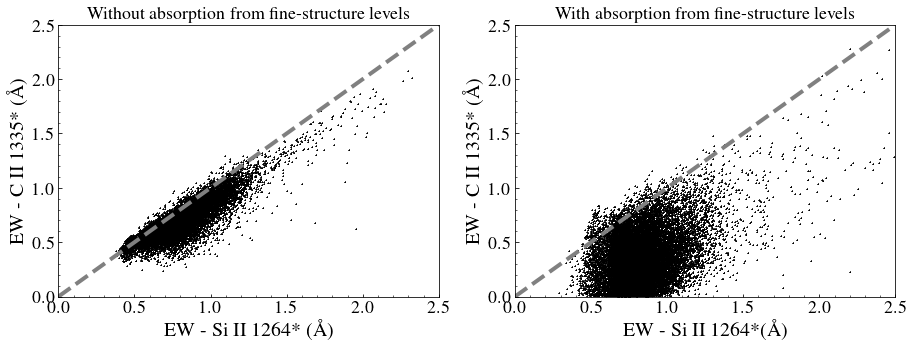

In [62]:
fig, axs= plt.subplots(1,2, figsize =(15,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

# Create the colormap
    
# axs[0].errorbar(classy['EWSiII1260'], classy['EWCII334'], 
#                 xerr = classy['ErrEWSiII1260'], yerr = classy['ErrEWCII334'],
#                 label = 'CLASSY - Included', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')
# axs[0].errorbar(classy['EWSiII1260'][maskInc], 
#                 classy['EWCII334'][maskInc], 
#                 xerr = classy['ErrEWSiII1260'][maskInc], 
#                 yerr = classy['ErrEWCII334'][maskInc],
#                 label = 'CLASSY - Excluded', c = 'r', linestyle = 'None', marker = 'o', markeredgecolor = 'k')

axs[0].scatter( EWemiSiIInf.flatten()[:], EWemiCIInf.flatten()[:], zorder = 0, marker = '+', 
                   c = 'k', s = 1)
    
axs[0].plot(np.linspace(0,2.5),np.linspace(0,2.5), linestyle = '--', c ='gray', lw = 4)
axs[0].set_xlabel(r'EW - Si II 1264* ($\rm \AA$)', fontsize = 20)
axs[0].set_ylabel(r'EW - C II 1335* ($\rm \AA$)', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
axs[0].set_title('Without absorption from fine-structure levels')
# axs[0].fill_between([-4,-2],-4, color="none", hatch="XX", edgecolor="k", linewidth=0.0, alpha = 0.2)
axs[0].set_xlim(0,2.5)
axs[0].set_ylim(0,2.5)

# Create the colormap
ax = axs[1]
# ax.errorbar(classy['EWSiII1260'], classy['EWCII334'], 
#                 xerr = classy['ErrEWSiII1260'], yerr = classy['ErrEWCII334'],
#                 label = 'CLASSY - Included', c = cFS, linestyle = 'None', marker = 'o', markeredgecolor = 'k')
# ax.errorbar(classy['EWSiII1260'][maskInc], 
#                 classy['EWCII334'][maskInc], 
#                 xerr = classy['ErrEWSiII1260'][maskInc], 
#                 yerr = classy['ErrEWCII334'][maskInc],
#                 label = 'CLASSY - Excluded', c = 'r', linestyle = 'None', marker = 'o', markeredgecolor = 'k')
cm = ax.scatter( EWemiSiIIfs.flatten()[:], EWemiCIIfs.flatten()[:], zorder = 0, marker = '+', 
                   c = 'k', s = 1)
    
ax.plot(np.linspace(0,2.5),np.linspace(0,2.5), linestyle = '--', c = 'gray', lw = 4)
ax.set_xlabel(r'EW - Si II 1264*($\rm \AA$)', fontsize = 20)
ax.set_ylabel(r'EW - C II 1335* ($\rm \AA$)', fontsize = 20)
# ax.legend(frameon = False, fontsize = 15)
ax.set_title('With absorption from fine-structure levels')

axs[0].tick_params(axis='both', which='major', labelsize=18)
ax.tick_params(axis='both', which='major', labelsize=18)
ax.set_xlim(0,2.5)
ax.set_ylim(0,2.5)
# plt.savefig('EWEmission.pdf', bbox_inches = 'tight')
  

## Comparison with new dust w/r to depletion+vturb


### Global properties

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


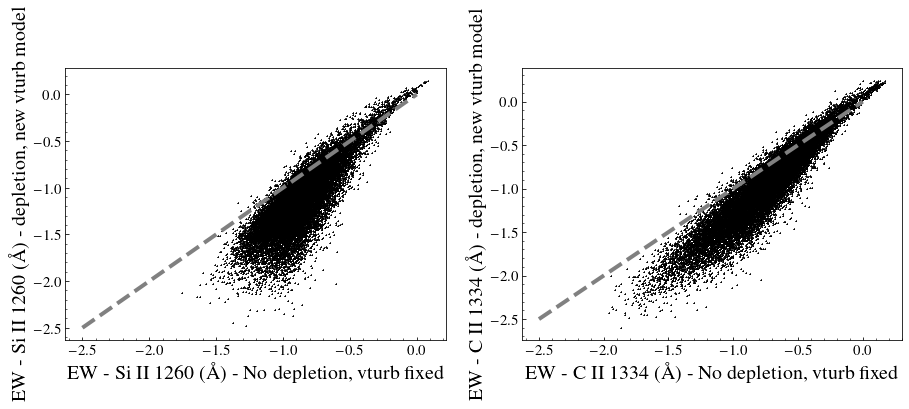

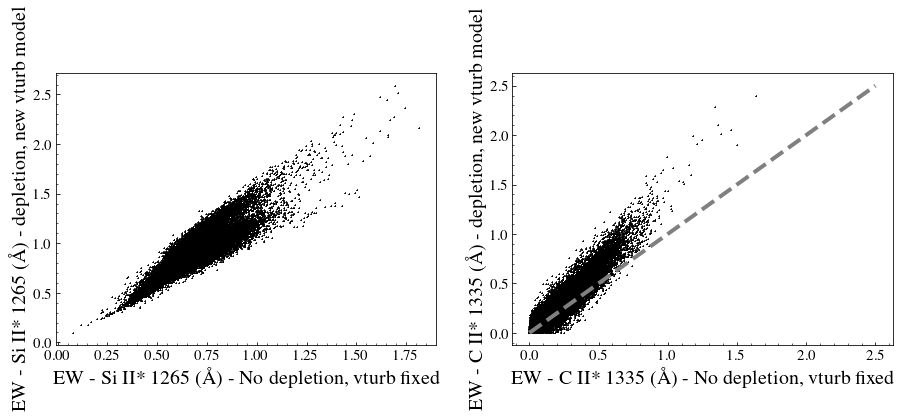

In [13]:
## Diff FS no FS

fig, axs= plt.subplots(1,2, figsize =(15,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

axs[0].scatter( EWabsSiIIdu.flatten()[:], EWabsSiIIdep.flatten()[:], zorder = 0, marker = '+', 
                   c = 'k', s = 1)
    
axs[0].plot(np.linspace(-2.5,0),np.linspace(-2.5,0), linestyle = '--', c ='gray', lw = 4)
axs[0].set_xlabel(r'EW - Si II 1260 ($\rm \AA$) - No depletion, vturb fixed', fontsize = 20)
axs[0].set_ylabel(r'EW - Si II 1260 ($\rm \AA$) - depletion, new vturb model', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
# axs[0].set_title('Without absorption from fine-structure levels')

axs[1].scatter( EWabsCIIdu.flatten()[:], EWabsCIIdep.flatten()[:], zorder = 0, marker = '+', 
                   c = 'k', s = 1)
    
axs[1].plot(np.linspace(-2.5,0),np.linspace(-2.5,0), linestyle = '--', c ='gray', lw = 4)
axs[1].set_xlabel(r'EW - C II 1334 ($\rm \AA$) - No depletion, vturb fixed', fontsize = 20)
axs[1].set_ylabel(r'EW - C II 1334 ($\rm \AA$) - depletion, new vturb model', fontsize = 20)
axs[1].legend(frameon = False, fontsize = 15)


fig, axs= plt.subplots(1,2, figsize =(15,5))
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B
n_bins = [3, 6, 10, 100]  # Discretizes the interpolation into bins
cmap_name = 'my_list'
cmap = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)

axs[0].scatter( EWemiSiIIdu.flatten()[:], EWemiSiIIdep.flatten()[:], zorder = 0, marker = '+', 
                   c = 'k', s = 1)
    
# axs[0].plot(np.linspace(0, 2.5),np.linspace(0,2.5), linestyle = '--', c ='gray', lw = 4)
axs[0].set_xlabel(r'EW - Si II* 1265 ($\rm \AA$) - No depletion, vturb fixed', fontsize = 20)
axs[0].set_ylabel(r'EW - Si II* 1265 ($\rm \AA$) - depletion, new vturb model', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)
# axs[0].set_title('Without absorption from fine-structure levels')

axs[1].scatter( EWemiCIIdu.flatten()[:], EWemiCIIdep.flatten()[:], zorder = 0, marker = '+', 
                   c = 'k', s = 1)
    
axs[1].plot(np.linspace(0, 2.5),np.linspace(0,2.5), linestyle = '--', c ='gray', lw = 4)
axs[1].set_xlabel(r'EW - C II* 1335 ($\rm \AA$) - No depletion, vturb fixed', fontsize = 20)
axs[1].set_ylabel(r'EW - C II* 1335 ($\rm \AA$) - depletion, new vturb model', fontsize = 20)
axs[1].legend(frameon = False, fontsize = 15)
  

In [9]:
nxyA,imsizeA,lcubeSiIIA,cubeSiIIA = read_cube('./data_cubes_output_148/SiII2/',300)
print(nxyA)
nxyB,imsizeB,lcubeSiIIB,cubeSiIIB = read_cube('./data_cubes_output_148/SiII3/',300)
print(nxyB)


64
64


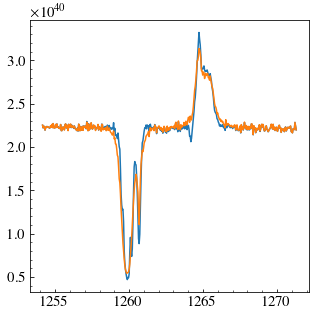

In [16]:
specA = np.sum(cubeSiIIA[100,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1
specB = np.sum(cubeSiIIB[100,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1

plt.figure(figsize = (5,5))
plt.plot(lcubeSiIIA[1:],specA)
plt.plot(lcubeSiIIB[1:],specB)
# plt.imshow( np.sum(cubeSiIIA[0,:,:,1:],axis=(2)), norm=LogNorm(vmin=1e35,vmax=1e39),)
# plt.figure(figsize = (10,10))
# plt.imshow( np.sum(cubeSiIIB[0,:,:,1:],axis=(2)), norm=LogNorm(vmin=1e35,vmax=1e39),)

Text(0, 0.5, 'R  Si II with depletion')

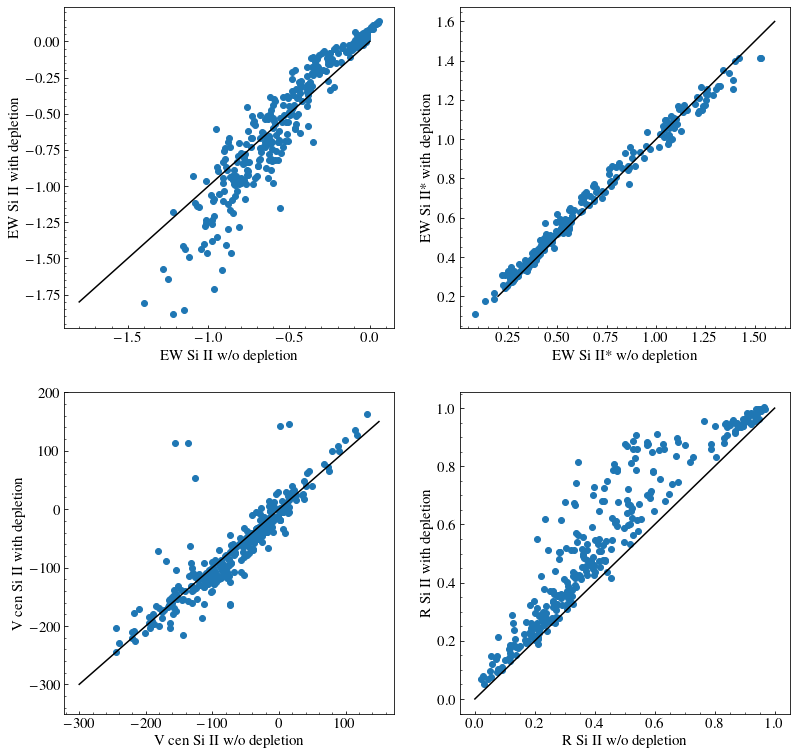

In [39]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2,2,figsize = (13,13))

ax1.scatter(EWabsSi[0],EWabsSi[1])
ax1.plot(np.linspace(-1.8,0),np.linspace(-1.8,0), color = 'k')
ax1.set_xlabel('EW Si II w/o depletion')
ax1.set_ylabel('EW Si II with depletion')

ax2.scatter(EWemiSi[0],EWemiSi[1])
ax2.plot(np.linspace(0.2,1.6),np.linspace(0.2,1.6), color = 'k')
ax2.set_xlabel('EW Si II* w/o depletion')
ax2.set_ylabel('EW Si II* with depletion')


ax3.scatter(VcenSi[0], VcenSi[1])
ax3.plot(np.linspace(-300,150),np.linspace(-300,150), color = 'k')
ax3.set_xlabel('V cen Si II w/o depletion')
ax3.set_ylabel('V cen Si II with depletion')
ax3.set_ylim(-350, 200)
ax4.scatter(RabsSi[0], RabsSi[1])
ax4.plot(np.linspace(0,1),np.linspace(0,1), color = 'k')
ax4.set_xlabel('R  Si II w/o depletion')
ax4.set_ylabel('R  Si II with depletion')

### FItting

0 j0021+0052
160.0 120.0
15.360690085682043 15.141403922402455


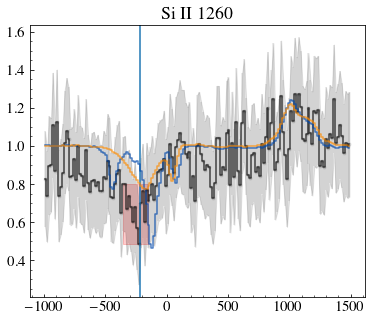

1 j0036-3333
278.0 179.0
203.50884500701304 194.41835886505513


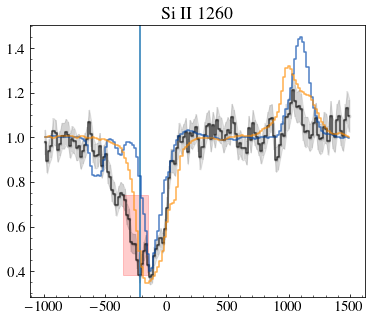

2 j0127-0619
227.0 227.0
45.19322949730199 49.20854332298087


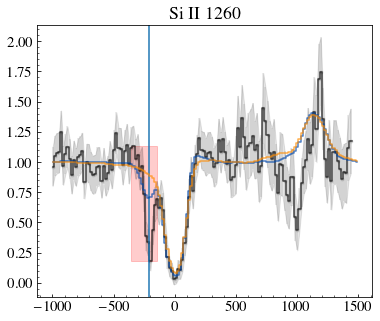

3 j0144+0453
115.0 244.0
27.709048761960084 33.77429321034691


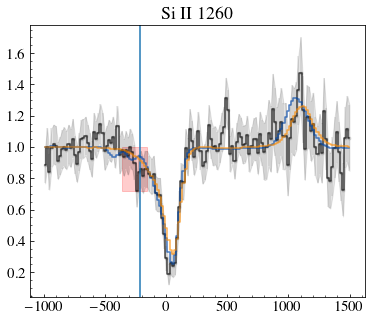

4 j0337-0502
222.0 222.0
134.6388916241548 108.61067254548716


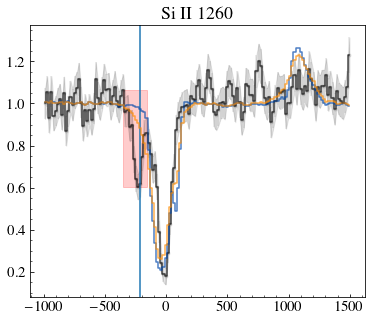

5 j0405-3648
201.0 161.0
44.64510749498011 44.029583819536434


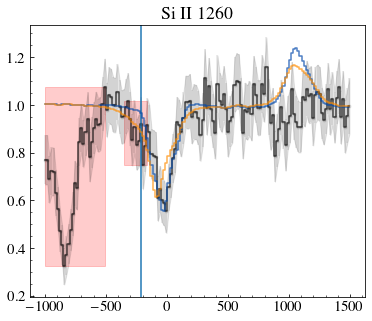

6 j0808+3948
46.0 46.0
122.54420255979547 106.5685490471924


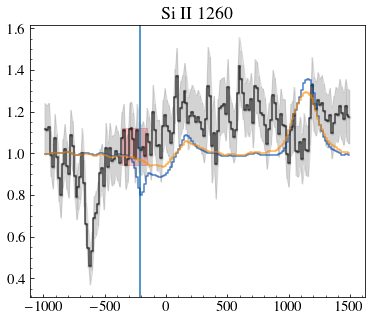

7 j0823+2806
154.0 154.0
76.13051063434393 63.412169429478155


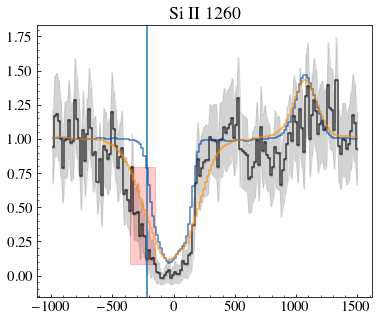

8 j0926+4427
260.0 162.0
33.102931691763125 35.16579496573293


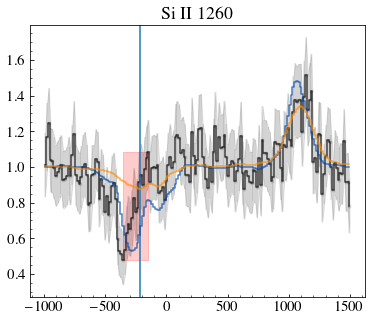

9 j0934+5514
240.0 122.0
256.8591478124752 257.19613651582205


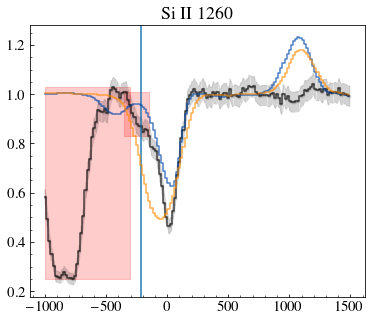

10 j0938+5428
185.0 225.0
33.94493335149668 45.13352222904845


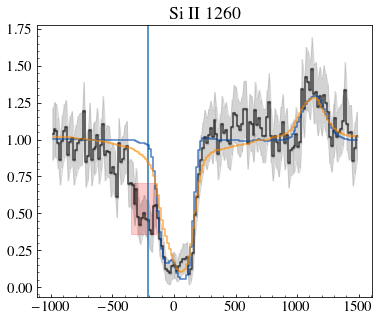

11 j0940+2935
222.0 122.0
37.98817765847018 29.78854197594668


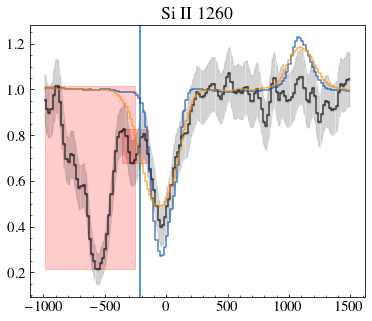

12 j0942+3547
0.0 0.0
0.0 0.0


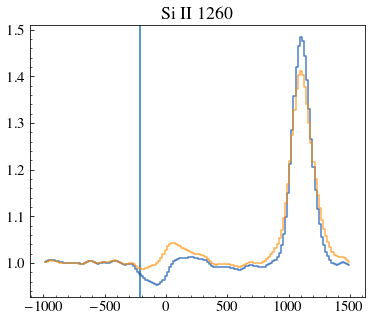

13 j0944-0038
220.0 227.0
19.181423209330294 20.23011777937599


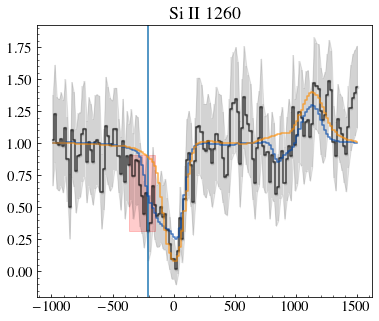

14 j0944+3442
0.0 0.0
0.0 0.0


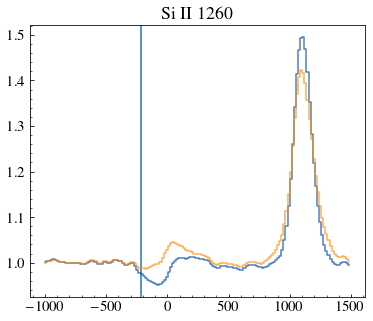

15 j1016+3754
182.0 201.0
31.66669836321955 31.258786099243054


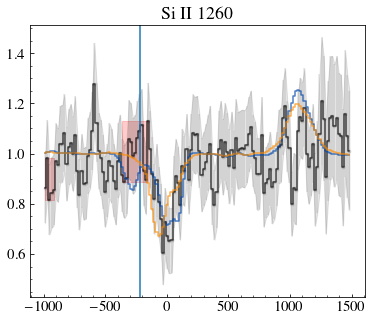

16 j1024+0524
200.0 221.0
27.36934181611619 32.575526397706376


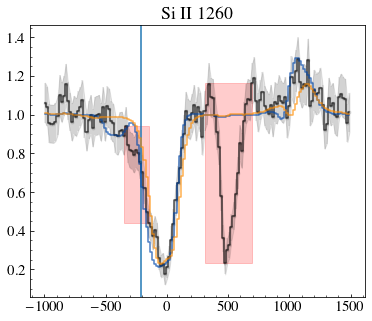

17 j1025+3622
200.0 101.0
20.794917428019584 21.591009306476288


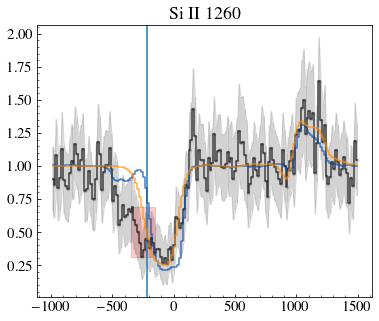

18 j1044+0353
0.0 0.0
0.0 0.0


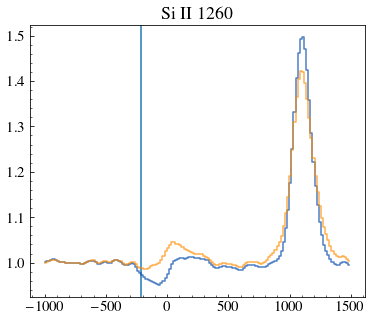

19 j1105+4444
177.0 177.0
77.08583398627943 72.90285579401875


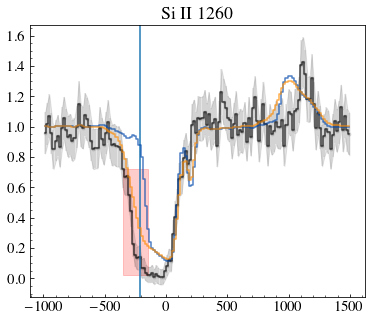

20 j1112+5503
200.0 138.0
120.40423522320643 110.32767856115346


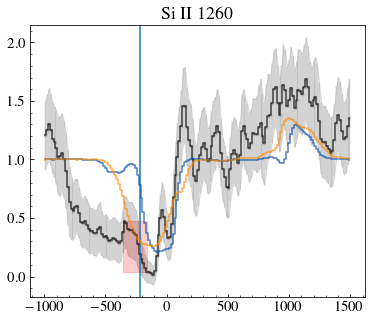

21 j1119+5130
130.0 210.0
36.67140007509912 37.84013283395057


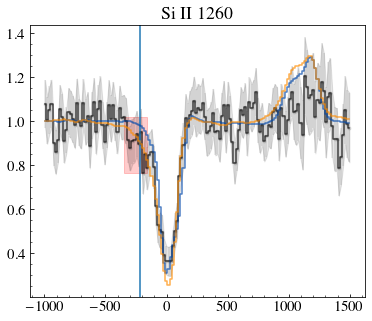

22 j1129+2034
241.0 241.0
47.29555376239366 36.90670250993503


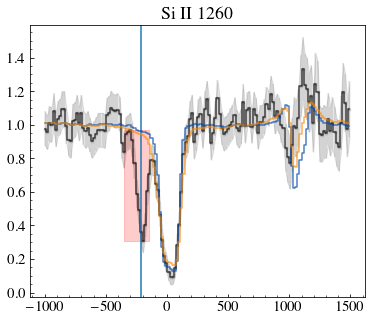

23 j1132+1411
0.0 0.0
0.0 0.0


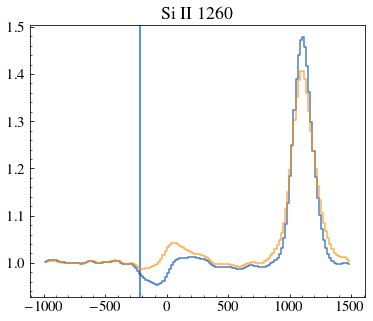

24 j1132+5722
116.0 130.0
10.694050916902036 9.114768385262154


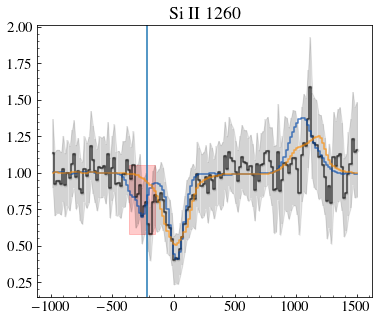

25 j1144+4012
157.0 220.0
60.69988203352335 43.46476547846256


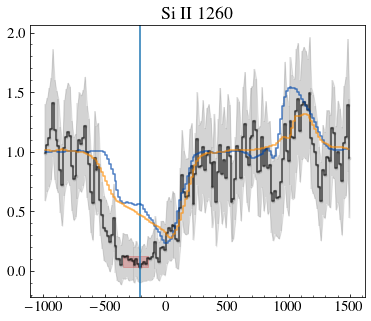

26 j1148+2546
155.0 155.0
31.88732432583309 30.09499029982072


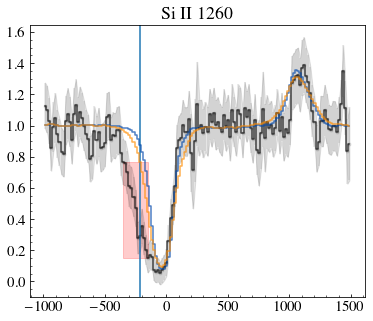

27 j1150+1501
221.0 221.0
42.83356114726424 68.56806301032086


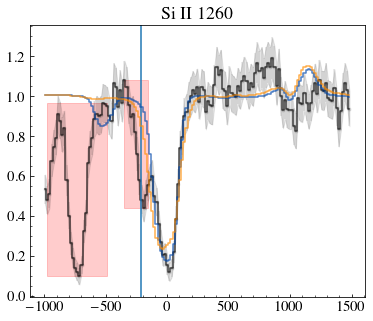

28 j1157+3220
0.0 0.0
0.0 0.0


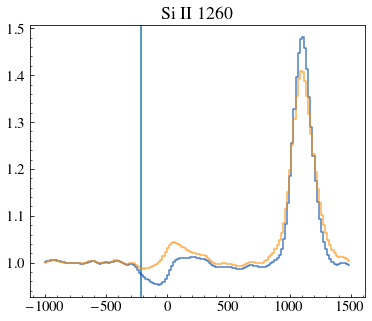

29 j1200+1343
101.0 101.0
41.69643280176267 41.93183845946723


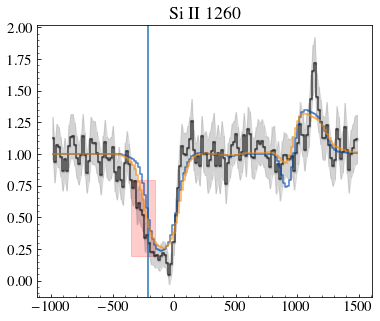

30 j1225+6109
241.0 241.0
37.65331471221971 34.980695173025545


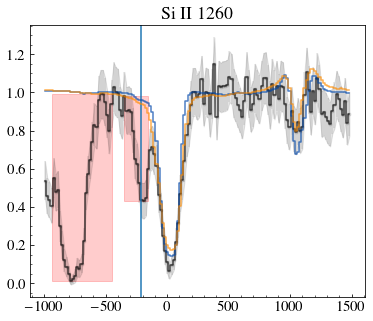

31 j1253-0312
181.0 181.0
56.44296671829413 84.01704115671309


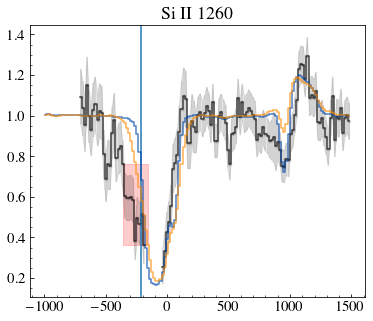

32 j1314+3452
155.0 155.0
225.03749839985497 249.84645589787098


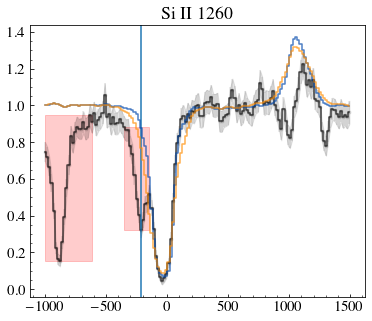

33 j1323-0132
161.0 161.0
72.77698965043629 71.89552864663167


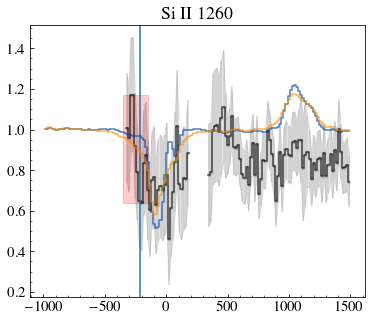

34 j1359+5726
0.0 0.0
0.0 0.0


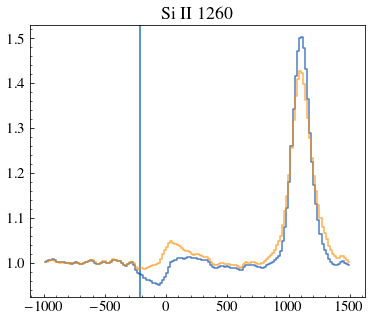

35 j1416+1223
198.0 154.0
77.94684929026948 56.283923413252225


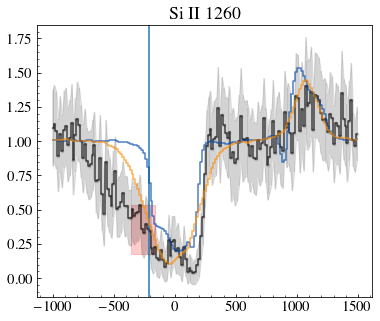

36 j1418+2102
216.0 237.0
12.040044426752871 11.911490346571838


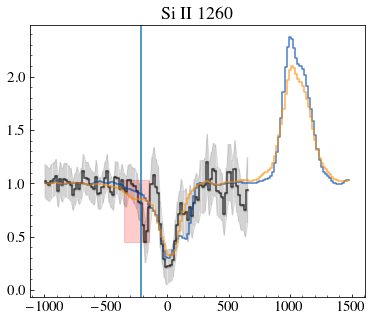

37 j1428+1653
278.0 283.0
14.61897767974333 13.930986287510965


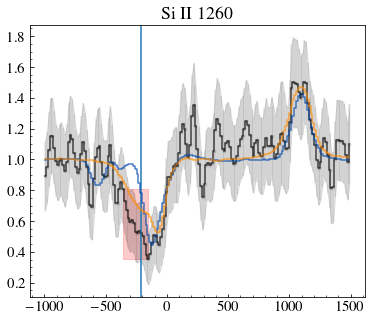

38 j1429+0643
200.0 138.0
42.60951616671197 42.552758920576785


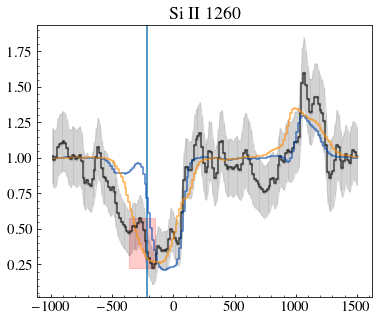

39 j1444+4237
122.0 222.0
33.30997725889281 31.269259986082325


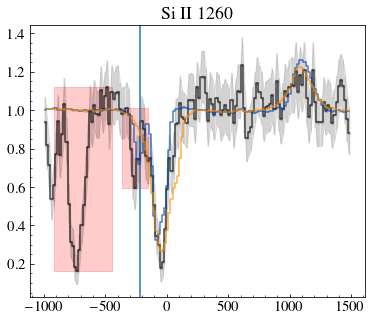

40 j1448-0110
245.0 177.0
51.84114911993222 70.64141397030025


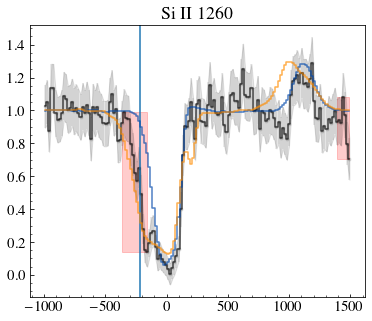

41 j1521+0759
0.0 0.0
0.0 0.0


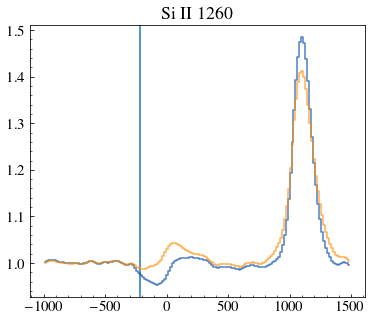

42 j1525+0757
160.0 220.0
332.89198811297837 220.50140604320546


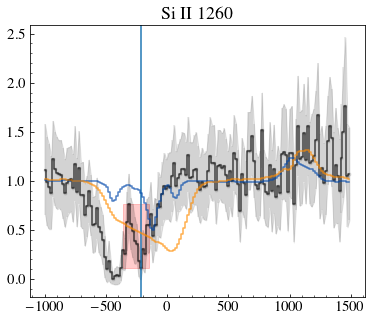

43 j1545+0858
222.0 102.0
25.28087874238105 19.683369298316507


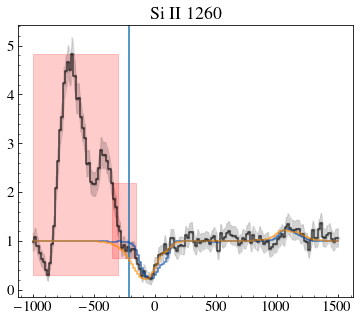

44 j1612+0817
260.0 157.0
443.0340971225295 384.21529126633936


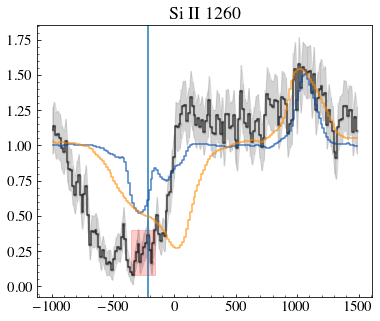

In [48]:
#FITS
import warnings
warnings.filterwarnings('ignore')

# nxy,imsize,lcubecII,cubecII = read_cube('./data_cubes_output_148/CII2/',300)
# print(nxy)
# nxy,imsize,lcubeSiII,cubeSiII = read_cube('./data_cubes_output_148/SiII2/',300)

nGal = len(galaxy)
nmocks         = 1
Chi2allA        = np.zeros((45, nmocks)) + 1e10
Chi2allB        = np.zeros((45, nmocks)) + 1e10

dirallA         = np.zeros((45, nmocks)) - 1
dirallB         = np.zeros((45, nmocks)) - 1

outallA         = np.zeros((45, nmocks)) - 1
outallB         = np.zeros((45, nmocks)) - 1

for i in range(nGal):
    print(i,label[i])
        
    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

#     vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c

#     cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    
#     maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    

#     fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
#     ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
#     vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
#     rmedCII = ((vcII<-500) | (vcII > 500)) & maskCII
#     fmedCII = np.nanmedian(fcII[rmedCII])
#     if(i == 1):      
#         fmedCII /=1.05
#     fcII /= fmedCII
#     if (i == 2):
#         fcII/=1.06


    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII

    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    if(i == 0):
        fmedSiII *=1.15
    fsiII /= fmedSiII
    
    fig, ax2 = plt.subplots(1,1,figsize=(6,5))
#     #/np.nanmedian(flux[cutCIIall])
#     axs[1].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
#     axs[1].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
#     if(len(fcII[~maskCII])>0):
#         axs[1].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
#                             alpha=0.2, color= 'r')
#     axs[1].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
#     axs[1].set_title('C II 1334')
   
    
    ax2.errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    ax2.plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    ax2.fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]), 
                        np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')  
    ax2.axvline(-214)
    if(len(fsiII[~maskSiII])>0):
        ax2.fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  

#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    ax2.fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    ax2.set_title('Si II 1260')

    ## Find new best fit locally
#     bestmodelcII = 0
    bestmodelsiIIA = 0
    bestmodelsiIIB = 0

    for dd in np.arange(0,300,1):


        specold = np.sum(cubeSiIIA[dd,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1
        specdep = np.sum(cubeSiIIB[dd,:,:,1:],axis=(0,1)) # the first wavelength pixel bugs, so I start at 1

        lsyssiIIA   = lcubeSiIIA[1:] + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiIIA[1:]) 
        lsyssiIIB   = lcubeSiIIB[1:] + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiIIB[1:]) 

        vsiIIA  = (lsyssiIIA/wsiII1260-1)*c
        vsiIIB  = (lsyssiIIB/wsiII1260-1)*c

        sigma_pixelcii = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] / 2.355/((vsiIIA[50]-vsiIIA[49]))
        #######################################################

        modelA          = gaussian_filter(specold, sigma = sigma_pixelcii)
        f              = interpolate.interp1d(vsiIIA, modelA)
        modelNewsiIIA    = f(vsiII)

        rmedSiIIA = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
        fmedSiIIA = np.nanmedian(modelNewsiIIA[rmedSiIIA])
        modelNewsiIIA /= fmedSiIIA
         
            
        modelB          = gaussian_filter(specdep, sigma = sigma_pixelcii)
        f              = interpolate.interp1d(vsiIIB, modelB)
        modelNewsiIIB    = f(vsiII)
        rmedSiIIB = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
        fmedSiIIB = np.nanmedian(modelNewsiIIB[rmedSiIIB])
        modelNewsiIIB /= fmedSiIIB
        
        
        maskSiII = maskSiII & (vsiII > - 550) & (~((vsiII >-364) & (vsiII <-144)))

        lnlikesiIIA =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsiIIA[maskSiII])**2)/esiII[maskSiII]**2)
        lnlikesiIIB =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsiIIB[maskSiII])**2)/esiII[maskSiII]**2)

#             print(lnlikesiII)
#             lnlikeall  = lnlikecII + lnlikesiII
                   
#         if lnlikecII < Chi2cII[i][0] :
#             Chi2cII[i][0] = lnlikecII
#             dircII[i][0]  = idir
#             outcII[i][0]  = output

#         if lnlikesiII < Chi2siII[i][0] :
#             Chi2siII[i][0] = lnlikesiII
#             dirsiII[i][0]  = idir
#             outsiII[i][0]  = output

        if(lnlikesiIIA < Chi2allA[i][0]):
            dirallA[i][0] = dd
            Chi2allA[i][0] = lnlikesiIIA
            outallA[i][0] = 148
            bestmodelsiIIA = modelNewsiIIA
#             bestfluxciiall = modelNewcII        
        if(lnlikesiIIB < Chi2allB[i][0]):
            dirallB[i][0] = dd
            Chi2allB[i][0] = lnlikesiIIB
            outallB[i][0] = 148
            bestmodelsiIIB = modelNewsiIIB

# #         else:
#         bestDir         = dfdust['DirAll'][i]
#         bestOut         = dfdust['OutputAll'][i]    
#         labels= 'Best simu is with FS and ND - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2dust)
#         path_to_data = './CII_SiII_ND/' 

#         lcII, fluxcII   = read_spectrum_c(path_to_data,  bestOut )
#         lsiII, fluxsiII = read_spectrum_si(path_to_data, bestOut )

#                 ## CII Plot
#         lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
#         lcII_systemic  = lcII_systemic[1:]
#         vcII_s         = (lcII_systemic/wcII1334 -1)*c
#         sigma_pixelcii = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] / 2.355/((vcII_s[50]-vcII_s[49]))
#         model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
#         f              = interpolate.interp1d(vcII_s, model)
#         modelNewcii    = f(vcII)

#         rmedCII = ((vcII<-500) | (vcII > 500)) 
#         fmedCII = np.nanmedian(modelNewcii[rmedCII])
#         modelNewcii /= fmedCII
#     #     axs[0].plot(vcII, modelNewcii, c =cFS, lw = 3)

#       #  ax2.errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
#       #  ax2.plot(vcII, fcII,  c='k', alpha = 0.7, drawstyle='steps-mid' , label = 'Observed')
#         ax2.plot(vcII, modelNewcii, drawstyle='steps-mid', label='Original best fit', c = cFS, linewidth = 2) 
#         ax2.plot(vcII, bestmodelcII, drawstyle='steps-mid', label='New best fit' , c = cnoFS, linewidth = 2) 
#         ax2.legend()

#         ### Si II plot
#         lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
#         lsiII_systemic = lsiII_systemic[1:]
#         vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
#         sigma_pixelsi  = res[i]  /2.355/ ((vsiII_s[50]-vsiII_s[49]))
#         model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
#         f              = interpolate.interp1d(vsiII_s, model)
#         modelNewsi     = f(vsiII)
        
#         rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
#         fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
#         modelNewsi /= fmedSiII
#         ax3.plot(vsiII, modelNewsi, drawstyle='steps-mid', label='Original best fit', c = cFS, linewidth = 2) 
#         ax3.plot(vsiII, bestmodelsiII, drawstyle='steps-mid', label='New best fit' , c = cnoFS, linewidth = 2) 
#         ax3.legend()
#         #plt.savefig('Plots/'+galaxy[i]+'matchcube.pdf', bbox_inches = 'tight')
#         plt.show()
#     except:
#         print('didnwork')

    print(dirallA[i][0], dirallB[i][0])
    print(Chi2allA[i][0], Chi2allB[i][0])
    ax2.plot(vsiII, bestmodelsiIIA,  c=cFS,  alpha = 0.7,drawstyle='steps-mid' )
    ax2.plot(vsiII, bestmodelsiIIB,  c=cnoFS,  alpha = 0.7,drawstyle='steps-mid' )
    plt.show()

0 j0021+0052
1 j0036-3333


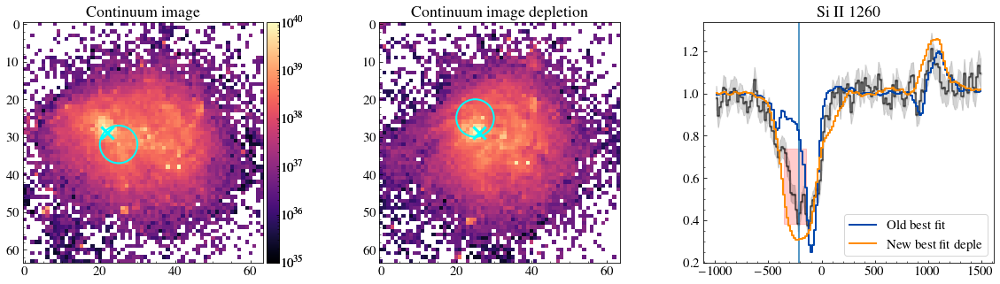

2 j0127-0619


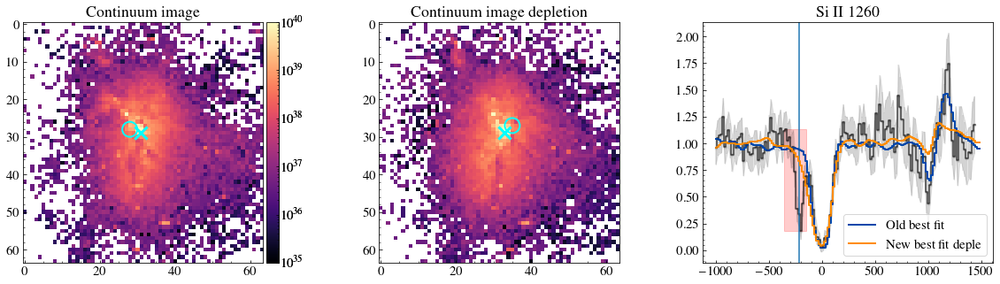

3 j0144+0453


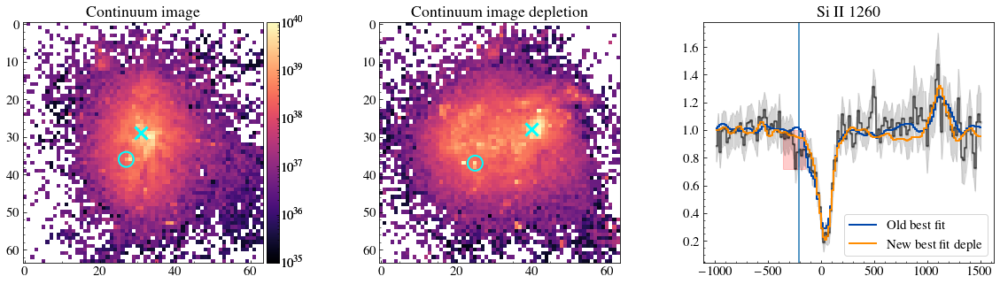

4 j0337-0502


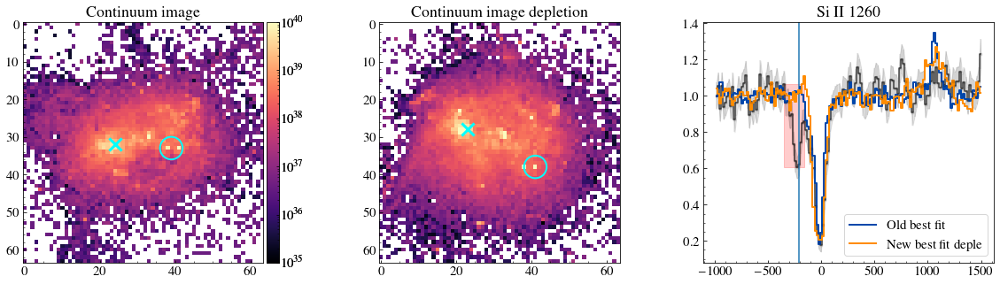

5 j0405-3648


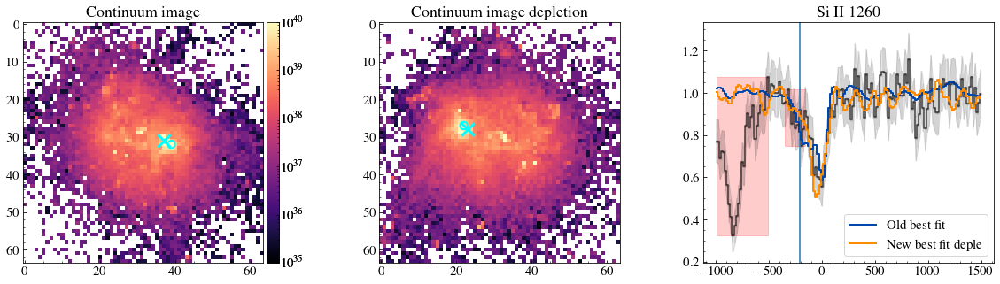

6 j0808+3948
7 j0823+2806


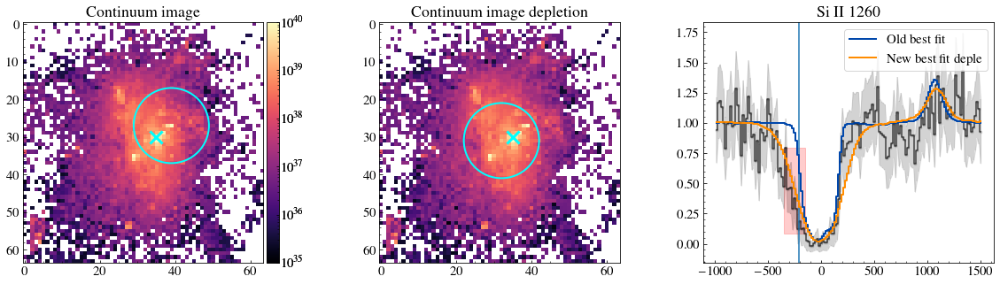

8 j0926+4427
9 j0934+5514


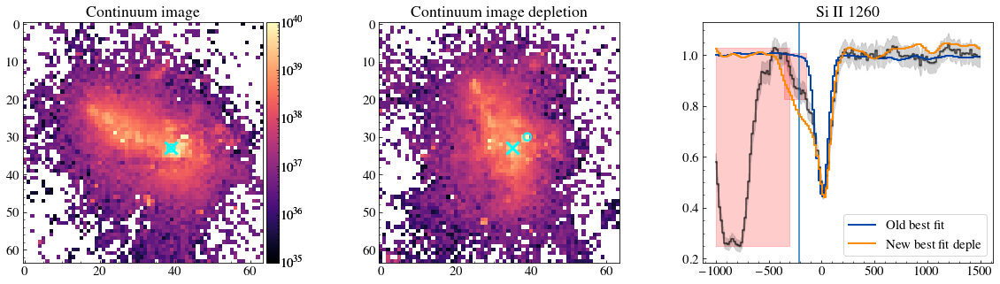

10 j0938+5428
11 j0940+2935


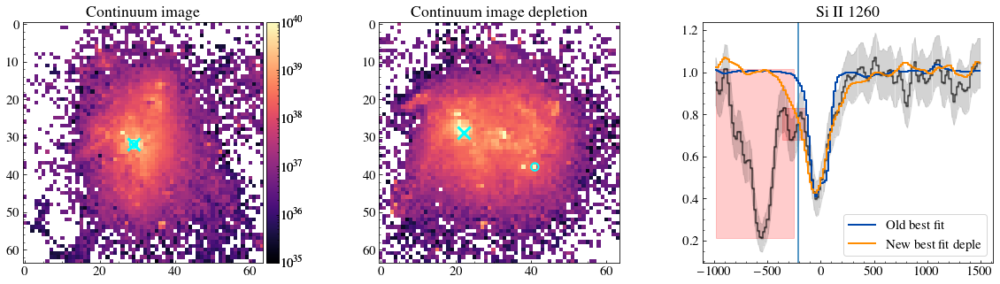

12 j0942+3547
didnwork
13 j0944-0038


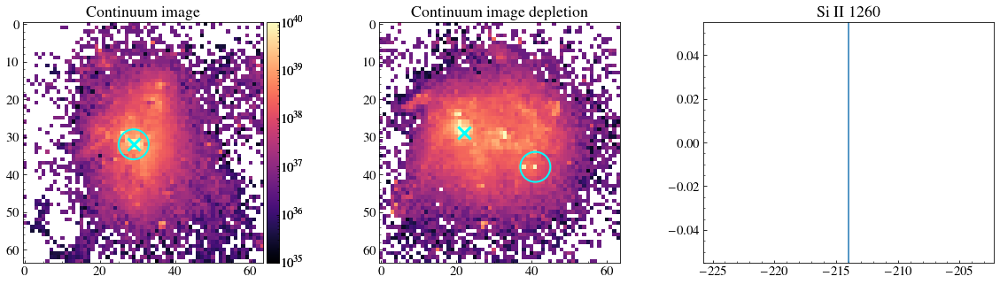

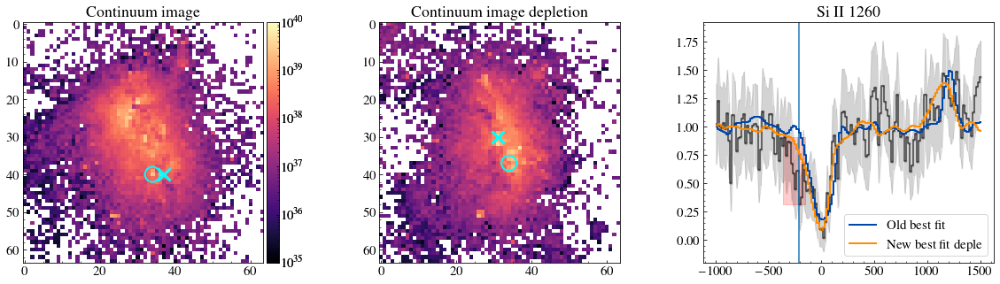

14 j0944+3442
didnwork
15 j1016+3754


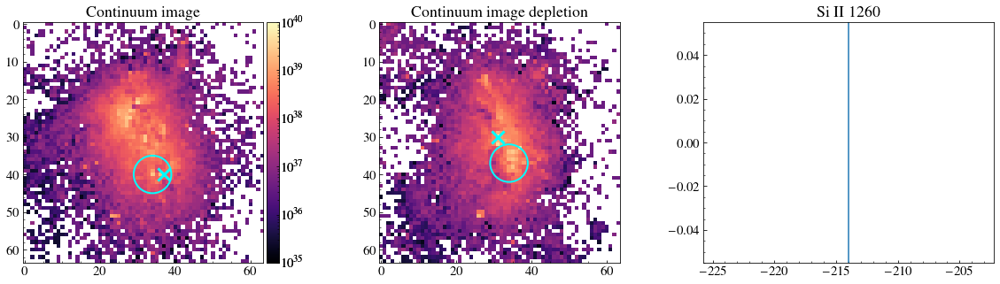

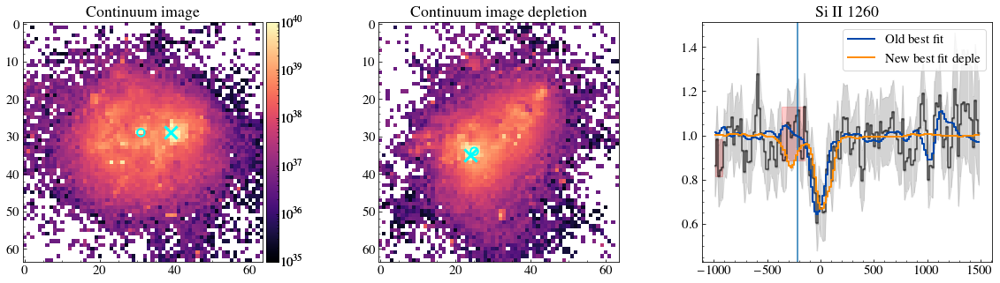

16 j1024+0524


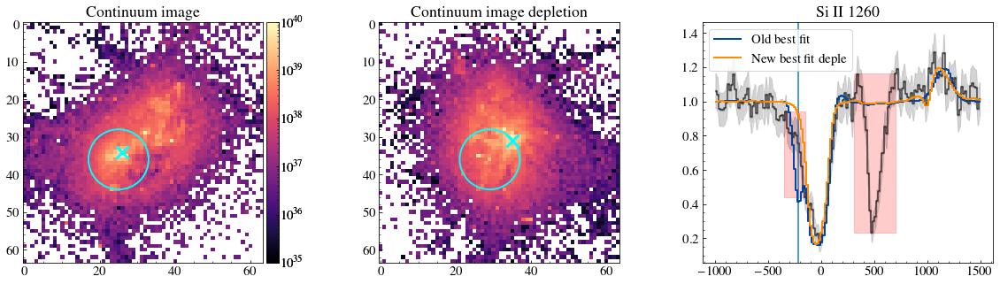

17 j1025+3622
18 j1044+0353
didnwork
19 j1105+4444


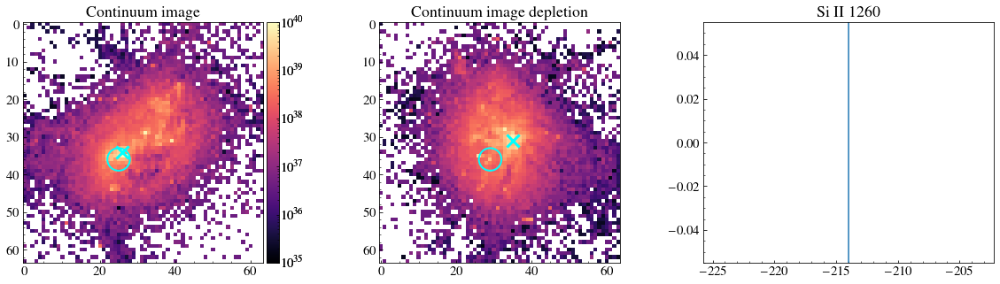

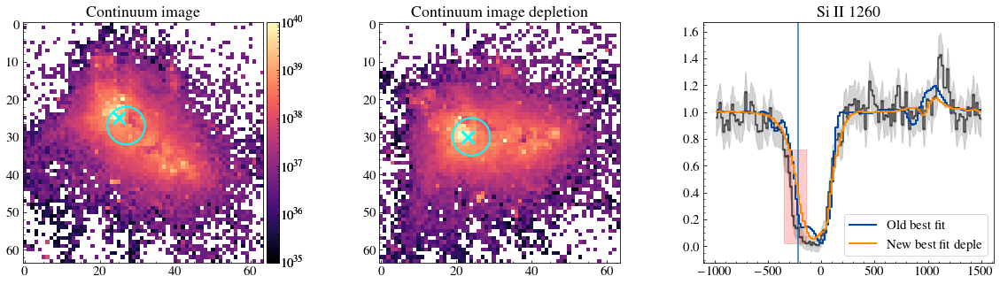

20 j1112+5503
21 j1119+5130


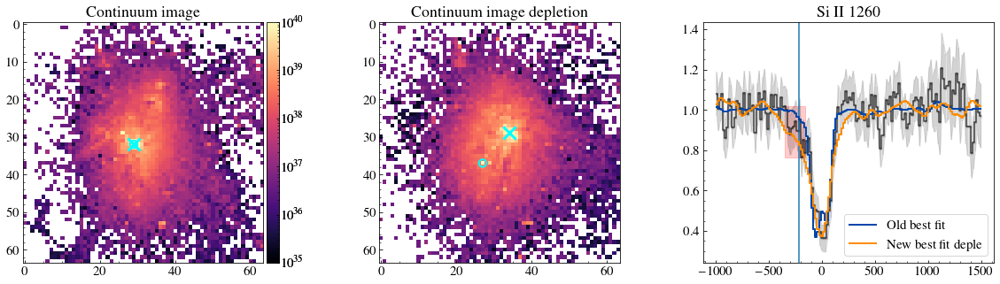

22 j1129+2034


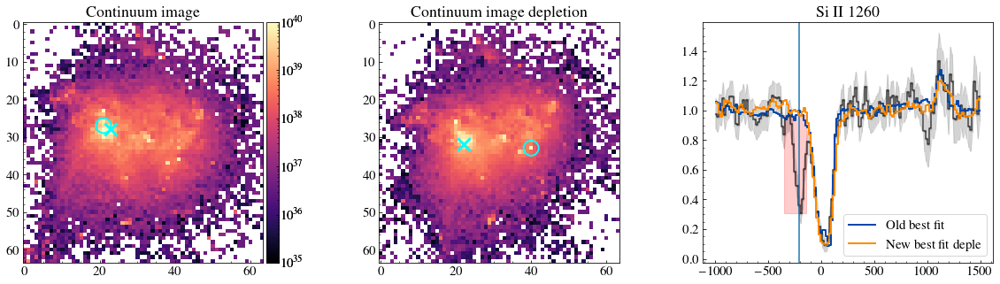

23 j1132+1411
didnwork
24 j1132+5722


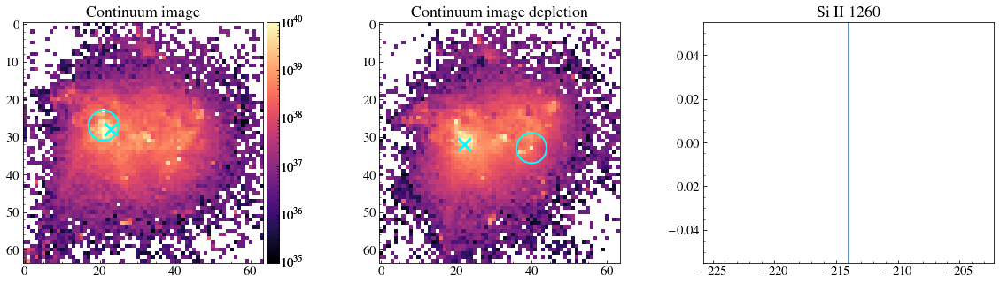

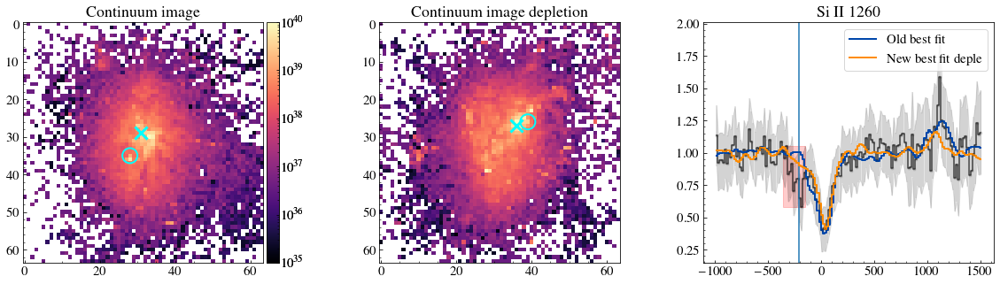

25 j1144+4012
26 j1148+2546


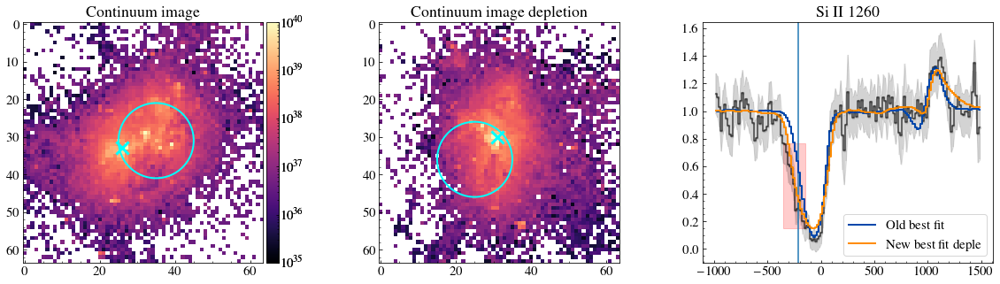

27 j1150+1501


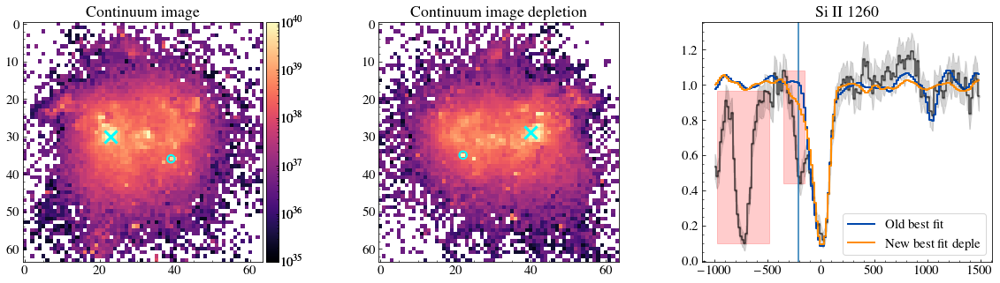

28 j1157+3220
didnwork
29 j1200+1343
30 j1225+6109


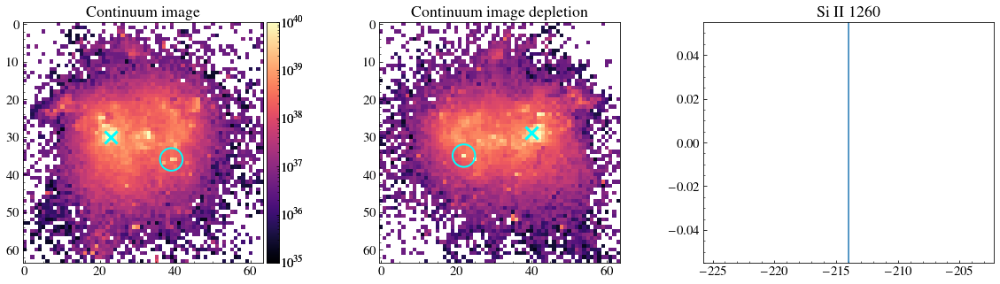

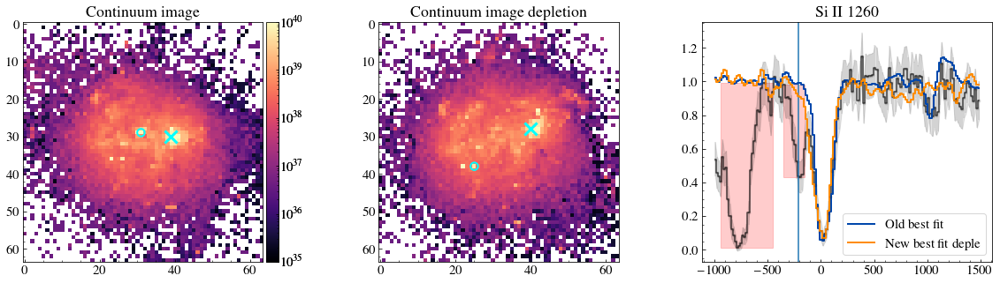

31 j1253-0312


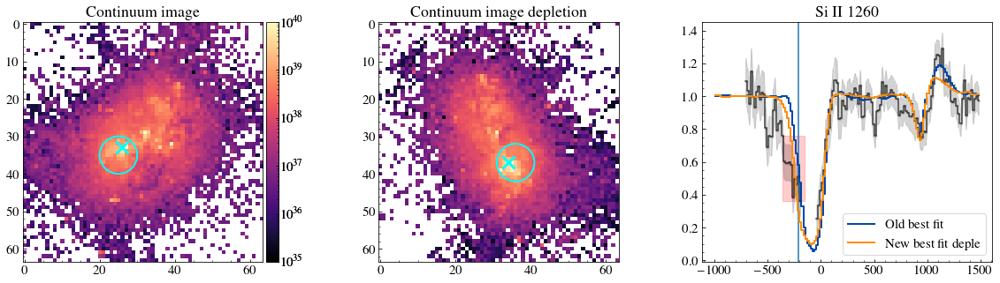

32 j1314+3452


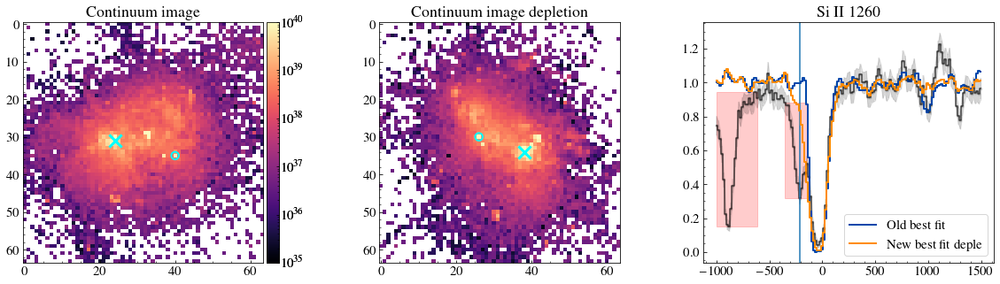

33 j1323-0132


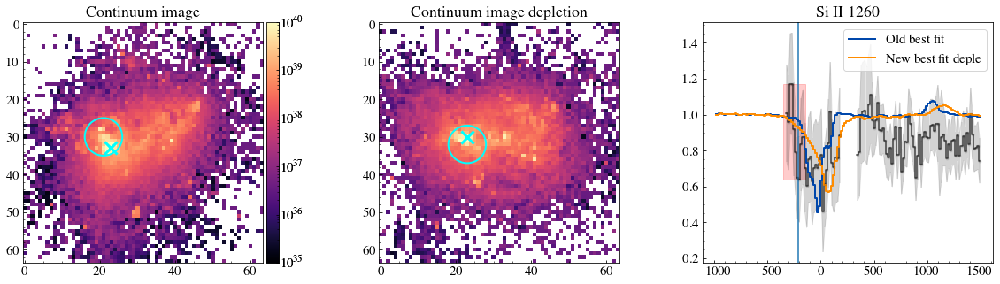

34 j1359+5726
didnwork
35 j1416+1223
36 j1418+2102


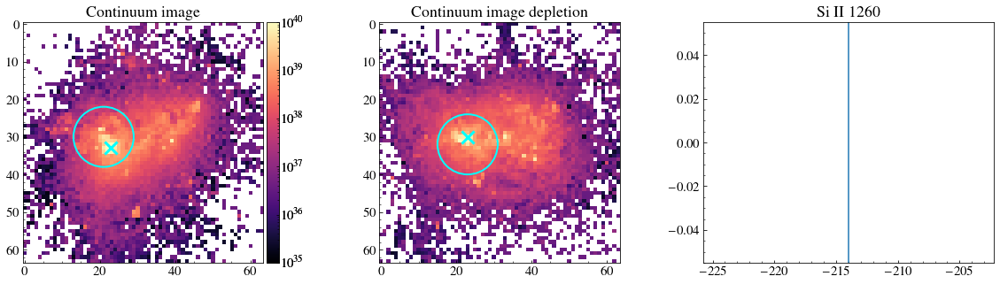

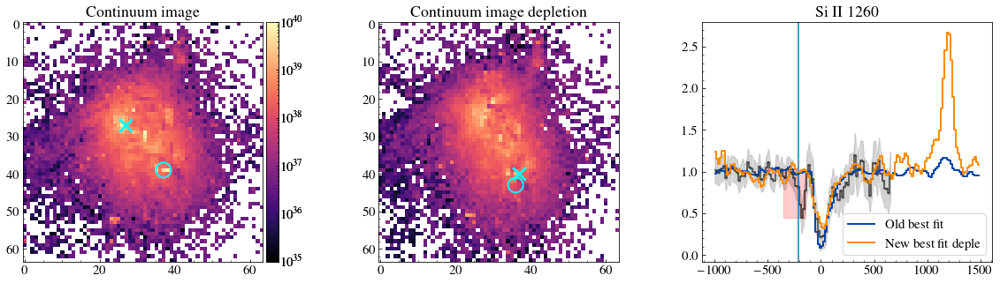

37 j1428+1653
38 j1429+0643
39 j1444+4237


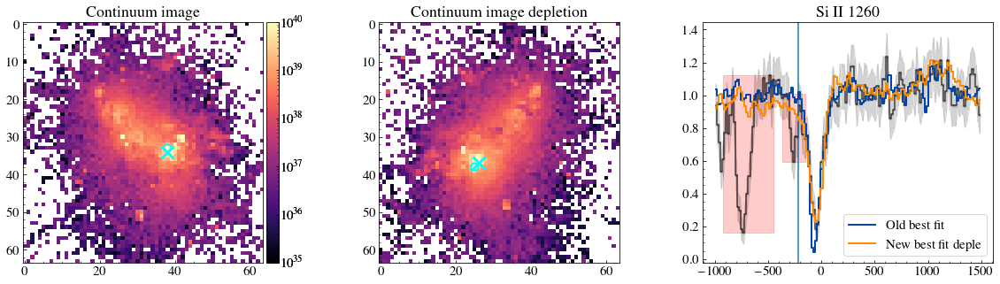

40 j1448-0110


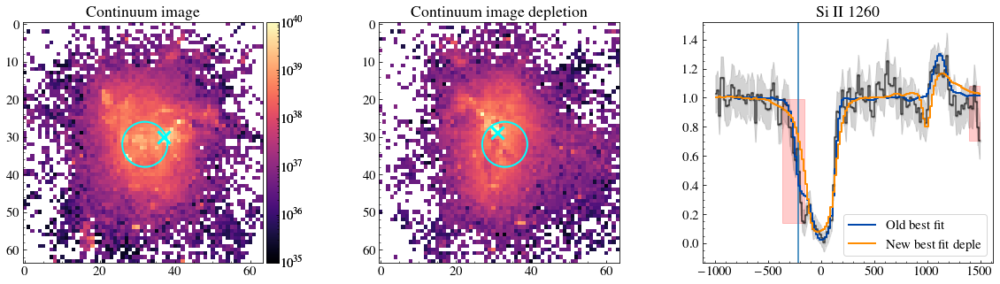

41 j1521+0759
42 j1525+0757
43 j1545+0858


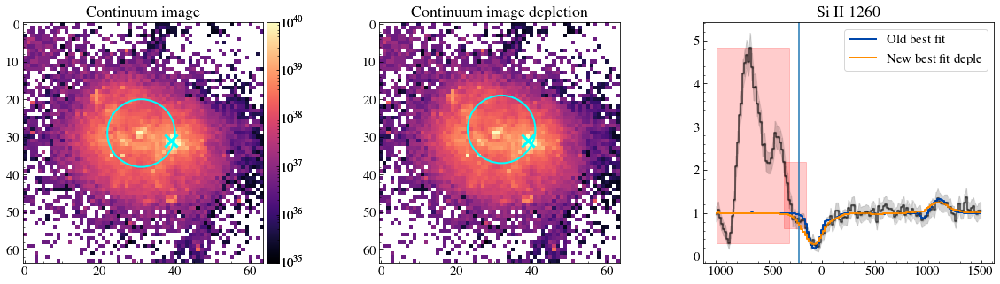

44 j1612+0817


In [69]:
#FITS
import warnings
warnings.filterwarnings('ignore')

nGal = len(galaxy)
nmocks         = 1
Chi2allA        = np.zeros((45, nmocks)) + 1e10
Chi2allB        = np.zeros((45, nmocks)) + 1e10

dirallA         = np.zeros((45, nmocks)) - 1
dirallB         = np.zeros((45, nmocks)) - 1

outallA         = np.zeros((45, nmocks)) - 1
outallB         = np.zeros((45, nmocks)) - 1

coordXA         = np.zeros((45, nmocks)) - 1
coordYA         = np.zeros((45, nmocks)) - 1
coordXB         = np.zeros((45, nmocks)) - 1
coordYB         = np.zeros((45, nmocks)) - 1
for i in range(nGal):
    print(i,label[i])
        
    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

#     vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c

#     cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    
#     maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    

#     fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
#     ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
#     vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
#     rmedCII = ((vcII<-500) | (vcII > 500)) & maskCII
#     fmedCII = np.nanmedian(fcII[rmedCII])
#     if(i == 1):      
#         fmedCII /=1.05
#     fcII /= fmedCII
#     if (i == 2):
#         fcII/=1.06

    rcos = classy.loc[classy.Galaxy == label[i].upper(), 'rcoskpc'].values*1000
    npix = rcos/(imsizeA/nxyA)
    if(npix > 10):
        continue
        
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII

    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    if(i == 0):
        fmedSiII *=1.15
    fsiII /= fmedSiII
    
    fig, (ax1,ax3,ax2) = plt.subplots(1,3,figsize=(20,5))
#     #/np.nanmedian(flux[cutCIIall])
#     axs[1].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
#     axs[1].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
#     if(len(fcII[~maskCII])>0):
#         axs[1].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
#                             alpha=0.2, color= 'r')
#     axs[1].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
#     axs[1].set_title('C II 1334')
   
    
    ax2.errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    ax2.plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    ax2.fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]), 
                        np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')  
    ax2.axvline(-214)
    if(len(fsiII[~maskSiII])>0):
        ax2.fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  

#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    ax2.fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    ax2.set_title('Si II 1260')

    ## Find new best fit locally
#     bestmodelcII = 0
    bestmodelsiIIA = 0
    bestmodelsiIIB = 0
    pixels_around_center = int(np.ceil(npix))# max(int(ceil(npix)),1)

    for dd in np.arange(0,300,1):
       # plt.figure(figsize = (10,10))
       # ax = plt.gca()
#         fimageoricII = cubecII[dd,:,:,40:-40].copy()
        fimageorisiII = cubeSiIIA[dd,:,:,40:-10].copy()
        fcont = cubeSiIIA[dd,:,:,10:40].copy()
        coordinates = peak_local_max(np.sum(fcont,axis = 2), min_distance=0,threshold_rel=0.005)
         
       # coordinates = peak_local_max(im, min_distance=2,threshold_rel=0.005)
       # print(coordinates.shape)
       # plt.imshow(np.sum(fimageori,axis = 2),norm=LogNorm(vmin=1e35,vmax=1e41))
        for yy, xx in coordinates[:]:#np.arange(10,50,2):
                if(yy < 5 or xx < 5):
                    continue
                aperture = CircularAperture([xx,yy], r=pixels_around_center) 
                aperture_masks = aperture.to_mask(method='center') # create mask
                #fimagecont = aperture_masks.multiply(imagecont) # apply mask to data
#                 fimagecII = []#cube[dd,:,:,:].copy()
                fimagesiII = []#cube[dd,:,:,:].copy()

#                 for ii in range(fimageoricII.shape[-1]):
#                     fimagecII.append(aperture_masks.multiply(fimageoricII[:,:,ii]))
                for ii in range(fimageorisiII.shape[-1]):
                    fimagesiII.append(aperture_masks.multiply(fimageorisiII[:,:,ii]))
                #yy-pixels_around_center:yy+pixels_around_center,\
                #                       xx-pixels_around_center:xx+pixels_around_center    
#                 spec_centercII = np.sum(np.asarray(fimagecII)[:,:,:],axis=(1,2))
                spec_centersiII = np.sum(np.asarray(fimagesiII)[:,:,:],axis=(1,2))


#                 lsyscII    = lcubecII + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubecII) 
                lsyssiIIA   = lcubeSiIIA + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiIIA) 

#                 vcII_s  = (lsyscII[40:-40]/wcII1334-1)*c
                vsiII_s  = (lsyssiIIA[40:-10]/wsiII1260-1)*c

#                 sigma_pixelcII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vcII_s[50] - vcII_s[49]))
                sigma_pixelsiII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vsiII_s[50] - vsiII_s[49]))

#                 spec_centercII    = gaussian_filter(spec_centercII, sigma = sigma_pixelcII)
                spec_centersiII    = gaussian_filter(spec_centersiII, sigma = sigma_pixelsiII)

#                 f                 = interpolate.interp1d(vcII_s, spec_centercII)
#                 spec_centercII    = f(vcII)

                f                 = interpolate.interp1d(vsiII_s, spec_centersiII)
                spec_centersiII    = f(vsiII)       

#                 rmedCII = ((vcII<-500) | (vcII > 700)) 
#                 fmedCII = np.nanmedian(spec_centercII[rmedCII])
#                 spec_centercII /= fmedCII

                rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
                fmedSiII = np.nanmedian(spec_centersiII[rmedSiII])
                spec_centersiII /= fmedSiII

#                 maskCII = maskCII & (abs(vcII <550))

                maskSiII = maskSiII & (vsiII > - 550)
                if i != 5:
                    maskSiII = maskSiII & (~((vsiII >-364) & (vsiII <-144)))

    #             if(np.isnan(np.nanmedian(spec_center[rmedCII])) or np.nanmedian(spec_center[rmedCII]) ==0):
    #                 continue
    #             spec_center    /= np.nanmedian(spec_center[rmedCII])
                lnlikecII  =  0#0.5*np.nanmean(((fcII[maskCII]-spec_centercII[maskCII])**2)/(ecII[maskCII]**2))
                lnlikesiII  =  0.5*np.nanmean(((fsiII[maskSiII]-spec_centersiII[maskSiII])**2)/(esiII[maskSiII]**2))
                lnlikeall = lnlikecII + lnlikesiII
                
                if(lnlikeall<=Chi2allA[i][0] and lnlikeall !=0):
#                     bestmodelcII = spec_centercII
                    bestmodelsiIIA = spec_centersiII

                    xbA = xx
                    ybA = yy
                    bestdirA = dd
                    #Chi2all = lnlikecII
                    #print(lnlikecII,lnlikesiII)
                    Chi2allA[i][0] = lnlikeall
                    dirallA[i][0] = dd
                    coordXA[i][0] = xx
                    coordYA[i][0] = yy
                  #  print(xx, yy)

        fimageorisiII = cubeSiIIB[dd,:,:,40:-10].copy()
        fcont = cubeSiIIB[dd,:,:,10:40].copy()
        coordinates = peak_local_max(np.sum(fcont,axis = 2), min_distance=0,threshold_rel=0.005)
         
       # coordinates = peak_local_max(im, min_distance=2,threshold_rel=0.005)
       # print(coordinates.shape)
       # plt.imshow(np.sum(fimageori,axis = 2),norm=LogNorm(vmin=1e35,vmax=1e41))
        for yy, xx in coordinates[:]:#np.arange(10,50,2):
                if(yy < 5 or xx < 5):
                    continue            
                aperture = CircularAperture([xx,yy], r=pixels_around_center) 
                aperture_masks = aperture.to_mask(method='center') # create mask
                #fimagecont = aperture_masks.multiply(imagecont) # apply mask to data
#                 fimagecII = []#cube[dd,:,:,:].copy()
                fimagesiII = []#cube[dd,:,:,:].copy()

#                 for ii in range(fimageoricII.shape[-1]):
#                     fimagecII.append(aperture_masks.multiply(fimageoricII[:,:,ii]))
                for ii in range(fimageorisiII.shape[-1]):
                    fimagesiII.append(aperture_masks.multiply(fimageorisiII[:,:,ii]))
                #yy-pixels_around_center:yy+pixels_around_center,\
                #                       xx-pixels_around_center:xx+pixels_around_center    
#                 spec_centercII = np.sum(np.asarray(fimagecII)[:,:,:],axis=(1,2))
                spec_centersiII = np.sum(np.asarray(fimagesiII)[:,:,:],axis=(1,2))


#                 lsyscII    = lcubecII + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubecII) 
                lsyssiIIB   = lcubeSiIIB + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiIIB) 

#                 vcII_s  = (lsyscII[40:-40]/wcII1334-1)*c
                vsiII_s  = (lsyssiIIB[40:-10]/wsiII1260-1)*c

#                 sigma_pixelcII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vcII_s[50] - vcII_s[49]))
                sigma_pixelsiII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vsiII_s[50] - vsiII_s[49]))

#                 spec_centercII    = gaussian_filter(spec_centercII, sigma = sigma_pixelcII)
                spec_centersiII    = gaussian_filter(spec_centersiII, sigma = sigma_pixelsiII)

#                 f                 = interpolate.interp1d(vcII_s, spec_centercII)
#                 spec_centercII    = f(vcII)

                f                 = interpolate.interp1d(vsiII_s, spec_centersiII)
                spec_centersiII    = f(vsiII)       

#                 rmedCII = ((vcII<-500) | (vcII > 700)) 
#                 fmedCII = np.nanmedian(spec_centercII[rmedCII])
#                 spec_centercII /= fmedCII

                rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
                fmedSiII = np.nanmedian(spec_centersiII[rmedSiII])
                spec_centersiII /= fmedSiII

#                 maskCII = maskCII & (abs(vcII <550))

                maskSiII = maskSiII & (vsiII > - 550)
                if i != 5:
                    maskSiII = maskSiII & (~((vsiII >-364) & (vsiII <-144)))

    #             if(np.isnan(np.nanmedian(spec_center[rmedCII])) or np.nanmedian(spec_center[rmedCII]) ==0):
    #                 continue
    #             spec_center    /= np.nanmedian(spec_center[rmedCII])
                lnlikecII  =  0#0.5*np.nanmean(((fcII[maskCII]-spec_centercII[maskCII])**2)/(ecII[maskCII]**2))
                lnlikesiII  =  0.5*np.nanmean(((fsiII[maskSiII]-spec_centersiII[maskSiII])**2)/(esiII[maskSiII]**2))
                lnlikeall = lnlikecII + lnlikesiII
                
                if(lnlikeall<=Chi2allB[i][0] and lnlikeall !=0):
#                     bestmodelcII = spec_centercII
                    bestmodelsiIIB = spec_centersiII

                    xbB = xx
                    ybB = yy
                    bestdirB = dd
                    #Chi2all = lnlikecII
                    #print(lnlikecII,lnlikesiII)
                    Chi2allB[i][0] = lnlikeall
                    dirallB[i][0] = dd
                    coordXB[i][0] = xx
                    coordYB[i][0] = yy
                  #  print(xx, yy)
    
    
    try:


        # imagecont = np.sum(cube[idir,:,:,40:70],axis=(2))#/ (imsize/nxy)**2 
        imagecont2 = np.sum(cubeSiIIA[bestdirA,:,:,40:70],axis=(2))#/ (imsize/nxy)**2 
        cx,cy = np.where(imagecont2 == np.max(imagecont2))

        im1 = ax1.imshow(imagecont2, norm=LogNorm(vmin=1e35,vmax=1e40), cmap = 'magma')#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.

        divider = make_axes_locatable(ax1)
        cax = divider.append_axes('right', size='5%', pad=0.05)
        fig.colorbar(im1, cax=cax, orientation='vertical')
        ax1.set_title('Continuum image')
        ax1.scatter(cy,cx, s = 200, color = 'cyan', marker = 'x', linewidths=3 )
    #     rect = patches.Rectangle((xb-pixels_around_center, yb-pixels_around_center), 2*pixels_around_center, 2*pixels_around_center, 
    #                              linewidth=2, edgecolor='cyan', facecolor='None')
        circle1 = plt.Circle((xbA, ybA), pixels_around_center, color='cyan', fill=False , linewidth=2,)

    #     ax1.add_patch(rect)
        ax1.add_patch(circle1)

        imagecont2 = np.sum(cubeSiIIB[bestdirB,:,:,40:70],axis=(2))#/ (imsize/nxy)**2 
        cx,cy = np.where(imagecont2 == np.max(imagecont2))

        im1 = ax3.imshow(imagecont2, norm=LogNorm(vmin=1e35,vmax=1e40), cmap = 'magma')#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.

        divider = make_axes_locatable(ax1)
        cax = divider.append_axes('right', size='5%', pad=0.05)
        fig.colorbar(im1, cax=cax, orientation='vertical')
        ax3.set_title('Continuum image depletion')
        ax3.scatter(cy,cx, s = 200, color = 'cyan', marker = 'x', linewidths=3 )
    #     rect = patches.Rectangle((xb-pixels_around_center, yb-pixels_around_center), 2*pixels_around_center, 2*pixels_around_center, 
    #                              linewidth=2, edgecolor='cyan', facecolor='None')
        circle1 = plt.Circle((xbB, ybB), pixels_around_center, color='cyan', fill=False , linewidth=2,)

    #     ax1.add_patch(rect)
        ax3.add_patch(circle1)
        #######################################################

    #         bestChi2NF      = dfnoFS['x2siII'][i]
    #         bestChi2FS      = dfFS['x2siII'][i]
    #         bestChi2dust    = dfdust['x2siII'][i]
    #         print(bestdir)
    # #         if(np.argmin([bestChi2NF,bestChi2FS,bestChi2dust]) == 0):


    # #             labels= 'Best simu is without FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2NF)
    # #         elif(np.argmin([bestChi2NF,bestChi2FS,bestChi2dust]) == 1):
    # #         bestDir         = dfFS['DirAll'][i]
    # #         bestOut         = dfFS['OutputAll'][i]
    # #         labels= 'Best simu is with FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2FS)
    # #         path_to_data = './CII_SiII_fine/' 

    # #         else:
    #         bestDir         = dfdust['DirAll'][i]
    #         bestOut         = dfdust['OutputAll'][i]    
    #         labels= 'Best simu is with FS and ND - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2dust)
    #         path_to_data = './CII_SiII_ND/' 

    #         lcII, fluxcII   = read_spectrum_c(path_to_data,  bestOut )
    #         lsiII, fluxsiII = read_spectrum_si(path_to_data, bestOut )

    #                 ## CII Plot
    #         lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    #         lcII_systemic  = lcII_systemic[1:]
    #         vcII_s         = (lcII_systemic/wcII1334 -1)*c
    #         sigma_pixelcii = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] / 2.355/((vcII_s[50]-vcII_s[49]))
    #         model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    #         f              = interpolate.interp1d(vcII_s, model)
    #         modelNewcii    = f(vcII)

    #         rmedCII = ((vcII<-500) | (vcII > 500)) 
    #         fmedCII = np.nanmedian(modelNewcii[rmedCII])
    #         modelNewcii /= fmedCII
    #     #     axs[0].plot(vcII, modelNewcii, c =cFS, lw = 3)

    #       #  ax2.errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    #       #  ax2.plot(vcII, fcII,  c='k', alpha = 0.7, drawstyle='steps-mid' , label = 'Observed')
    #         ax2.plot(vcII, modelNewcii, drawstyle='steps-mid', label='Original best fit', c = cFS, linewidth = 2) 
        ax2.plot(vsiII, bestmodelsiIIA, drawstyle='steps-mid', label='Old best fit' , c = cFS, linewidth = 2) 
        ax2.plot(vsiII, bestmodelsiIIB, drawstyle='steps-mid', label='New best fit deple' , c = cnoFS, linewidth = 2) 

        ax2.legend()

        ### Si II plot
    #         lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    #         lsiII_systemic = lsiII_systemic[1:]
    #         vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    #         sigma_pixelsi  = res[i]  /2.355/ ((vsiII_s[50]-vsiII_s[49]))
    #         model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
    #         f              = interpolate.interp1d(vsiII_s, model)
    #         modelNewsi     = f(vsiII)

    #         rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
    #         fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
    #         modelNewsi /= fmedSiII
    #         ax3.plot(vsiII, modelNewsi, drawstyle='steps-mid', label='Original best fit', c = cFS, linewidth = 2) 
    #         ax3.plot(vsiII, bestmodelsiII, drawstyle='steps-mid', label='New best fit' , c = cnoFS, linewidth = 2) 
    #         ax3.legend()
    #         #plt.savefig('Plots/'+galaxy[i]+'matchcube.pdf', bbox_inches = 'tight')
        plt.show()
    except:
        print('didnwork')



# Find best profile fit

## 3 time steps

<ipython-input-249-5c38254d4295>:57: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1,3,figsize=(15,5))


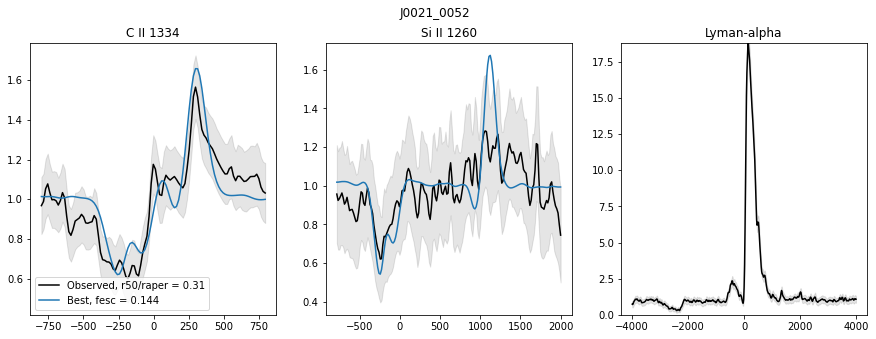

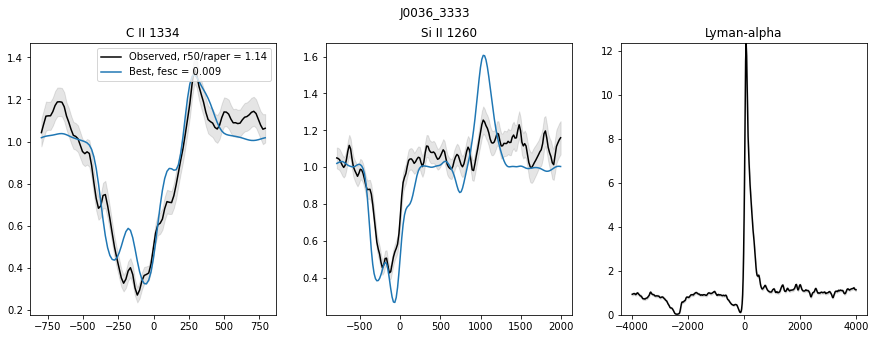

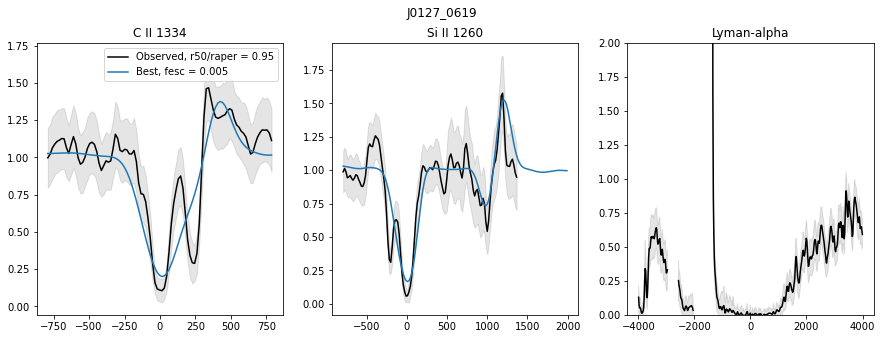

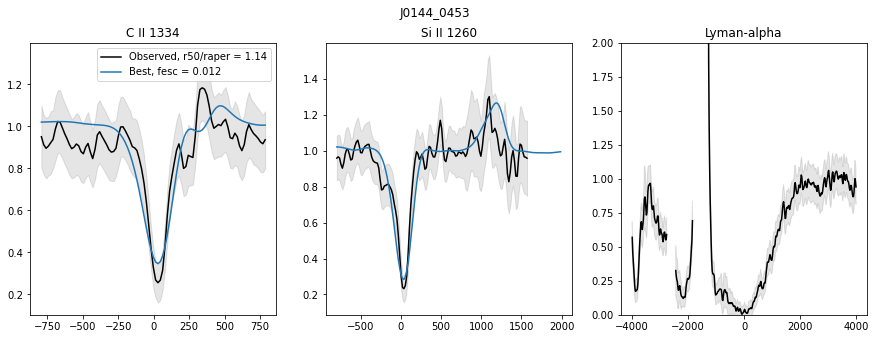

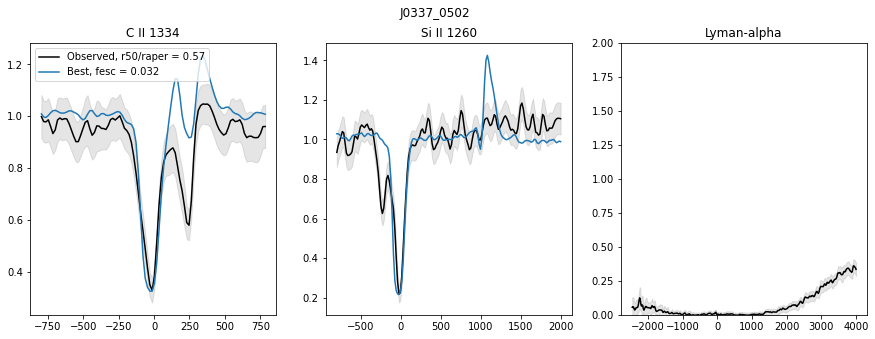

...

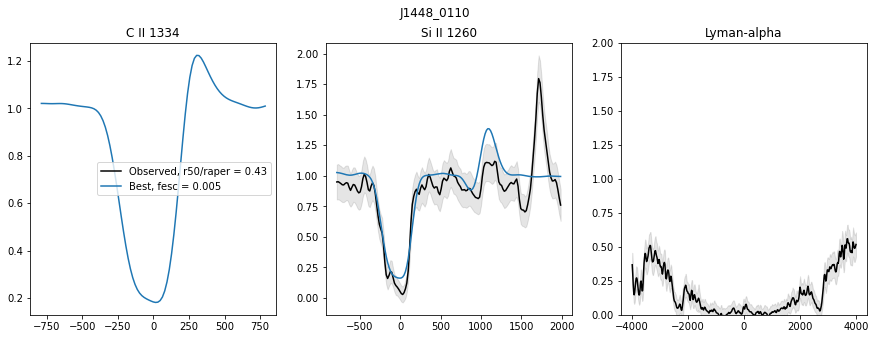

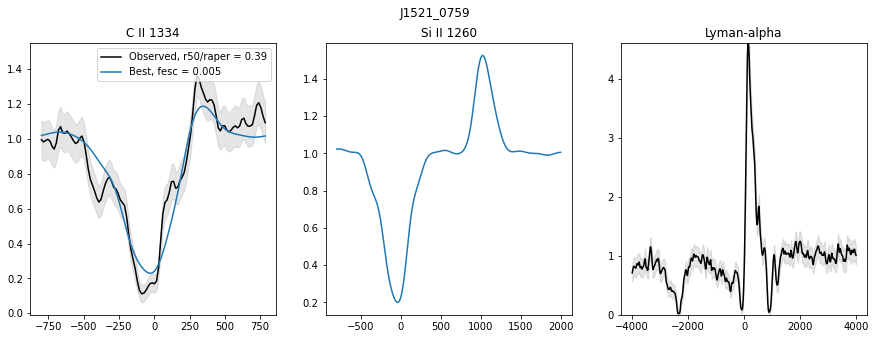

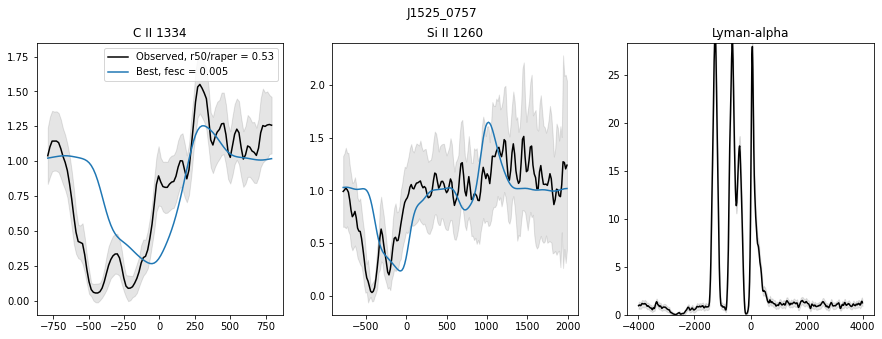

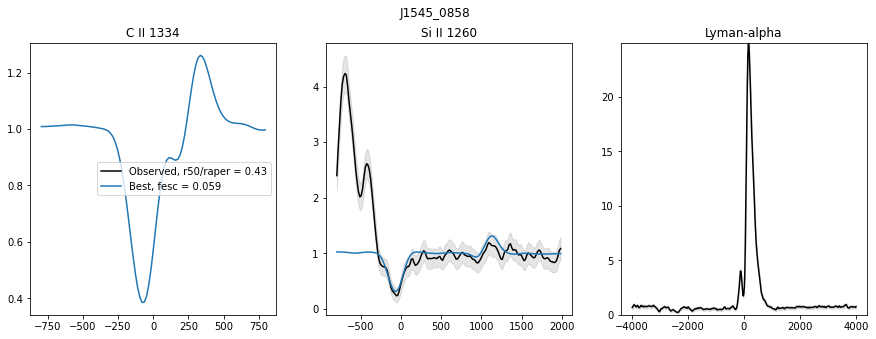

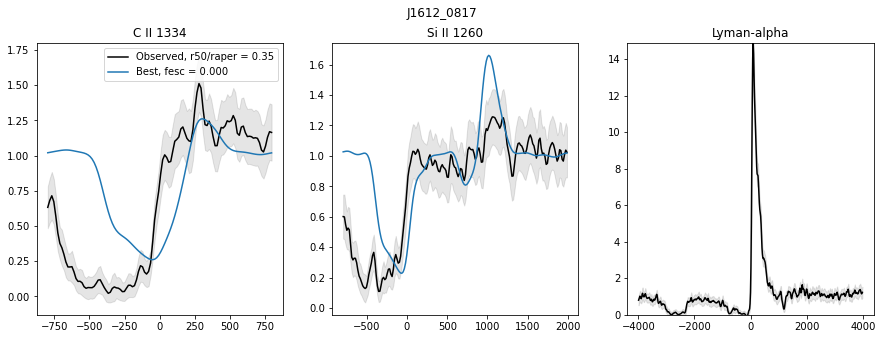

In [249]:
1

from scipy import interpolate
waveCII = 1334.532
waveSiII = 1260.42
waveLya = 1215.67

bestvalcII = np.zeros((45, 10)) + 1e10
bestdircII = np.zeros((45, 10)) - 1
bestoutcII = np.zeros((45, 10)) - 1

bestvalsiII = np.zeros((45, 10)) + 1e10
bestdirsiII = np.zeros((45, 10)) - 1
bestoutsiII = np.zeros((45, 10)) - 1

bestvalall = np.zeros((45, 10)) + 1e10
bestdirall = np.zeros((45, 10)) - 1
bestoutall = np.zeros((45, 10)) - 1

directions = np.zeros((1728,3))
for i in range(1728):
    directions[i,:] = hp.pix2vec(12,i)
    
for i in range(len(galaxy)):
   # i = 4
    spec = '../Classy/%s/hlsp_classy_hst_cos_%s_multi_v1_coadded.fits'%(galaxy[i].replace("_", ""), label[i])
    gal   = fits.open(spec)

    HR    = gal[8].data  # Rest-frame, galactic extinction-corrected, co-added, high-resolution spectrum
    HRB   = gal[10].data # Rest-frame, galactic extinction-corrected, co-added, binned high-resolution spectrum 

    wH, fH, eH, snrH  = HR['WAVE'],  HR['FLUX DENSITY'],  HR['ERROR'],  HR['SNR']
    wHB,fHB,eHB,snrHB = HRB['WAVE'], HRB['FLUX DENSITY'], HRB['ERROR'], HRB['SNR']

    hduin         = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    hdr           = hduin[1].header
    data   = hduin[1].data
    wave=data['wave']
    vcIId = (data['wave']/waveCII -1)*c
    vsiIId =  (data['wave']/waveSiII -1)*c
    vLyad =  (data['wave']/waveLya -1)*c

    flux = data['flux']
    
    fit = gaussian_filter(data['fit'], sigma = 10)
    err = data['err']
    absflux = gaussian_filter(data['flux']/data['fit'],sigma = 1)

    cutCIIall = (vcIId>-800) & (vcIId<800) 
    cutCIIabs = (vcIId>-800) & (vcIId<100)  

    cutSiIIall = (vsiIId>-800) & (vsiIId<2000) 
    cutSiIIabs = (vsiIId>-800) & (vsiIId<100)     
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    if(i == 4):
        absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
    #absflux /= np.median(absflux[cutSiIIall])
    
    fig, axs = plt.subplots(1,3,figsize=(15,5))
    axs[0].plot(vcIId[cutCIIall], absflux[cutCIIall],  c='k', label = 'Observed, r50/raper = %.2f'%(fractAp[i]))
    axs[0].fill_between(vcIId[cutCIIall],absflux[cutCIIall]-err[cutCIIall],absflux[cutCIIall]+err[cutCIIall], 
                        color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
    axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[1].fill_between(vsiIId[cutSiIIall],absflux[cutSiIIall]-err[cutSiIIall],absflux[cutSiIIall]+err[cutSiIIall],
                        color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')

    axs[2].plot(vLyad[cutLyaall], absflux[cutLyaall],  c='k')
    axs[2].fill_between(vLyad[cutLyaall],absflux[cutLyaall]-err[cutLyaall],absflux[cutLyaall]+err[cutLyaall],
                        color = 'k', alpha = 0.1)
    axs[2].set_title('Lyman-alpha')
    axs[2].set_ylim(0, np.max([2,np.nanmax(absflux[abs(vLyad) < 1000])]))
    path_to_data = './data/'   # To change if you move the data

    #line    = 'CII' # either CII, SiII, lyb or cont (CII 1334A, SiII 1260A, LyB and continuum between 910 and 3000A)


#     bestvalcII = 1e10
#     bestdircII = -1
#     bestoutcII = 148
    
#     bestvalsiII = 1e10
#     bestdirsiII = -1
#     bestoutsiII = 148

#     bestvalall = 1e10
#     bestdirall = -1
#     bestoutall = 148

    for output in [148, 156, 164]:
    #output  = 148    # 148, 156 or 164 (A,B and C in Mauerhofer+21). 
    
        # velocity of the center of mass, to correct for the movement of the galaxy in the simulation box:
        v_cm = np.genfromtxt('%s/vcm_%i.dat'%(path_to_data,output)) 
        # l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
        lcII, fluxcII = read_spectrum(output,'CII',path_to_data) 
        lsiII, fluxsiII = read_spectrum(output,'SiII',path_to_data) 
        
        for idir in range(1728):
            lcII_systemic = lcII + np.dot(directions[idir,:],v_cm)/c_cgs*1e5*np.mean(lcII) 
            vcII   = (lcII_systemic/waveCII -1)*c

            lsiII_systemic = lsiII + np.dot(directions[idir,:],v_cm)/c_cgs*1e5*np.mean(lsiII) 
            vsiII   = (lsiII_systemic/waveSiII -1)*c

            sigma_pixelcII = res[i] / ((vcII[50]-vcII[49]))
            sigma_pixelsiII = res[i] / ((vsiII[50]-vsiII[49]))

            modelcII = gaussian_filter(fluxcII[idir,:]/np.median(fluxcII[idir,:]), sigma = sigma_pixelcII)
            f = interpolate.interp1d(vcII, modelcII)
            modelNewcII= f(vcIId[cutCIIall])

            modelsiII = gaussian_filter(fluxsiII[idir,:]/np.median(fluxsiII[idir,:]), sigma = sigma_pixelsiII)
            f = interpolate.interp1d(vsiII, modelsiII)
            modelNewsiII= f(vsiIId[cutSiIIall])


            lnlikecII = 0.5*np.nansum(((absflux[cutCIIall] - modelNewcII)**2)/err[cutCIIall]**2)
            #print(lnlike)
           #print(bestdircII[i])
            for j in range(10):
                
                if(lnlikecII < bestvalcII[i][j]):
                    b = bestdircII[i].copy()
                    b = np.insert(b, j, idir)
                    b = b[:-1]
                    bestdircII[i] = b
                    
                    b = bestvalcII[i].copy()
                    b = np.insert(b, j, lnlikecII)
                    b = b[:-1]
                    bestvalcII[i] = b
                    
                    b = bestoutcII[i].copy()
                    b = np.insert(b,j, output)
                    b = b[:-1]
                    bestoutcII[i] = b
                    break
#                     np.insert(bestvalcII[i],j, lnlikecII)
#                     bestvalcII[i] =bestvalcII[i]#[:-1]
#                     np.insert(bestoutcII[i],j, output)
#                     bestoutcII[i] =  bestoutcII[i]#[:-1]
               # print('New best cII is idir %d with %f'%(idir, lnlikecII))

            lnlikesiII = 0.5*np.nansum(((absflux[cutSiIIall] - modelNewsiII)**2)/err[cutSiIIall]**2)
            for j in range(10):
                if(lnlikesiII < bestvalsiII[i][j]):
#                     bestdirsiII[i][j] = idir
#                     bestvalsiII[i][j] = lnlikesiII
#                     bestoutsiII[i][j] = output
                    b = bestdirsiII[i].copy()
                    b = np.insert(b, j, idir)
                    b = b[:-1]
                    bestdirsiII[i] = b
                    
                    b = bestvalsiII[i].copy()
                    b = np.insert(b, j, lnlikesiII)
                    b = b[:-1]
                    bestvalsiII[i] = b
                    
                    b = bestoutsiII[i].copy()
                    b = np.insert(b,j, output)
                    b = b[:-1]
                    bestoutsiII[i] = b
                    break
               # print('New best si II is idir %d with %f'%(idir, lnlikesiII))

            lnlikeall = 0.5*np.nansum(((absflux[cutCIIall]-modelNewcII)**2)/err[cutCIIall]**2)/len(absflux[cutCIIall])+\
                              0.5*np.nansum(((absflux[cutSiIIall] - modelNewsiII)**2)/err[cutSiIIall]**2)/len(absflux[cutSiIIall])
            #print(lnlikeall)
            for j in range(10):
                #print(lnlikeall,bestvalall[i][j])

                if(lnlikeall < bestvalall[i][j]):
#                     bestdirall[i][j] = idir
#                     bestvalall[i][j] = lnlikeall
#                     bestoutall[i][j] = output
                    b = bestdirall[i].copy()
                    b = np.insert(b, j, idir)
                    b = b[:-1]
                    bestdirall[i] = b
                    
                    b = bestvalall[i].copy()
                    b = np.insert(b, j, lnlikeall)
                    b = b[:-1]
                    bestvalall[i] = b
                    
                    b = bestoutall[i].copy()
                    b = np.insert(b,j, output)
                    b = b[:-1]
                    bestoutall[i] = b
                    break
    
    v_cm = np.genfromtxt('%s/vcm_%i.dat'%(path_to_data,bestoutall[i][0])) 
    # l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
    lcII, fluxcII = read_spectrum(bestoutall[i][0],'CII',path_to_data) 
    lsiII, fluxsiII = read_spectrum(bestoutall[i][0],'SiII',path_to_data) 
    if(bestoutall[i][j] == 148):
        fescarr = fesc_148
    elif (bestoutall[i][j] == 156):
        fescarr= fesc_156
    else:
        fescarr = fesc_164
    
    lcii_systemic = lcII + np.dot(directions[int(bestdirall[i][0]),:],v_cm)/c_cgs*1e5*np.mean(lcII) 
    vcII   = (lcii_systemic/waveCII -1)*c
    sigma_pixelcii = res[i] / ((vcII[50]-vcII[49]))
    model = gaussian_filter(fluxcII[int(bestdirall[i][0]),:]/np.median(fluxcII[int(bestdirall[i][0]),:]), sigma = sigma_pixelcii)
    f = interpolate.interp1d(vcII, model)
    modelNewcii = f(vcIId[cutCIIall])
    axs[0].plot(vcIId[cutCIIall], modelNewcii, label = 'Best, fesc = %.3f'%fescarr[int(bestdirall[i][0])])

    
    lsi_systemic = lsiII + np.dot(directions[int(bestdirall[i][0]),:],v_cm)/c_cgs*1e5*np.mean(lsiII) 
    vsiII   = (lsi_systemic/waveSiII -1)*c
    sigma_pixelsi = res[i] / ((vsiII[50]-vsiII[49]))
    model = gaussian_filter(fluxsiII[int(bestdirall[i][0]),:]/np.median(fluxsiII[int(bestdirall[i][0]),:]), sigma = sigma_pixelsi)
    f = interpolate.interp1d(vsiII, model)
    modelNewsi = f(vsiIId[cutSiIIall])
    axs[1].plot(vsiIId[cutSiIIall], modelNewsi)
    
    axs[0].legend()
    plt.suptitle(galaxy[i])
#     plt.savefig(galaxy[i]+'match.pdf', bbox_inches = 'tight')


In [250]:
df = pd.DataFrame(np.vstack((galaxy,bestoutall[:,0].astype(int), bestdirall[:,0].astype(int)
                             ,bestvalall[:,0])).T) # A is a numpy 2d array
C=['Galaxy','Output','Dir', 'x2']
df.to_csv("Classy_Zoom1_fit.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

(array([ 4.,  1.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  1.,  1.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,  4.,  0.,  1.,
         3.,  0.,  0.,  0.,  2.,  4.,  5.,  1.,  0.,  0.,  0.,  7.,  6.,
         1.,  0.,  1.,  1.,  3.,  0.,  0.,  4.,  0.,  2.,  3.,  0.,  0.,
         2.,  2.,  7.,  8.,  0.,  2.,  0.,  1.,  4., 10.,  1.,  0.,  2.,
         2., 18.,  5.,  1.,  0.,  2.,  4.,  9., 14.,  3.,  0.,  5.,  2.,
        10.,  7.,  3.,  0.,  1.,  0.,  4., 16.,  1.,  0.,  0.,  2.,  6.,
         5.,  0.,  0.,  1.,  1., 11.,  3.,  0.,  1.,  0.,  6.,  6.,  1.,
         0.,  1.,  0.,  3.,  1.,  3.,  1.,  0.,  0.,  0.,  2.,  1.,  3.,
         0.,  0.,  1.,  1.,  0.,  1.,  3.,  0.,  3.,  3.,  0.,  5.,  0.,
         0.,  4.,  0.,  1.,  0.,  0.,  2., 11.,  0.,  1.,  1.,  2.,  6.,
         3.,  1.,  0.,  5.,  0.,  6., 10.,  3.,  0.,  3.,  1.,  5.,  0.,
         0.,  0.,  0.,  8.,  1.,  0.,  0.,  0.,  3.

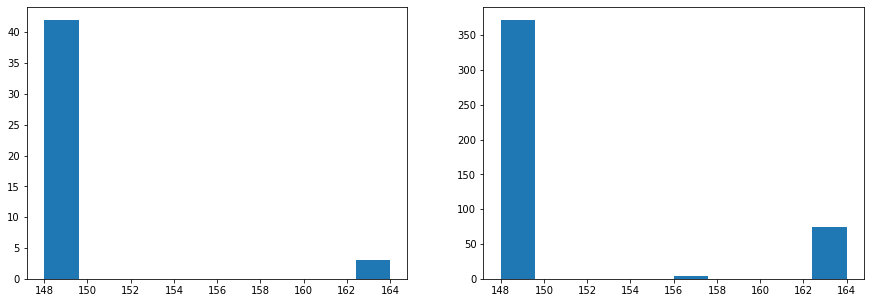

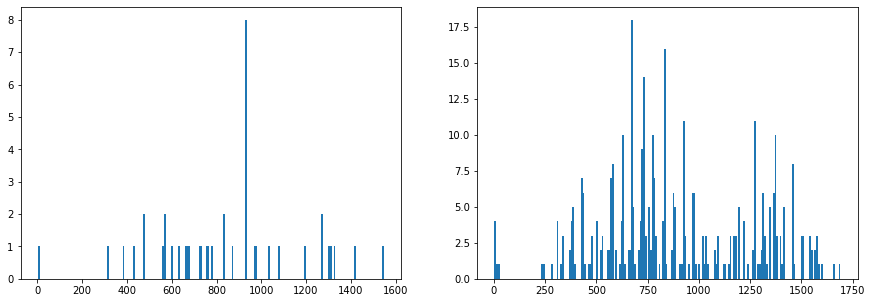

In [61]:
# OUTPUT and DIR

outputBest = bestoutall[:,0]
output10best = bestoutall
fig, axs = plt.subplots(1,2,figsize=(15,5))
axs[0].hist(outputBest)
axs[1].hist(output10best.flatten())

dirbest148 = bestdirall[:,0][bestoutall[:,0] == 148]
dirbest14810best = bestdirall[bestoutall == 148]
fig, axs = plt.subplots(1,2,figsize=(15,5))
axs[0].hist(dirbest148.flatten(), bins = 200)
axs[1].hist(dirbest14810best.flatten(), bins = 200)

<ipython-input-414-4a534bf7a514>:15: RuntimeWarning: Mean of empty slice
  fractEWoff = np.nanmean(np.vstack((df['fEWblueSiII1260'], df['fEWblueSiII1526'])),axis = 0)


[-1.918e+02 -1.283e+02  6.300e+00  2.730e+01 -2.770e+01 -3.650e+01
 -6.131e+02 -1.950e+01 -3.348e+02  1.290e+01  1.880e+01 -4.870e+01
 -4.970e+01  6.000e-01  3.600e+00 -3.800e+00 -7.100e+01 -1.183e+02
 -4.920e+01 -4.380e+01 -1.654e+02 -4.700e+00  1.710e+01 -3.430e+01
  5.300e+00 -1.598e+02 -6.800e+01  1.150e+01 -1.587e+02 -1.314e+02
  2.130e+01 -6.310e+01 -4.680e+01 -1.000e+02 -1.767e+02 -7.250e+01
  1.480e+01 -1.585e+02 -1.662e+02 -6.270e+01 -5.100e+00 -4.810e+01
 -1.000e+02 -7.710e+01 -3.723e+02]
0     D
1     D
2     o
3     o
4     o
5     o
6     D
7     o
8     D
9     o
10    o
11    o
12    o
13    o
14    o
15    o
16    o
17    D
18    o
19    o
20    D
21    o
22    o
23    o
24    o
25    D
26    o
27    o
28    D
29    D
30    o
31    o
32    o
33    D
34    D
35    o
36    o
37    D
38    D
39    o
40    o
41    o
42    D
43    D
44    D
Name: fEWblueSiII1260, dtype: object
[0.98263027 0.91542119 0.5213754  0.39263415 0.65265385 0.717
 1.         0.56553069 1.         0.4

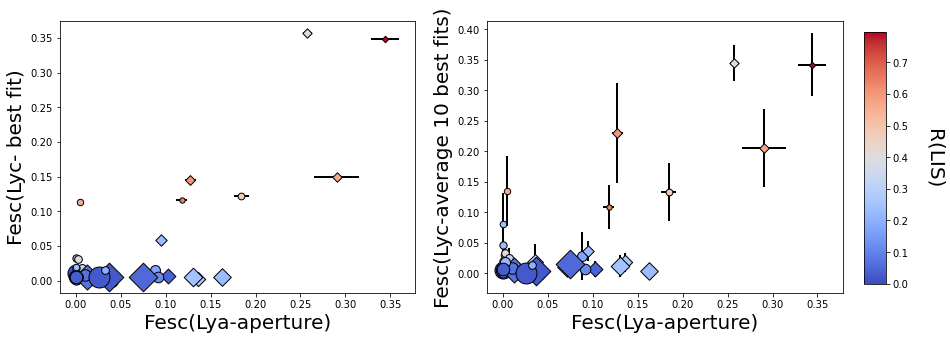

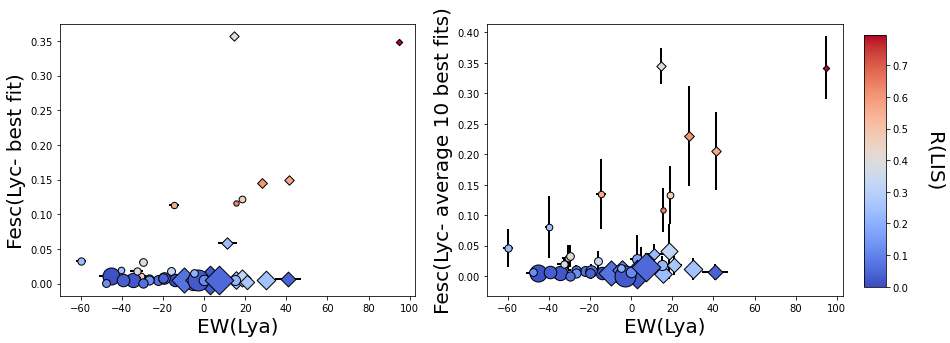

In [414]:
# FESC 
fescGal = np.zeros((45,10))
for i in range(len(galaxy)):
    for j in range(10):
        if(bestoutall[i][j] == 148):
            fescarr = fesc_148
        elif (bestoutall[i][j] == 156):
            fescarr= fesc_156
        else:
            fescarr = fesc_164
        fescGal[i][j] = fescarr[int(bestdirall[i][j])]
#print (np.mean(fescGal, axis = 1))
fescMean = np.mean(fescGal, axis = 1)

fractEWoff = np.nanmean(np.vstack((df['fEWblueSiII1260'], df['fEWblueSiII1526'])),axis = 0)
fractEWoff[np.asarray(galaxy) == 'J1323_0132'] = 1
fractEWoff[np.asarray(galaxy) == 'J1359_5726'] = 0.9
fractv = df['vCombfit'].values
fractv[np.isnan(fractv)] = -100
print(fractv)
marker = df['fEWblueSiII1260'].copy()
# marker[fractEWoff >= 0.8] = 'o'
# marker[fractEWoff <  0.8] = 'D'
marker[fractv >= -75] = 'o'
marker[fractv <  -75] = 'D'
print(marker)
marker[np.asarray(marker) == 'nan'] = '*'
print(fractEWoff,marker.values)
Rarr = np.nanmean(np.vstack((df['RSiII1260'], df['RCII334'])),axis = 0)
vmin, vmax = min(Rarr), max(Rarr)

EWarr= np.nanmean(np.vstack((df['EWSiII1260'], df['EWCII334'])),axis = 0)

s = 20+20*4*((-EWarr)**1.5)


cmap = 'coolwarm'
fig, axs = plt.subplots(1,2,figsize=(15,5))
axs[0].errorbar(df['fescLyaIHA'], fescGal[:,0], xerr = df['ErrfescLya'],
                                lw = 2, linestyle = 'None', c = 'k')
axs[0].set_xlabel('Fesc(Lya-aperture)', fontsize = 20)
axs[0].set_ylabel('Fesc(Lyc- best fit)', fontsize = 20)

axs[1].errorbar(df['fescLyaIHA'], fescMean, xerr = df['ErrfescLya'], yerr = np.std(fescGal, axis = 1),
                lw = 2, linestyle = 'None', c = 'k')
axs[1].set_xlabel('Fesc(Lya-aperture)', fontsize = 20)
axs[1].set_ylabel('Fesc(Lyc-average 10 best fits)', fontsize = 20)

x = df['fescLyaIHA']
y = fescGal[:,0]
for _s, _m, _c, _x, _y in zip(s, marker, Rarr, x, y):
    cp = axs[0].scatter(_x, _y, c = _c, zorder = 5, s= _s, marker = _m, vmin = vmin, vmax = vmax,
                    edgecolors='k', cmap = cmap)


x = df['fescLyaIHA']
y = fescMean
for _s, _m, _c, _x, _y in zip(s, marker, Rarr, x, y):
    cp = axs[1].scatter(_x, _y, c = _c, zorder = 5, s= _s, marker = _m, vmin = vmin, vmax = vmax,
                    edgecolors='k', cmap = cmap)
# cm = np.nanmean(np.vstack((df['RSiII1260'], df['RCII334'])),axis = 0)
# #cm = cm*np.nanmean(np.vstack((df['EWSiII1260'], df['EWCII334'])),axis = 0)
# cm = np.nanmean(np.vstack((df['VminSiII1260'], df['VminCII334'])),axis = 0)
# cm = fractEWoff#np.nanmean(np.vstack((df['fEWblueSiII1260'], df['fEWblueSiII1526'])),axis = 0)
# vmin = np.nanmin(cm)#-300

# # cm = df['VblueLya']

# axs[0].scatter(df['fescLyaIHA'], fescGal[:,0], c = cm, cmap = cmap, edgecolor = 'k', zorder = 5, vmin = vmin)
# cp = axs[1].scatter(df['fescLyaIHA'], fescMean, c = cm, cmap = cmap,edgecolor = 'k', zorder = 5, vmin = vmin)
fig.subplots_adjust(right=0.85)
# put colorbar at desire position
cbar_ax = fig.add_axes([0.87, 0.15, 0.02, 0.7])
cbar = plt.colorbar(cp, cax=cbar_ax)
cbar.set_label(r'R(LIS)', rotation=270, fontsize = 20, labelpad=35)



fig, axs = plt.subplots(1,2,figsize=(15,5))
axs[0].errorbar(df['EWtotLya'], fescGal[:,0], xerr = df['ErrEWtotLya'],
                                lw = 2, linestyle = 'None', c = 'k')
axs[0].set_xlabel('EW(Lya)', fontsize = 20)
axs[0].set_ylabel('Fesc(Lyc- best fit)', fontsize = 20)
axs[1].errorbar(df['EWtotLya'], fescMean, xerr = df['ErrEWtotLya'], yerr = np.std(fescGal, axis = 1),
                lw = 2, linestyle = 'None', c = 'k')
axs[1].set_xlabel('EW(Lya)', fontsize = 20)
axs[1].set_ylabel('Fesc(Lyc- average 10 best fits)', fontsize = 20)
# cm = np.nanmean(np.vstack((df['RSiII1260'], df['RCII334'])),axis = 0)
# #cm = cm*np.nanmean(np.vstack((df['EWSiII1260'], df['EWCII334'])),axis = 0)
# #m = np.nanmean(np.vstack((df['VminSiII1260'], df['VminCII334'])),axis = 0)
# #cm = df['fEWblueSiII1260']
# #cm = np.nanmean(np.vstack((df['fEWblueSiII1260'], df['fEWblueSiII1526'])),axis = 0)
# vmin =  np.nanmin(cm)#-300

#cm = df['VblueLya']
x = df['EWtotLya']
y = fescGal[:,0]
for _s, _m, _c, _x, _y in zip(s, marker, Rarr, x, y):
    cp = axs[0].scatter(_x, _y, c = _c, zorder = 5, s= _s, marker = _m, vmin = vmin, vmax = vmax,
                    edgecolors='k', cmap = cmap)
  
x = df['EWtotLya']
y = fescMean
for _s, _m, _c, _x, _y in zip(s, marker, Rarr, x, y):
    cp = axs[1].scatter(_x, _y, c = _c, zorder = 5, s= _s, marker = _m, vmin = vmin, vmax = vmax,
                    edgecolors='k', cmap = cmap)
#axs[0].scatter(df['EWtotLya'], fescGal[:,0], c = cm, cmap = cmap, edgecolor = 'k', zorder = 5, vmin = vmin)
# cp = axs[1].scatter(df['EWtotLya'], fescMean, c = cm, cmap = cmap,edgecolor = 'k', zorder = 5, vmin = vmin)

fig.subplots_adjust(right=0.85)
# put colorbar at desire position
cbar_ax = fig.add_axes([0.87, 0.15, 0.02, 0.7])
cbar = plt.colorbar(cp, cax=cbar_ax)
cbar.set_label(r'R(LIS)', rotation=270, fontsize = 20, labelpad=35)


<ipython-input-155-4c1e828685e1>:35: RuntimeWarning: Mean of empty slice
  cm = np.nanmean(np.vstack((df['fEWblueSiII1260'], df['fEWblueSiII1526'])),axis = 0)
<ipython-input-155-4c1e828685e1>:62: RuntimeWarning: Mean of empty slice
  cm = np.nanmean(np.vstack((df['fEWblueSiII1260'], df['fEWblueSiII1526'])),axis = 0)


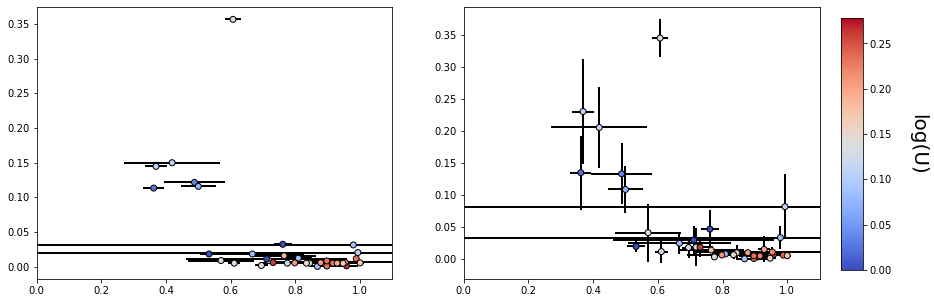

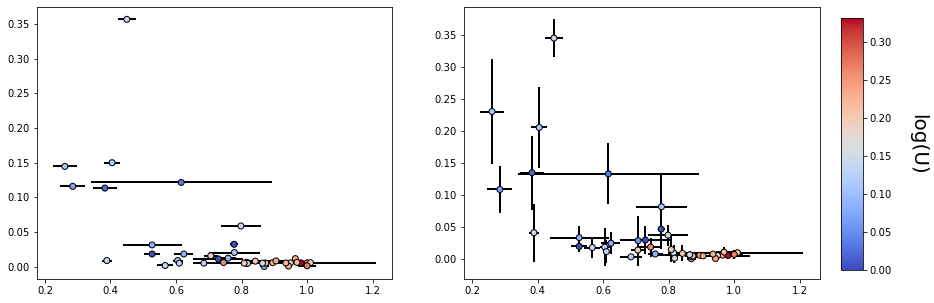

In [155]:
# FESC 
fescGal = np.zeros((45,10))
for i in range(len(galaxy)):
    for j in range(10):
        if(bestoutall[i][j] == 148):
            fescarr = fesc_148
        elif (bestoutall[i][j] == 156):
            fescarr= fesc_156
        else:
            fescarr = fesc_164
        fescGal[i][j] = fescarr[int(bestdirall[i][j])]
#print (np.mean(fescGal, axis = 1))
fescMean = np.mean(fescGal, axis = 1)



cmap = 'coolwarm'
fig, axs = plt.subplots(1,2,figsize=(15,5))
marker = df['vCombfit'].copy()
marker[marker >= -50] = 'o'
# for _s, _c, _x, _y in zip(marker, ccm, x, y):
#     cp = ax.scatter(_x, _y, c = _c, zorder = 5, s= 70, marker = _s, vmin = vmin, vmax = vmax,
#                     edgecolors='k', cmap = cmap)

axs[0].errorbar(df['cfCIICombfit'], fescGal[:,0], xerr = df['ErrcfCIICombfit'],
                                lw = 2, linestyle = 'None', c = 'k')
axs[0].set_xlim(0,1.1)
axs[1].errorbar(df['cfCIICombfit'], fescMean, xerr = df['ErrcfCIICombfit'], yerr = np.std(fescGal, axis = 1),
                lw = 2, linestyle = 'None', c = 'k')
axs[1].set_xlim(0,1.1)

cm = np.nanmean(np.vstack((df['RSiII1260'], df['RCII334'])),axis = 0)
#cm = cm*np.nanmean(np.vstack((df['EWSiII1260'], df['EWCII334'])),axis = 0)
cm = np.nanmean(np.vstack((df['VminSiII1260'], df['VminCII334'])),axis = 0)
cm = np.nanmean(np.vstack((df['fEWblueSiII1260'], df['fEWblueSiII1526'])),axis = 0)
cm = df['EbvNew']
vmin = np.min(cm)#-300

#cm = df['VblueLya']

axs[0].scatter(df['cfCIICombfit'], fescGal[:,0], c = cm, cmap = cmap, edgecolor = 'k', zorder = 5, vmin = vmin)
cp = axs[1].scatter(df['cfCIICombfit'], fescMean, c = cm, cmap = cmap,edgecolor = 'k', zorder = 5, vmin = vmin)
fig.subplots_adjust(right=0.85)
# put colorbar at desire position
cbar_ax = fig.add_axes([0.87, 0.15, 0.02, 0.7])
cbar = plt.colorbar(cp, cax=cbar_ax)
cbar.set_label(r'log(U)', rotation=270, fontsize = 20, labelpad=35)



fig, axs = plt.subplots(1,2,figsize=(15,5))
axs[0].errorbar(df['cfSiIICombfit'], fescGal[:,0], xerr = df['ErrcfSiIICombfit'],
                                lw = 2, linestyle = 'None', c = 'k')

axs[1].errorbar(df['cfSiIICombfit'], fescMean, xerr = df['ErrcfSiIICombfit'], yerr = np.std(fescGal, axis = 1),
                lw = 2, linestyle = 'None', c = 'k')

cm = np.nanmean(np.vstack((df['RSiII1260'], df['RCII334'])),axis = 0)
#cm = cm*np.nanmean(np.vstack((df['EWSiII1260'], df['EWCII334'])),axis = 0)
cm = np.nanmean(np.vstack((df['VminSiII1260'], df['VminCII334'])),axis = 0)
cm = df['fEWblueSiII1260']
cm = np.nanmean(np.vstack((df['fEWblueSiII1260'], df['fEWblueSiII1526'])),axis = 0)
cm = df['EbvNew']

#print(cm, np.asarray(galaxy)[np.isnan(cm)])
vmin =  np.nanmin(cm)#-300

#cm = df['VblueLya']
axs[0].scatter(df['cfSiIICombfit'], fescGal[:,0], c = cm, cmap = cmap, edgecolor = 'k', zorder = 5, vmin = vmin)
cp = axs[1].scatter(df['cfSiIICombfit'], fescMean, c = cm, cmap = cmap,edgecolor = 'k', zorder = 5, vmin = vmin)

fig.subplots_adjust(right=0.85)
# put colorbar at desire position
cbar_ax = fig.add_axes([0.87, 0.15, 0.02, 0.7])
cbar = plt.colorbar(cp, cax=cbar_ax)
cbar.set_label(r'log(U)', rotation=270, fontsize = 20, labelpad=35)


[148. 148. 148. 148. 148. 148. 148. 148. 148. 148.] [ 930.  739.  835.  786.  882.  833.  787.  728. 1498. 1029.] [199.99145388 209.61951261 216.10944283 227.56252067 229.77273186
 238.08977118 298.94872907 335.95731497 350.61198001 353.4429877 ]
J0036_3333 148.0 833.0 6.251264875391437 0.14448
J0036_3333 148.0 739.0 6.343969069200538 0.15489
J0036_3333 148.0 835.0 6.417439352209426 0.17033
J0036_3333 148.0 882.0 6.775760724312336 0.26569
J0036_3333 148.0 836.0 7.282078275827319 0.3678
J0036_3333 148.0 788.0 7.375058812126979 0.11516
J0036_3333 148.0 1175.0 7.376528243904645 0.19216
J0036_3333 148.0 787.0 7.419284106406254 0.29811
J0036_3333 164.0 1462.0 7.719269445076378 0.33748
J0036_3333 148.0 933.0 7.857022865828409 0.25423


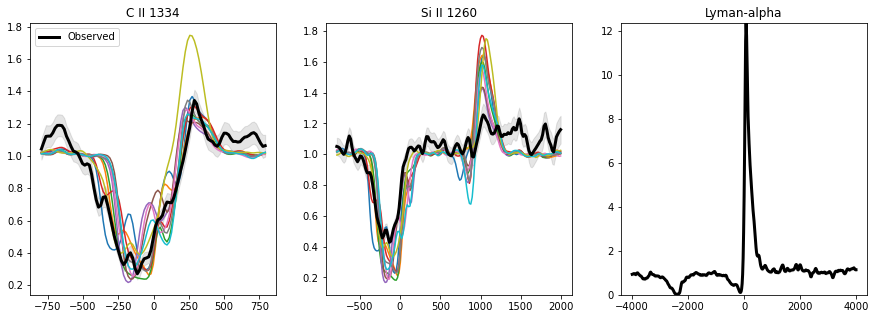

In [47]:
i = 1
gala = galaxy[i]
hduin         = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
hdr           = hduin[1].header
data          = hduin[1].data
wave    =data['wave']
vcIId = (data['wave']/waveCII -1)*c
vsiIId =  (data['wave']/waveSiII -1)*c
vLyad =  (data['wave']/waveLya -1)*c

flux = data['flux']

fit = gaussian_filter(data['fit'], sigma = 10)
err = data['err']
absflux = gaussian_filter(data['flux']/data['fit'],sigma = 1)

cutCIIall = (vcIId>-800) & (vcIId<800) 
cutCIIabs = (vcIId>-800) & (vcIId<100)  

cutSiIIall = (vsiIId>-800) & (vsiIId<2000) 
cutSiIIabs = (vsiIId>-800) & (vsiIId<100)     
cutLyaall = (vLyad>-4000) & (vLyad<4000) 

fig, axs = plt.subplots(1,3,figsize=(15,5))
axs[0].plot(vcIId[cutCIIall], absflux[cutCIIall],  c='k', label = 'Observed', zorder = 5, lw = 3)
axs[0].fill_between(vcIId[cutCIIall],absflux[cutCIIall]-err[cutCIIall],absflux[cutCIIall]+err[cutCIIall], 
                    color= 'k', alpha = 0.1)
axs[0].set_title('C II 1334')
axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' , zorder = 5, lw = 3)
axs[1].fill_between(vsiIId[cutSiIIall],absflux[cutSiIIall]-err[cutSiIIall],absflux[cutSiIIall]+err[cutSiIIall],
                    color = 'k', alpha = 0.1)
axs[1].set_title('Si II 1260')

axs[2].plot(vLyad[cutLyaall], absflux[cutLyaall],  c='k', label = 'Observed', zorder = 5, lw = 3)
axs[2].fill_between(vLyad[cutLyaall],absflux[cutLyaall]-err[cutLyaall],absflux[cutLyaall]+err[cutLyaall],
                    color = 'k', alpha = 0.1)
axs[2].set_title('Lyman-alpha')
axs[2].set_ylim(0, np.max([2,np.nanmax(absflux[abs(vLyad) < 1000])]))

print(bestoutcII[i], bestdircII[i],bestvalcII[i])
for j in range(10):
    v_cm = np.genfromtxt('%s/vcm_%i.dat'%(path_to_data,bestoutall[i][j])) 
    # l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
    lcII, fluxcII = read_spectrum(bestoutall[i][j],'CII',path_to_data) 
    lsiII, fluxsiII = read_spectrum(bestoutall[i][j],'SiII',path_to_data) 
    
    print(galaxy[i], bestoutall[i][j], bestdirall[i][j], bestvalall[i][j], fesc_148[int(bestdirall[0][j])])
    
    lcii_systemic = lcII + np.dot(directions[int(bestdirall[i][j]),:],v_cm)/c_cgs*1e5*np.mean(lcII) 
    vcII   = (lcii_systemic/waveCII -1)*c
    sigma_pixelcii = res[i] / ((vcII[50]-vcII[49]))
    model = gaussian_filter(fluxcII[int(bestdirall[i][j]),:]/np.median(fluxcII[int(bestdirall[i][j]),:]), sigma = sigma_pixelcii)
    f = interpolate.interp1d(vcII, model)
    modelNewcii = f(vcIId[cutCIIall])
    axs[0].plot(vcIId[cutCIIall], modelNewcii)

    
    lsi_systemic = lsiII + np.dot(directions[int(bestdirall[i][j]),:],v_cm)/c_cgs*1e5*np.mean(lsiII) 
    vsiII   = (lsi_systemic/waveSiII -1)*c
    sigma_pixelsi = res[i] / ((vsiII[50]-vsiII[49]))
    model = gaussian_filter(fluxsiII[int(bestdirall[i][j]),:]/np.median(fluxsiII[int(bestdirall[i][j]),:]), sigma = sigma_pixelsi)
    f = interpolate.interp1d(vsiII, model)
    modelNewsi = f(vsiIId[cutSiIIall])
    axs[1].plot(vsiIId[cutSiIIall], modelNewsi)
    
#     if()
    axs[0].legend()

## 75 time steps, no FS

In [ ]:
nGal = len(galaxy)
nmocks         = 5
Chi2all        = np.zeros((45, nmocks)) + 1e10
Chi2allabs     = np.zeros((45, nmocks)) + 1e10
Chi2allemi     = np.zeros((45, nmocks)) + 1e10
Chi2siII       = np.zeros((45, nmocks)) + 1e10
Chi2siIIabs    = np.zeros((45, nmocks)) + 1e10
Chi2siIIemi    = np.zeros((45, nmocks)) + 1e10
Chi2cII        = np.zeros((45, nmocks)) + 1e10
Chi2cIIabs     = np.zeros((45, nmocks)) + 1e10
Chi2cIIemi     = np.zeros((45, nmocks)) + 1e10

dirall         = np.zeros((45, nmocks)) - 1
dirallabs      = np.zeros((45, nmocks)) - 1
dirallemi      = np.zeros((45, nmocks)) - 1
dirsiII        = np.zeros((45, nmocks)) - 1
dirsiIIabs     = np.zeros((45, nmocks)) - 1
dirsiIIemi     = np.zeros((45, nmocks)) - 1
dircII         = np.zeros((45, nmocks)) - 1
dircIIabs      = np.zeros((45, nmocks)) - 1
dircIIemi      = np.zeros((45, nmocks)) - 1

outall         = np.zeros((45, nmocks)) - 1
outallabs      = np.zeros((45, nmocks)) - 1
outallemi      = np.zeros((45, nmocks)) - 1
outsiII        = np.zeros((45, nmocks)) - 1
outsiIIabs     = np.zeros((45, nmocks)) - 1
outsiIIemi     = np.zeros((45, nmocks)) - 1
outcII         = np.zeros((45, nmocks)) - 1
outcIIabs      = np.zeros((45, nmocks)) - 1
outcIIemi      = np.zeros((45, nmocks)) - 1
for i in range(nGal):
    
    print(label[i])
    if(label[i].upper() in maskInc):
        print("NOT INCLUDED")
    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    #fit = gaussian_filter(data['fit'], sigma = 10)
    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

#    absflux = gaussian_filter(data['flux']/data['fit'],sigma = 1)
#     if(i == 4):
#         absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
    #absflux /= np.median(absflux[cutSiIIall])
    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    maskLya  = mask[cutLyaall]
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 700)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
    
    fig, axs = plt.subplots(1,3,figsize=(18,5))
    #/np.nanmedian(flux[cutCIIall])
    axs[0].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[0].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[0].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
   
    
    axs[1].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[1].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  
#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[1].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')

    axs[2].plot(vLyad[cutLyaall], flux[cutLyaall],  c='k',alpha = 0.7,drawstyle='steps-mid' )
    axs[2].fill_between(vLyad[cutLyaall],flux[cutLyaall]-err[cutLyaall],flux[cutLyaall]+err[cutLyaall],
                        color = 'k', alpha = 0.1)
#     if(len(flux[cutLyaall][~maskLya])>0):
#         axs[2].fill_between(vLyad[cutLyaall][~maskLya], np.nanmin(flux[cutLyaall][~maskLya]), 
#                         np.nanmax(flux[cutLyaall][~maskLya]), alpha=0.2, color= 'r')  
    axs[2].set_title('Lyman-alpha')
    axs[2].set_ylim(0, np.max([2,np.nanmax(flux[abs(vLyad) < 1000])]))
  

    path_to_data = './CII_SiII/'   # To change if you move the data

    v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

    bestfluxsiall = []
    bestfluxciiall = []
    bestfluxsiabs = []
    bestfluxciiabs = []
    bestfluxsiemi = []
    bestfluxciiemi = []
    for output in range(90,165,1):
    
        lcII,  fluxcII  = read_spectrum_c(path_to_data,output) 
        lsiII, fluxsiII = read_spectrum_si(path_to_data,output) 
        
        for idir in range(300):
            lcII_systemic = lcII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lcII) 
            lcII_systemic = lcII_systemic[1:]
            vcII_s    = (lcII_systemic/wcII1334 -1)*c

            lsiII_systemic = lsiII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lsiII) 
            lsiII_systemic = lsiII_systemic[1:]
            vsiII_s  = (lsiII_systemic/wsiII1260 -1)*c

            sigma_pixelcII  = res[i] /2.355/ ((vcII_s[50] - vcII_s[49]))
            sigma_pixelsiII = res[i] /2.355/ ((vsiII_s[50]- vsiII_s[49]))

            modelcII    = gaussian_filter(fluxcII[idir,1:], sigma = sigma_pixelcII)
            f           = interpolate.interp1d(vcII_s, modelcII)
            modelNewcII = f(vcII)

            modelsiII   = gaussian_filter(fluxsiII[idir,1:], sigma = sigma_pixelsiII)
            f           = interpolate.interp1d(vsiII_s, modelsiII)
            modelNewsiII= f(vsiII)

#             alpha = np.nansum((modelNewcII[maskCII]*fcII[maskCII]/(ecII[maskCII]**2)))/ \
#                     np.nansum(modelNewcII[maskCII]**2/ecII[maskCII]**2)
#             modelNewcII *= alpha
            
#             alpha = np.nansum((modelNewsiII[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsiII[maskSiII]**2/esiII[maskSiII]**2)
# #             print(alpha)
#             modelNewsiII *= alpha
            
            rmedCII = ((vcII<-500) | (vcII > 700)) 
            fmedCII = np.nanmedian(modelNewcII[rmedCII])
            modelNewcII /= fmedCII

            rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
            fmedSiII = np.nanmedian(modelNewsiII[rmedSiII])
            modelNewsiII /= fmedSiII
    
            lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcII[maskCII])**2)/ecII[maskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsiII[maskSiII])**2)/esiII[maskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cII[i][0] :
                Chi2cII[i][0] = lnlikecII
                dircII[i][0]  = idir
                outcII[i][0]  = output
            
            if lnlikesiII < Chi2siII[i][0] :
                Chi2siII[i][0] = lnlikesiII
                dirsiII[i][0]  = idir
                outsiII[i][0]  = output
                
            if(lnlikeall < Chi2all[i][0]):
                dirall[i][0] = idir
                Chi2all[i][0] = lnlikeall
                outall[i][0] = output
                bestfluxsiall = modelNewsiII
                bestfluxciiall = modelNewcII
                
            absMaskCII = (vcII > -600) & (vcII < 200) & maskCII
            absMaskSiII =  (vsiII > -600) & (vsiII < 200) & maskSiII
            lnlikecII  =  0.5*np.nansum(((fcII[absMaskCII]-modelNewcII[absMaskCII])**2)/ecII[absMaskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[absMaskSiII] - modelNewsiII[absMaskSiII])**2)/esiII[absMaskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cIIabs[i][0] :
                Chi2cIIabs[i][0] = lnlikecII
                dircIIabs[i][0]  = idir
                outcIIabs[i][0]  = output
            
            if lnlikesiII < Chi2siIIabs[i][0] :
                Chi2siIIabs[i][0] = lnlikesiII
                dirsiIIabs[i][0]  = idir
                outsiIIabs[i][0]  = output
                
            if(lnlikeall < Chi2allabs[i][0]):
                dirallabs[i][0] = idir
                Chi2allabs[i][0] = lnlikeall
                outallabs[i][0] = output
                bestfluxsiabs = modelNewsiII
                bestfluxciiabs = modelNewcII
                
            emiMaskCII = (vcII > 150 ) & maskCII & (vcII <700)
            emiMaskSiII = (vsiII > 700) & maskSiII & (vsiII <1500)
            lnlikecII  =  0.5*np.nansum(((fcII[emiMaskCII]-modelNewcII[emiMaskCII])**2)/ecII[emiMaskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[emiMaskSiII] - modelNewsiII[emiMaskSiII])**2)/esiII[emiMaskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cIIemi[i][0] :
                Chi2cIIemi[i][0] = lnlikecII
                dircIIemi[i][0]  = idir
                outcIIemi[i][0]  = output
            
            if lnlikesiII < Chi2siIIemi[i][0] :
                Chi2siIIemi[i][0] = lnlikesiII
                dirsiIIemi[i][0]  = idir
                outsiIIemi[i][0]  = output
                
            if(lnlikeall < Chi2allemi[i][0]):
#                 print(lnlikeall,lnlikecII,lnlikesiII)
                dirallemi[i][0] = idir
                Chi2allemi[i][0] = lnlikeall
                outallemi[i][0] = output
                bestfluxsiemi = modelNewsiII
                bestfluxciiemi = modelNewcII
            #print(lnlikeall)
#             for j in range(nmocks):
#                 if(lnlikeall < Chi2all[i][j]):
#                     b = dirall[i].copy()
#                     b = np.insert(b, j, idir)
#                     b = b[:-1]
#                     dirall[i] = b
                    
#                     b = Chi2all[i].copy()
#                     b = np.insert(b, j, lnlikeall)
#                     b = b[:-1]
#                     Chi2all[i] = b
                    
#                     b = outall[i].copy()
#                     b = np.insert(b,j, output)
#                     b = b[:-1]
#                     outall[i] = b
#                     break
    
    print(Chi2all[i][0])

#     # l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
#     lcII, fluxcII   = read_spectrum_c(path_to_data,int(outall[i][0]) )
#     lsiII, fluxsiII = read_spectrum_si(path_to_data,int(outall[i][0]) )
    
#     lcII_systemic  = lcII + np.dot(directions[int(dirall[i][0]),:],v_cm[:,int(outall[i][0])-90])/c_cgs*1e5*np.mean(lcII) 
#     lcII_systemic  = lcII_systemic[1:]
#     vcII_s         = (lcII_systemic/wcII1334 -1)*c
#     sigma_pixelcii = res[i] /2.355 / ((vcII_s[50]-vcII_s[49]))
#     model          = gaussian_filter(fluxcII[int(dirall[i][0]),1:], sigma = sigma_pixelcii)
#     f              =  interpolate.interp1d(vcII_s, model)
#     modelNewcii    = f(vcII)
#     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
#                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
# #     modelNewcii    *= alpha
#     rmedCII = ((vcII<-500) | (vcII > 700)) 
#     fmedCII = np.nanmedian(modelNewcii[rmedCII])
#     modelNewcii /= fmedCII
    axs[0].plot(vcII, bestfluxciiall,
                label = 'Mock (noFS) - TS %d - Dir %d'%(outall[i][0], dirall[i][0]), c =cnoFS, lw = 3)
    axs[0].plot(vcII, bestfluxciiabs, 
                label = 'Mock abs (noFS) - TS %d - Dir %d'%(outallabs[i][0], dirallabs[i][0]), c =cFS, lw = 3)
    axs[0].plot(vcII, bestfluxciiemi, 
                label = 'Mock emi (noFS) - TS %d - Dir %d'%(outallemi[i][0], dirallemi[i][0]), c ='c', lw = 3)

    
#     lsiII_systemic = lsiII + np.dot(directions[int(dirall[i][0]),:],v_cm[:,int(outall[i][0])-90])/c_cgs*1e5*np.mean(lsiII) 
#     lsiII_systemic = lsiII_systemic[1:]
#     vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
#     sigma_pixelsi  = res[i] /2.355/ ((vsiII_s[50]-vsiII_s[49]))
#     model          = gaussian_filter(fluxsiII[int(dirall[i][0]),1:], sigma = sigma_pixelsi)
#     f              = interpolate.interp1d(vsiII_s, model)
#     modelNewsi     = f(vsiII)
# #     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
# #                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
# #     modelNewsi   *= alpha
#     rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
#     fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
#     modelNewsi /= fmedSiII
    axs[1].plot(vsiII, bestfluxsiall, c =cnoFS, lw = 3)
    axs[1].plot(vsiII, bestfluxsiabs, c =cFS, lw = 3)
    axs[1].plot(vsiII, bestfluxsiemi, c ='c', lw = 3)

#     lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
#     lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
#     lnlikeall  = lnlikecII + lnlikesiII
#     print('FS: ',lnlikecII, lnlikesiII, lnlikeall )
    axs[0].legend(frameon=False)
    plt.suptitle(label[i])
    plt.show()
#     plt.savefig('Plots/'+galaxy[i]+'matchnoFS.pdf', bbox_inches = 'tight')


In [150]:
df = pd.DataFrame(np.vstack((galaxy, 
                             outall[:,0].astype(int), dirall[:,0].astype(int), Chi2all[:,0],
                             outsiII[:,0].astype(int), dirsiII[:,0].astype(int), Chi2siII[:,0],
                             outcII[:,0].astype(int), dircII[:,0].astype(int), Chi2cII[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("Classy_noFS_fit.csv", sep=',', header= C, index=False) 


df = pd.DataFrame(np.vstack((galaxy, 
                             outallabs[:,0].astype(int), dirallabs[:,0].astype(int), Chi2allabs[:,0],
                             outsiIIabs[:,0].astype(int), dirsiIIabs[:,0].astype(int), Chi2siIIabs[:,0],
                             outcIIabs[:,0].astype(int), dircIIabs[:,0].astype(int), Chi2cIIabs[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("Classy_noFS_absfit.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

df = pd.DataFrame(np.vstack((galaxy, 
                             outallemi[:,0].astype(int), dirallemi[:,0].astype(int), Chi2allemi[:,0],
                             outsiIIemi[:,0].astype(int), dirsiIIemi[:,0].astype(int), Chi2siIIemi[:,0],
                             outcIIemi[:,0].astype(int), dircIIemi[:,0].astype(int), Chi2cIIemi[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("Classy_noFS_emifit.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

## 75 time steps, FS

j0021+0052


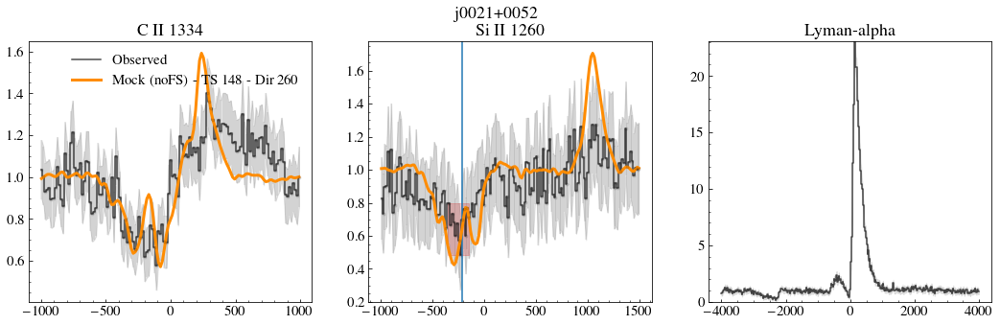

j0036-3333


<Figure size 432x288 with 0 Axes>

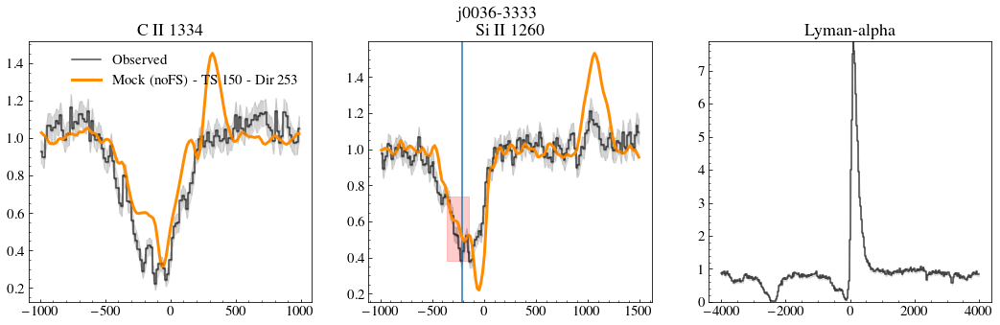

j0127-0619


<Figure size 432x288 with 0 Axes>

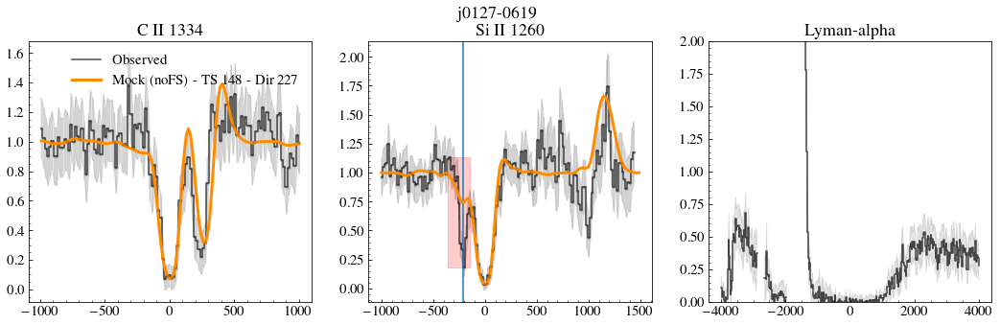

j0144+0453


<Figure size 432x288 with 0 Axes>

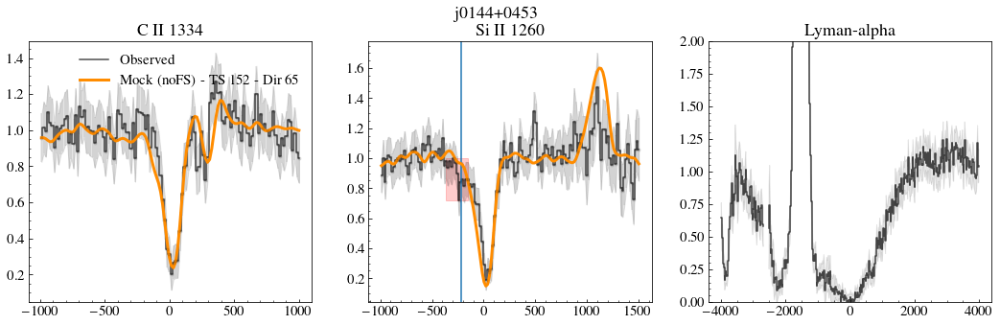

j0337-0502


<Figure size 432x288 with 0 Axes>

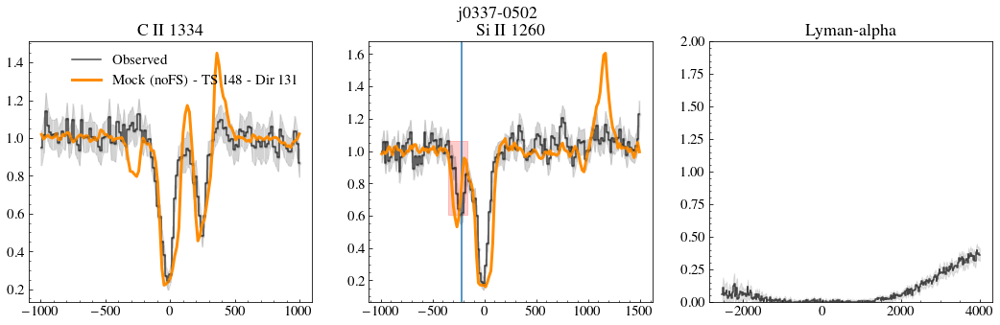

j0405-3648


<Figure size 432x288 with 0 Axes>

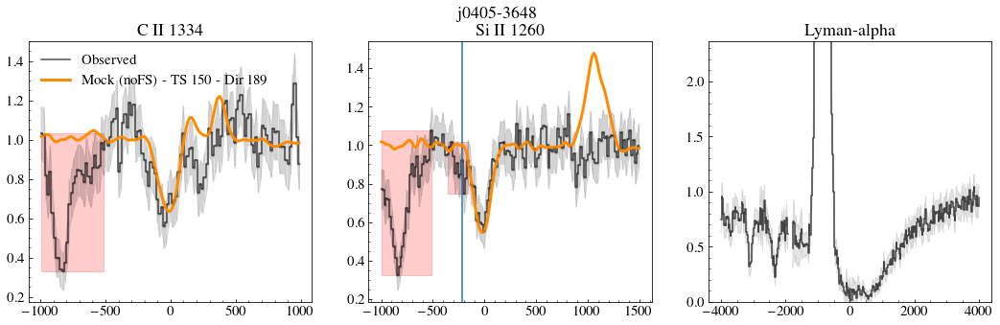

j0808+3948


<Figure size 432x288 with 0 Axes>

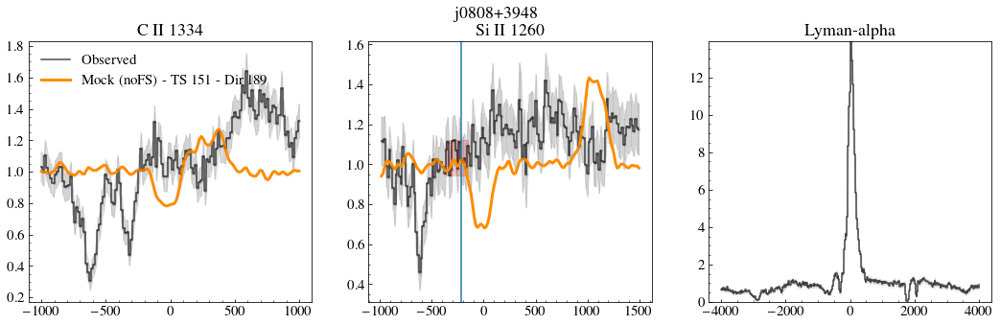

j0823+2806


<Figure size 432x288 with 0 Axes>

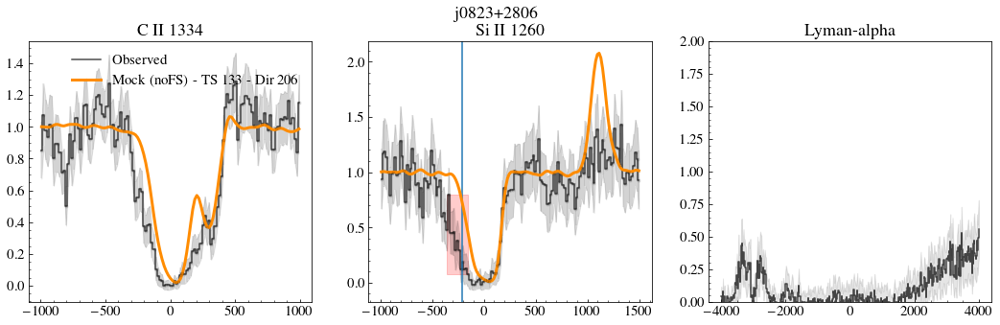

j0926+4427


<Figure size 432x288 with 0 Axes>

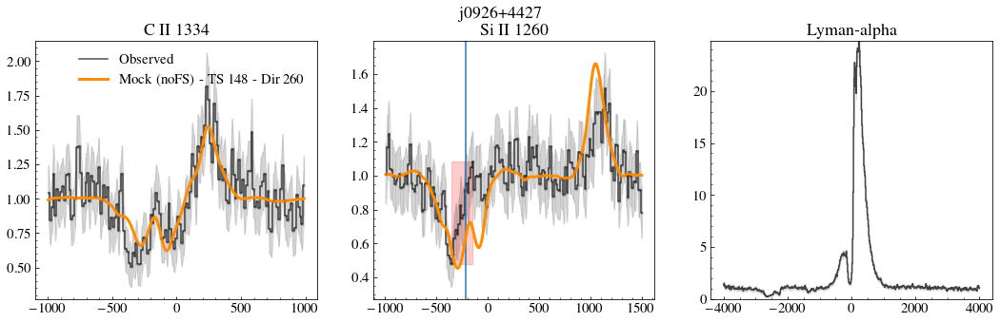

j0934+5514


<Figure size 432x288 with 0 Axes>

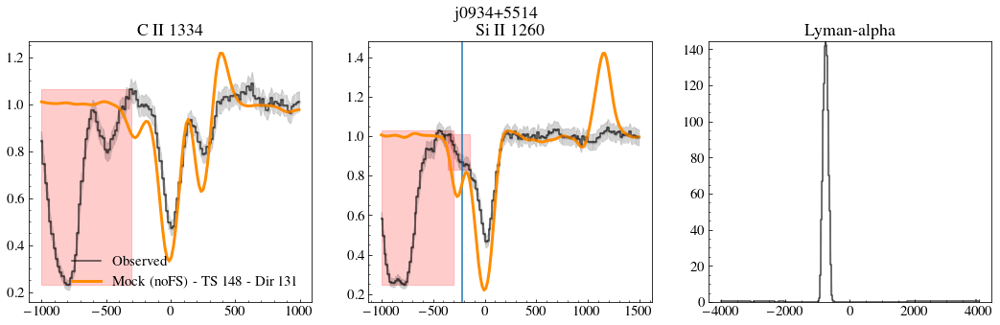

j0938+5428


<Figure size 432x288 with 0 Axes>

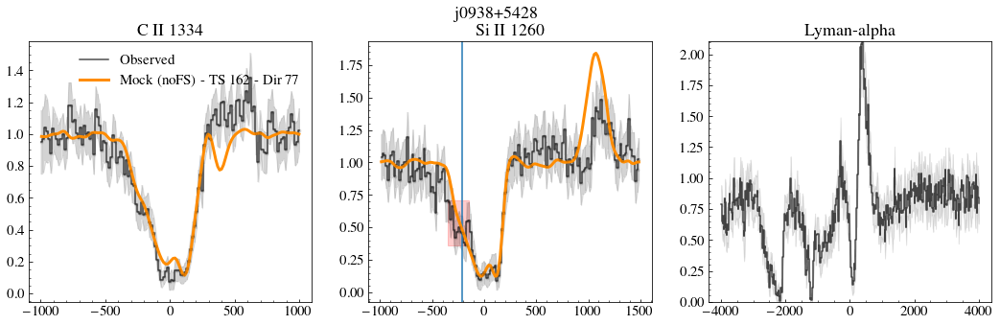

j0940+2935


<Figure size 432x288 with 0 Axes>

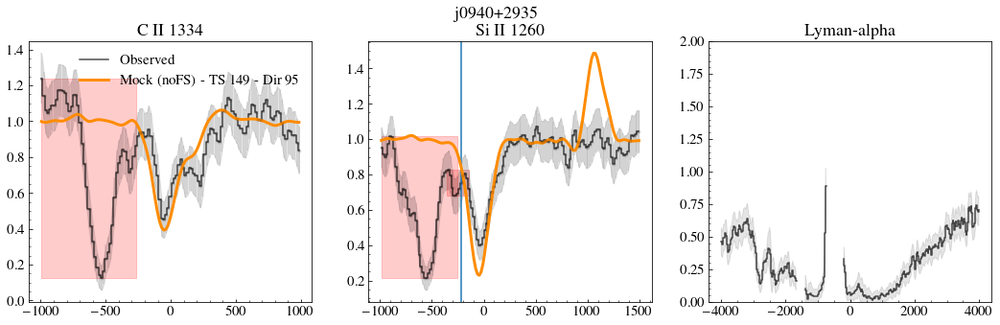

j0942+3547


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_9759/4217718321.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_9759/4217718321.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')
/tmp/ipykernel_9759/4217718321.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_9759/4217718321.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


<Figure size 432x288 with 0 Axes>

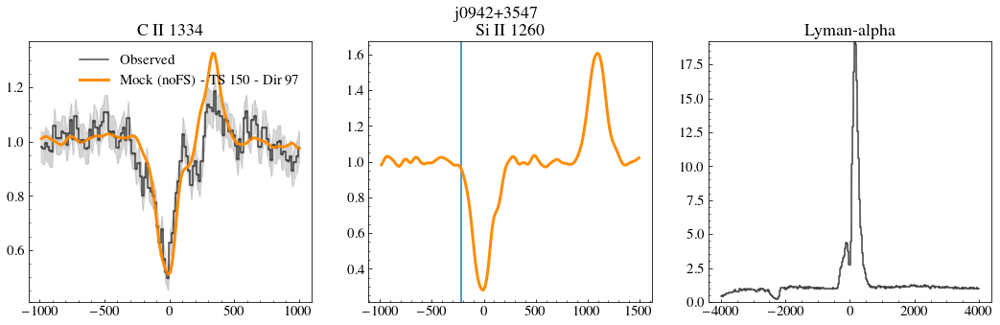

j0944-0038


<Figure size 432x288 with 0 Axes>

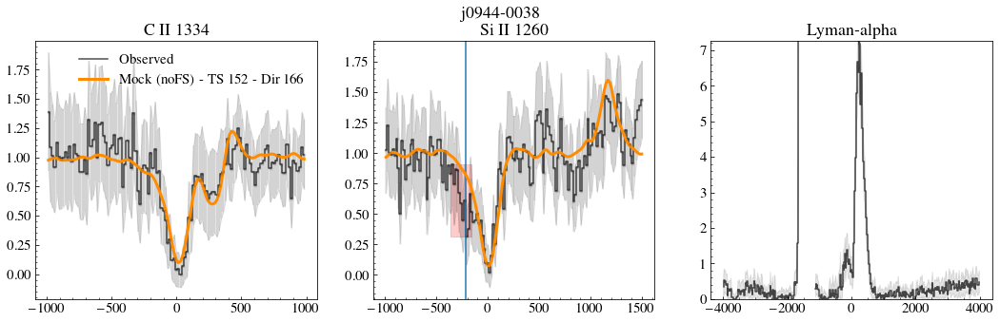

j0944+3442


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_9759/4217718321.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_9759/4217718321.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')
/tmp/ipykernel_9759/4217718321.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_9759/4217718321.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


<Figure size 432x288 with 0 Axes>

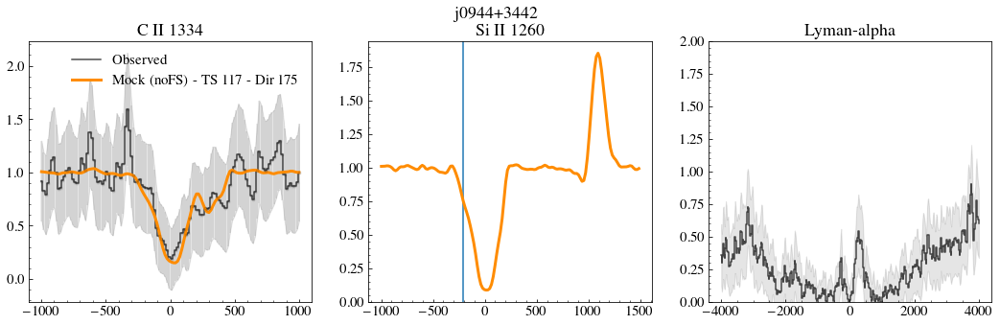

j1016+3754


<Figure size 432x288 with 0 Axes>

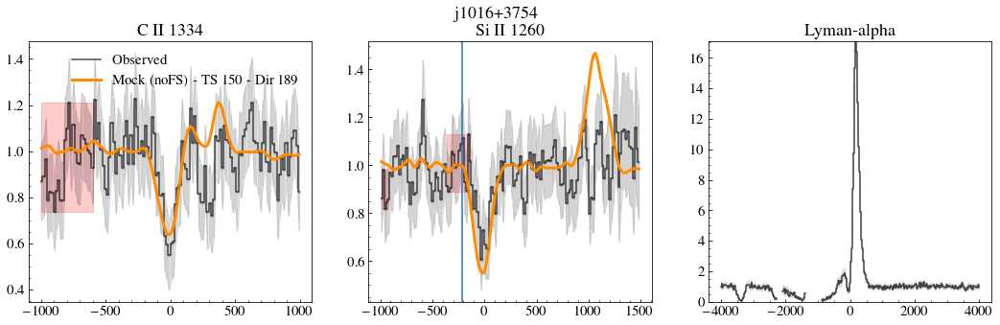

j1024+0524


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


<Figure size 432x288 with 0 Axes>

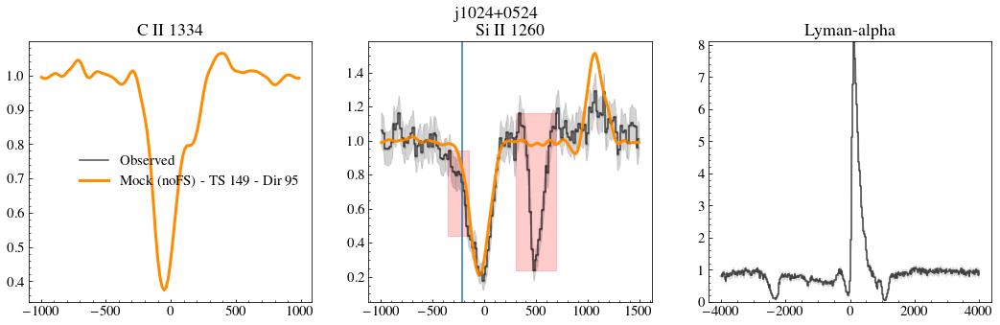

j1025+3622


<Figure size 432x288 with 0 Axes>

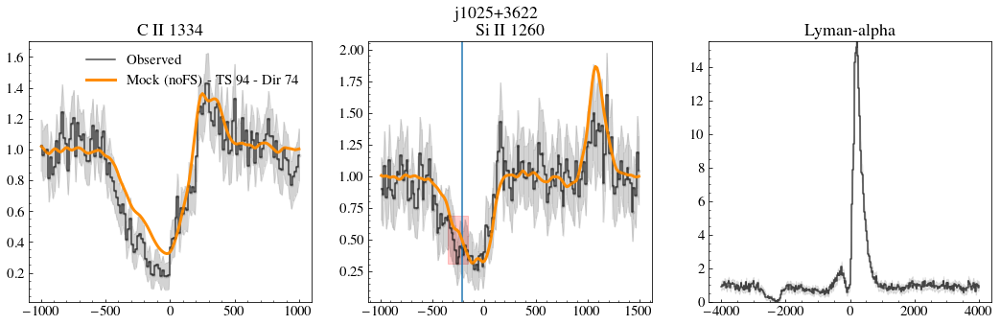

j1044+0353


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_9759/4217718321.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_9759/4217718321.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')
/tmp/ipykernel_9759/4217718321.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_9759/4217718321.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


<Figure size 432x288 with 0 Axes>

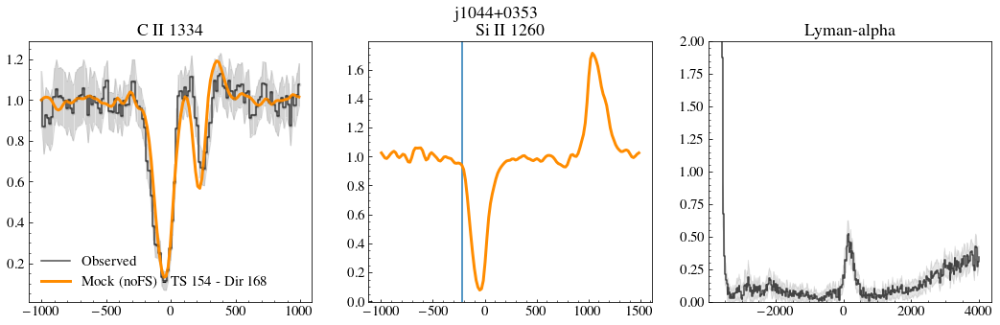

j1105+4444


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_9759/4217718321.py:87: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),


<Figure size 432x288 with 0 Axes>

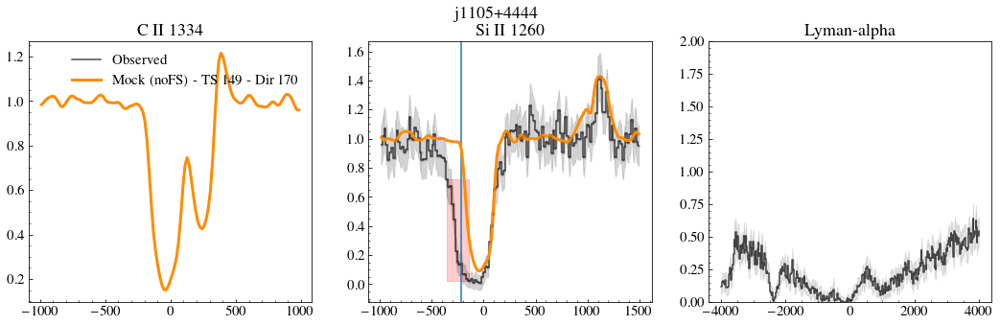

j1112+5503


<Figure size 432x288 with 0 Axes>

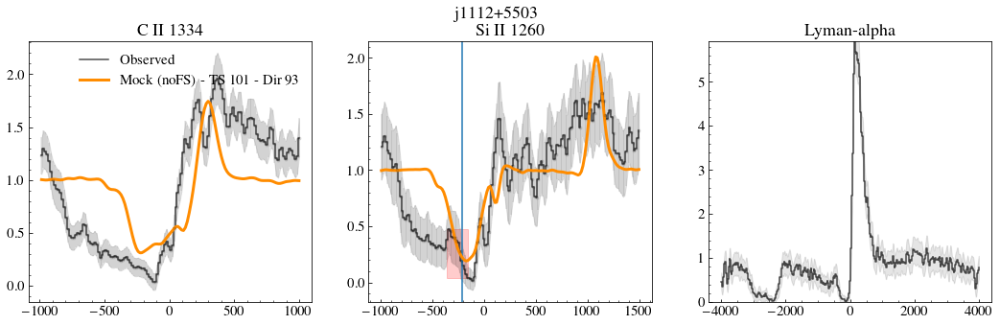

j1119+5130


<Figure size 432x288 with 0 Axes>

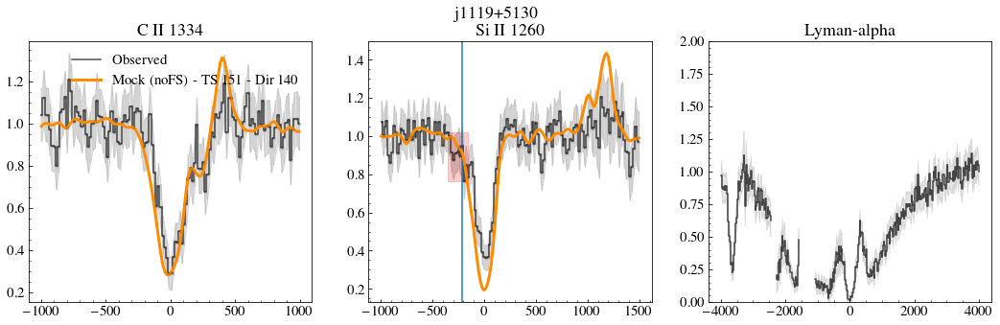

j1129+2034


<Figure size 432x288 with 0 Axes>

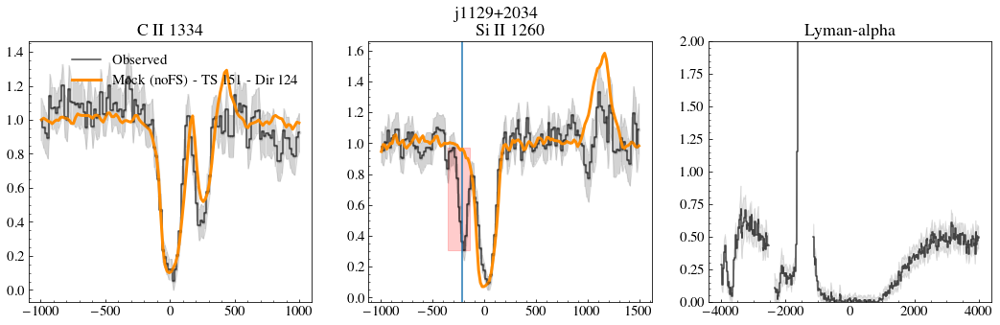

j1132+1411


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_9759/4217718321.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_9759/4217718321.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')


<Figure size 432x288 with 0 Axes>

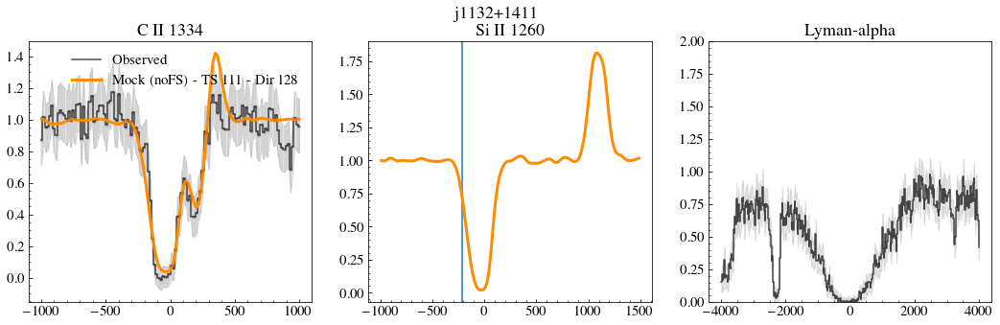

j1132+5722


<Figure size 432x288 with 0 Axes>

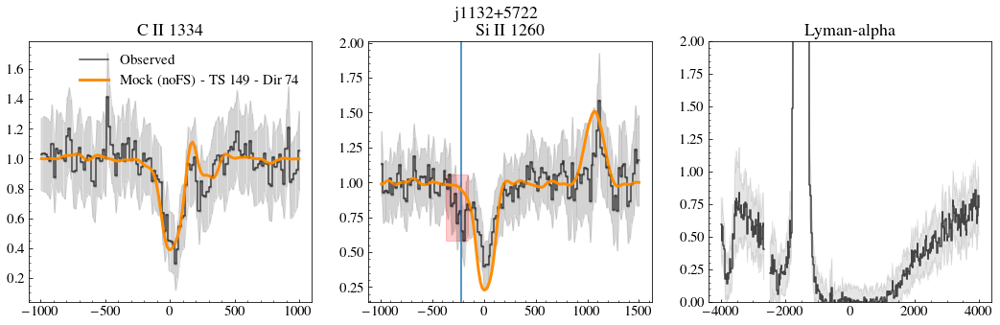

j1144+4012


<Figure size 432x288 with 0 Axes>

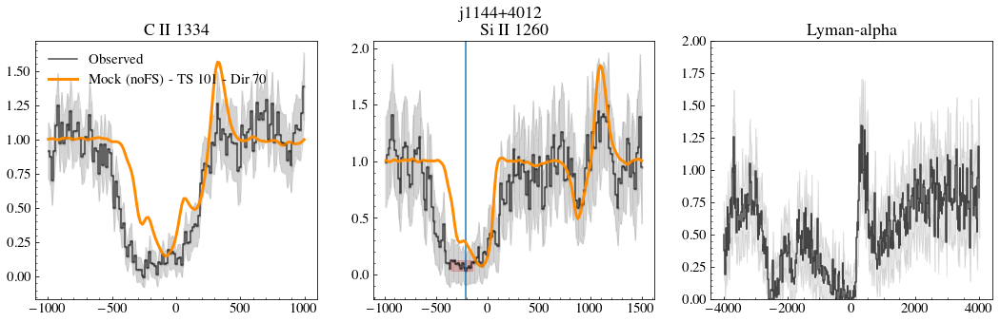

j1148+2546


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_9759/4217718321.py:87: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),


<Figure size 432x288 with 0 Axes>

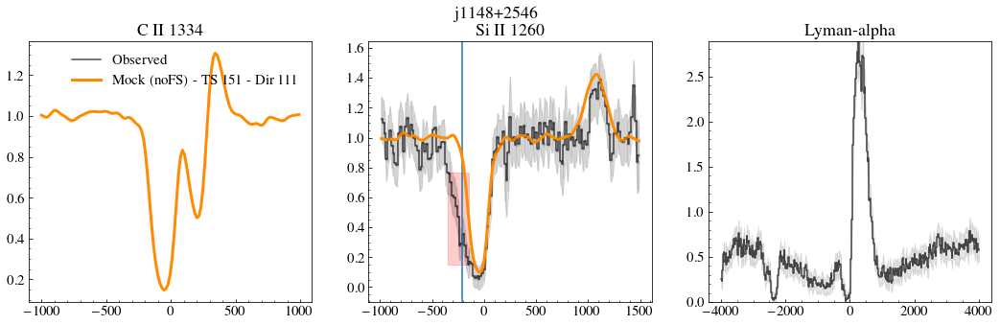

j1150+1501


<Figure size 432x288 with 0 Axes>

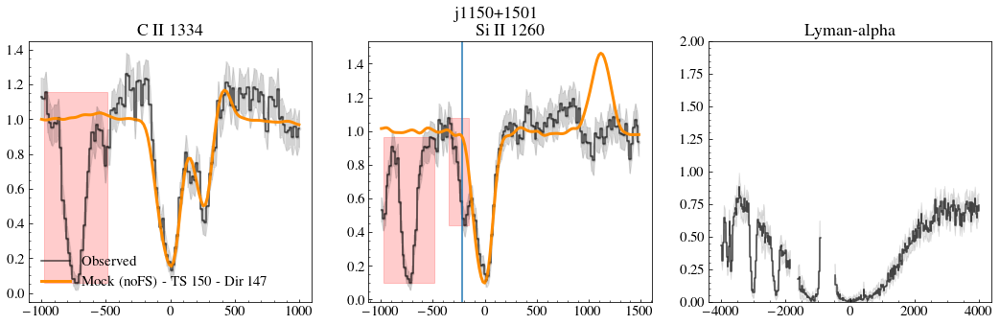

j1157+3220


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_9759/4217718321.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_9759/4217718321.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')
/tmp/ipykernel_9759/4217718321.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_9759/4217718321.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


<Figure size 432x288 with 0 Axes>

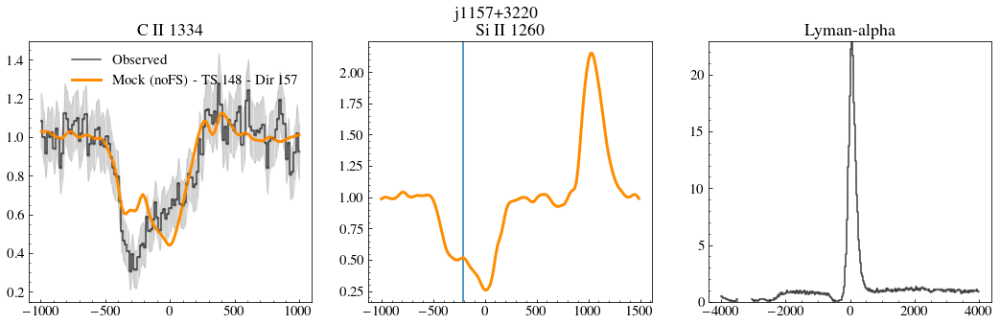

j1200+1343


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


<Figure size 432x288 with 0 Axes>

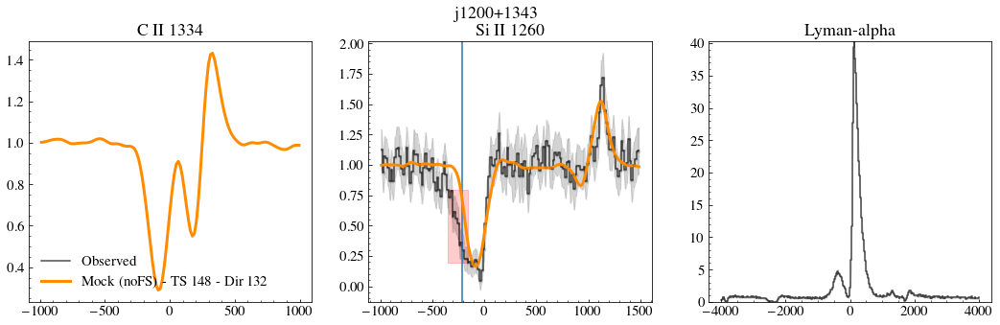

j1225+6109


<Figure size 432x288 with 0 Axes>

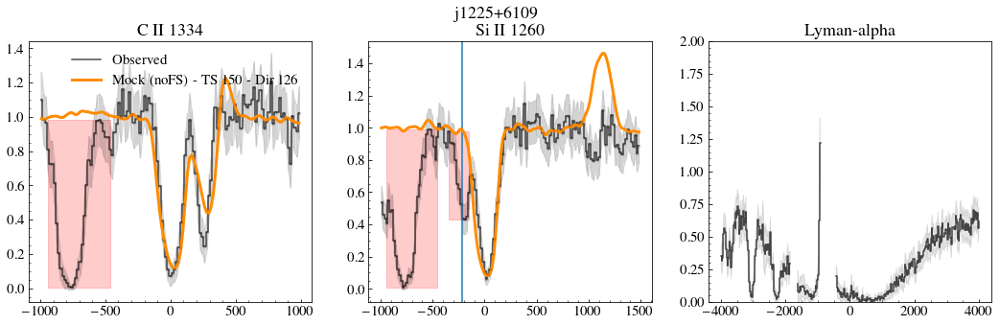

j1253-0312


<Figure size 432x288 with 0 Axes>

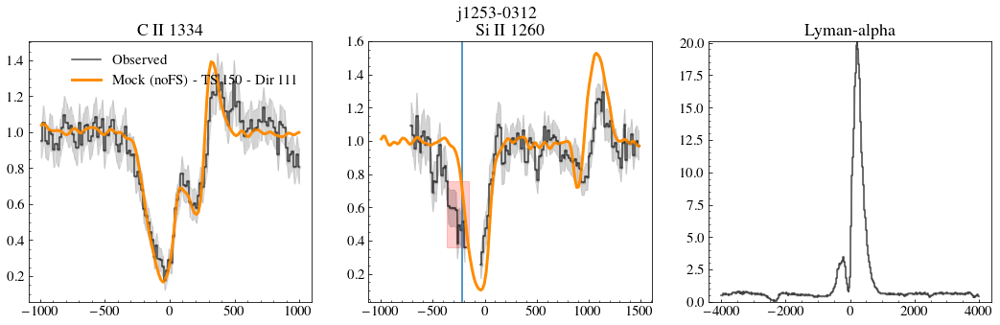

j1314+3452


<Figure size 432x288 with 0 Axes>

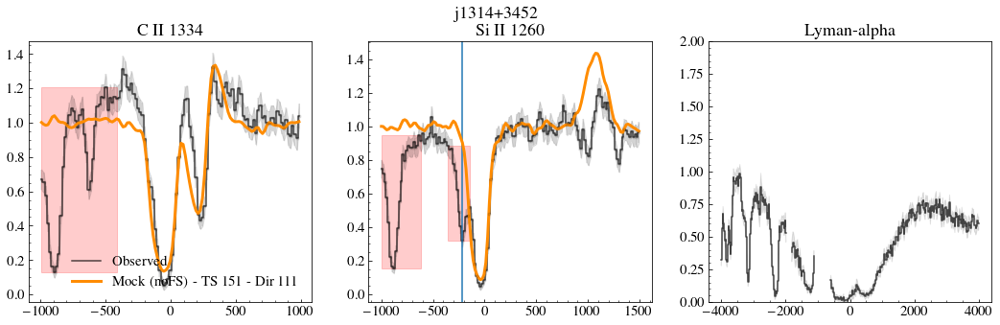

j1323-0132


<Figure size 432x288 with 0 Axes>

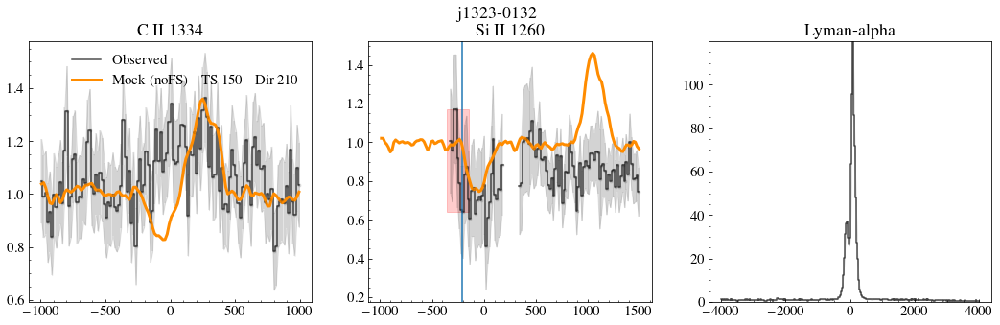

j1359+5726


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_9759/4217718321.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_9759/4217718321.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')
/tmp/ipykernel_9759/4217718321.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_9759/4217718321.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


<Figure size 432x288 with 0 Axes>

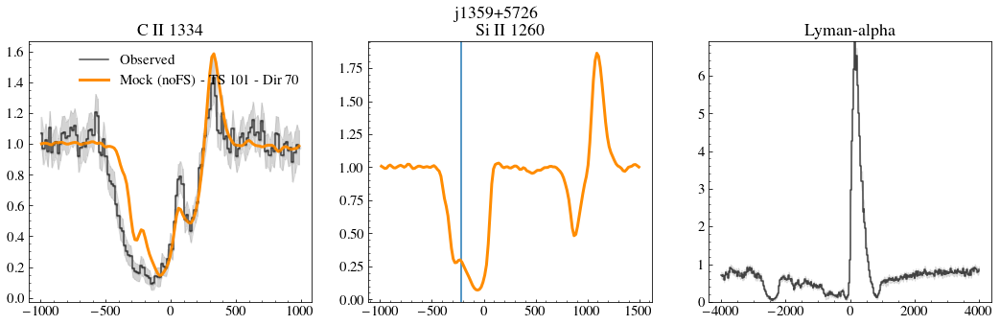

j1416+1223


<Figure size 432x288 with 0 Axes>

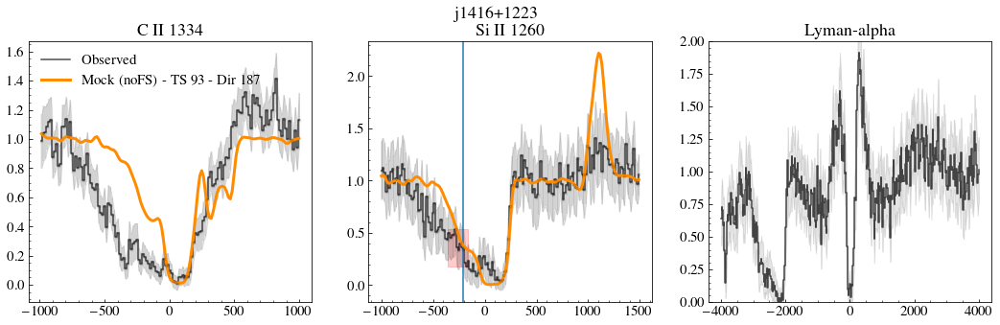

j1418+2102


/tmp/ipykernel_9759/4217718321.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_9759/4217718321.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


<Figure size 432x288 with 0 Axes>

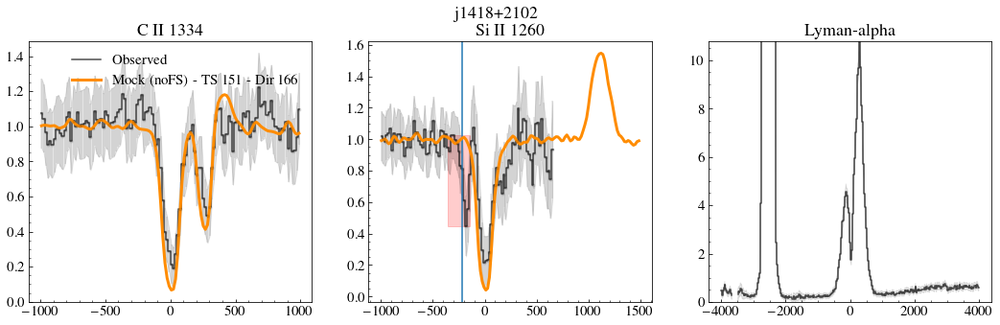

j1428+1653


<Figure size 432x288 with 0 Axes>

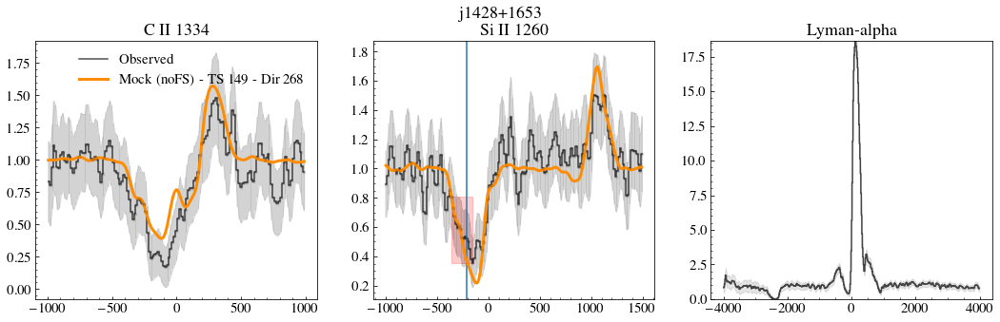

j1429+0643


<Figure size 432x288 with 0 Axes>

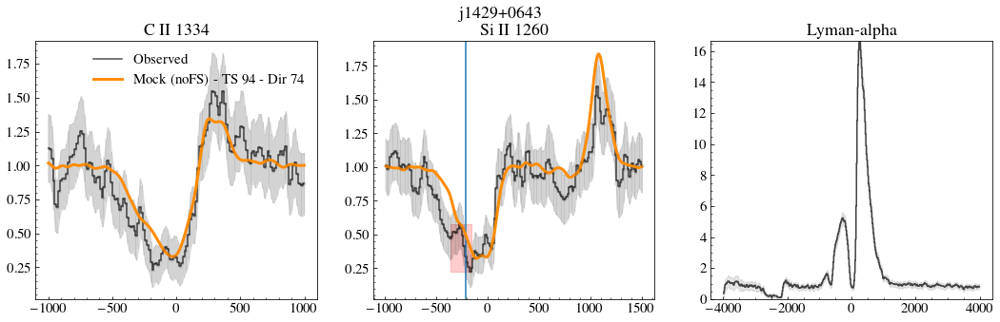

j1444+4237


<Figure size 432x288 with 0 Axes>

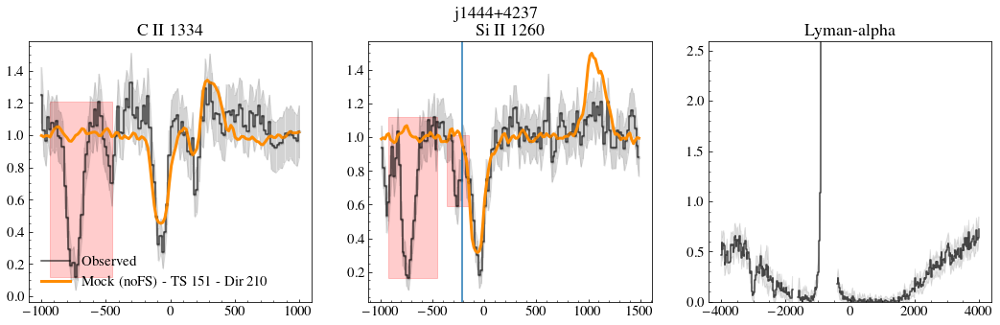

j1448-0110


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


<Figure size 432x288 with 0 Axes>

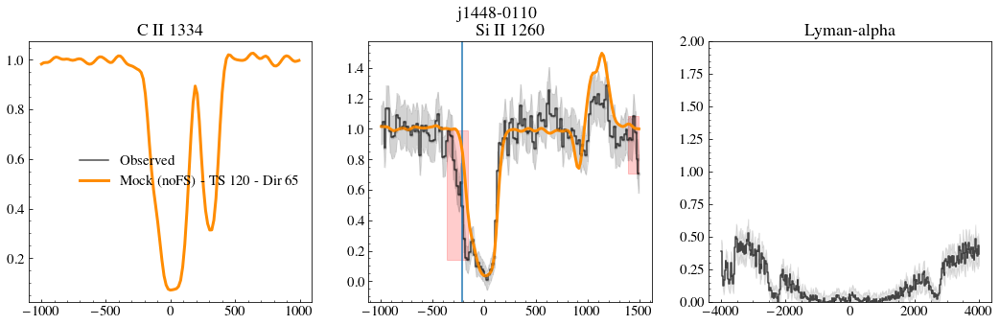

j1521+0759


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_9759/4217718321.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_9759/4217718321.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')


<Figure size 432x288 with 0 Axes>

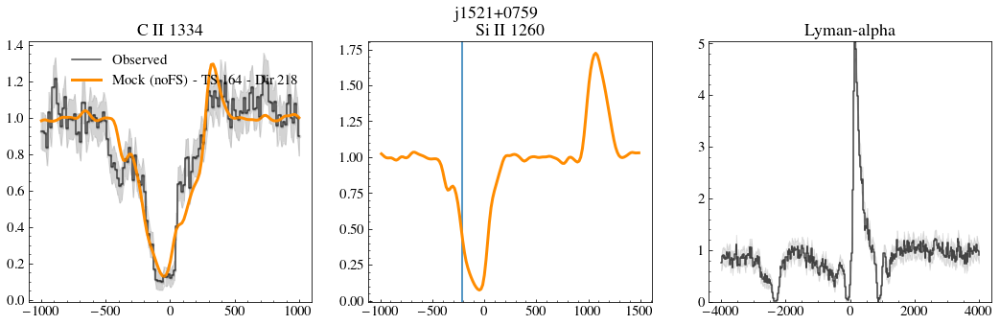

j1525+0757


<Figure size 432x288 with 0 Axes>

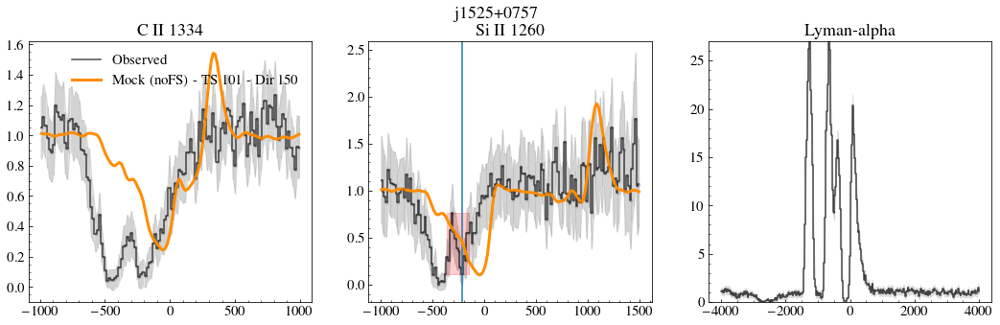

j1545+0858


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


<Figure size 432x288 with 0 Axes>

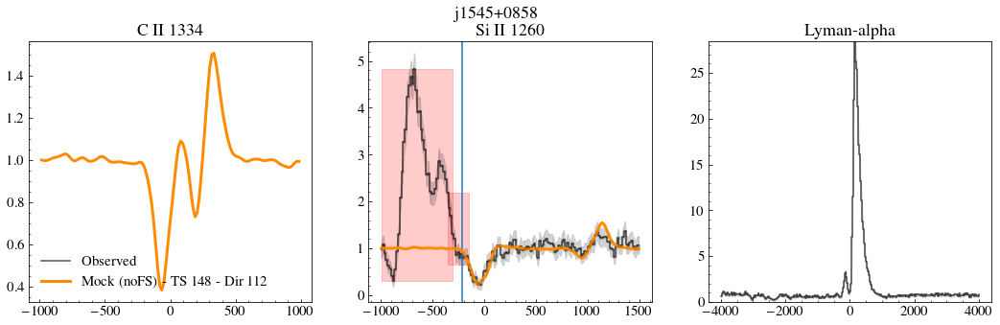

j1612+0817


<Figure size 432x288 with 0 Axes>

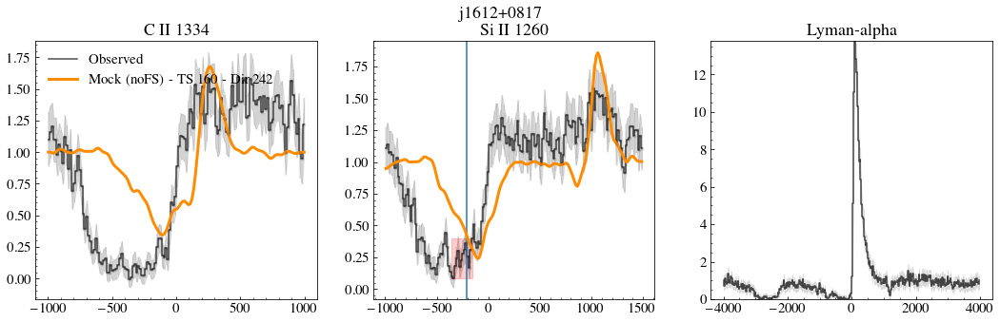

<Figure size 432x288 with 0 Axes>

In [29]:
nGal = len(galaxy)
nmocks         = 5
Chi2all        = np.zeros((45, nmocks)) + 1e10
Chi2allabs     = np.zeros((45, nmocks)) + 1e10
Chi2allemi     = np.zeros((45, nmocks)) + 1e10
Chi2siII       = np.zeros((45, nmocks)) + 1e10
Chi2siIIabs    = np.zeros((45, nmocks)) + 1e10
Chi2siIIemi    = np.zeros((45, nmocks)) + 1e10
Chi2cII        = np.zeros((45, nmocks)) + 1e10
Chi2cIIabs     = np.zeros((45, nmocks)) + 1e10
Chi2cIIemi     = np.zeros((45, nmocks)) + 1e10

dirall         = np.zeros((45, nmocks)) - 1
dirallabs      = np.zeros((45, nmocks)) - 1
dirallemi      = np.zeros((45, nmocks)) - 1
dirsiII        = np.zeros((45, nmocks)) - 1
dirsiIIabs     = np.zeros((45, nmocks)) - 1
dirsiIIemi     = np.zeros((45, nmocks)) - 1
dircII         = np.zeros((45, nmocks)) - 1
dircIIabs      = np.zeros((45, nmocks)) - 1
dircIIemi      = np.zeros((45, nmocks)) - 1

outall         = np.zeros((45, nmocks)) - 1
outallabs      = np.zeros((45, nmocks)) - 1
outallemi      = np.zeros((45, nmocks)) - 1
outsiII        = np.zeros((45, nmocks)) - 1
outsiIIabs     = np.zeros((45, nmocks)) - 1
outsiIIemi     = np.zeros((45, nmocks)) - 1
outcII         = np.zeros((45, nmocks)) - 1
outcIIabs      = np.zeros((45, nmocks)) - 1
outcIIemi      = np.zeros((45, nmocks)) - 1

for i in range(nGal):
    print(label[i])

    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    #fit = gaussian_filter(data['fit'], sigma = 10)
    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

#    absflux = gaussian_filter(data['flux']/data['fit'],sigma = 1)
#     if(i == 4):
#         absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
    #absflux /= np.median(absflux[cutSiIIall])
    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    maskLya  = mask[cutLyaall]
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 700)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])

    if(i == 1):      
        fmedCII /=1.05
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    if(i == 0):
        fmedSiII *=1.15
    fsiII /= fmedSiII
    
    fig, axs = plt.subplots(1,3,figsize=(18,5))
    #/np.nanmedian(flux[cutCIIall])
    axs[0].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[0].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[0].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
   
    
    axs[1].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[1].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]), 
                        np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')  
    axs[1].axvline(-214)
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  

#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[1].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')

    axs[2].plot(vLyad[cutLyaall], flux[cutLyaall],  c='k',alpha = 0.7,drawstyle='steps-mid' )
    axs[2].fill_between(vLyad[cutLyaall],flux[cutLyaall]-err[cutLyaall],flux[cutLyaall]+err[cutLyaall],
                        color = 'k', alpha = 0.1)
#     if(len(flux[cutLyaall][~maskLya])>0):
#         axs[2].fill_between(vLyad[cutLyaall][~maskLya], np.nanmin(flux[cutLyaall][~maskLya]), 
#                         np.nanmax(flux[cutLyaall][~maskLya]), alpha=0.2, color= 'r')  
    axs[2].set_title('Lyman-alpha')
    axs[2].set_ylim(0, np.max([2,np.nanmax(flux[abs(vLyad) < 1000])]))
  

    path_to_data = './CII_SiII_fine/'   # To change if you move the data

    v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)
    bestfluxsiall = []
    bestfluxciiall = []
    bestfluxsiabs = []
    bestfluxciiabs = []
    bestfluxsiemi = []
    bestfluxciiemi = []
#     if(i == 1):
#         esiII[(vsiII>-150) & (vsiII<150)] /=2.1
    for output in range(90,165,1):
    
        lcII,  fluxcII  = read_spectrum_c(path_to_data,output) 
        lsiII, fluxsiII = read_spectrum_si(path_to_data,output) 
        
        for idir in range(300):
            lcII_systemic = lcII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lcII) 
            lcII_systemic = lcII_systemic[1:]
            vcII_s    = (lcII_systemic/wcII1334 -1)*c

            lsiII_systemic = lsiII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lsiII) 
            lsiII_systemic = lsiII_systemic[1:]
            vsiII_s  = (lsiII_systemic/wsiII1260 -1)*c

            sigma_pixelcII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vcII_s[50] - vcII_s[49]))
            sigma_pixelsiII = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vsiII_s[50]- vsiII_s[49]))

            modelcII    = gaussian_filter(fluxcII[idir,1:], sigma = sigma_pixelcII)
            f           = interpolate.interp1d(vcII_s, modelcII)
            modelNewcII = f(vcII)

            modelsiII   = gaussian_filter(fluxsiII[idir,1:], sigma = sigma_pixelsiII)
            f           = interpolate.interp1d(vsiII_s, modelsiII)
            modelNewsiII= f(vsiII)

#             alpha = np.nansum((modelNewcII[maskCII]*fcII[maskCII]/(ecII[maskCII]**2)))/ \
#                     np.nansum(modelNewcII[maskCII]**2/ecII[maskCII]**2)
#             modelNewcII *= alpha
            
#             alpha = np.nansum((modelNewsiII[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsiII[maskSiII]**2/esiII[maskSiII]**2)
# #             print(alpha)
#             modelNewsiII *= alpha
            
            rmedCII = ((vcII<-500) | (vcII > 700)) 
            fmedCII = np.nanmedian(modelNewcII[rmedCII])
            modelNewcII /= fmedCII

            rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
            fmedSiII = np.nanmedian(modelNewsiII[rmedSiII])
            modelNewsiII /= fmedSiII
            
            maskCII = maskCII & (abs(vcII <550))
            maskSiII = maskSiII & (vsiII > - 550) & (~((vsiII >-364) & (vsiII <-144)))

            lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcII[maskCII])**2)/ecII[maskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsiII[maskSiII])**2)/esiII[maskSiII]**2)
#             print(lnlikesiII)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cII[i][0] :
                Chi2cII[i][0] = lnlikecII
                dircII[i][0]  = idir
                outcII[i][0]  = output
            
            if lnlikesiII < Chi2siII[i][0] :
                Chi2siII[i][0] = lnlikesiII
                dirsiII[i][0]  = idir
                outsiII[i][0]  = output
                
            if(lnlikeall < Chi2all[i][0]):
                dirall[i][0] = idir
                Chi2all[i][0] = lnlikeall
                outall[i][0] = output
                bestfluxsiall = modelNewsiII
                bestfluxciiall = modelNewcII
                
            absMaskCII = (vcII > -600) & (vcII < 200) & maskCII
            absMaskSiII =  (vsiII > -600) & (vsiII < 200) & maskSiII
            lnlikecII  =  0.5*np.nansum(((fcII[absMaskCII]-modelNewcII[absMaskCII])**2)/ecII[absMaskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[absMaskSiII] - modelNewsiII[absMaskSiII])**2)/esiII[absMaskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cIIabs[i][0] :
                Chi2cIIabs[i][0] = lnlikecII
                dircIIabs[i][0]  = idir
                outcIIabs[i][0]  = output
            
            if lnlikesiII < Chi2siIIabs[i][0] :
                Chi2siIIabs[i][0] = lnlikesiII
                dirsiIIabs[i][0]  = idir
                outsiIIabs[i][0]  = output
                
            if(lnlikeall < Chi2allabs[i][0]):
                dirallabs[i][0] = idir
                Chi2allabs[i][0] = lnlikeall
                outallabs[i][0] = output
                bestfluxsiabs = modelNewsiII
                bestfluxciiabs = modelNewcII
                
            emiMaskCII = (vcII > 150 ) & maskCII & (vcII <700)
            emiMaskSiII = (vsiII > 700) & maskSiII & (vsiII <1500)
            lnlikecII  =  0.5*np.nansum(((fcII[emiMaskCII]-modelNewcII[emiMaskCII])**2)/ecII[emiMaskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[emiMaskSiII] - modelNewsiII[emiMaskSiII])**2)/esiII[emiMaskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cIIemi[i][0] :
                Chi2cIIemi[i][0] = lnlikecII
                dircIIemi[i][0]  = idir
                outcIIemi[i][0]  = output
            
            if lnlikesiII < Chi2siIIemi[i][0] :
                Chi2siIIemi[i][0] = lnlikesiII
                dirsiIIemi[i][0]  = idir
                outsiIIemi[i][0]  = output
                
            if(lnlikeall < Chi2allemi[i][0]):
#                 print(lnlikeall,lnlikecII,lnlikesiII)
                dirallemi[i][0] = idir
                Chi2allemi[i][0] = lnlikeall
                outallemi[i][0] = output
                bestfluxsiemi = modelNewsiII
                bestfluxciiemi = modelNewcII
    
    # l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
#     lcII, fluxcII   = read_spectrum_c(path_to_data,int(outall[i][0]) )
#     lsiII, fluxsiII = read_spectrum_si(path_to_data,int(outall[i][0]) )
#     print(Chi2all[i][0])
#     lcII_systemic  = lcII + np.dot(directions[int(dirall[i][0]),:],v_cm[:,int(outall[i][0])-90])/c_cgs*1e5*np.mean(lcII) 
#     lcII_systemic  = lcII_systemic[1:]
#     vcII_s         = (lcII_systemic/wcII1334 -1)*c
#     sigma_pixelcii = res[i] /2.355 / ((vcII_s[50]-vcII_s[49]))
#     model          = gaussian_filter(fluxcII[int(dirall[i][0]),1:], sigma = sigma_pixelcii)
#     f              =  interpolate.interp1d(vcII_s, model)
#     modelNewcii    = f(vcII)
#     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
#                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
#     modelNewcii    *= alpha
#     axs[0].plot(vcII, modelNewcii, label = 'Best mock (FS) - TS %d - Dir %d'%(outall[i][0], dirall[i][0]), c =cnoFS, lw = 3)

    
#     lsiII_systemic = lsiII + np.dot(directions[int(dirall[i][0]),:],v_cm[:,int(outall[i][0])-90])/c_cgs*1e5*np.mean(lsiII) 
#     lsiII_systemic = lsiII_systemic[1:]
#     vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
#     sigma_pixelsi  = res[i] /2.355/ ((vsiII_s[50]-vsiII_s[49]))
#     model          = gaussian_filter(fluxsiII[int(dirall[i][0]),1:], sigma = sigma_pixelsi)
#     f              = interpolate.interp1d(vsiII_s, model)
#     modelNewsi     = f(vsiII)
#     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
#     modelNewsi   *= alpha
#     axs[1].plot(vsiII, modelNewsi, c =cnoFS, lw = 3)
    axs[0].plot(vcII, bestfluxciiall,
                label = 'Mock (noFS) - TS %d - Dir %d'%(outall[i][0], dirall[i][0]), c =cnoFS, lw = 3)
#     axs[0].plot(vcII, bestfluxciiabs, 
#                 label = 'Mock abs (noFS) - TS %d - Dir %d'%(outallabs[i][0], dirallabs[i][0]), c =cFS, lw = 3)
#     axs[0].plot(vcII, bestfluxciiemi, 
#                 label = 'Mock emi (noFS) - TS %d - Dir %d'%(outallemi[i][0], dirallemi[i][0]), c ='c', lw = 3)

    
    axs[1].plot(vsiII, bestfluxsiall, c =cnoFS, lw = 3)
   # axs[1].plot(vsiII, bestfluxsiabs, c =cFS, lw = 3)
   # axs[1].plot(vsiII, bestfluxsiemi, c ='c', lw = 3)

#     lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
#     lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
#     lnlikeall  = lnlikecII + lnlikesiII
#     print('FS: ',lnlikecII, lnlikesiII, lnlikeall )
    axs[0].legend(frameon=False)
    plt.suptitle(label[i])
    plt.show()
    plt.savefig('Plots/'+galaxy[i]+'matchFS.pdf', bbox_inches = 'tight')


In [30]:
df = pd.DataFrame(np.vstack((galaxy, 
                             outall[:,0].astype(int), dirall[:,0].astype(int), Chi2all[:,0],
                             outsiII[:,0].astype(int), dirsiII[:,0].astype(int), Chi2siII[:,0],
                             outcII[:,0].astype(int), dircII[:,0].astype(int), Chi2cII[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("csv/Classy_FS_fit.csv", sep=',', header= C, index=False) 


df = pd.DataFrame(np.vstack((galaxy, 
                             outallabs[:,0].astype(int), dirallabs[:,0].astype(int), Chi2allabs[:,0],
                             outsiIIabs[:,0].astype(int), dirsiIIabs[:,0].astype(int), Chi2siIIabs[:,0],
                             outcIIabs[:,0].astype(int), dircIIabs[:,0].astype(int), Chi2cIIabs[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("csv/Classy_FS_absfit.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

df = pd.DataFrame(np.vstack((galaxy, 
                             outallemi[:,0].astype(int), dirallemi[:,0].astype(int), Chi2allemi[:,0],
                             outsiIIemi[:,0].astype(int), dirsiIIemi[:,0].astype(int), Chi2siIIemi[:,0],
                             outcIIemi[:,0].astype(int), dircIIemi[:,0].astype(int), Chi2cIIemi[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("csv/Classy_FS_emifit.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

### Only out 148

j0934+5514


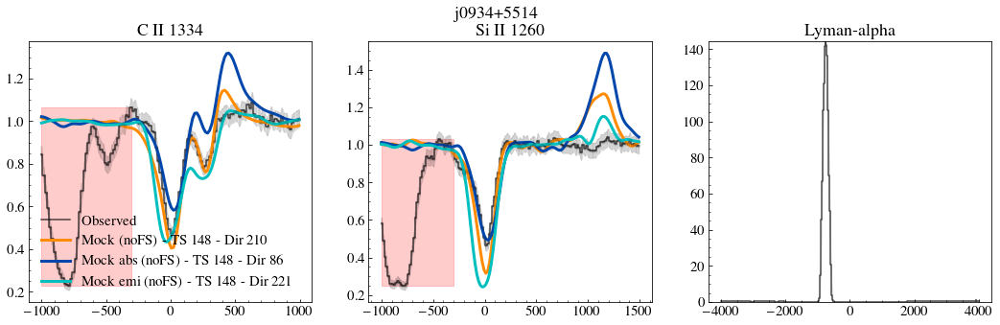

j0938+5428


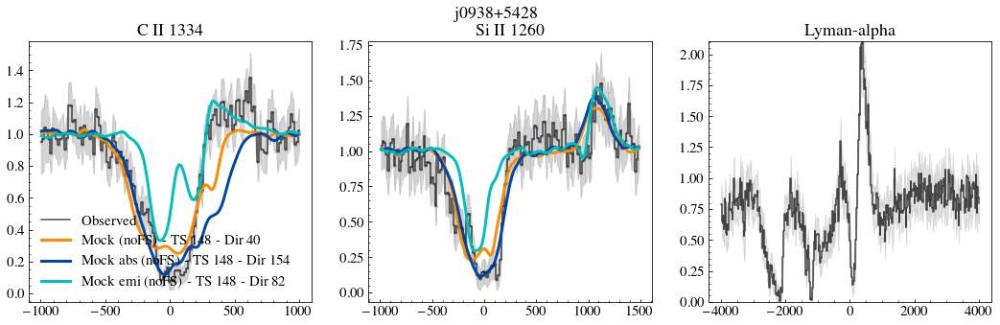

j0940+2935


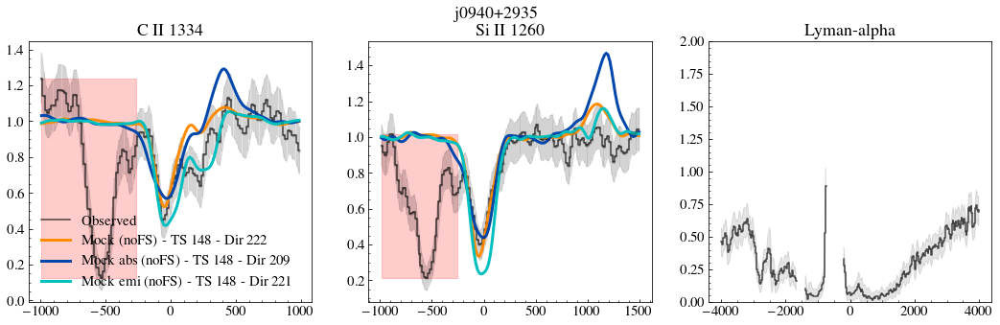

j0942+3547


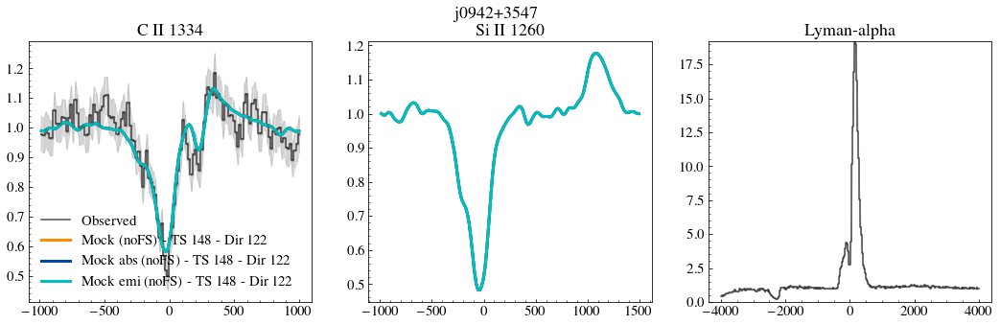

j0944-0038


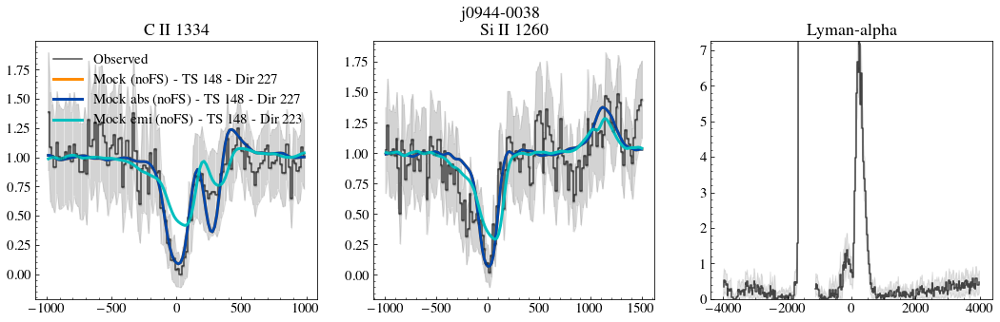

In [61]:
nGal = len(galaxy)
nmocks         = 5
Chi2all        = np.zeros((45, nmocks)) + 1e10
Chi2allabs     = np.zeros((45, nmocks)) + 1e10
Chi2allemi     = np.zeros((45, nmocks)) + 1e10
Chi2siII       = np.zeros((45, nmocks)) + 1e10
Chi2siIIabs    = np.zeros((45, nmocks)) + 1e10
Chi2siIIemi    = np.zeros((45, nmocks)) + 1e10
Chi2cII        = np.zeros((45, nmocks)) + 1e10
Chi2cIIabs     = np.zeros((45, nmocks)) + 1e10
Chi2cIIemi     = np.zeros((45, nmocks)) + 1e10

dirall         = np.zeros((45, nmocks)) - 1
dirallabs      = np.zeros((45, nmocks)) - 1
dirallemi      = np.zeros((45, nmocks)) - 1
dirsiII        = np.zeros((45, nmocks)) - 1
dirsiIIabs     = np.zeros((45, nmocks)) - 1
dirsiIIemi     = np.zeros((45, nmocks)) - 1
dircII         = np.zeros((45, nmocks)) - 1
dircIIabs      = np.zeros((45, nmocks)) - 1
dircIIemi      = np.zeros((45, nmocks)) - 1

outall         = np.zeros((45, nmocks)) - 1
outallabs      = np.zeros((45, nmocks)) - 1
outallemi      = np.zeros((45, nmocks)) - 1
outsiII        = np.zeros((45, nmocks)) - 1
outsiIIabs     = np.zeros((45, nmocks)) - 1
outsiIIemi     = np.zeros((45, nmocks)) - 1
outcII         = np.zeros((45, nmocks)) - 1
outcIIabs      = np.zeros((45, nmocks)) - 1
outcIIemi      = np.zeros((45, nmocks)) - 1

for i in range(9,14):
    print(label[i])

    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    #fit = gaussian_filter(data['fit'], sigma = 10)
    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

#    absflux = gaussian_filter(data['flux']/data['fit'],sigma = 1)
#     if(i == 4):
#         absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
    #absflux /= np.median(absflux[cutSiIIall])
    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    maskLya  = mask[cutLyaall]
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 700)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
    
    fig, axs = plt.subplots(1,3,figsize=(18,5))
    #/np.nanmedian(flux[cutCIIall])
    axs[0].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[0].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[0].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
   
    
    axs[1].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[1].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  
#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[1].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')

    axs[2].plot(vLyad[cutLyaall], flux[cutLyaall],  c='k',alpha = 0.7,drawstyle='steps-mid' )
    axs[2].fill_between(vLyad[cutLyaall],flux[cutLyaall]-err[cutLyaall],flux[cutLyaall]+err[cutLyaall],
                        color = 'k', alpha = 0.1)
#     if(len(flux[cutLyaall][~maskLya])>0):
#         axs[2].fill_between(vLyad[cutLyaall][~maskLya], np.nanmin(flux[cutLyaall][~maskLya]), 
#                         np.nanmax(flux[cutLyaall][~maskLya]), alpha=0.2, color= 'r')  
    axs[2].set_title('Lyman-alpha')
    axs[2].set_ylim(0, np.max([2,np.nanmax(flux[abs(vLyad) < 1000])]))
  

    path_to_data = './CII_SiII_depletion/'   # To change if you move the data

    v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)
    bestfluxsiall = []
    bestfluxciiall = []
    bestfluxsiabs = []
    bestfluxciiabs = []
    bestfluxsiemi = []
    bestfluxciiemi = []
    for output in range(148,149,1):
    
        lcII,  fluxcII  = read_spectrum_c(path_to_data,output) 
        lsiII, fluxsiII = read_spectrum_si(path_to_data,output) 
        
        for idir in range(300):
            lcII_systemic = lcII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lcII) 
            lcII_systemic = lcII_systemic[1:]
            vcII_s    = (lcII_systemic/wcII1334 -1)*c

            lsiII_systemic = lsiII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lsiII) 
            lsiII_systemic = lsiII_systemic[1:]
            vsiII_s  = (lsiII_systemic/wsiII1260 -1)*c

            sigma_pixelcII  = res[i] /2.355/ ((vcII_s[50] - vcII_s[49]))
            sigma_pixelsiII = res[i] /2.355/ ((vsiII_s[50]- vsiII_s[49]))

            modelcII    = gaussian_filter(fluxcII[idir,1:], sigma = sigma_pixelcII)
            f           = interpolate.interp1d(vcII_s, modelcII)
            modelNewcII = f(vcII)

            modelsiII   = gaussian_filter(fluxsiII[idir,1:], sigma = sigma_pixelsiII)
            f           = interpolate.interp1d(vsiII_s, modelsiII)
            modelNewsiII= f(vsiII)

#             alpha = np.nansum((modelNewcII[maskCII]*fcII[maskCII]/(ecII[maskCII]**2)))/ \
#                     np.nansum(modelNewcII[maskCII]**2/ecII[maskCII]**2)
#             modelNewcII *= alpha
            
#             alpha = np.nansum((modelNewsiII[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsiII[maskSiII]**2/esiII[maskSiII]**2)
# #             print(alpha)
#             modelNewsiII *= alpha
            
            rmedCII = ((vcII<-500) | (vcII > 700)) 
            fmedCII = np.nanmedian(modelNewcII[rmedCII])
            modelNewcII /= fmedCII

            rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
            fmedSiII = np.nanmedian(modelNewsiII[rmedSiII])
            modelNewsiII /= fmedSiII
    
            lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcII[maskCII])**2)/ecII[maskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsiII[maskSiII])**2)/esiII[maskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cII[i][0] :
                Chi2cII[i][0] = lnlikecII
                dircII[i][0]  = idir
                outcII[i][0]  = output
            
            if lnlikesiII < Chi2siII[i][0] :
                Chi2siII[i][0] = lnlikesiII
                dirsiII[i][0]  = idir
                outsiII[i][0]  = output
                
            if(lnlikeall < Chi2all[i][0]):
                dirall[i][0] = idir
                Chi2all[i][0] = lnlikeall
                outall[i][0] = output
                bestfluxsiall = modelNewsiII
                bestfluxciiall = modelNewcII
                
            absMaskCII = (vcII > -600) & (vcII < 200) & maskCII
            absMaskSiII =  (vsiII > -600) & (vsiII < 200) & maskSiII
            lnlikecII  =  0.5*np.nansum(((fcII[absMaskCII]-modelNewcII[absMaskCII])**2)/ecII[absMaskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[absMaskSiII] - modelNewsiII[absMaskSiII])**2)/esiII[absMaskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cIIabs[i][0] :
                Chi2cIIabs[i][0] = lnlikecII
                dircIIabs[i][0]  = idir
                outcIIabs[i][0]  = output
            
            if lnlikesiII < Chi2siIIabs[i][0] :
                Chi2siIIabs[i][0] = lnlikesiII
                dirsiIIabs[i][0]  = idir
                outsiIIabs[i][0]  = output
                
            if(lnlikeall < Chi2allabs[i][0]):
                dirallabs[i][0] = idir
                Chi2allabs[i][0] = lnlikeall
                outallabs[i][0] = output
                bestfluxsiabs = modelNewsiII
                bestfluxciiabs = modelNewcII
                
            emiMaskCII = (vcII > 150 ) & maskCII & (vcII <700)
            emiMaskSiII = (vsiII > 700) & maskSiII & (vsiII <1500)
            lnlikecII  =  0.5*np.nansum(((fcII[emiMaskCII]-modelNewcII[emiMaskCII])**2)/ecII[emiMaskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[emiMaskSiII] - modelNewsiII[emiMaskSiII])**2)/esiII[emiMaskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cIIemi[i][0] :
                Chi2cIIemi[i][0] = lnlikecII
                dircIIemi[i][0]  = idir
                outcIIemi[i][0]  = output
            
            if lnlikesiII < Chi2siIIemi[i][0] :
                Chi2siIIemi[i][0] = lnlikesiII
                dirsiIIemi[i][0]  = idir
                outsiIIemi[i][0]  = output
                
            if(lnlikeall < Chi2allemi[i][0]):
#                 print(lnlikeall,lnlikecII,lnlikesiII)
                dirallemi[i][0] = idir
                Chi2allemi[i][0] = lnlikeall
                outallemi[i][0] = output
                bestfluxsiemi = modelNewsiII
                bestfluxciiemi = modelNewcII
    
    # l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
#     lcII, fluxcII   = read_spectrum_c(path_to_data,int(outall[i][0]) )
#     lsiII, fluxsiII = read_spectrum_si(path_to_data,int(outall[i][0]) )
#     print(Chi2all[i][0])
#     lcII_systemic  = lcII + np.dot(directions[int(dirall[i][0]),:],v_cm[:,int(outall[i][0])-90])/c_cgs*1e5*np.mean(lcII) 
#     lcII_systemic  = lcII_systemic[1:]
#     vcII_s         = (lcII_systemic/wcII1334 -1)*c
#     sigma_pixelcii = res[i] /2.355 / ((vcII_s[50]-vcII_s[49]))
#     model          = gaussian_filter(fluxcII[int(dirall[i][0]),1:], sigma = sigma_pixelcii)
#     f              =  interpolate.interp1d(vcII_s, model)
#     modelNewcii    = f(vcII)
#     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
#                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
#     modelNewcii    *= alpha
#     axs[0].plot(vcII, modelNewcii, label = 'Best mock (FS) - TS %d - Dir %d'%(outall[i][0], dirall[i][0]), c =cnoFS, lw = 3)

    
#     lsiII_systemic = lsiII + np.dot(directions[int(dirall[i][0]),:],v_cm[:,int(outall[i][0])-90])/c_cgs*1e5*np.mean(lsiII) 
#     lsiII_systemic = lsiII_systemic[1:]
#     vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
#     sigma_pixelsi  = res[i] /2.355/ ((vsiII_s[50]-vsiII_s[49]))
#     model          = gaussian_filter(fluxsiII[int(dirall[i][0]),1:], sigma = sigma_pixelsi)
#     f              = interpolate.interp1d(vsiII_s, model)
#     modelNewsi     = f(vsiII)
#     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
#     modelNewsi   *= alpha
#     axs[1].plot(vsiII, modelNewsi, c =cnoFS, lw = 3)
    axs[0].plot(vcII, bestfluxciiall,
                label = 'Mock (noFS) - TS %d - Dir %d'%(outall[i][0], dirall[i][0]), c =cnoFS, lw = 3)
    axs[0].plot(vcII, bestfluxciiabs, 
                label = 'Mock abs (noFS) - TS %d - Dir %d'%(outallabs[i][0], dirallabs[i][0]), c =cFS, lw = 3)
    axs[0].plot(vcII, bestfluxciiemi, 
                label = 'Mock emi (noFS) - TS %d - Dir %d'%(outallemi[i][0], dirallemi[i][0]), c ='c', lw = 3)

    
    axs[1].plot(vsiII, bestfluxsiall, c =cnoFS, lw = 3)
    axs[1].plot(vsiII, bestfluxsiabs, c =cFS, lw = 3)
    axs[1].plot(vsiII, bestfluxsiemi, c ='c', lw = 3)

#     lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
#     lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
#     lnlikeall  = lnlikecII + lnlikesiII
#     print('FS: ',lnlikecII, lnlikesiII, lnlikeall )
    axs[0].legend(frameon=False)
    plt.suptitle(label[i])
    plt.show()
#     plt.savefig('Plots/'+galaxy[i]+'matchFS.pdf', bbox_inches = 'tight')


## 75 TS - dust model diff

j0021+0052
0.11714


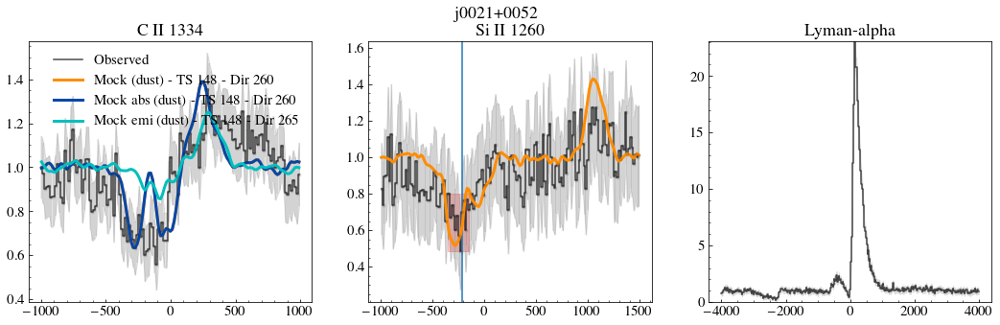

j0036-3333
0.0044605


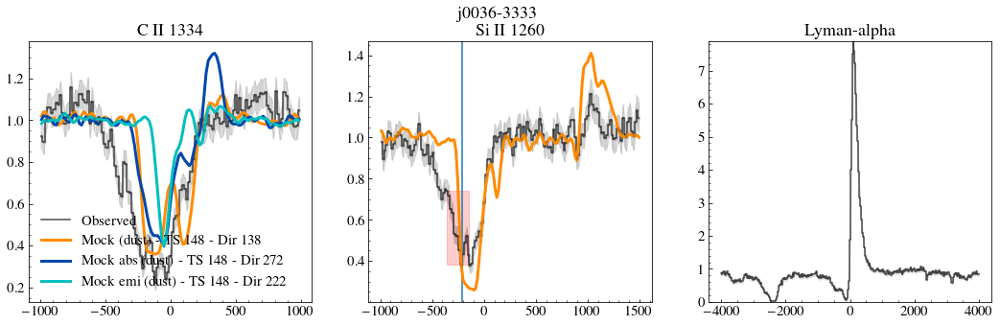

j0127-0619
0.0053353


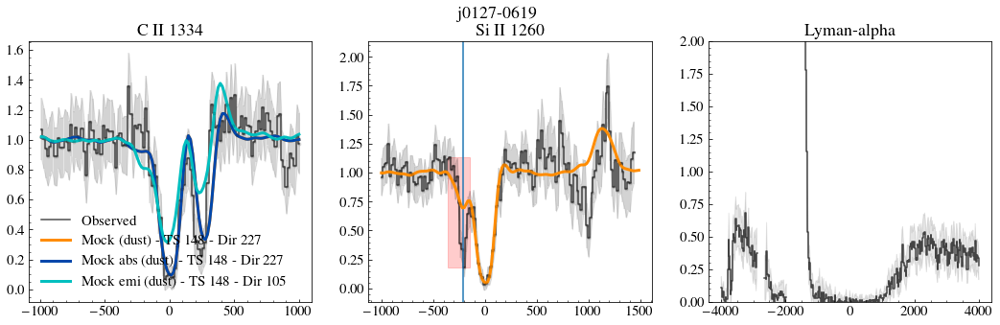

j0144+0453
0.040969


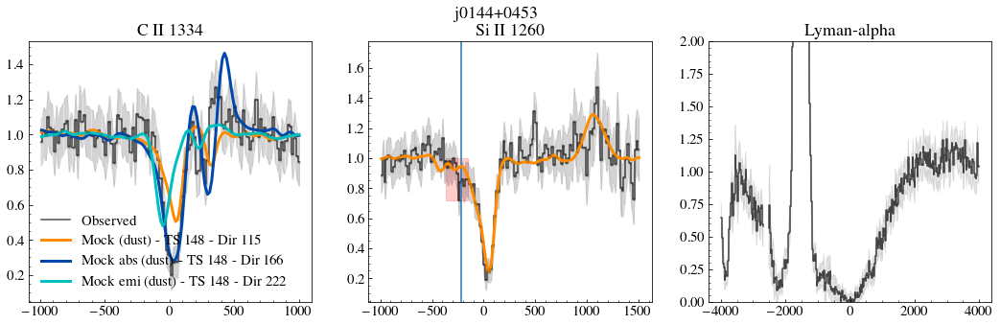

j0337-0502
0.030514


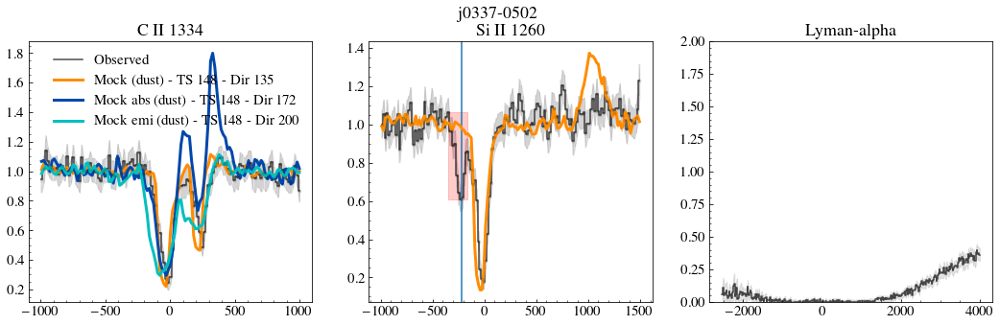

j0405-3648
0.17645


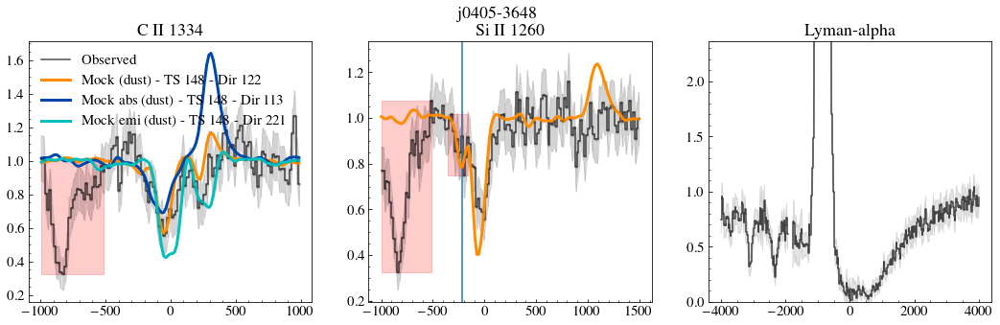

j0808+3948
0.4176


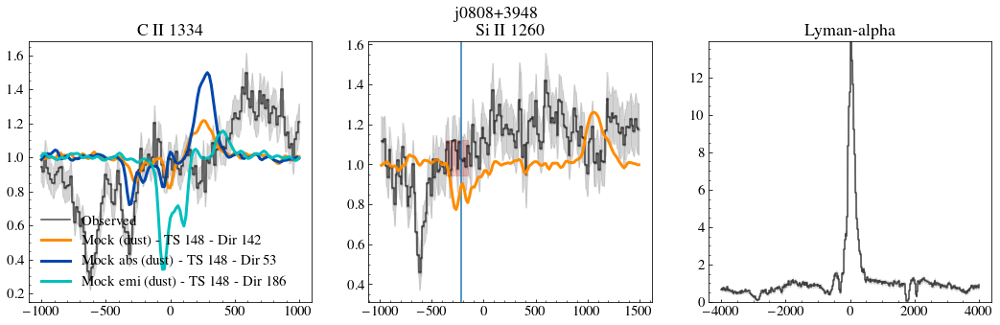

j0823+2806
0.0053544


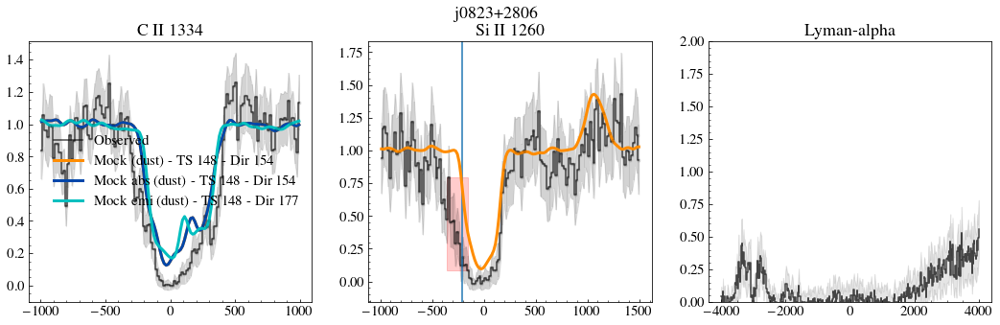

j0926+4427
0.11714


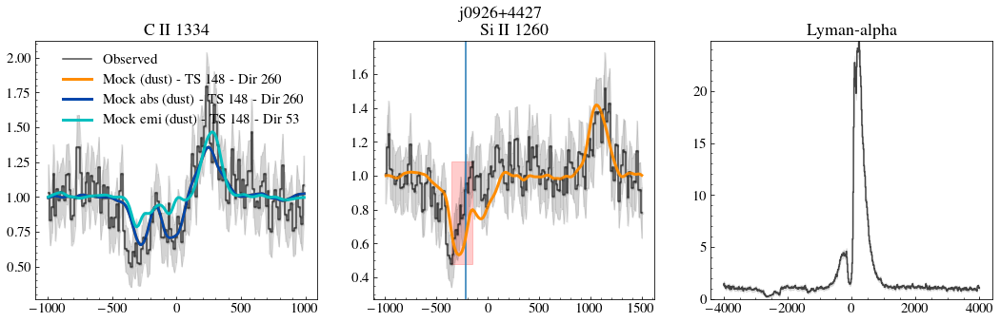

j0934+5514
0.27429


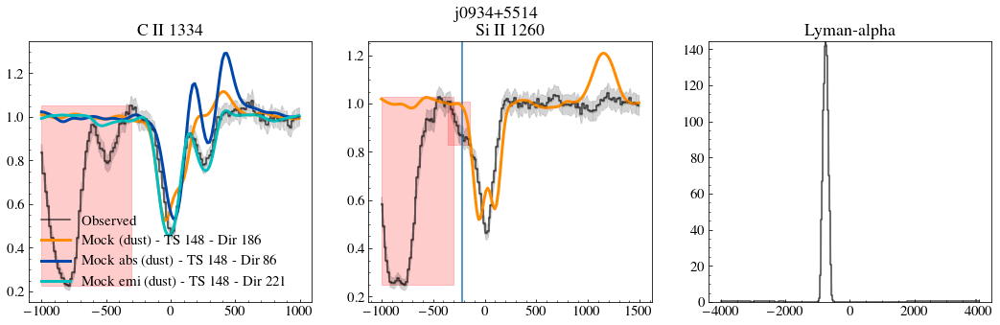

j0938+5428
0.0053544


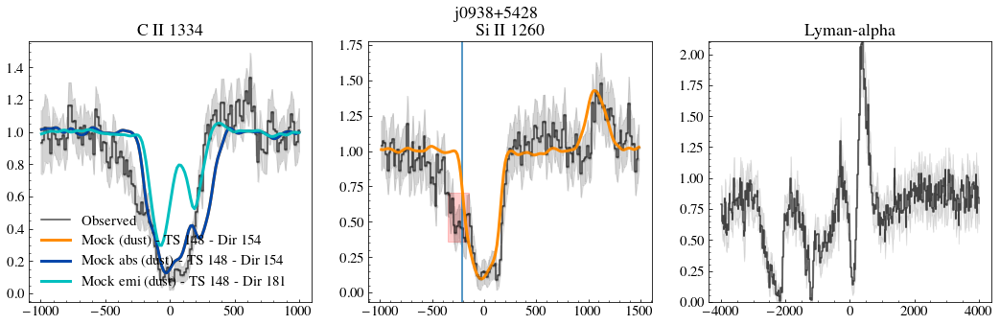

j0940+2935
0.18239


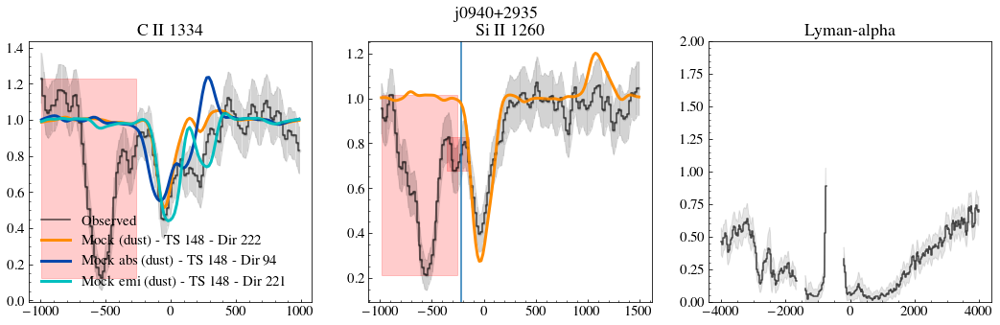

j0942+3547
0.17645


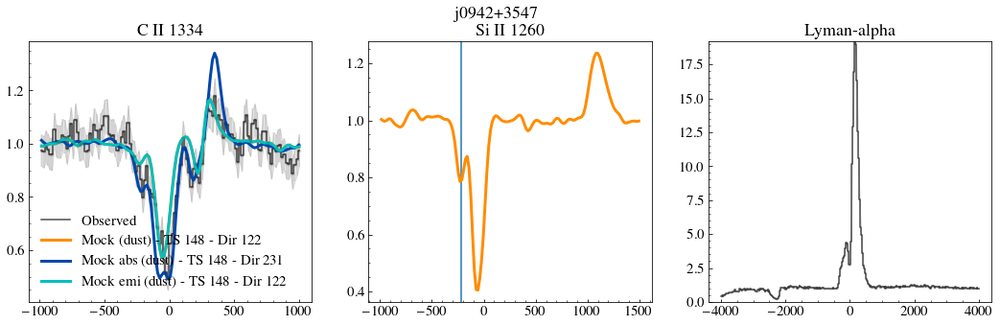

j0944-0038
0.0053042


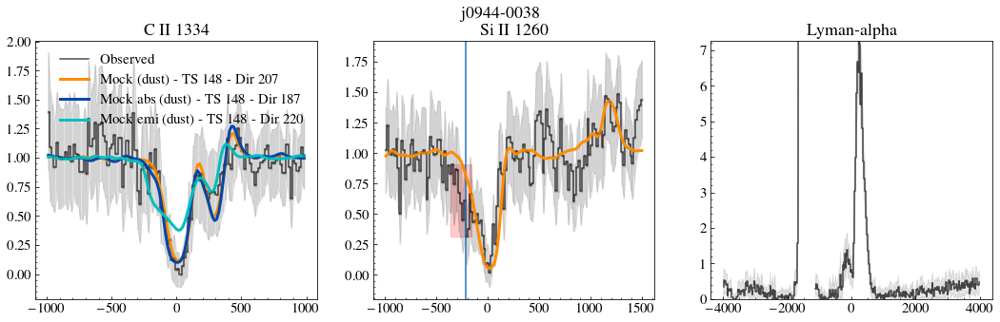

j0944+3442
0.0047086


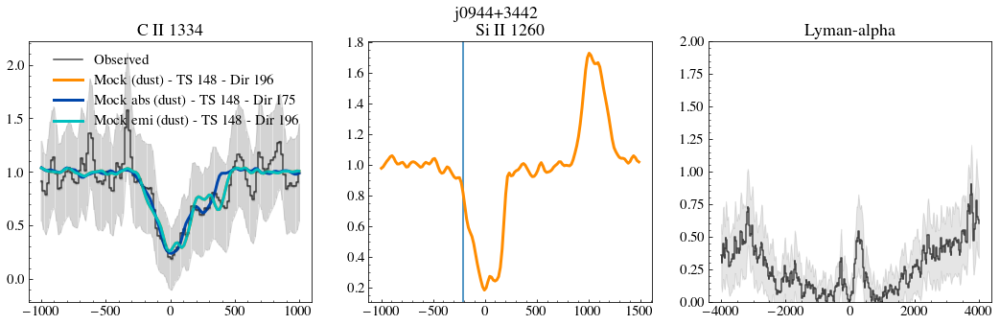

j1016+3754
0.09516


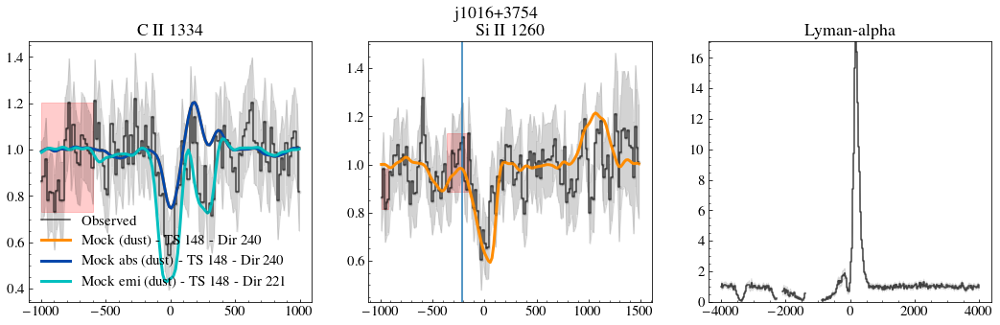

j1024+0524
0.038265


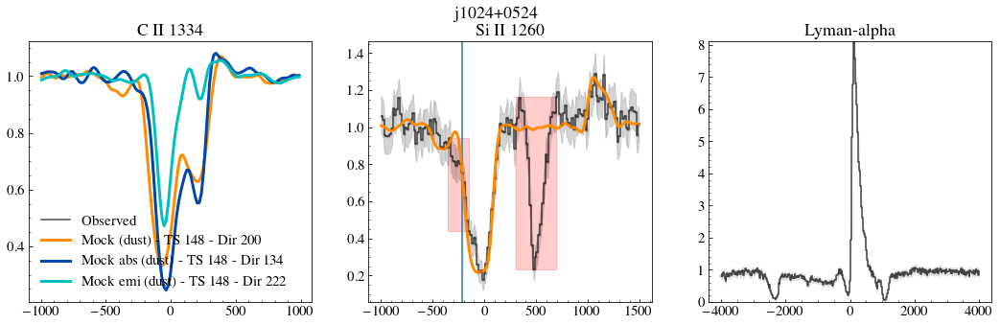

j1025+3622
0.0073053


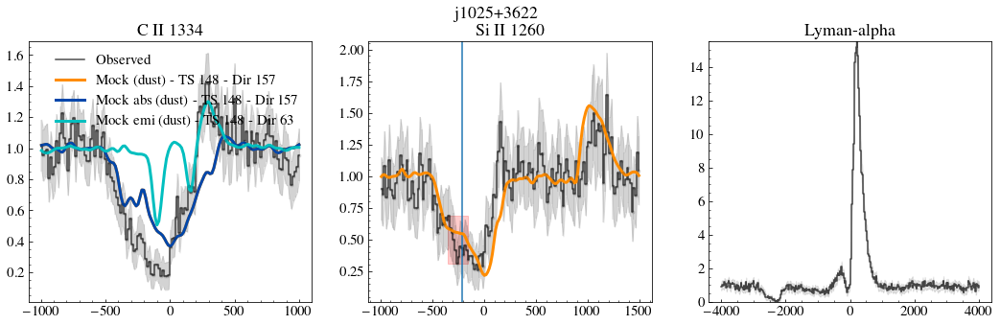

j1044+0353
0.01657


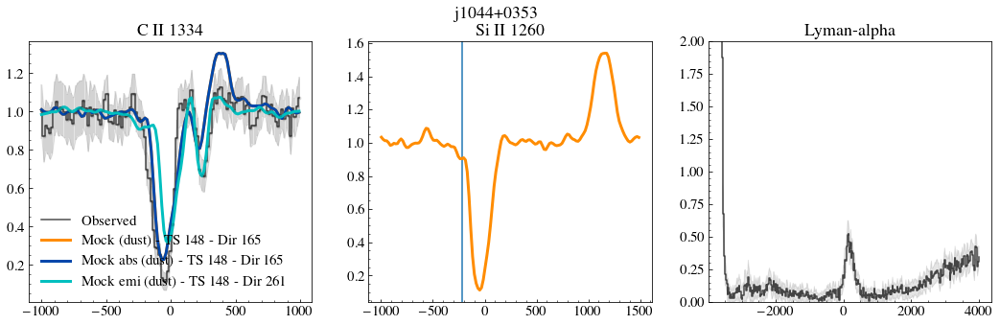

j1105+4444
0.0048301


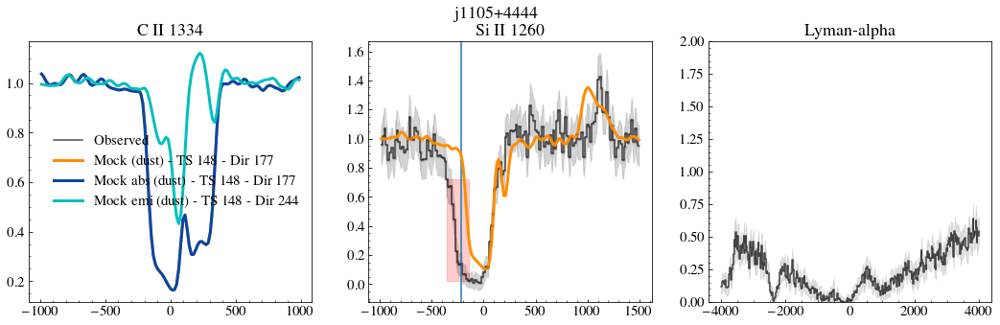

j1112+5503
0.0073053


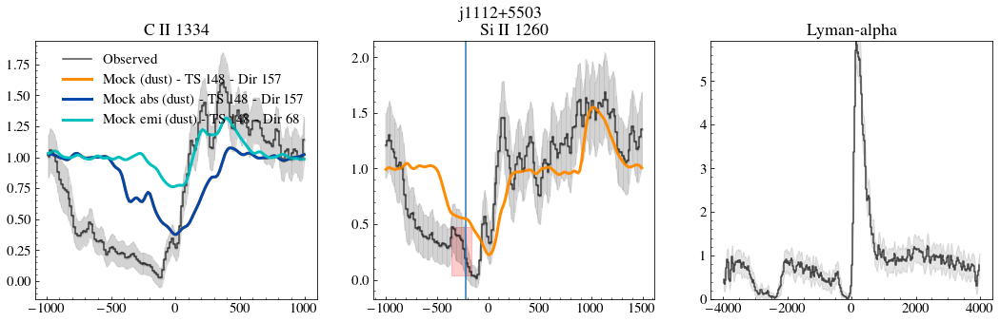

j1119+5130
0.018667


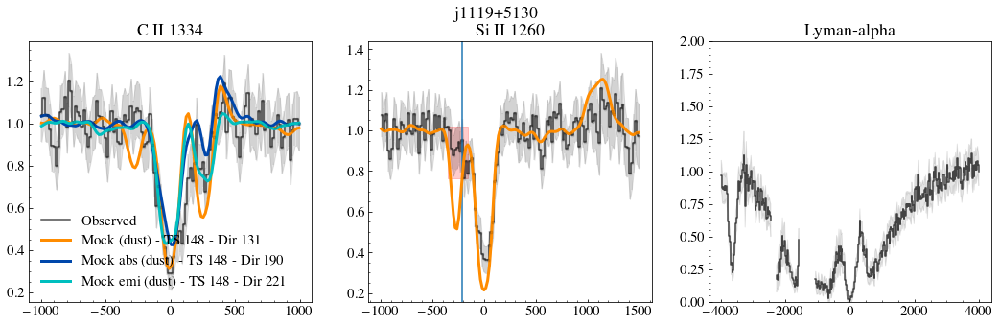

j1129+2034
0.0061836


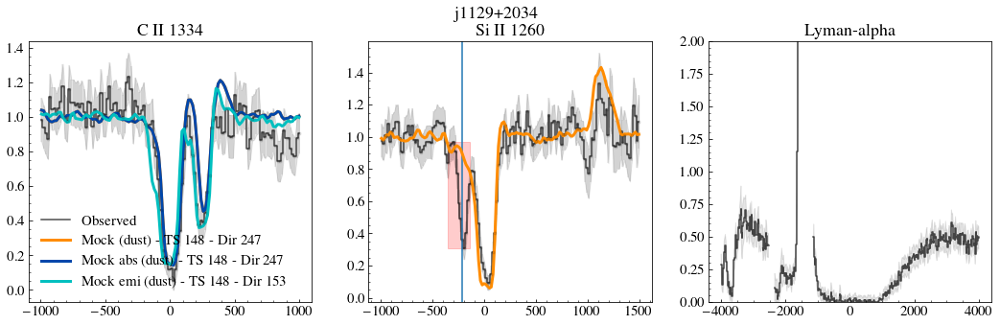

j1132+1411
0.0046574


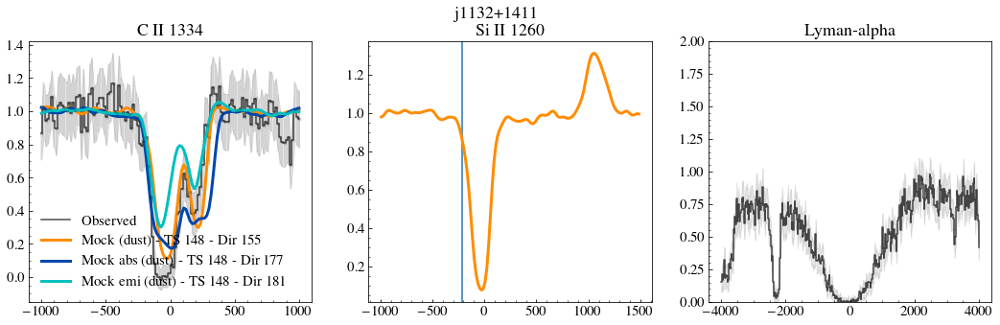

j1132+5722
0.040969


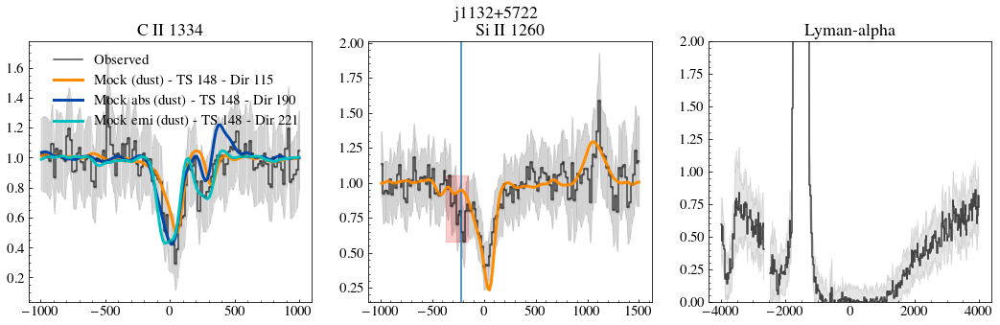

j1144+4012
0.0073053


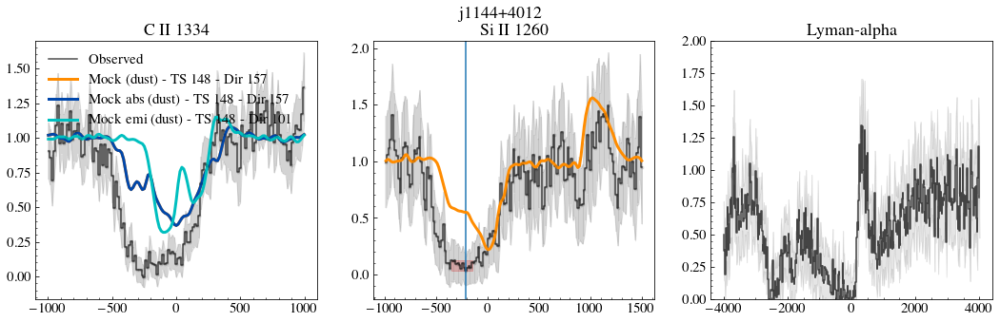

j1148+2546
0.0046574


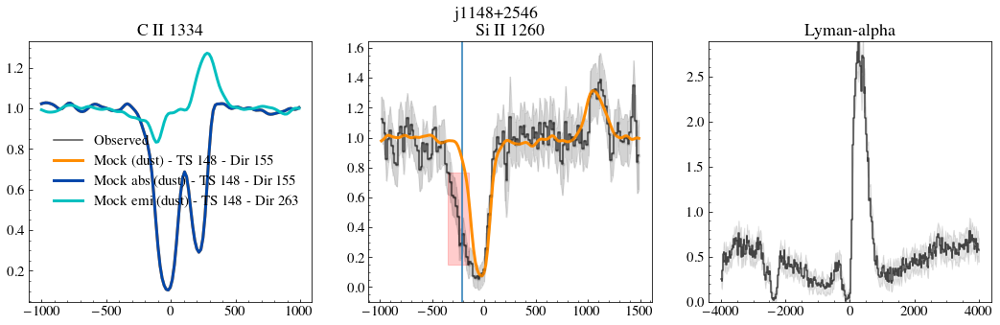

j1150+1501
0.0090701


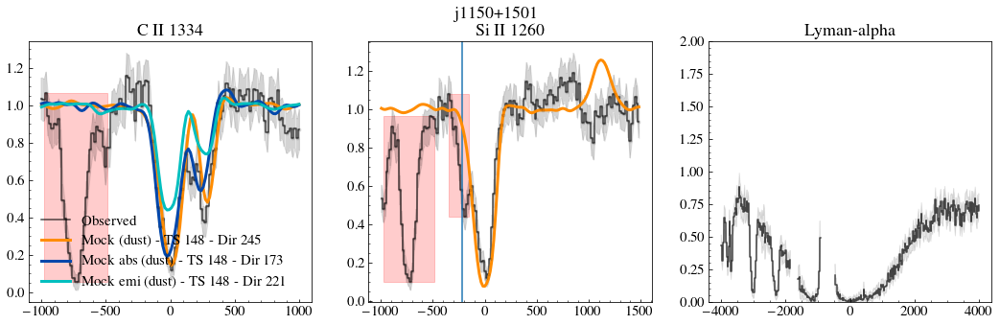

j1157+3220
0.0073053


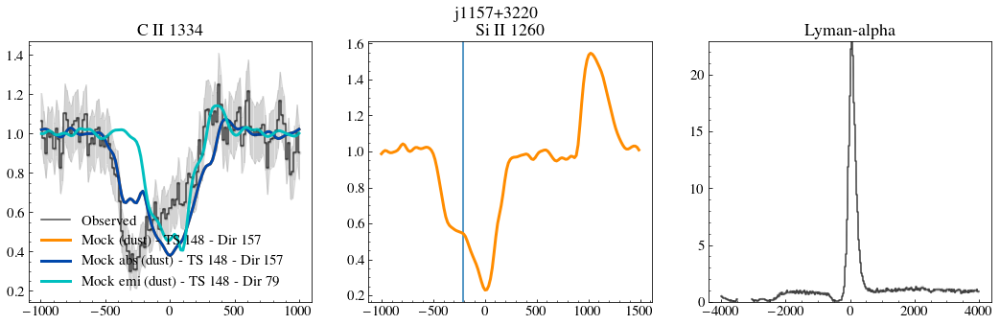

j1200+1343
0.010658


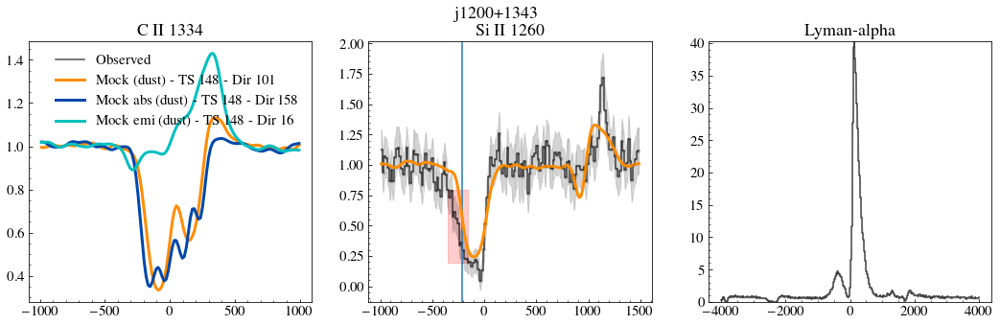

j1225+6109
0.0090701


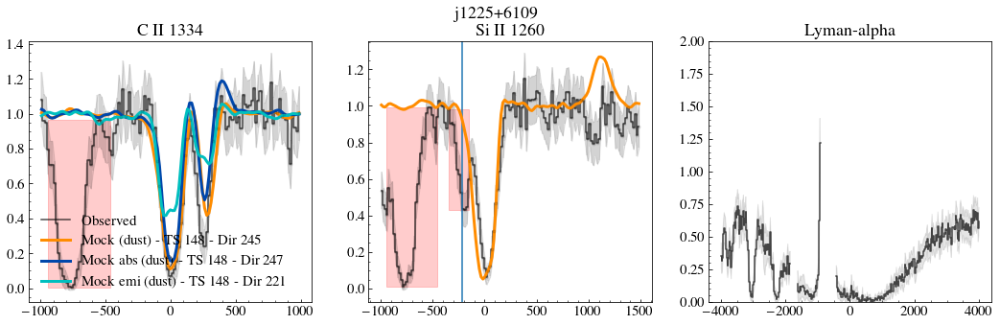

j1253-0312
0.038265


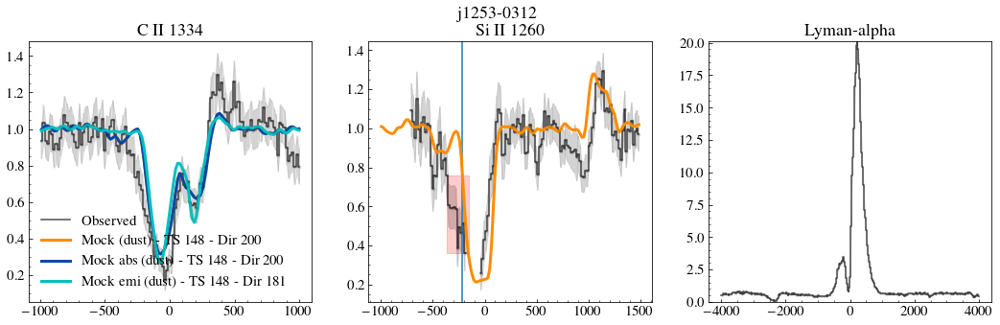

j1314+3452
0.0046574


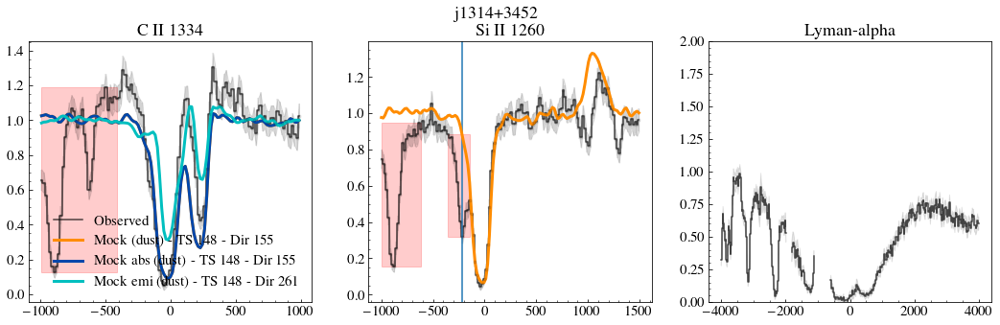

j1323-0132
0.3954


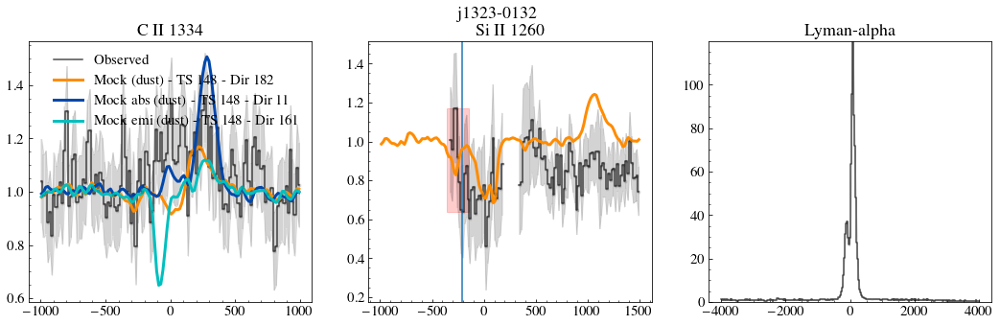

j1359+5726
0.0073053


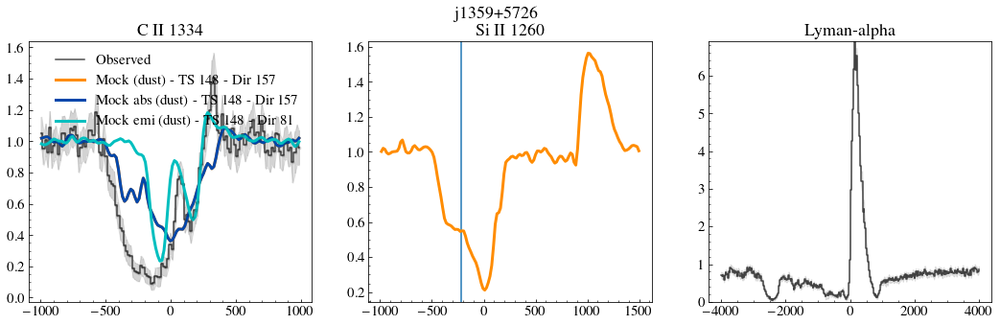

j1416+1223
0.0053544


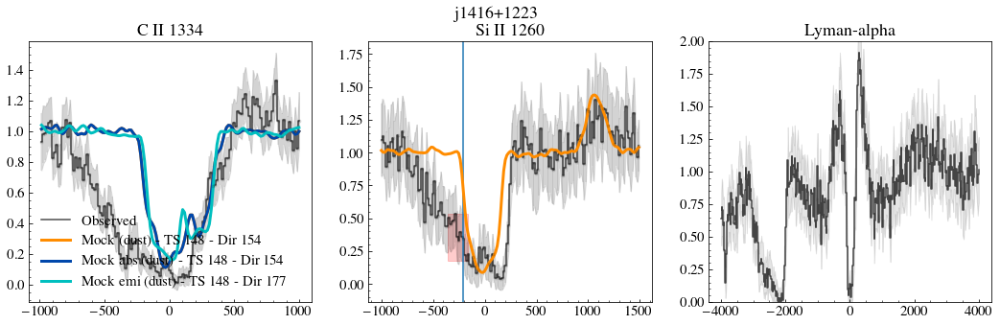

j1418+2102
0.018667


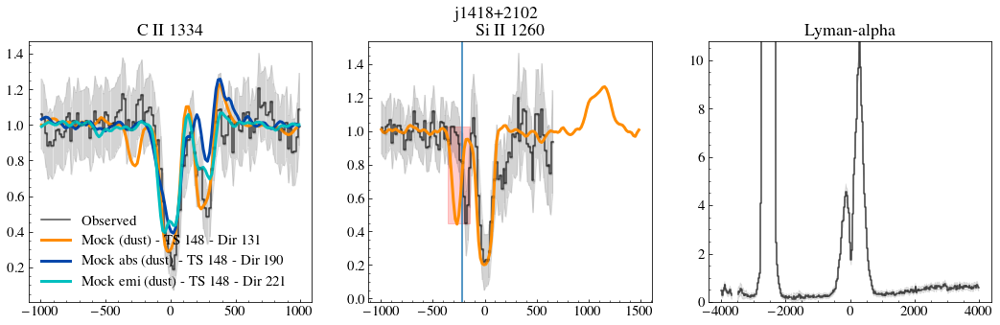

j1428+1653
0.025162


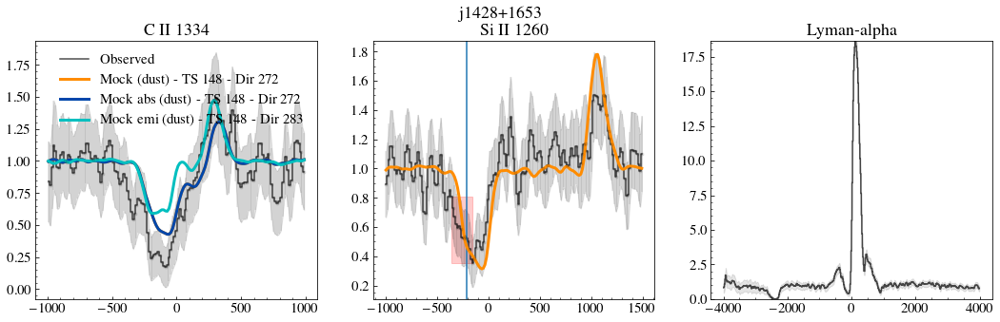

j1429+0643
0.0073053


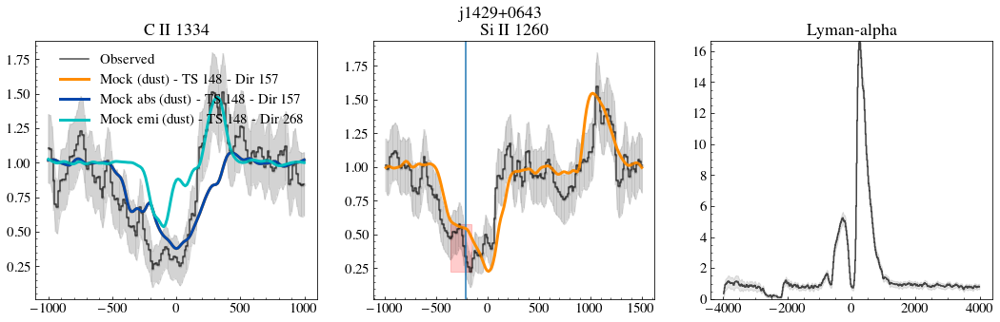

j1444+4237
0.17645


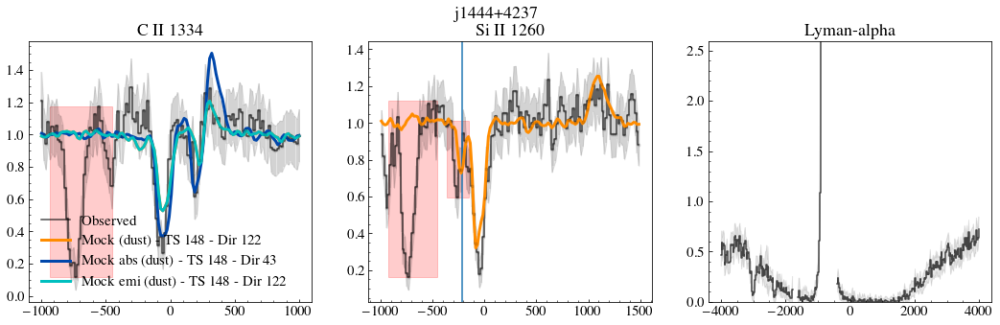

j1448-0110
0.0090701


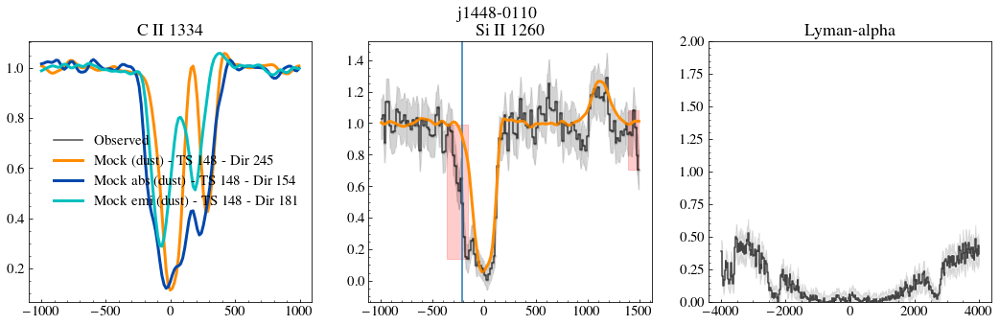

j1521+0759
0.0073053


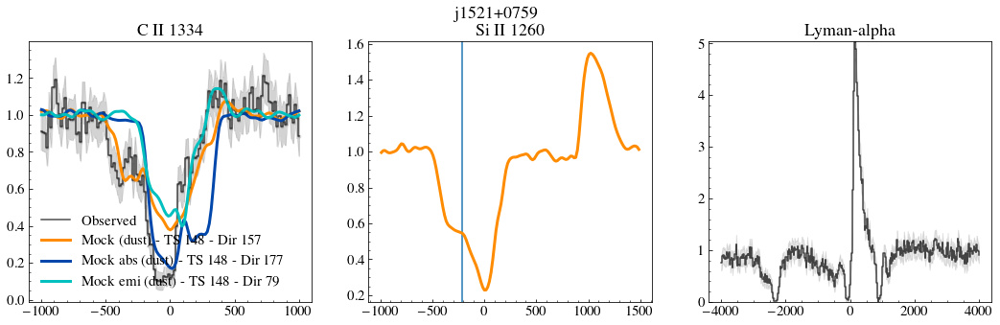

j1525+0757
0.0073053


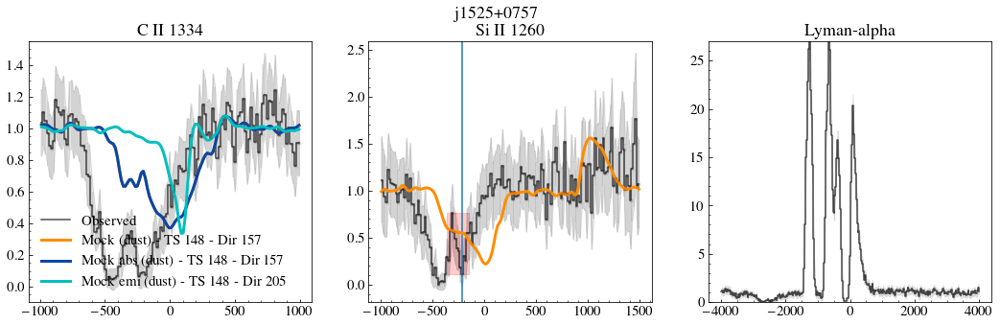

j1545+0858
0.0072743


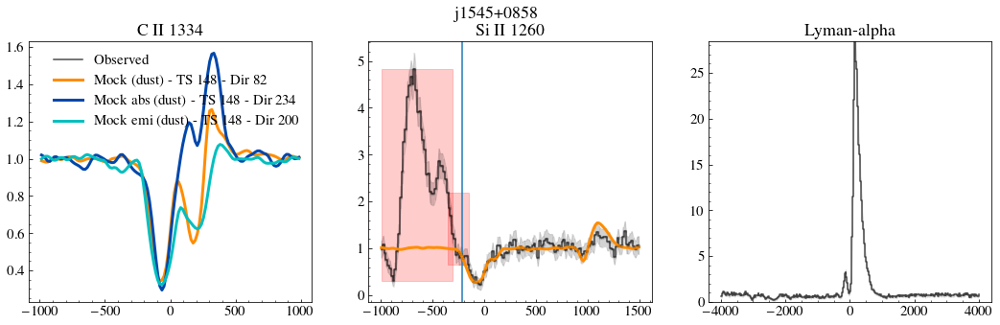

j1612+0817
0.0073053


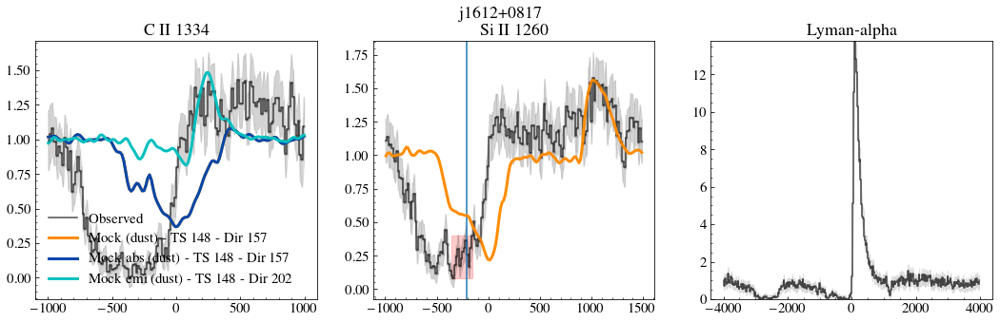

In [495]:
nGal = len(galaxy)
nmocks         = 5
Chi2all        = np.zeros((45, nmocks)) + 1e10
Chi2allabs     = np.zeros((45, nmocks)) + 1e10
Chi2allemi     = np.zeros((45, nmocks)) + 1e10
Chi2siII       = np.zeros((45, nmocks)) + 1e10
Chi2siIIabs    = np.zeros((45, nmocks)) + 1e10
Chi2siIIemi    = np.zeros((45, nmocks)) + 1e10
Chi2cII        = np.zeros((45, nmocks)) + 1e10
Chi2cIIabs     = np.zeros((45, nmocks)) + 1e10
Chi2cIIemi     = np.zeros((45, nmocks)) + 1e10

dirall         = np.zeros((45, nmocks)) - 1
dirallabs      = np.zeros((45, nmocks)) - 1
dirallemi      = np.zeros((45, nmocks)) - 1
dirsiII        = np.zeros((45, nmocks)) - 1
dirsiIIabs     = np.zeros((45, nmocks)) - 1
dirsiIIemi     = np.zeros((45, nmocks)) - 1
dircII         = np.zeros((45, nmocks)) - 1
dircIIabs      = np.zeros((45, nmocks)) - 1
dircIIemi      = np.zeros((45, nmocks)) - 1

outall         = np.zeros((45, nmocks)) - 1
outallabs      = np.zeros((45, nmocks)) - 1
outallemi      = np.zeros((45, nmocks)) - 1
outsiII        = np.zeros((45, nmocks)) - 1
outsiIIabs     = np.zeros((45, nmocks)) - 1
outsiIIemi     = np.zeros((45, nmocks)) - 1
outcII         = np.zeros((45, nmocks)) - 1
outcIIabs      = np.zeros((45, nmocks)) - 1
outcIIemi      = np.zeros((45, nmocks)) - 1

for i in range(nGal):
    print(label[i])

    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    #fit = gaussian_filter(data['fit'], sigma = 10)
    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

#    absflux = gaussian_filter(data['flux']/data['fit'],sigma = 1)
#     if(i == 4):
#         absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
    #absflux /= np.median(absflux[cutSiIIall])
    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    maskLya  = mask[cutLyaall]
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 500)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])

    if(i == 1):      
        fmedCII /=1.05
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    if(i == 0):
        fmedSiII *=1.15
    fsiII /= fmedSiII
    
    fig, axs = plt.subplots(1,3,figsize=(18,5))
    #/np.nanmedian(flux[cutCIIall])
    axs[0].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[0].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[0].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
   
    
    axs[1].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[1].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]), 
                        np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')  
    axs[1].axvline(-214)
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  

#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[1].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')

    axs[2].plot(vLyad[cutLyaall], flux[cutLyaall],  c='k',alpha = 0.7,drawstyle='steps-mid' )
    axs[2].fill_between(vLyad[cutLyaall],flux[cutLyaall]-err[cutLyaall],flux[cutLyaall]+err[cutLyaall],
                        color = 'k', alpha = 0.1)
#     if(len(flux[cutLyaall][~maskLya])>0):
#         axs[2].fill_between(vLyad[cutLyaall][~maskLya], np.nanmin(flux[cutLyaall][~maskLya]), 
#                         np.nanmax(flux[cutLyaall][~maskLya]), alpha=0.2, color= 'r')  
    axs[2].set_title('Lyman-alpha')
    axs[2].set_ylim(0, np.max([2,np.nanmax(flux[abs(vLyad) < 1000])]))
  

    path_to_data = './CII_SiII_ND/'   # To change if you move the data

    v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)
    bestfluxsiall = []
    bestfluxciiall = []
    bestfluxsiabs = []
    bestfluxciiabs = []
    bestfluxsiemi = []
    bestfluxciiemi = []
    for output in range(148,149,1):
    
        lcII,  fluxcII  = read_spectrum_c(path_to_data,output) 
        lsiII, fluxsiII = read_spectrum_si(path_to_data,output) 
        
        for idir in range(300):
            lcII_systemic = lcII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lcII) 
            lcII_systemic = lcII_systemic[1:]
            vcII_s    = (lcII_systemic/wcII1334 -1)*c

            lsiII_systemic = lsiII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lsiII) 
            lsiII_systemic = lsiII_systemic[1:]
            vsiII_s  = (lsiII_systemic/wsiII1260 -1)*c

            sigma_pixelcII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vcII_s[50] - vcII_s[49]))
            sigma_pixelsiII = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vsiII_s[50]- vsiII_s[49]))

            modelcII    = gaussian_filter(fluxcII[idir,1:], sigma = sigma_pixelcII)
            f           = interpolate.interp1d(vcII_s, modelcII)
            modelNewcII = f(vcII)

            modelsiII   = gaussian_filter(fluxsiII[idir,1:], sigma = sigma_pixelsiII)
            f           = interpolate.interp1d(vsiII_s, modelsiII)
            modelNewsiII= f(vsiII)

#             alpha = np.nansum((modelNewcII[maskCII]*fcII[maskCII]/(ecII[maskCII]**2)))/ \
#                     np.nansum(modelNewcII[maskCII]**2/ecII[maskCII]**2)
#             modelNewcII *= alpha
            
#             alpha = np.nansum((modelNewsiII[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsiII[maskSiII]**2/esiII[maskSiII]**2)
# #             print(alpha)
#             modelNewsiII *= alpha
            
            rmedCII = ((vcII<-500) | (vcII > 700)) 
            fmedCII = np.nanmedian(modelNewcII[rmedCII])
            modelNewcII /= fmedCII

            rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
            fmedSiII = np.nanmedian(modelNewsiII[rmedSiII])
            modelNewsiII /= fmedSiII
            
            maskCII = maskCII & (abs(vcII <550))
            maskSiII = maskSiII & (vsiII > - 550) & (~((vsiII >-364) & (vsiII <-144)))

            lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcII[maskCII])**2)/ecII[maskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsiII[maskSiII])**2)/esiII[maskSiII]**2)
#             print(lnlikesiII)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cII[i][0] :
                Chi2cII[i][0] = lnlikecII
                dircII[i][0]  = idir
                outcII[i][0]  = output
            
            if lnlikesiII < Chi2siII[i][0] :
                Chi2siII[i][0] = lnlikesiII
                dirsiII[i][0]  = idir
                outsiII[i][0]  = output
                
            if(lnlikeall < Chi2all[i][0]):
                dirall[i][0] = idir
                Chi2all[i][0] = lnlikeall
                outall[i][0] = output
                bestfluxsiall = modelNewsiII
                bestfluxciiall = modelNewcII
                
            absMaskCII = (vcII > -600) & (vcII < 200) & maskCII
            absMaskSiII =  (vsiII > -600) & (vsiII < 200) & maskSiII
            lnlikecII  =  0.5*np.nansum(((fcII[absMaskCII]-modelNewcII[absMaskCII])**2)/ecII[absMaskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[absMaskSiII] - modelNewsiII[absMaskSiII])**2)/esiII[absMaskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cIIabs[i][0] :
                Chi2cIIabs[i][0] = lnlikecII
                dircIIabs[i][0]  = idir
                outcIIabs[i][0]  = output
            
            if lnlikesiII < Chi2siIIabs[i][0] :
                Chi2siIIabs[i][0] = lnlikesiII
                dirsiIIabs[i][0]  = idir
                outsiIIabs[i][0]  = output
                
            if(lnlikeall < Chi2allabs[i][0]):
                dirallabs[i][0] = idir
                Chi2allabs[i][0] = lnlikeall
                outallabs[i][0] = output
                bestfluxsiabs = modelNewsiII
                bestfluxciiabs = modelNewcII
                
            emiMaskCII = (vcII > 150 ) & maskCII & (vcII <700)
            emiMaskSiII = (vsiII > 700) & maskSiII & (vsiII <1500)
            lnlikecII  =  0.5*np.nansum(((fcII[emiMaskCII]-modelNewcII[emiMaskCII])**2)/ecII[emiMaskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[emiMaskSiII] - modelNewsiII[emiMaskSiII])**2)/esiII[emiMaskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cIIemi[i][0] :
                Chi2cIIemi[i][0] = lnlikecII
                dircIIemi[i][0]  = idir
                outcIIemi[i][0]  = output
            
            if lnlikesiII < Chi2siIIemi[i][0] :
                Chi2siIIemi[i][0] = lnlikesiII
                dirsiIIemi[i][0]  = idir
                outsiIIemi[i][0]  = output
                
            if(lnlikeall < Chi2allemi[i][0]):
#                 print(lnlikeall,lnlikecII,lnlikesiII)
                dirallemi[i][0] = idir
                Chi2allemi[i][0] = lnlikeall
                outallemi[i][0] = output
                bestfluxsiemi = modelNewsiII
                bestfluxciiemi = modelNewcII
        
    # l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
#     lcII, fluxcII   = read_spectrum_c(path_to_data,int(outall[i][0]) )
#     lsiII, fluxsiII = read_spectrum_si(path_to_data,int(outall[i][0]) )
#     print(Chi2all[i][0])
#     lcII_systemic  = lcII + np.dot(directions[int(dirall[i][0]),:],v_cm[:,int(outall[i][0])-90])/c_cgs*1e5*np.mean(lcII) 
#     lcII_systemic  = lcII_systemic[1:]
#     vcII_s         = (lcII_systemic/wcII1334 -1)*c
#     sigma_pixelcii = res[i] /2.355 / ((vcII_s[50]-vcII_s[49]))
#     model          = gaussian_filter(fluxcII[int(dirall[i][0]),1:], sigma = sigma_pixelcii)
#     f              =  interpolate.interp1d(vcII_s, model)
#     modelNewcii    = f(vcII)
#     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
#                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
#     modelNewcii    *= alpha
#     axs[0].plot(vcII, modelNewcii, label = 'Best mock (FS) - TS %d - Dir %d'%(outall[i][0], dirall[i][0]), c =cnoFS, lw = 3)

    
#     lsiII_systemic = lsiII + np.dot(directions[int(dirall[i][0]),:],v_cm[:,int(outall[i][0])-90])/c_cgs*1e5*np.mean(lsiII) 
#     lsiII_systemic = lsiII_systemic[1:]
#     vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
#     sigma_pixelsi  = res[i] /2.355/ ((vsiII_s[50]-vsiII_s[49]))
#     model          = gaussian_filter(fluxsiII[int(dirall[i][0]),1:], sigma = sigma_pixelsi)
#     f              = interpolate.interp1d(vsiII_s, model)
#     modelNewsi     = f(vsiII)
#     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
#     modelNewsi   *= alpha
#     axs[1].plot(vsiII, modelNewsi, c =cnoFS, lw = 3)
#     lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
#     lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
#     lnlikeall  = lnlikecII + lnlikesiII
#     print('FS: ',lnlikecII, lnlikesiII, lnlikeall )
    axs[0].plot(vcII, bestfluxciiall,
                label = 'Mock (dust) - TS %d - Dir %d'%(outall[i][0], dirall[i][0]), c =cnoFS, lw = 3)
    axs[0].plot(vcII, bestfluxciiabs, 
                label = 'Mock abs (dust) - TS %d - Dir %d'%(outallabs[i][0], dirallabs[i][0]), c =cFS, lw = 3)
    axs[0].plot(vcII, bestfluxciiemi, 
                label = 'Mock emi (dust) - TS %d - Dir %d'%(outallemi[i][0], dirallemi[i][0]), c ='c', lw = 3)
    print(fesc[148-90,int(dirall[i][0])])
    
    axs[1].plot(vsiII, bestfluxsiall, c =cnoFS, lw = 3)
#     axs[1].plot(vsiII, bestfluxsiabs, c =cFS, lw = 3)
#     axs[1].plot(vsiII, bestfluxsiemi, c ='c', lw = 3)
    axs[0].legend(frameon=False)
    plt.suptitle(label[i])
#     plt.show()
    plt.savefig('Plots/'+galaxy[i]+'matchdust.pdf', bbox_inches = 'tight')
    plt.show()

In [34]:
df = pd.DataFrame(np.vstack((galaxy, 
                             outall[:,0].astype(int), dirall[:,0].astype(int), Chi2all[:,0],
                             outsiII[:,0].astype(int), dirsiII[:,0].astype(int), Chi2siII[:,0],
                             outcII[:,0].astype(int), dircII[:,0].astype(int), Chi2cII[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("csv/Classy_dust_fit.csv", sep=',', header= C, index=False) 


df = pd.DataFrame(np.vstack((galaxy, 
                             outallabs[:,0].astype(int), dirallabs[:,0].astype(int), Chi2allabs[:,0],
                             outsiIIabs[:,0].astype(int), dirsiIIabs[:,0].astype(int), Chi2siIIabs[:,0],
                             outcIIabs[:,0].astype(int), dircIIabs[:,0].astype(int), Chi2cIIabs[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("csv/Classy_dust_absfit.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

df = pd.DataFrame(np.vstack((galaxy, 
                             outallemi[:,0].astype(int), dirallemi[:,0].astype(int), Chi2allemi[:,0],
                             outsiIIemi[:,0].astype(int), dirsiIIemi[:,0].astype(int), Chi2siIIemi[:,0],
                             outcIIemi[:,0].astype(int), dircIIemi[:,0].astype(int), Chi2cIIemi[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("csv/Classy_dust_emifit.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

## 75 TS - depletion + vturb

j0021+0052
0.07625


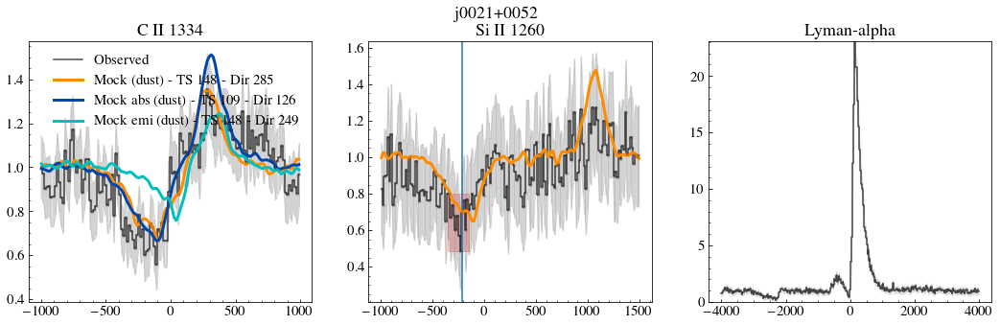

j0036-3333
0.11024


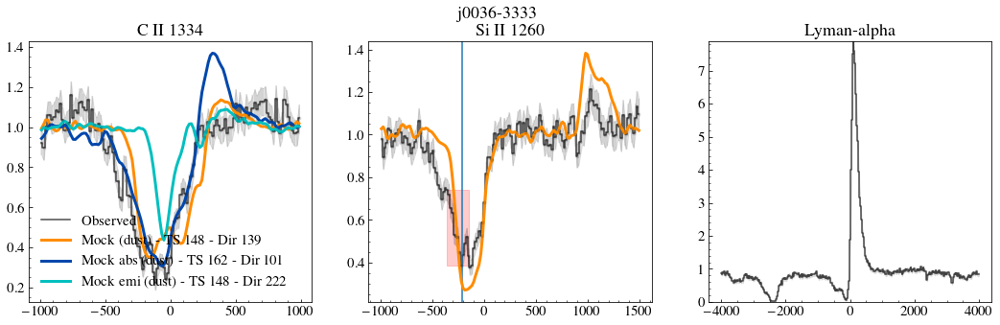

j0127-0619
0.0053353


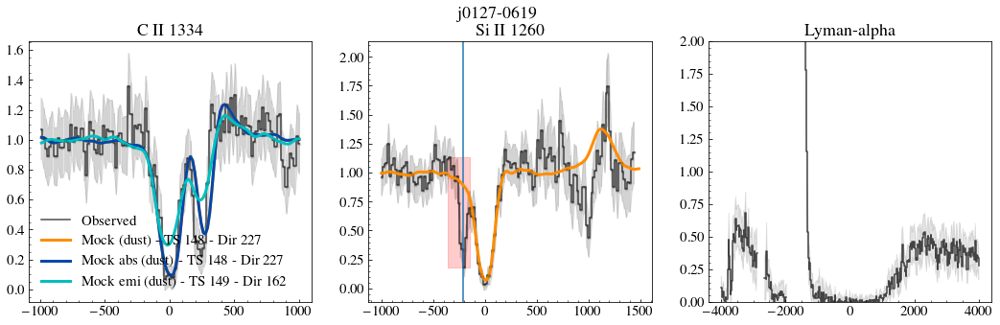

j0144+0453
0.0057313


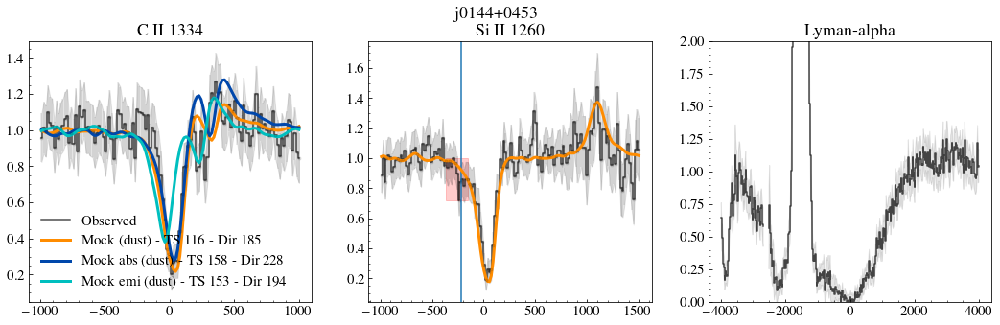

j0337-0502
0.004802


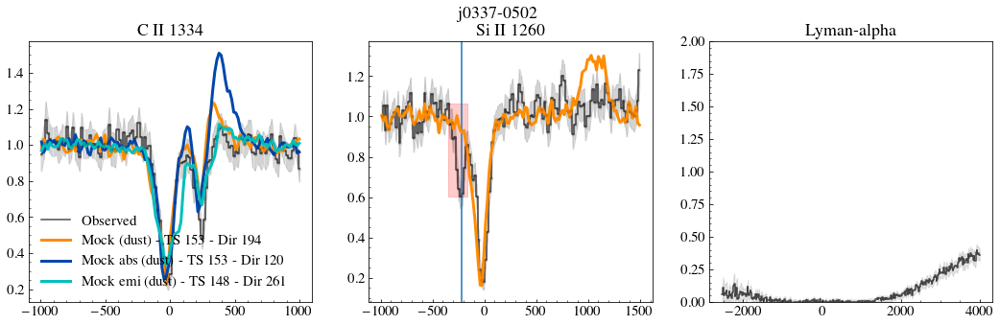

j0405-3648
0.17645


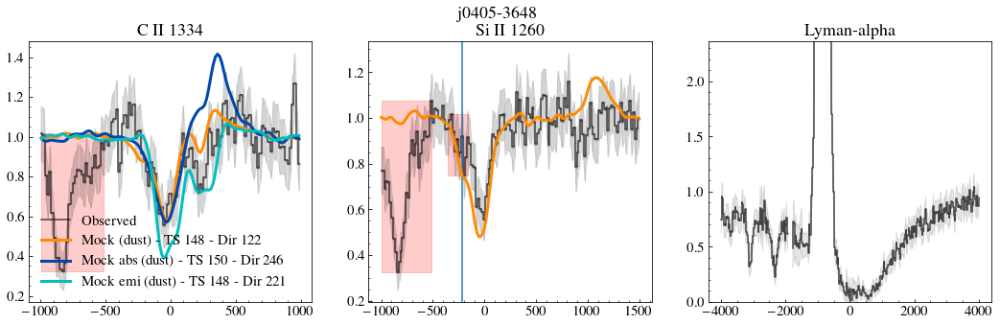

j0808+3948
0.4176


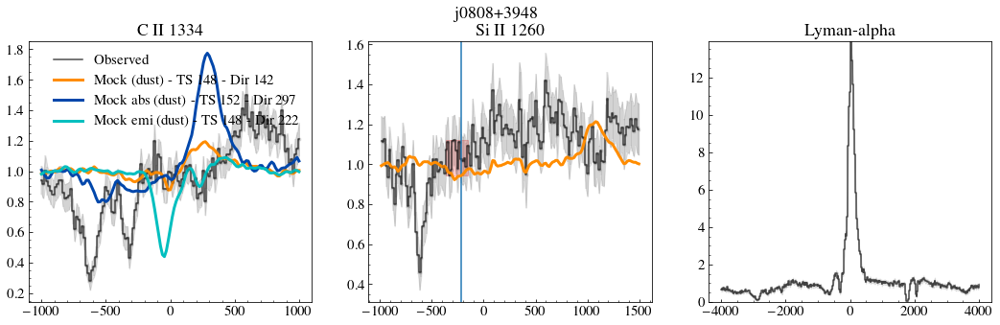

j0823+2806
0.047871


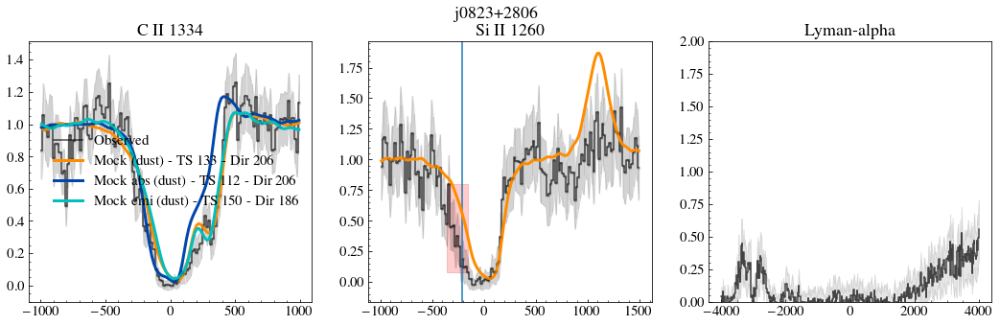

j0926+4427
0.17547


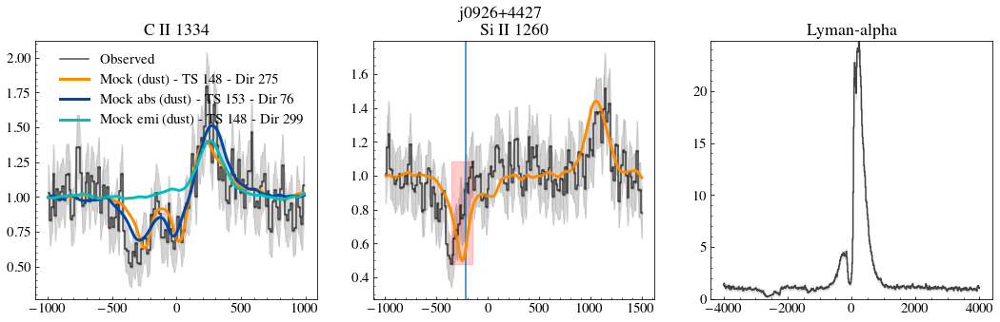

j0934+5514
0.022672


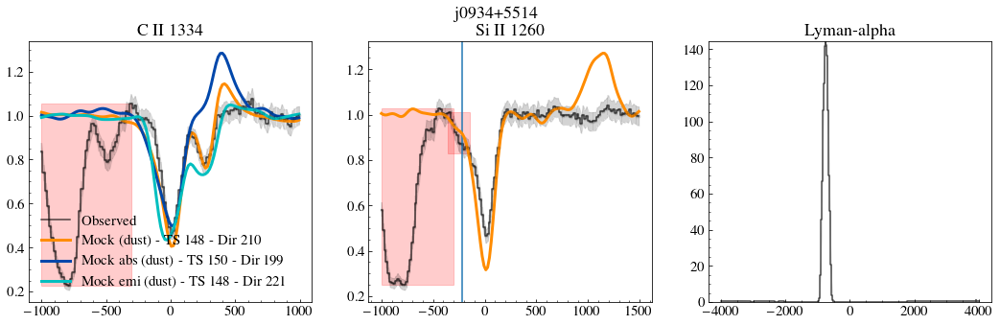

j0938+5428
0.067956


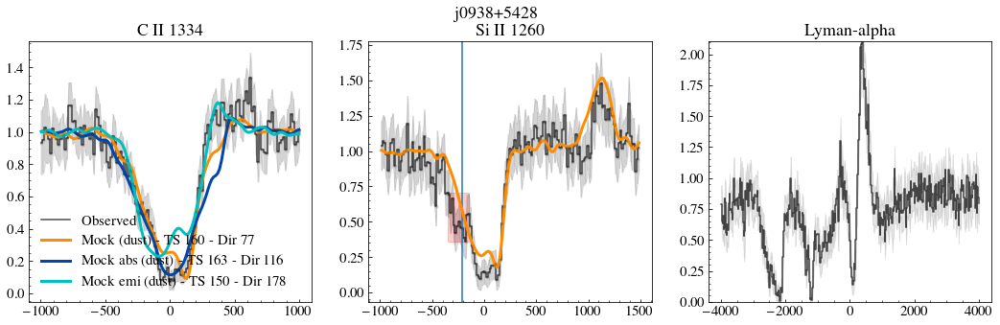

j0940+2935
0.18239


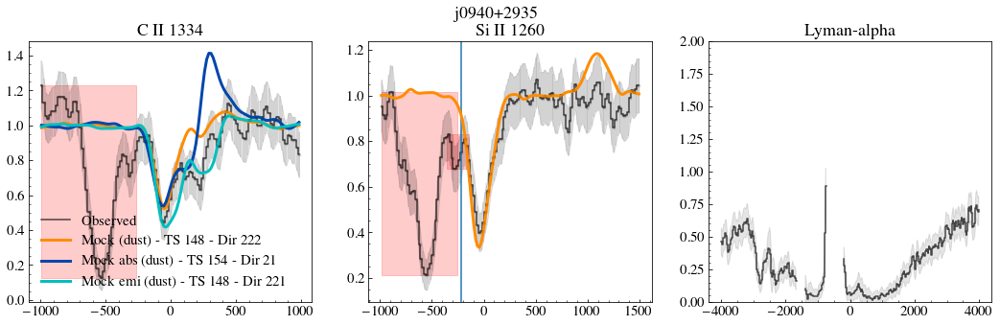

j0942+3547


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1170961266.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_2749329/1170961266.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')
/tmp/ipykernel_2749329/1170961266.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1170961266.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= '

0.17645


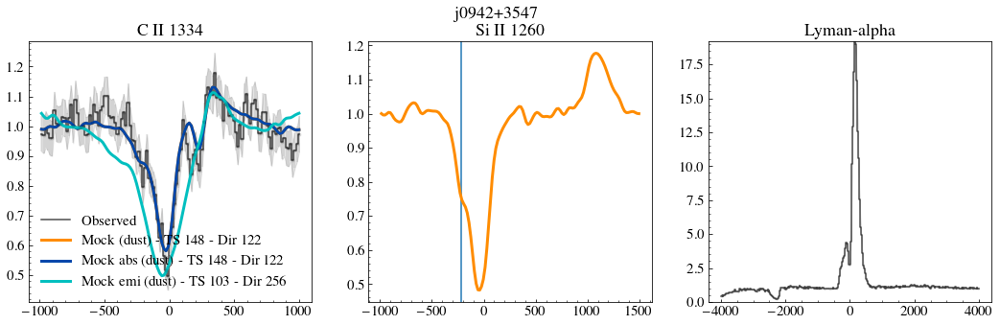

j0944-0038
0.047871


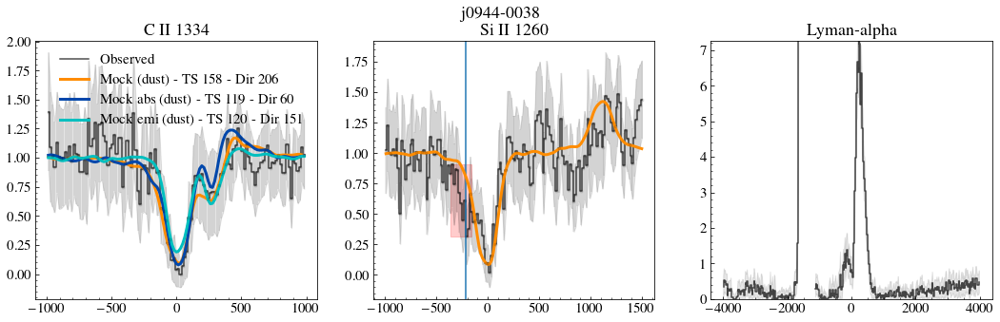

j0944+3442


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1170961266.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_2749329/1170961266.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')
/tmp/ipykernel_2749329/1170961266.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1170961266.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


0.0057305


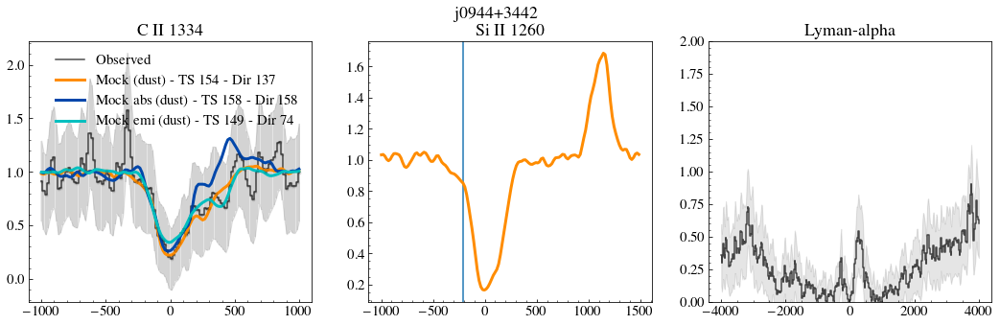

j1016+3754
0.09516


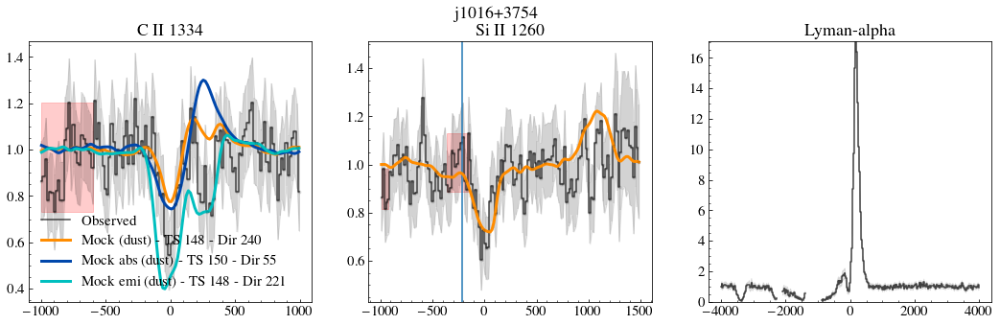

j1024+0524


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


0.062983


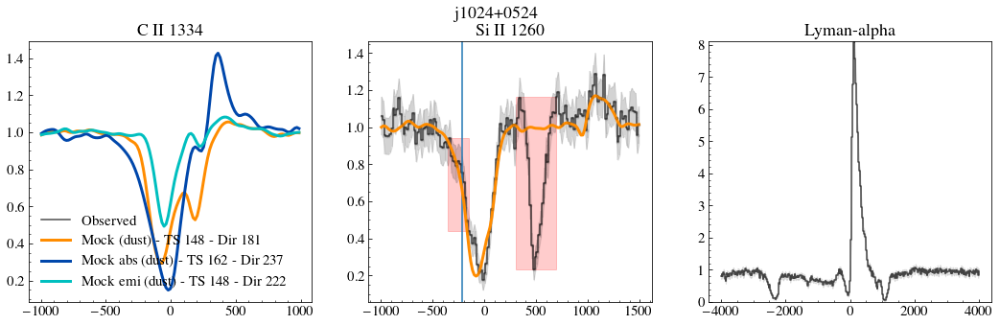

j1025+3622
0.012178


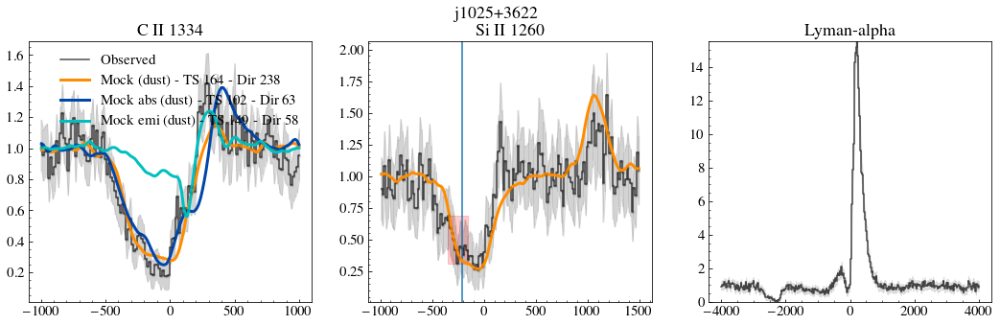

j1044+0353


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1170961266.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_2749329/1170961266.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')
/tmp/ipykernel_2749329/1170961266.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1170961266.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


0.0047252


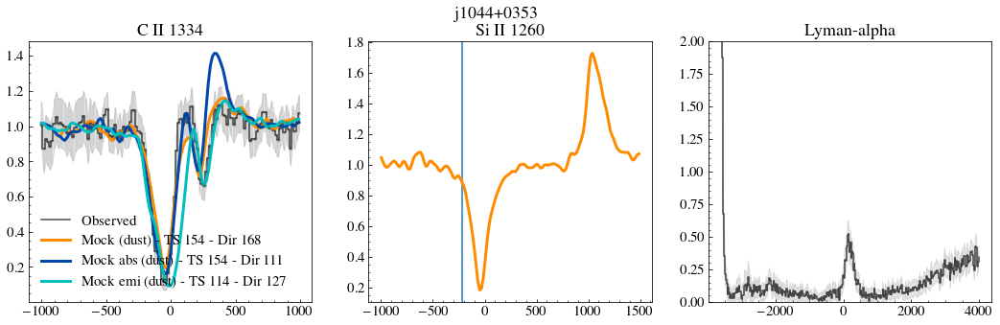

j1105+4444


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1170961266.py:87: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),


0.025148


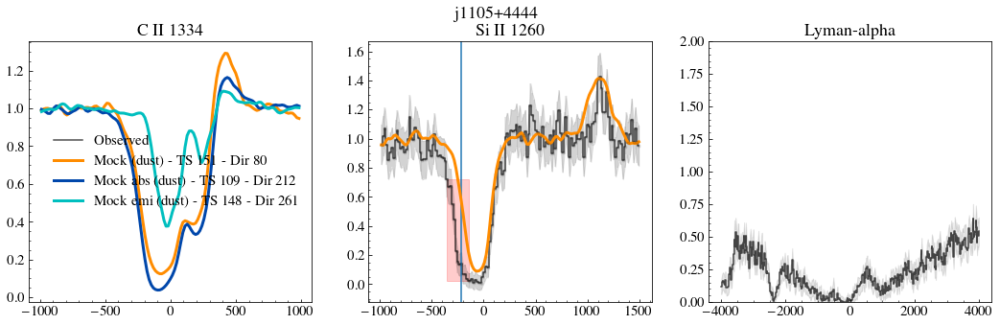

j1112+5503
0.0025696


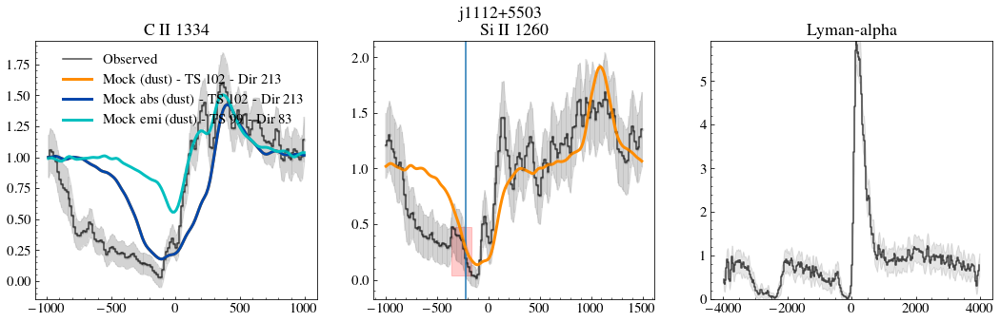

j1119+5130
0.022672


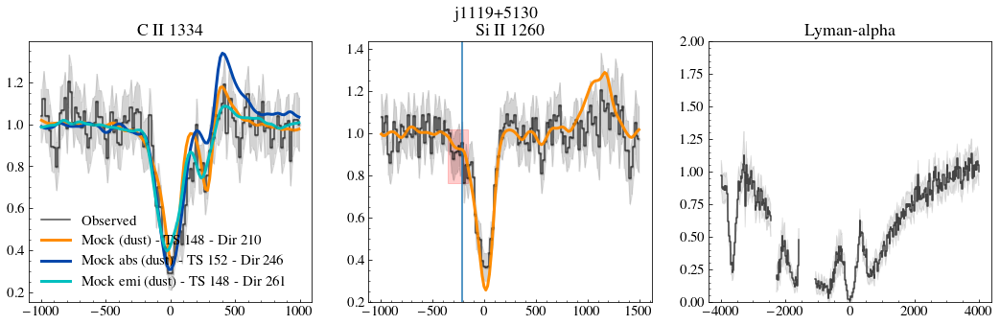

j1129+2034
0.0090701


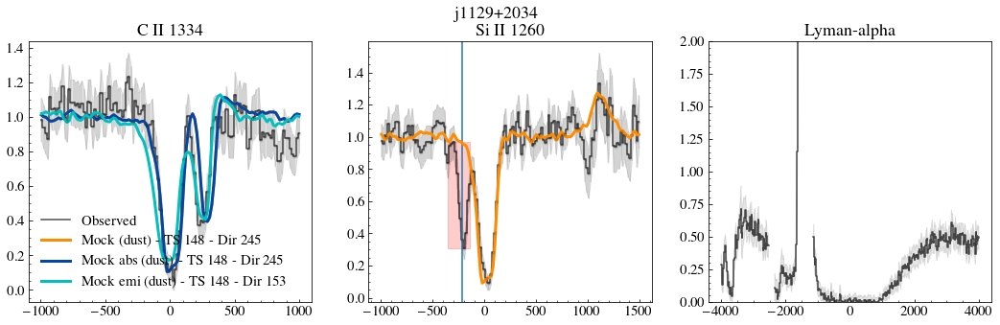

j1132+1411


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1170961266.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_2749329/1170961266.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')


0.0061661


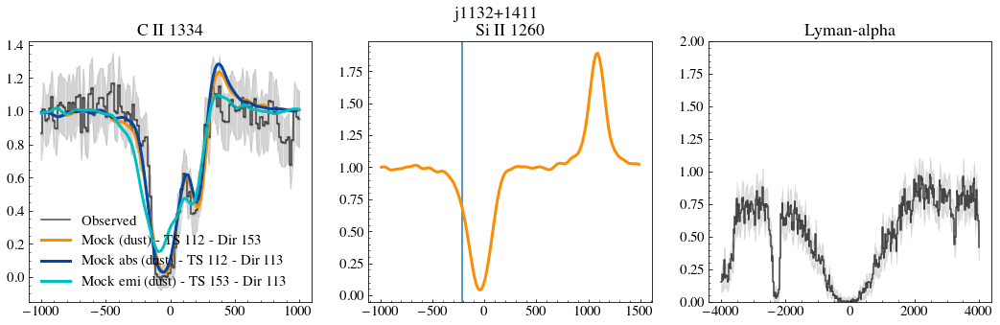

j1132+5722
0.022672


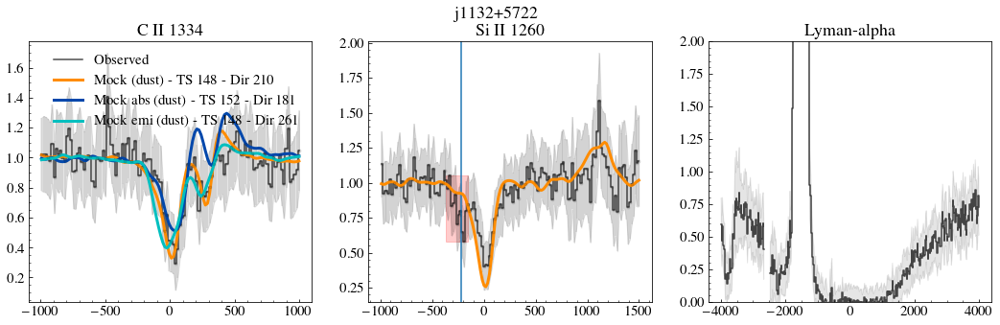

j1144+4012
0.0056445


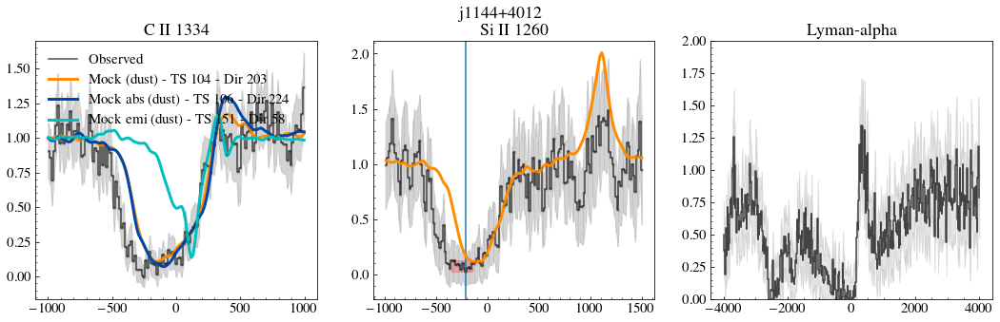

j1148+2546


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1170961266.py:87: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),


0.037308


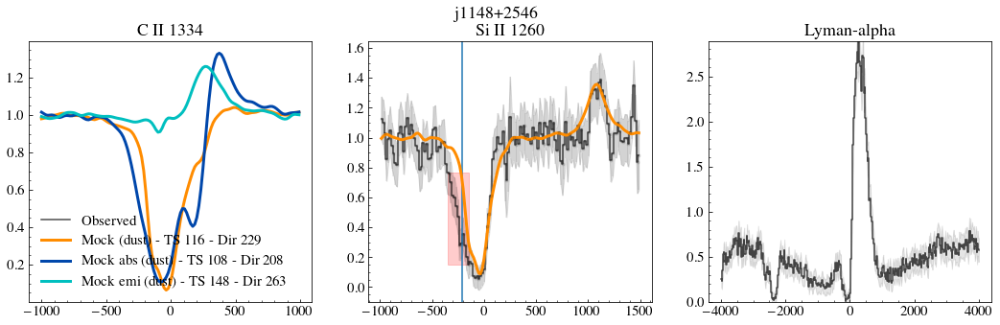

j1150+1501
0.013527


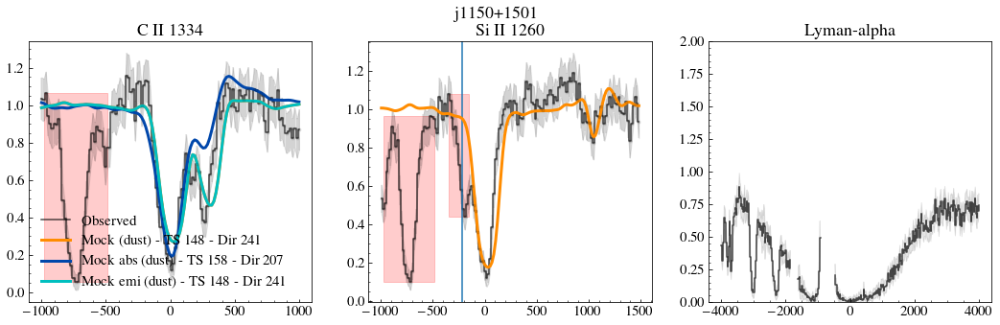

j1157+3220


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1170961266.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_2749329/1170961266.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')
/tmp/ipykernel_2749329/1170961266.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1170961266.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


0.13736


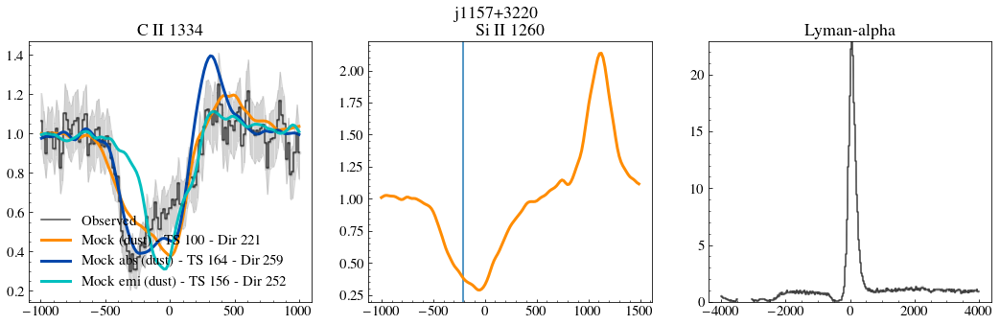

j1200+1343


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


0.046196


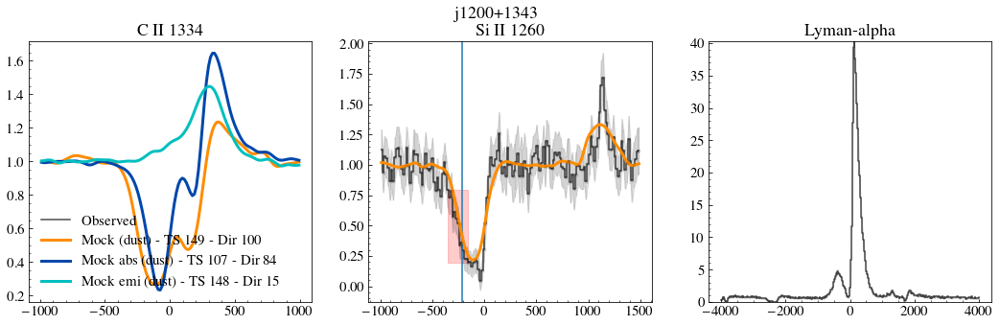

j1225+6109
0.013527


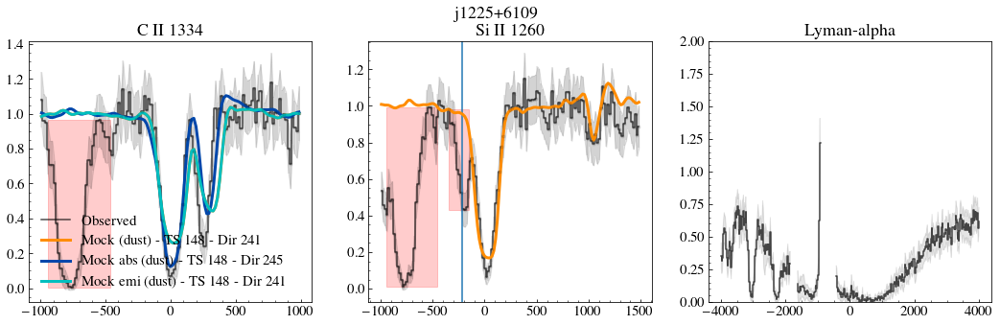

j1253-0312
0.062983


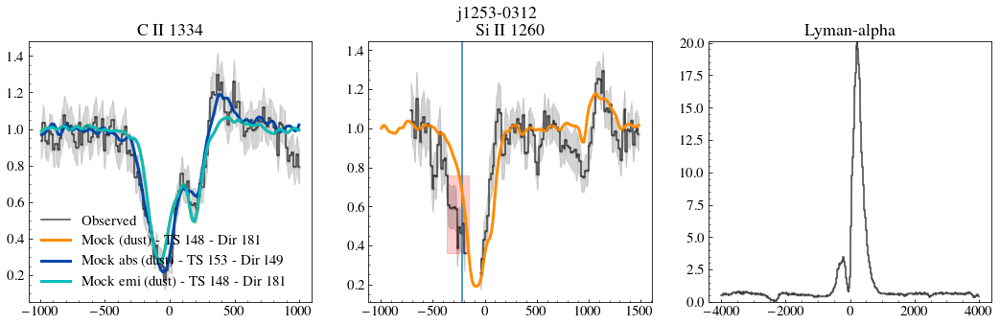

j1314+3452
0.01654


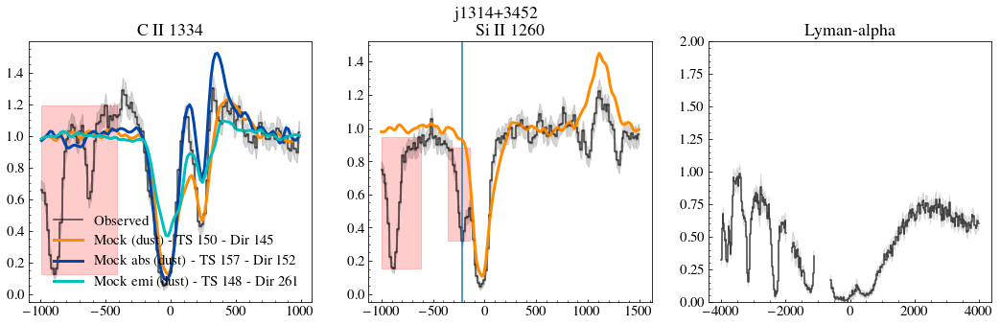

j1323-0132
0.3954


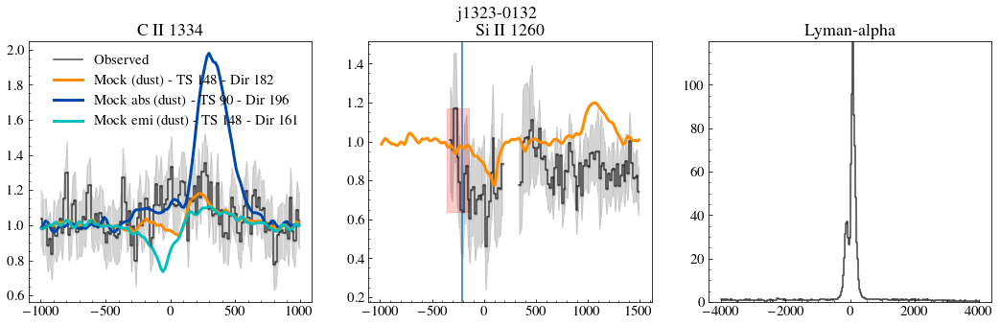

j1359+5726


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1170961266.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_2749329/1170961266.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')
/tmp/ipykernel_2749329/1170961266.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1170961266.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


0.0056445


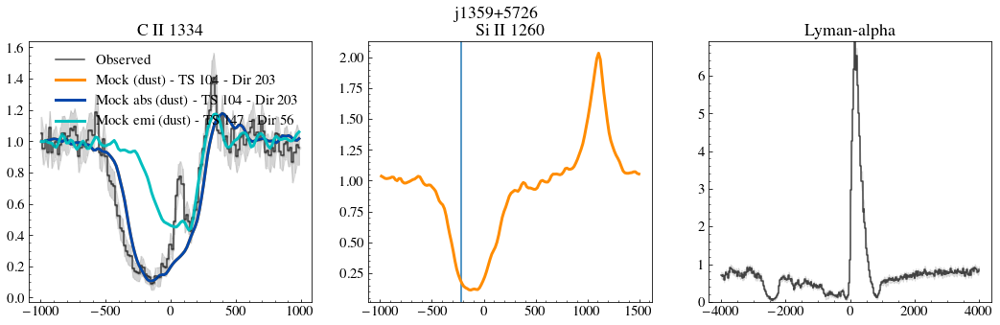

j1416+1223
0.095379


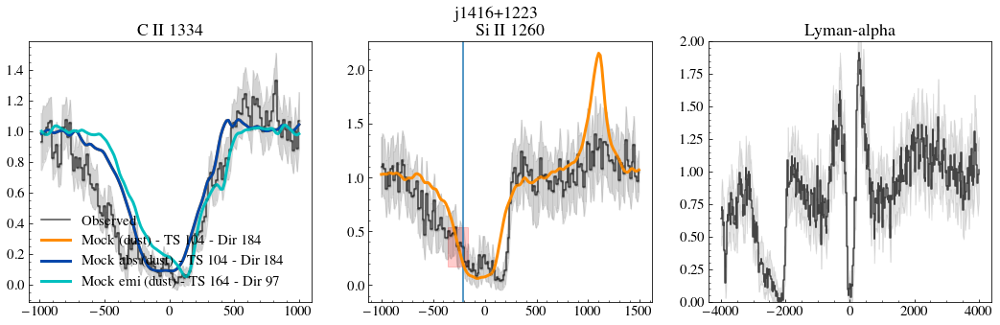

j1418+2102


/tmp/ipykernel_2749329/1170961266.py:99: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1170961266.py:100: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


0.022672


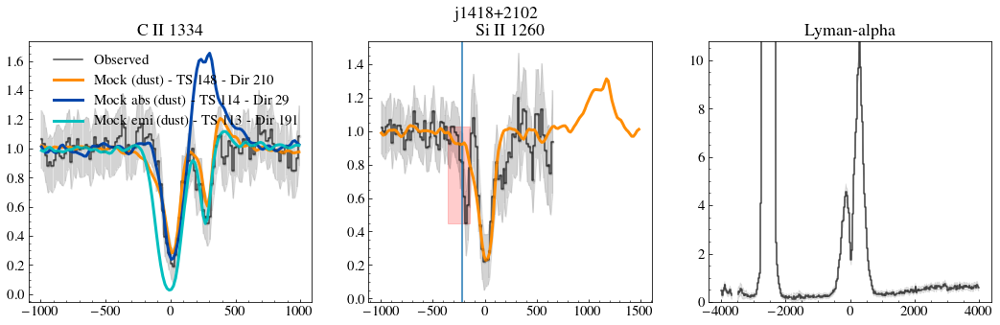

j1428+1653
0.0027176


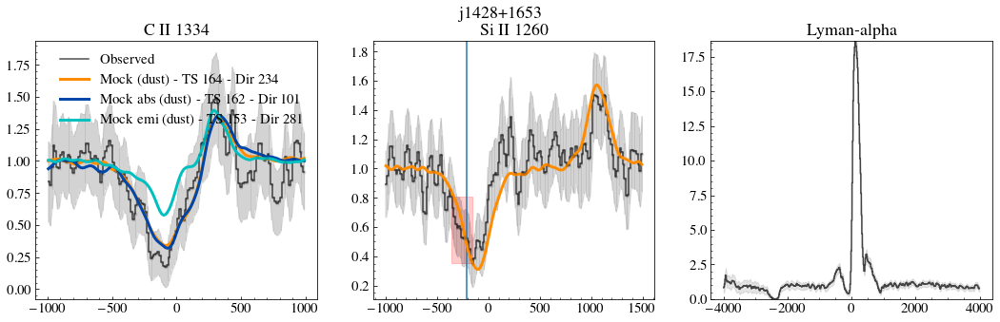

j1429+0643
0.2763


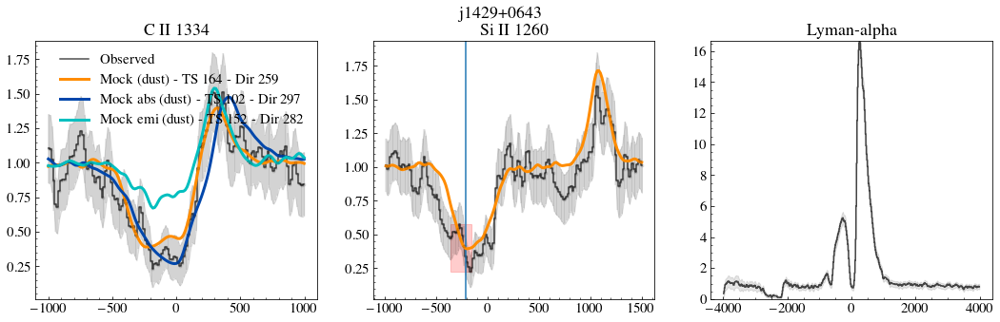

j1444+4237
0.18239


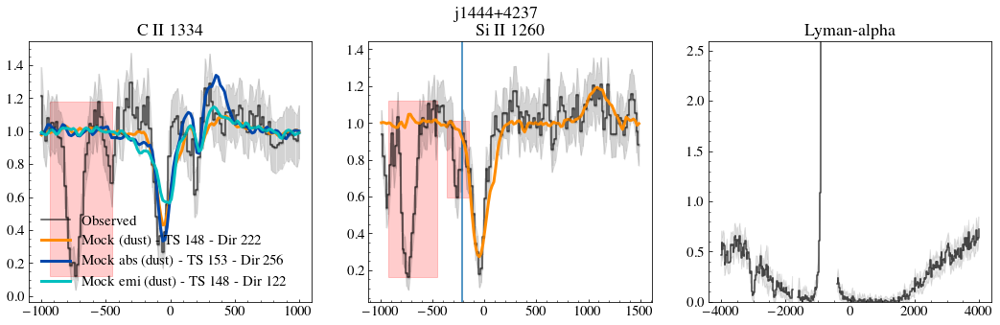

j1448-0110


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


0.0051598


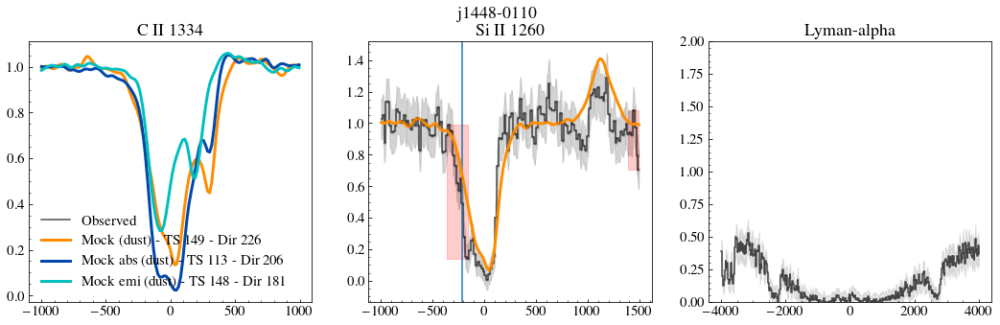

j1521+0759


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1170961266.py:95: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]),
/tmp/ipykernel_2749329/1170961266.py:96: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')


0.0051378


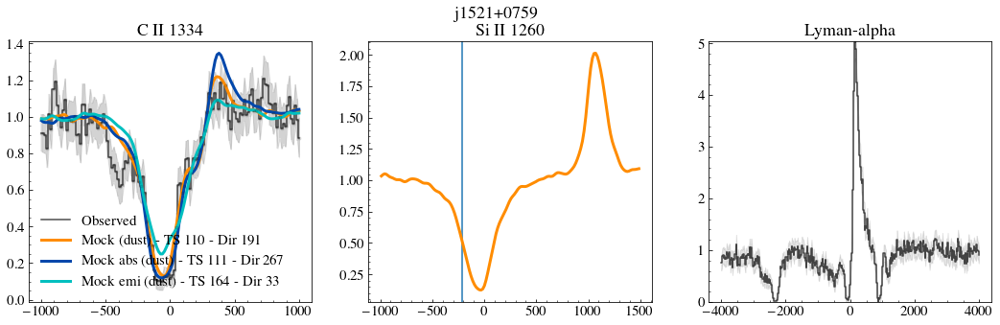

j1525+0757
0.0073053


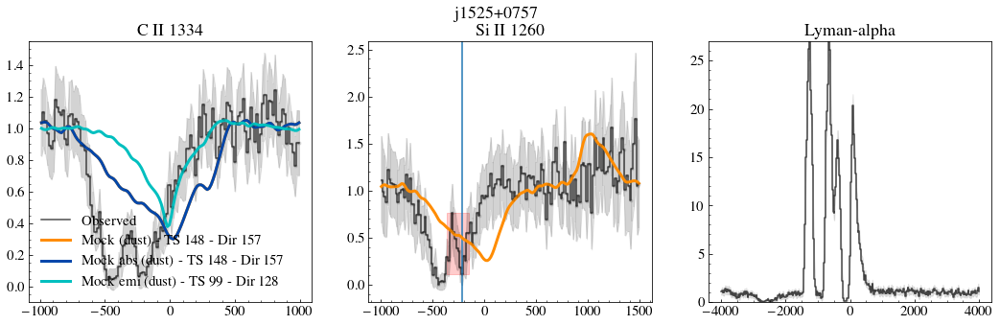

j1545+0858


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


0.18239


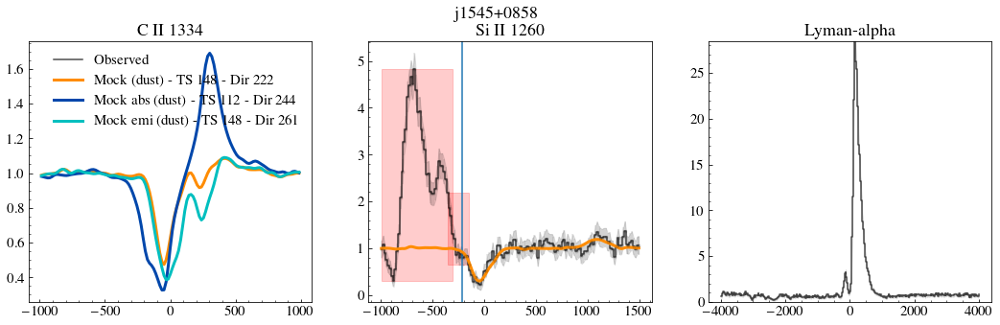

j1612+0817
0.095379


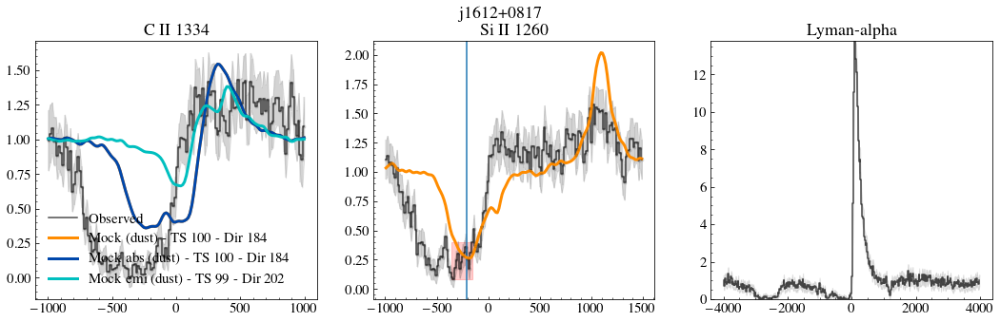

In [18]:
nGal = len(galaxy)
nmocks         = 10
Chi2all        = np.zeros((45, nmocks)) + 1e10
Chi2allabs     = np.zeros((45, nmocks)) + 1e10
Chi2allemi     = np.zeros((45, nmocks)) + 1e10
Chi2siII       = np.zeros((45, nmocks)) + 1e10
Chi2siIIabs    = np.zeros((45, nmocks)) + 1e10
Chi2siIIemi    = np.zeros((45, nmocks)) + 1e10
Chi2cII        = np.zeros((45, nmocks)) + 1e10
Chi2cIIabs     = np.zeros((45, nmocks)) + 1e10
Chi2cIIemi     = np.zeros((45, nmocks)) + 1e10

dirall         = np.zeros((45, nmocks)) - 1
dirallabs      = np.zeros((45, nmocks)) - 1
dirallemi      = np.zeros((45, nmocks)) - 1
dirsiII        = np.zeros((45, nmocks)) - 1
dirsiIIabs     = np.zeros((45, nmocks)) - 1
dirsiIIemi     = np.zeros((45, nmocks)) - 1
dircII         = np.zeros((45, nmocks)) - 1
dircIIabs      = np.zeros((45, nmocks)) - 1
dircIIemi      = np.zeros((45, nmocks)) - 1

outall         = np.zeros((45, nmocks)) - 1
outallabs      = np.zeros((45, nmocks)) - 1
outallemi      = np.zeros((45, nmocks)) - 1
outsiII        = np.zeros((45, nmocks)) - 1
outsiIIabs     = np.zeros((45, nmocks)) - 1
outsiIIemi     = np.zeros((45, nmocks)) - 1
outcII         = np.zeros((45, nmocks)) - 1
outcIIabs      = np.zeros((45, nmocks)) - 1
outcIIemi      = np.zeros((45, nmocks)) - 1

for i in range(nGal):
    print(label[i])

    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    #fit = gaussian_filter(data['fit'], sigma = 10)
    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

#    absflux = gaussian_filter(data['flux']/data['fit'],sigma = 1)
#     if(i == 4):
#         absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
    #absflux /= np.median(absflux[cutSiIIall])
    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    maskLya  = mask[cutLyaall]
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 500)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])

    if(i == 1):      
        fmedCII /=1.05
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    if(i == 0):
        fmedSiII *=1.15
    fsiII /= fmedSiII
    
    fig, axs = plt.subplots(1,3,figsize=(18,5))
    #/np.nanmedian(flux[cutCIIall])
    axs[0].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[0].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[0].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
   
    
    axs[1].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[1].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    axs[1].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]), 
                        np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')  
    axs[1].axvline(-214)
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  

#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[1].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')

    axs[2].plot(vLyad[cutLyaall], flux[cutLyaall],  c='k',alpha = 0.7,drawstyle='steps-mid' )
    axs[2].fill_between(vLyad[cutLyaall],flux[cutLyaall]-err[cutLyaall],flux[cutLyaall]+err[cutLyaall],
                        color = 'k', alpha = 0.1)
#     if(len(flux[cutLyaall][~maskLya])>0):
#         axs[2].fill_between(vLyad[cutLyaall][~maskLya], np.nanmin(flux[cutLyaall][~maskLya]), 
#                         np.nanmax(flux[cutLyaall][~maskLya]), alpha=0.2, color= 'r')  
    axs[2].set_title('Lyman-alpha')
    axs[2].set_ylim(0, np.max([2,np.nanmax(flux[abs(vLyad) < 1000])]))
  

    path_to_data = './CII_SiII_depletion/'   # To change if you move the data

    v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)
    bestfluxsiall = []
    bestfluxciiall = []
    bestfluxsiabs = []
    bestfluxciiabs = []
    bestfluxsiemi = []
    bestfluxciiemi = []
    for output in range(90,165,1):
    
        lcII,  fluxcII  = read_spectrum_c(path_to_data,output) 
        lsiII, fluxsiII = read_spectrum_si(path_to_data,output) 
        
        for idir in range(300):
            lcII_systemic = lcII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lcII) 
            lcII_systemic = lcII_systemic[1:]
            vcII_s    = (lcII_systemic/wcII1334 -1)*c

            lsiII_systemic = lsiII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lsiII) 
            lsiII_systemic = lsiII_systemic[1:]
            vsiII_s  = (lsiII_systemic/wsiII1260 -1)*c

            sigma_pixelcII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vcII_s[50] - vcII_s[49]))
            sigma_pixelsiII = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vsiII_s[50]- vsiII_s[49]))

            modelcII    = gaussian_filter(fluxcII[idir,1:], sigma = sigma_pixelcII)
            f           = interpolate.interp1d(vcII_s, modelcII)
            modelNewcII = f(vcII)

            modelsiII   = gaussian_filter(fluxsiII[idir,1:], sigma = sigma_pixelsiII)
            f           = interpolate.interp1d(vsiII_s, modelsiII)
            modelNewsiII= f(vsiII)

#             alpha = np.nansum((modelNewcII[maskCII]*fcII[maskCII]/(ecII[maskCII]**2)))/ \
#                     np.nansum(modelNewcII[maskCII]**2/ecII[maskCII]**2)
#             modelNewcII *= alpha
            
#             alpha = np.nansum((modelNewsiII[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsiII[maskSiII]**2/esiII[maskSiII]**2)
# #             print(alpha)
#             modelNewsiII *= alpha
            
            rmedCII = ((vcII<-500) | (vcII > 700)) 
            fmedCII = np.nanmedian(modelNewcII[rmedCII])
            modelNewcII /= fmedCII

            rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
            fmedSiII = np.nanmedian(modelNewsiII[rmedSiII])
            modelNewsiII /= fmedSiII
            
            maskCII = maskCII & (abs(vcII <550))
            maskSiII = maskSiII & (vsiII > - 550) & (~((vsiII >-364) & (vsiII <-144)))

            lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcII[maskCII])**2)/ecII[maskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsiII[maskSiII])**2)/esiII[maskSiII]**2)
#             print(lnlikesiII)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cII[i][0] :
                Chi2cII[i][0] = lnlikecII
                dircII[i][0]  = idir
                outcII[i][0]  = output
            
            if lnlikesiII < Chi2siII[i][0] :
                Chi2siII[i][0] = lnlikesiII
                dirsiII[i][0]  = idir
                outsiII[i][0]  = output
                
            if(lnlikeall < Chi2all[i][0]):
                dirall[i][0] = idir
                Chi2all[i][0] = lnlikeall
                outall[i][0] = output
                bestfluxsiall = modelNewsiII
                bestfluxciiall = modelNewcII
                
            absMaskCII = (vcII > -600) & (vcII < 200) & maskCII
            absMaskSiII =  (vsiII > -600) & (vsiII < 200) & maskSiII
            lnlikecII  =  0.5*np.nansum(((fcII[absMaskCII]-modelNewcII[absMaskCII])**2)/ecII[absMaskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[absMaskSiII] - modelNewsiII[absMaskSiII])**2)/esiII[absMaskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cIIabs[i][0] :
                Chi2cIIabs[i][0] = lnlikecII
                dircIIabs[i][0]  = idir
                outcIIabs[i][0]  = output
            
            if lnlikesiII < Chi2siIIabs[i][0] :
                Chi2siIIabs[i][0] = lnlikesiII
                dirsiIIabs[i][0]  = idir
                outsiIIabs[i][0]  = output
                
            if(lnlikeall < Chi2allabs[i][0]):
                dirallabs[i][0] = idir
                Chi2allabs[i][0] = lnlikeall
                outallabs[i][0] = output
                bestfluxsiabs = modelNewsiII
                bestfluxciiabs = modelNewcII
                
            emiMaskCII = (vcII > 150 ) & maskCII & (vcII <700)
            emiMaskSiII = (vsiII > 700) & maskSiII & (vsiII <1500)
            lnlikecII  =  0.5*np.nansum(((fcII[emiMaskCII]-modelNewcII[emiMaskCII])**2)/ecII[emiMaskCII]**2) 
            lnlikesiII =  0.5*np.nansum(((fsiII[emiMaskSiII] - modelNewsiII[emiMaskSiII])**2)/esiII[emiMaskSiII]**2)
            lnlikeall  = lnlikecII + lnlikesiII
                   
            if lnlikecII < Chi2cIIemi[i][0] :
                Chi2cIIemi[i][0] = lnlikecII
                dircIIemi[i][0]  = idir
                outcIIemi[i][0]  = output
            
            if lnlikesiII < Chi2siIIemi[i][0] :
                Chi2siIIemi[i][0] = lnlikesiII
                dirsiIIemi[i][0]  = idir
                outsiIIemi[i][0]  = output
                
            if(lnlikeall < Chi2allemi[i][0]):
#                 print(lnlikeall,lnlikecII,lnlikesiII)
                dirallemi[i][0] = idir
                Chi2allemi[i][0] = lnlikeall
                outallemi[i][0] = output
                bestfluxsiemi = modelNewsiII
                bestfluxciiemi = modelNewcII
        
    # l is a 1D array of wavelength in A, flux is a 2D array, 1728*n_lambda, of flux in erg/s/A:
#     lcII, fluxcII   = read_spectrum_c(path_to_data,int(outall[i][0]) )
#     lsiII, fluxsiII = read_spectrum_si(path_to_data,int(outall[i][0]) )
#     print(Chi2all[i][0])
#     lcII_systemic  = lcII + np.dot(directions[int(dirall[i][0]),:],v_cm[:,int(outall[i][0])-90])/c_cgs*1e5*np.mean(lcII) 
#     lcII_systemic  = lcII_systemic[1:]
#     vcII_s         = (lcII_systemic/wcII1334 -1)*c
#     sigma_pixelcii = res[i] /2.355 / ((vcII_s[50]-vcII_s[49]))
#     model          = gaussian_filter(fluxcII[int(dirall[i][0]),1:], sigma = sigma_pixelcii)
#     f              =  interpolate.interp1d(vcII_s, model)
#     modelNewcii    = f(vcII)
#     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
#                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
#     modelNewcii    *= alpha
#     axs[0].plot(vcII, modelNewcii, label = 'Best mock (FS) - TS %d - Dir %d'%(outall[i][0], dirall[i][0]), c =cnoFS, lw = 3)

    
#     lsiII_systemic = lsiII + np.dot(directions[int(dirall[i][0]),:],v_cm[:,int(outall[i][0])-90])/c_cgs*1e5*np.mean(lsiII) 
#     lsiII_systemic = lsiII_systemic[1:]
#     vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
#     sigma_pixelsi  = res[i] /2.355/ ((vsiII_s[50]-vsiII_s[49]))
#     model          = gaussian_filter(fluxsiII[int(dirall[i][0]),1:], sigma = sigma_pixelsi)
#     f              = interpolate.interp1d(vsiII_s, model)
#     modelNewsi     = f(vsiII)
#     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
#     modelNewsi   *= alpha
#     axs[1].plot(vsiII, modelNewsi, c =cnoFS, lw = 3)
#     lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
#     lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
#     lnlikeall  = lnlikecII + lnlikesiII
#     print('FS: ',lnlikecII, lnlikesiII, lnlikeall )
    axs[0].plot(vcII, bestfluxciiall,
                label = 'Mock (dust) - TS %d - Dir %d'%(outall[i][0], dirall[i][0]), c =cnoFS, lw = 3)
    axs[0].plot(vcII, bestfluxciiabs, 
                label = 'Mock abs (dust) - TS %d - Dir %d'%(outallabs[i][0], dirallabs[i][0]), c =cFS, lw = 3)
    axs[0].plot(vcII, bestfluxciiemi, 
                label = 'Mock emi (dust) - TS %d - Dir %d'%(outallemi[i][0], dirallemi[i][0]), c ='c', lw = 3)
    print(fesc[148-90,int(dirall[i][0])])
    
    axs[1].plot(vsiII, bestfluxsiall, c =cnoFS, lw = 3)
#     axs[1].plot(vsiII, bestfluxsiabs, c =cFS, lw = 3)
#     axs[1].plot(vsiII, bestfluxsiemi, c ='c', lw = 3)
    axs[0].legend(frameon=False)
    plt.suptitle(label[i])
#     plt.show()
#     plt.savefig('Plots/'+galaxy[i]+'matchdepletion.pdf', bbox_inches = 'tight')
    plt.show()

In [19]:
df = pd.DataFrame(np.vstack((galaxy, 
                             outall[:,0].astype(int), dirall[:,0].astype(int), Chi2all[:,0],
                             outsiII[:,0].astype(int), dirsiII[:,0].astype(int), Chi2siII[:,0],
                             outcII[:,0].astype(int), dircII[:,0].astype(int), Chi2cII[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("csv/Classy_depletion_fit.csv", sep=',', header= C, index=False) 


df = pd.DataFrame(np.vstack((galaxy, 
                             outallabs[:,0].astype(int), dirallabs[:,0].astype(int), Chi2allabs[:,0],
                             outsiIIabs[:,0].astype(int), dirsiIIabs[:,0].astype(int), Chi2siIIabs[:,0],
                             outcIIabs[:,0].astype(int), dircIIabs[:,0].astype(int), Chi2cIIabs[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("csv/Classy_depletion_absfit.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

df = pd.DataFrame(np.vstack((galaxy, 
                             outallemi[:,0].astype(int), dirallemi[:,0].astype(int), Chi2allemi[:,0],
                             outsiIIemi[:,0].astype(int), dirsiIIemi[:,0].astype(int), Chi2siIIemi[:,0],
                             outcIIemi[:,0].astype(int), dircIIemi[:,0].astype(int), Chi2cIIemi[:,0],)).T) # A is a numpy 2d array
C=['Galaxy','OutputAll','DirAll', 'x2All','OutputSiII','DirSiII', 'x2siII','OutputCII','DirCII', 'x2CII']
df.to_csv("csv/Classy_depletion_emifit.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

## Fits using cube

[28 39]


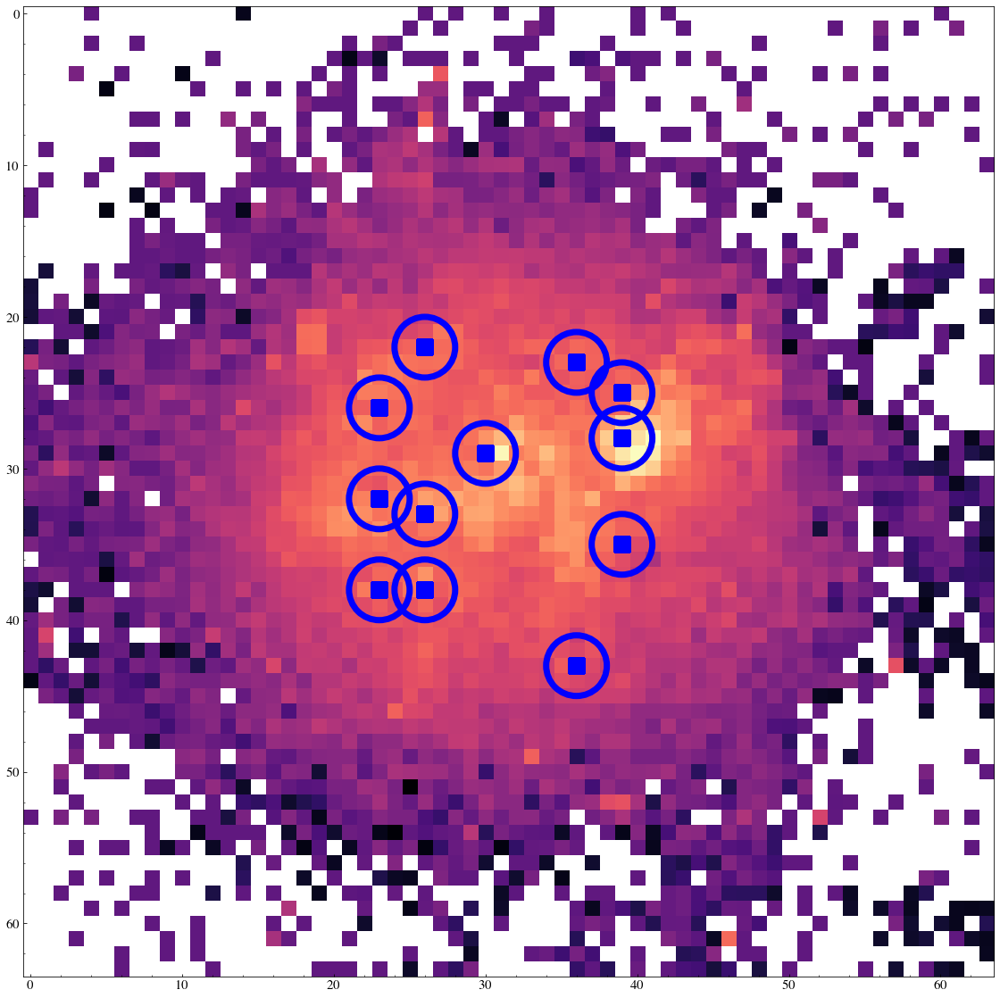

In [45]:
from skimage.feature import peak_local_max
from skimage import data, img_as_float

im = np.sum(cube[0,:,:,40:60],axis =2)

# image_max is the dilation of im with a 20*20 structuring element
# # It is used within peak_local_max function
# image_max = ndi.maximum_filter(im, size=20, mode='constant')

# Comparison between image_max and im to find the coordinates of local maxima
coordinates = peak_local_max(im, min_distance=2, threshold_rel = 0.001)
print(coordinates[0])
plt.figure(figsize = (20,20))
plt.imshow(im, norm=LogNorm(vmin=1e35,vmax=1e40), cmap = 'magma')
plt.scatter(coordinates[:,1], coordinates[:,0], color='blue', s = 300,marker = '+', linewidth = 20, edgecolor = 'w')
ax1=plt.gca()
for xx, yy in coordinates[:]:
    circle4 = plt.Circle((yy,xx), 2, color='b', fill=False , linewidth=7,)
    ax1.add_patch(circle4)


### FIts based on maximum

0 j0021+0052
1 j0036-3333
2 j0127-0619
301


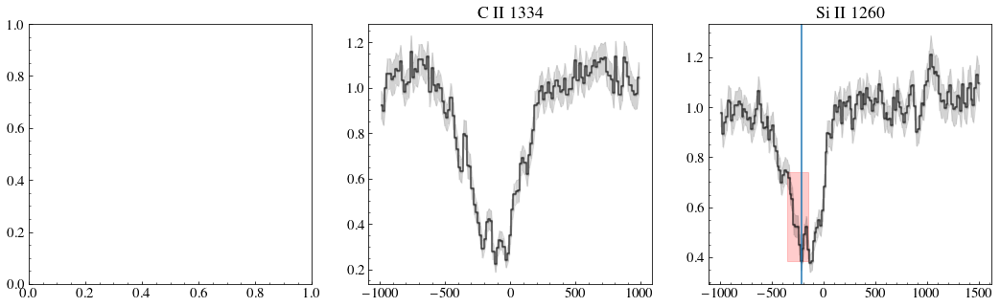

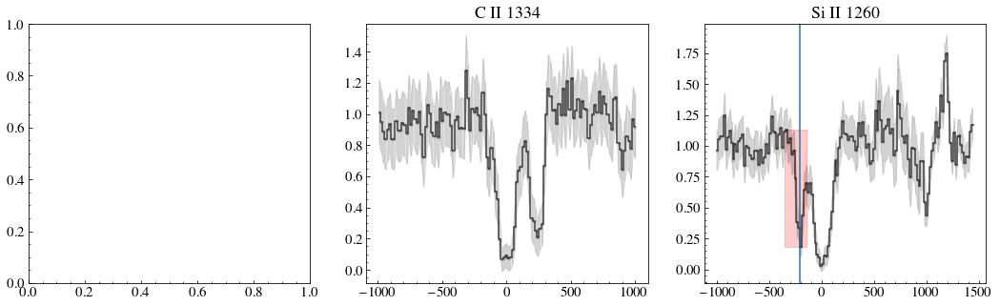

In [68]:
#FITS
import warnings
warnings.filterwarnings('ignore')

# nxy,imsize,lcubecII,cubecII = read_cube('./data_cubes_output_148/CII3/',300)
# print(nxy)
# nxy,imsize,lcubeSiII,cubeSiII = read_cube('./data_cubes_output_148/SiII3/',300)

nGal = len(galaxy)
nmocks         = 2
Chi2all        = np.zeros((45, nmocks)) + 1e10
Chi2allabs     = np.zeros((45, nmocks)) + 1e10
Chi2allemi     = np.zeros((45, nmocks)) + 1e10
Chi2siII       = np.zeros((45, nmocks)) + 1e10
Chi2siIIabs    = np.zeros((45, nmocks)) + 1e10
Chi2siIIemi    = np.zeros((45, nmocks)) + 1e10
Chi2cII        = np.zeros((45, nmocks)) + 1e10
Chi2cIIabs     = np.zeros((45, nmocks)) + 1e10
Chi2cIIemi     = np.zeros((45, nmocks)) + 1e10

dirall         = np.zeros((45, nmocks)) - 1
dirallabs      = np.zeros((45, nmocks)) - 1
dirallemi      = np.zeros((45, nmocks)) - 1
dirsiII        = np.zeros((45, nmocks)) - 1
dirsiIIabs     = np.zeros((45, nmocks)) - 1
dirsiIIemi     = np.zeros((45, nmocks)) - 1
dircII         = np.zeros((45, nmocks)) - 1
dircIIabs      = np.zeros((45, nmocks)) - 1
dircIIemi      = np.zeros((45, nmocks)) - 1

outall         = np.zeros((45, nmocks)) - 1
outallabs      = np.zeros((45, nmocks)) - 1
outallemi      = np.zeros((45, nmocks)) - 1
outsiII        = np.zeros((45, nmocks)) - 1
outsiIIabs     = np.zeros((45, nmocks)) - 1
outsiIIemi     = np.zeros((45, nmocks)) - 1
outcII         = np.zeros((45, nmocks)) - 1
outcIIabs      = np.zeros((45, nmocks)) - 1
outcIIemi      = np.zeros((45, nmocks)) - 1

coordX         = np.zeros((45, nmocks)) - 1
coordY         = np.zeros((45, nmocks)) - 1

dfnoFS = pd.read_csv('csv/Classy_noFS_fit.csv')
dfFS   = pd.read_csv('csv/Classy_FS_fit.csv')
dfdust = pd.read_csv('csv/Classy_dust_fit.csv')
dfdep = pd.read_csv('csv/Classy_depletion_fit.csv')


for i in range(3):
    print(i,label[i])
    
   # if(label[i] not in ['j0036-3333','j0127-0619', 'j0337-0502', 'j0405-3648', 'j0934+5514', 'j1314+3452']):
 #       continue
    
  #  if(classy.loc[classy.Galaxy == label[i].upper(), 'fr50aper'].values < 1):
  #      continue
        
    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    rcos = classy.loc[classy.Galaxy == label[i].upper(), 'rcoskpc'].values*1000
    npix = rcos/(imsize/nxy)
    #if(npix > 10):
    if(classy.loc[classy.Galaxy == label[i].upper(), 'fr50aper'].values <= 1):
        continue
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c


    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    

    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 500)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])

    if(i == 1):      
        fmedCII /=1.05
    fcII /= fmedCII
    if (i == 2):
        fcII/=1.06
        esiII[vsiII>1000]/=2
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    if(i == 0):
        fmedSiII *=1.15
    fsiII /= fmedSiII

    fig, axs = plt.subplots(1,3,figsize=(18,5))
    ax1, ax2, ax3 = axs
    #/np.nanmedian(flux[cutCIIall])
    axs[1].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[1].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[1].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[1].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[1].set_title('C II 1334')
   
    
    axs[2].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[2].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    axs[2].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]), 
                        np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')  
    axs[2].axvline(-214)
    if(len(fsiII[~maskSiII])>0):
        axs[2].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  

#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[2].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[2].set_title('Si II 1260')


             
    ## Find new best fit locally
#     Chi2all        =  1e10
    bestmodelcII = 0
    bestmodelsiII = 0
    pixels_around_center = int(np.ceil(npix))# max(int(ceil(npix)),1)
   # maskCur = maskCII & (abs(vcII)<600) 
    dpeak = 0
    for dd in np.arange(0,300,1):
       # plt.figure(figsize = (10,10))
       # ax = plt.gca()
        fimageoricII = cubecII[dd,:,:,40:-40].copy()
        fimageorisiII= cubeSiII[dd,:,:,40:-10].copy()
        fcont = cubecII[dd,:,:,40:70].copy()

        coordinates = peak_local_max(np.sum(fcont,axis = 2), min_distance=0,threshold_rel=0.01)
       # coordinates = peak_local_max(im, min_distance=2,threshold_rel=0.005)

       # print(coordinates.shape)
       # plt.imshow(np.sum(fimageori,axis = 2),norm=LogNorm(vmin=1e35,vmax=1e41))
        for yy, xx in coordinates[:]:#np.arange(10,50,2):
#            for addy in range(2):
#                 if(pixels_around_center == 1):
#                     addy = 0
#                 yy = yyy+addy
                
#                 for addx in range(2) :
#                     if(pixels_around_center == 1):
#                         addx = 0
#                     xx = xxx + addx
                    if(xx<10 or xx >54):
                        continue
# #             for yy in coordinates[:,0]: #np.arange(10,50,2):
                    if(yy<10 or yy >54):
                        continue
                    dpeak+= 1

            
                    aperture = CircularAperture([xx,yy], r=pixels_around_center) 
                    aperture_masks = aperture.to_mask(method='center') # create mask
                    #fimagecont = aperture_masks.multiply(imagecont) # apply mask to data
                    fimagecII = []#cube[dd,:,:,:].copy()
                    fimagesiII = []#cube[dd,:,:,:].copy()

                    for ii in range(fimageoricII.shape[-1]):
                        fimagecII.append(aperture_masks.multiply(fimageoricII[:,:,ii]))
                    for ii in range(fimageorisiII.shape[-1]):
                        fimagesiII.append(aperture_masks.multiply(fimageorisiII[:,:,ii]))
                    #yy-pixels_around_center:yy+pixels_around_center,\
                    #                       xx-pixels_around_center:xx+pixels_around_center    
                    spec_centercII = np.sum(np.asarray(fimagecII)[:,:,:],axis=(1,2))
                    spec_centersiII = np.sum(np.asarray(fimagesiII)[:,:,:],axis=(1,2))


                    lsyscII    = lcubecII + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubecII) 
                    lsyssiII   = lcubeSiII + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiII) 

                    vcII_s  = (lsyscII[40:-40]/wcII1334-1)*c
                    vsiII_s  = (lsyssiII[40:-10]/wsiII1260-1)*c

                    sigma_pixelcII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vcII_s[50] - vcII_s[49]))
                    sigma_pixelsiII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vsiII_s[50] - vsiII_s[49]))

                    spec_centercII    = gaussian_filter(spec_centercII, sigma = sigma_pixelcII)
                    spec_centersiII    = gaussian_filter(spec_centersiII, sigma = sigma_pixelsiII)

                    f                 = interpolate.interp1d(vcII_s, spec_centercII)
                    spec_centercII    = f(vcII)

                    f                 = interpolate.interp1d(vsiII_s, spec_centersiII)
                    spec_centersiII    = f(vsiII)       

                    rmedCII = ((vcII<-500) | (vcII > 700)) 
                    fmedCII = np.nanmedian(spec_centercII[rmedCII])
                    spec_centercII /= fmedCII

                    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
                    fmedSiII = np.nanmedian(spec_centersiII[rmedSiII])
                    spec_centersiII /= fmedSiII

                    maskCII = maskCII & (abs(vcII <550))
                    
                    maskSiII = maskSiII & (vsiII > - 550)
                    if i != 5:
                        maskSiII = maskSiII & (~((vsiII >-364) & (vsiII <-144)))

        #             if(np.isnan(np.nanmedian(spec_center[rmedCII])) or np.nanmedian(spec_center[rmedCII]) ==0):
        #                 continue
        #             spec_center    /= np.nanmedian(spec_center[rmedCII])
                    lnlikecII  =  0.5*np.nanmean(((fcII[maskCII]-spec_centercII[maskCII])**2)/(ecII[maskCII]**2))
                    lnlikesiII  =  0.5*np.nanmean(((fsiII[maskSiII]-spec_centersiII[maskSiII])**2)/(esiII[maskSiII]**2))
                    if(np.isnan(lnlikesiII)):
                        lnlikesiII = 0
                    if(np.isnan(lnlikecII)):
                        lnlikecII = 0
                    lnlikeall = lnlikecII + lnlikesiII
#                     print(lnlikesiII)
                    if(lnlikeall<=Chi2all[i][0] and lnlikeall !=0):
                        bestmodelcII = spec_centercII
                        bestmodelsiII = spec_centersiII

                        xb = xx
                        yb = yy
                        bestdir = dd
                        #Chi2all = lnlikecII
                        #print(lnlikecII,lnlikesiII)
                        Chi2all[i][0] = lnlikeall
                        dirall[i][0] = dd
                        coordX[i][0] = xx
                        coordY[i][0] = yy
                      #  print(xx, yy)

    
    
    try:


    # imagecont = np.sum(cube[idir,:,:,40:70],axis=(2))#/ (imsize/nxy)**2 
        imagecont2 = np.sum(cubecII[bestdir,:,:,40:70],axis=(2))#/ (imsize/nxy)**2 
        cx,cy = np.where(imagecont2 == np.max(imagecont2))

        im1 = ax1.imshow(imagecont2, norm=LogNorm(vmin=1e35,vmax=1e40), cmap = 'magma')#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.

        divider = make_axes_locatable(ax1)
        cax = divider.append_axes('right', size='5%', pad=0.05)
        fig.colorbar(im1, cax=cax, orientation='vertical')
        ax1.set_title('Continuum image')
        ax1.scatter(cy,cx, s = 200, color = 'cyan', marker = 'x', linewidths=3 )
    #     rect = patches.Rectangle((xb-pixels_around_center, yb-pixels_around_center), 2*pixels_around_center, 2*pixels_around_center, 
    #                              linewidth=2, edgecolor='cyan', facecolor='None')
        circle1 = plt.Circle((xb, yb), pixels_around_center, color='cyan', fill=False , linewidth=2,)

    #     ax1.add_patch(rect)
        ax1.add_patch(circle1)


        #######################################################

        bestChi2NF      = dfnoFS['x2siII'][i]
        bestChi2FS      = dfFS['x2siII'][i]
        bestChi2dust    = dfdep['x2siII'][i]
        print(bestdir)
#         if(np.argmin([bestChi2NF,bestChi2FS,bestChi2dust]) == 0):


#             labels= 'Best simu is without FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2NF)
#         elif(np.argmin([bestChi2NF,bestChi2FS,bestChi2dust]) == 1):
#         bestDir         = dfFS['DirAll'][i]
#         bestOut         = dfFS['OutputAll'][i]
#         labels= 'Best simu is with FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2FS)
#         path_to_data = './CII_SiII_fine/' 

#         else:
        bestDir         = dfdep['DirAll'][i]
        bestOut         = dfdep['OutputAll'][i]    
        labels= 'Best simu is with FS and ND and dep - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2dust)
        path_to_data = './CII_SiII_depletion/' 
        
        print(bestOut)
        
        lcII, fluxcII   = read_spectrum_c(path_to_data,  bestOut )
        lsiII, fluxsiII = read_spectrum_si(path_to_data, bestOut )

                ## CII Plot
        lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
        lcII_systemic  = lcII_systemic[1:]
        vcII_s         = (lcII_systemic/wcII1334 -1)*c
        sigma_pixelcii = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] / 2.355/((vcII_s[50]-vcII_s[49]))
        model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
        f              = interpolate.interp1d(vcII_s, model)
        modelNewcii    = f(vcII)

        rmedCII = ((vcII<-500) | (vcII > 500)) 
        fmedCII = np.nanmedian(modelNewcii[rmedCII])
        modelNewcii /= fmedCII
    #     axs[0].plot(vcII, modelNewcii, c =cFS, lw = 3)

      #  ax2.errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
      #  ax2.plot(vcII, fcII,  c='k', alpha = 0.7, drawstyle='steps-mid' , label = 'Observed')
        ax2.plot(vcII, modelNewcii, drawstyle='steps-mid', label='Original best fit', c = cFS, linewidth = 2) 
        ax2.plot(vcII, bestmodelcII, drawstyle='steps-mid', label='New best fit' , c = cnoFS, linewidth = 2) 
        ax2.legend()

        ### Si II plot
        lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
        lsiII_systemic = lsiII_systemic[1:]
        vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
        sigma_pixelsi  = res[i]  /2.355/ ((vsiII_s[50]-vsiII_s[49]))
        model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
        f              = interpolate.interp1d(vsiII_s, model)
        modelNewsi     = f(vsiII)
        
        rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
        fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
        modelNewsi /= fmedSiII
        ax3.plot(vsiII, modelNewsi, drawstyle='steps-mid', label='Original best fit', c = cFS, linewidth = 2) 
        ax3.plot(vsiII, bestmodelsiII, drawstyle='steps-mid', label='New best fit' , c = cnoFS, linewidth = 2) 
        ax3.legend()
        #plt.savefig('Plots/'+galaxy[i]+'matchcube.pdf', bbox_inches = 'tight')
        plt.show()
    except:
        print('didnwork')
print(dpeak)



In [59]:
df = pd.DataFrame(np.vstack((galaxy, 
                             dirall[:,0].astype(int), Chi2all[:,0], coordX[:,0].astype(int), coordY[:,0].astype(int))).T) # A is a numpy 2d array
C=['Galaxy','DirAll', 'x2All','x','y']
df.to_csv("csv/Classy_cubedep_peakfit.csv", sep=',', header= C, index=False) 


### Fits random selected

In [144]:
v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)
from skimage.feature import peak_local_max

nGal = len(galaxy)
nmocks         = 2
Chi2all        = np.zeros((45, nmocks)) + 1e10
Chi2allabs     = np.zeros((45, nmocks)) + 1e10
Chi2allemi     = np.zeros((45, nmocks)) + 1e10
Chi2siII       = np.zeros((45, nmocks)) + 1e10
Chi2siIIabs    = np.zeros((45, nmocks)) + 1e10
Chi2siIIemi    = np.zeros((45, nmocks)) + 1e10
Chi2cII        = np.zeros((45, nmocks)) + 1e10
Chi2cIIabs     = np.zeros((45, nmocks)) + 1e10
Chi2cIIemi     = np.zeros((45, nmocks)) + 1e10

dirall         = np.zeros((45, nmocks)) - 1
dirallabs      = np.zeros((45, nmocks)) - 1
dirallemi      = np.zeros((45, nmocks)) - 1
dirsiII        = np.zeros((45, nmocks)) - 1
dirsiIIabs     = np.zeros((45, nmocks)) - 1
dirsiIIemi     = np.zeros((45, nmocks)) - 1
dircII         = np.zeros((45, nmocks)) - 1
dircIIabs      = np.zeros((45, nmocks)) - 1
dircIIemi      = np.zeros((45, nmocks)) - 1

outall         = np.zeros((45, nmocks)) - 1
outallabs      = np.zeros((45, nmocks)) - 1
outallemi      = np.zeros((45, nmocks)) - 1
outsiII        = np.zeros((45, nmocks)) - 1
outsiIIabs     = np.zeros((45, nmocks)) - 1
outsiIIemi     = np.zeros((45, nmocks)) - 1
outcII         = np.zeros((45, nmocks)) - 1
outcIIabs      = np.zeros((45, nmocks)) - 1
outcIIemi      = np.zeros((45, nmocks)) - 1

coordX         = np.zeros((45, nmocks)) - 1
coordY         = np.zeros((45, nmocks)) - 1

dfnoFS = pd.read_csv('Classy_noFS_fit.csv')
dfFS   = pd.read_csv('Classy_FS_fit.csv')
dfdust = pd.read_csv('Classy_dust_fit.csv')
for i in range(nGal):
    print(label[i])
    
    if(label[i] not in ['j0036-3333','j0127-0619', 'j0337-0502', 'j0405-3648', 'j0934+5514', 'j1314+3452']):
        continue
    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    #fit = gaussian_filter(data['fit'], sigma = 10)
    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c


    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    

    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]
    
    rmedCII = ((vcII<-500) | (vcII > 700)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])

    if(i == 1):      
        fmedCII /=1.05
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    if(i == 0):
        fmedSiII *=1.15
    fsiII /= fmedSiII
    
    fig, axs = plt.subplots(1,3,figsize=(18,5))
    ax1, ax2, ax3 = axs
    #/np.nanmedian(flux[cutCIIall])
    axs[1].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[1].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[1].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[1].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[1].set_title('C II 1334')
   
    
    axs[2].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[2].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    axs[2].fill_between(vsiII[((vsiII >-364) & (vsiII <-144))], np.nanmin(fsiII[((vsiII >-364) & (vsiII <-144))]), 
                        np.nanmax(fsiII[((vsiII >-364) & (vsiII <-144))]), alpha=0.2, color= 'r')  
    axs[2].axvline(-214)
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  

#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[2].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[2].set_title('Si II 1260')


             
    ## Find new best fit locally
#     Chi2all        =  1e10
    bestmodelcII = 0
    bestmodelsiII = 0
    pixels_around_center = max(int(np.round(npix)),1)
   # maskCur = maskCII & (abs(vcII)<600)
    for dd in np.arange(0,300,1):
       # plt.figure(figsize = (10,10))
       # ax = plt.gca()
        fimageoricII = cubecII[dd,:,:,40:-40].copy()
        fimageorisiII= cubeSiII[dd,:,:,40:-10].copy()

        for xx in np.arange(15,50,5):
            for yy in np.arange(15,50,2):

                    aperture = CircularAperture([xx,yy], r=pixels_around_center) 
                    aperture_masks = aperture.to_mask(method='center') # create mask
                    #fimagecont = aperture_masks.multiply(imagecont) # apply mask to data
                    fimagecII = []#cube[dd,:,:,:].copy()
                    fimagesiII = []#cube[dd,:,:,:].copy()

                    for ii in range(fimageoricII.shape[-1]):
                        fimagecII.append(aperture_masks.multiply(fimageoricII[:,:,ii]))
                    for ii in range(fimageorisiII.shape[-1]):
                        fimagesiII.append(aperture_masks.multiply(fimageorisiII[:,:,ii]))
                    #yy-pixels_around_center:yy+pixels_around_center,\
                    #                       xx-pixels_around_center:xx+pixels_around_center    
                    spec_centercII = np.sum(np.asarray(fimagecII)[:,:,:],axis=(1,2))
                    spec_centersiII = np.sum(np.asarray(fimagesiII)[:,:,:],axis=(1,2))


                    lsyscII    = lcubecII + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubecII) 
                    lsyssiII   = lcubeSiII + np.dot(directions[dd,:],v_cm[:,148-90])/c_cgs*1e5*np.mean(lcubeSiII) 

                    vcII_s  = (lsyscII[40:-40]/wcII1334-1)*c
                    vsiII_s  = (lsyssiII[40:-10]/wsiII1260-1)*c

                    sigma_pixelcII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vcII_s[50] - vcII_s[49]))
                    sigma_pixelsiII  = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] /2.355/ ((vsiII_s[50] - vsiII_s[49]))

                    spec_centercII    = gaussian_filter(spec_centercII, sigma = sigma_pixelcII)
                    spec_centersiII    = gaussian_filter(spec_centersiII, sigma = sigma_pixelsiII)

                    f                 = interpolate.interp1d(vcII_s, spec_centercII)
                    spec_centercII    = f(vcII)

                    f                 = interpolate.interp1d(vsiII_s, spec_centersiII)
                    spec_centersiII    = f(vsiII)       

                    rmedCII = ((vcII<-500) | (vcII > 700)) 
                    fmedCII = np.nanmedian(spec_centercII[rmedCII])
                    spec_centercII /= fmedCII

                    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
                    fmedSiII = np.nanmedian(spec_centersiII[rmedSiII])
                    spec_centersiII /= fmedSiII

                    maskCII = maskCII & (abs(vcII <550))
                    maskSiII = maskSiII & (vsiII > - 550) & (~((vsiII >-364) & (vsiII <-144)))


        #             if(np.isnan(np.nanmedian(spec_center[rmedCII])) or np.nanmedian(spec_center[rmedCII]) ==0):
        #                 continue
        #             spec_center    /= np.nanmedian(spec_center[rmedCII])
                    lnlikecII  =  0.5*np.nanmean(((fcII[maskCII]-spec_centercII[maskCII])**2)/(ecII[maskCII]**2))
                    lnlikesiII  =  0.5*np.nanmean(((fsiII[maskSiII]-spec_centersiII[maskSiII])**2)/(esiII[maskSiII]**2))
                    lnlikeall = lnlikecII + lnlikesiII
                    if(lnlikeall<=Chi2all[i][0] and lnlikeall !=0):
                        bestmodelcII = spec_centercII
                        bestmodelsiII = spec_centersiII

                        xb = xx
                        yb = yy
                        bestdir = dd
                        #Chi2all = lnlikecII
                        #print(lnlikecII,lnlikesiII)
                        Chi2all[i][0] = lnlikeall
                        dirall[i][0] = dd
                        coordX[i][0] = xx
                        coordY[i][0] = yy
                        print(xx, yy)

    
    
    try:


    # imagecont = np.sum(cube[idir,:,:,40:70],axis=(2))#/ (imsize/nxy)**2 
        imagecont2 = np.sum(cubecII[bestdir,:,:,40:70],axis=(2))#/ (imsize/nxy)**2 
        cx,cy = np.where(imagecont2 == np.max(imagecont2))

        im1 = ax1.imshow(imagecont2, norm=LogNorm(vmin=1e35,vmax=1e40), cmap = 'magma')#norm=vmin=1e35,vmax=1e38, vmin = 0, vmax = 1.

        divider = make_axes_locatable(ax1)
        cax = divider.append_axes('right', size='5%', pad=0.05)
        fig.colorbar(im1, cax=cax, orientation='vertical')
        ax1.set_title('Continuum image')
        ax1.scatter(cy,cx, s = 200, color = 'cyan', marker = 'x', linewidths=3 )
    #     rect = patches.Rectangle((xb-pixels_around_center, yb-pixels_around_center), 2*pixels_around_center, 2*pixels_around_center, 
    #                              linewidth=2, edgecolor='cyan', facecolor='None')
        circle1 = plt.Circle((xb, yb), pixels_around_center, color='cyan', fill=False , linewidth=2,)

    #     ax1.add_patch(rect)
        ax1.add_patch(circle1)


        #######################################################

        bestChi2NF      = dfnoFS['x2siII'][i]
        bestChi2FS      = dfFS['x2siII'][i]
        bestChi2dust    = dfdust['x2siII'][i]
        print(bestdir)
#         if(np.argmin([bestChi2NF,bestChi2FS,bestChi2dust]) == 0):


#             labels= 'Best simu is without FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2NF)
#         elif(np.argmin([bestChi2NF,bestChi2FS,bestChi2dust]) == 1):
        bestDir         = dfFS['DirAll'][i]
        bestOut         = dfFS['OutputAll'][i]
        labels= 'Best simu is with FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2FS)
        path_to_data = './CII_SiII_fine/' 

#         else:
#         bestDir         = dfdust['DirAll'][i]
#         bestOut         = dfdust['OutputAll'][i]    
#         labels= 'Best simu is with FS and ND - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2dust)
#         path_to_data = './CII_SiII_ND/' 

        lcII, fluxcII   = read_spectrum_c(path_to_data,  bestOut )
        lsiII, fluxsiII = read_spectrum_si(path_to_data, bestOut )

                ## CII Plot
        lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
        lcII_systemic  = lcII_systemic[1:]
        vcII_s         = (lcII_systemic/wcII1334 -1)*c
        sigma_pixelcii = classy.loc[classy.Galaxy == label[i].upper(), 'resol'] / 2.355/((vcII_s[50]-vcII_s[49]))
        model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
        f              = interpolate.interp1d(vcII_s, model)
        modelNewcii    = f(vcII)

        rmedCII = ((vcII<-500) | (vcII > 700)) 
        fmedCII = np.nanmedian(modelNewcii[rmedCII])
        modelNewcii /= fmedCII
    #     axs[0].plot(vcII, modelNewcii, c =cFS, lw = 3)

      #  ax2.errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
      #  ax2.plot(vcII, fcII,  c='k', alpha = 0.7, drawstyle='steps-mid' , label = 'Observed')
        ax2.plot(vcII, modelNewcii, drawstyle='steps-mid', label='Original best fit', c = cFS, linewidth = 2) 
        ax2.plot(vcII, bestmodelcII, drawstyle='steps-mid', label='New best fit' , c = cnoFS, linewidth = 2) 
        ax2.legend()

        ### Si II plot
        lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
        lsiII_systemic = lsiII_systemic[1:]
        vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
        sigma_pixelsi  = res[i]  /2.355/ ((vsiII_s[50]-vsiII_s[49]))
        model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
        f              = interpolate.interp1d(vsiII_s, model)
        modelNewsi     = f(vsiII)
        
        rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
        fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
        modelNewsi /= fmedSiII
        ax3.plot(vsiII, modelNewsi, drawstyle='steps-mid', label='Original best fit', c = cFS, linewidth = 2) 
        ax3.plot(vsiII, bestmodelsiII, drawstyle='steps-mid', label='New best fit' , c = cnoFS, linewidth = 2) 
        ax3.legend()
        #plt.savefig('Plots/'+galaxy[i]+'matchcube.pdf', bbox_inches = 'tight')

        plt.show()
    except:
        print('not working')

   

FileNotFoundError: [Errno 2] No such file or directory: 'Classy_noFS_fit.csv'

# Comparison fits 

## FS no FS

No handles with labels found to put in legend.


noFS:  56.91726147730404 28.70497072466903 85.62223220197308
FS:  68.80740696543509 32.837040476578224 101.64444744201332


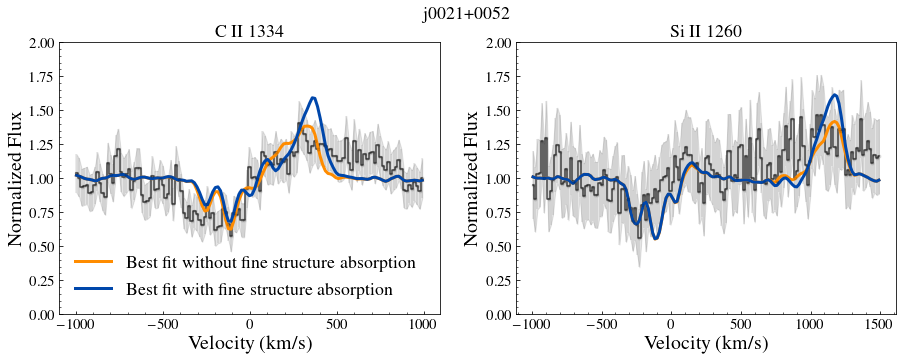

No handles with labels found to put in legend.


noFS:  914.8030317324202 368.47896045582763 1283.2819921882478
FS:  591.050215097876 388.49092684326115 979.5411419411372


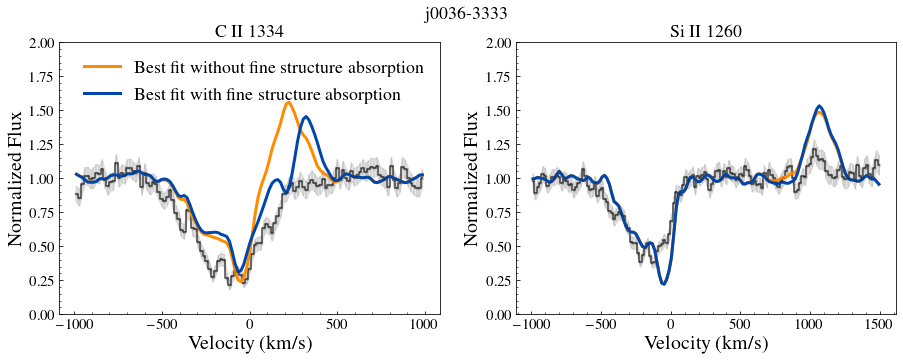

No handles with labels found to put in legend.


noFS:  213.44703187896778 84.99616345011336 298.44319532908116
FS:  56.09852999368969 73.24186068848886 129.34039068217854


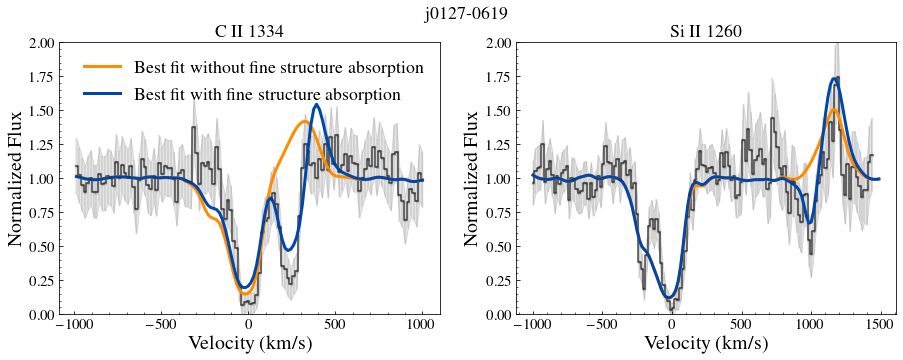

No handles with labels found to put in legend.


noFS:  84.17802766529304 49.52294387809446 133.7009715433875
FS:  29.287093418495544 60.44541828986652 89.73251170836207


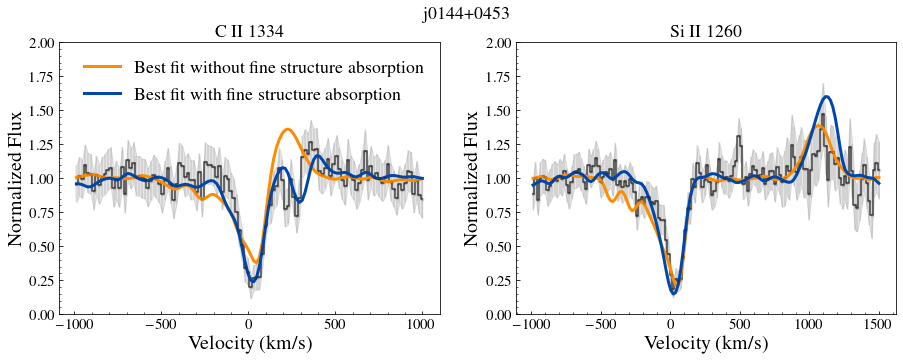

No handles with labels found to put in legend.


noFS:  410.32755450852665 157.88272334880236 568.210277857329
FS:  154.49157899872122 272.64907340995626 427.1406524086775


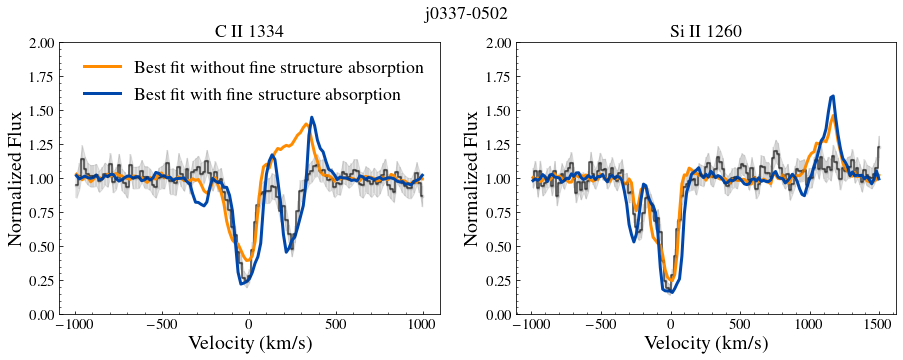

No handles with labels found to put in legend.


noFS:  103.46473708635875 90.00923413665365 193.4739712230124
FS:  55.30327308319441 105.56847949626443 160.87175257945884


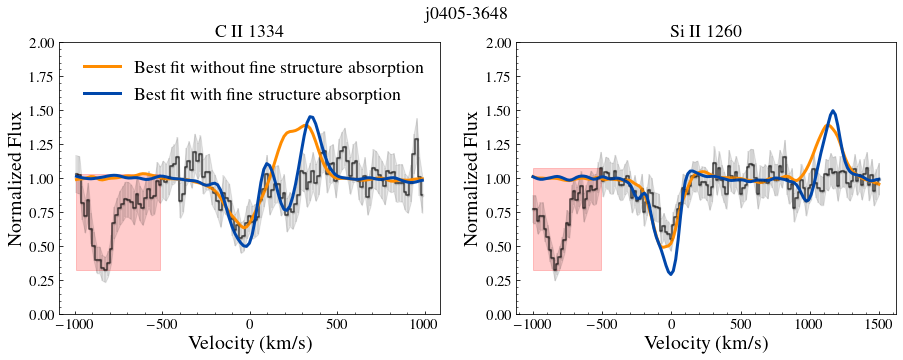

No handles with labels found to put in legend.


noFS:  745.5129233058735 286.14825058811317 1031.6611738939866
FS:  790.4545669348645 277.88461472411626 1068.3391816589808


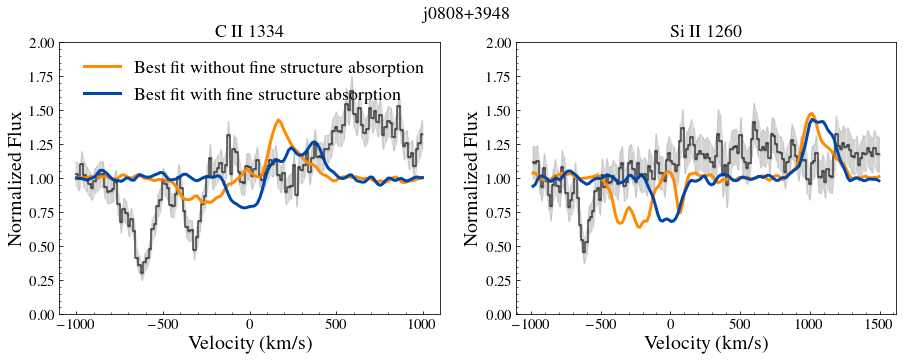

No handles with labels found to put in legend.


noFS:  731.1152794261267 113.55893293008634 844.674212356213
FS:  208.14880818645275 115.06277297038507 323.21158115683784


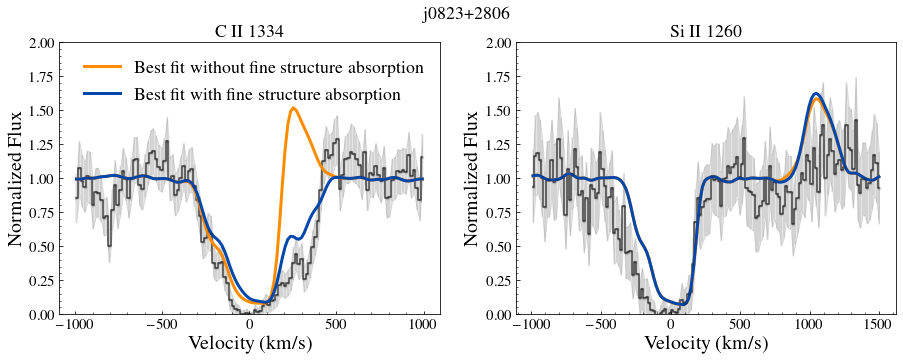

No handles with labels found to put in legend.


noFS:  40.3797284699037 60.75911472455022 101.13884319445393
FS:  39.180496583766505 68.69774332744583 107.87823991121235


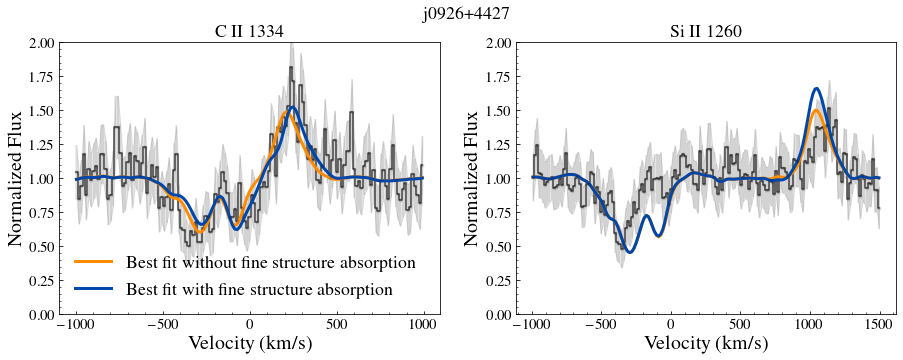

No handles with labels found to put in legend.


noFS:  914.8194007938401 566.8413797128629 1481.660780506703
FS:  439.557485219273 641.1667477078438 1080.7242329271169


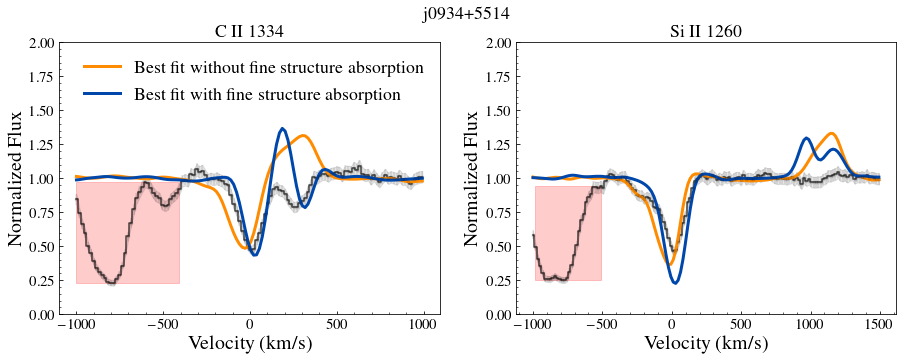

No handles with labels found to put in legend.


noFS:  135.95194993828562 84.19933042059476 220.1512803588804
FS:  65.4343501539799 85.38044287209826 150.81479302607818


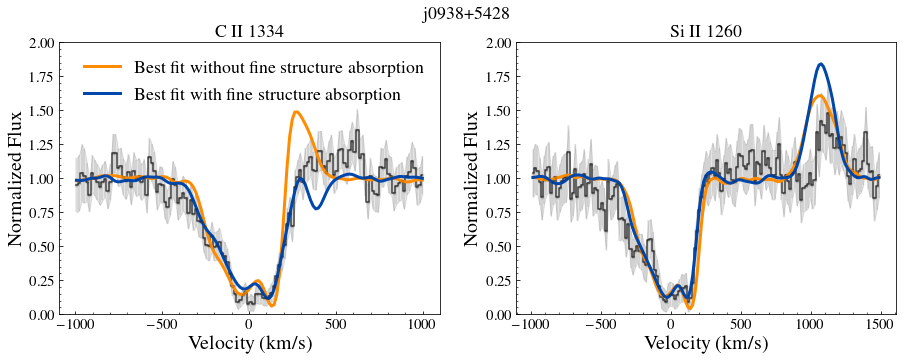

No handles with labels found to put in legend.


noFS:  145.34846972778493 79.41639215813416 224.7648618859191
FS:  32.23469409904207 114.55674403837916 146.79143813742124


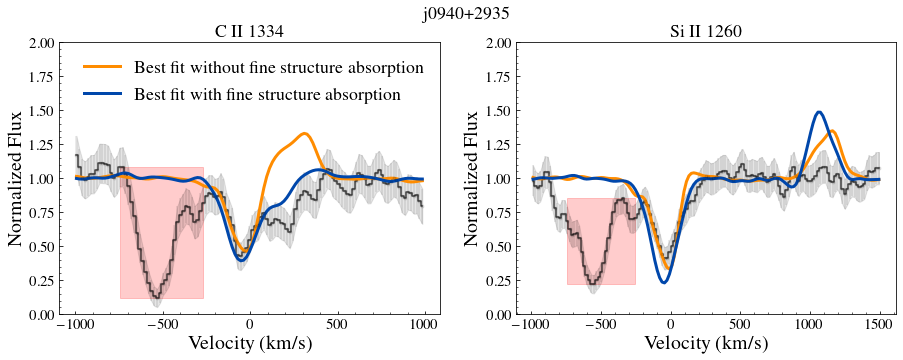

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-518-12eca64ccd54>:62: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-518-12eca64ccd54>:63: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')
No handles with labels found to put in legend.


noFS:  227.7927872466923 0.0 227.7927872466923
FS:  92.12858834381079 0.0 92.12858834381079


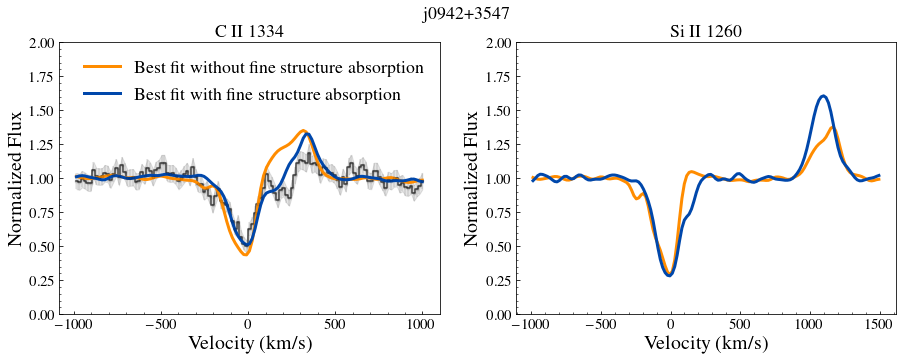

No handles with labels found to put in legend.


noFS:  26.44128479772046 30.451569732985853 56.892854530706316
FS:  9.242532749617595 28.12165972220871 37.36419247182631


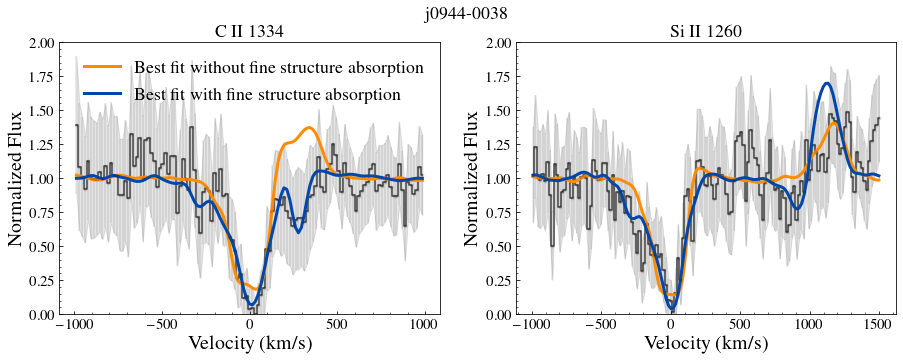

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-518-12eca64ccd54>:62: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-518-12eca64ccd54>:63: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')
No handles with labels found to put in legend.


noFS:  23.616310254173793 0.0 23.616310254173793
FS:  6.362239522170513 0.0 6.362239522170513


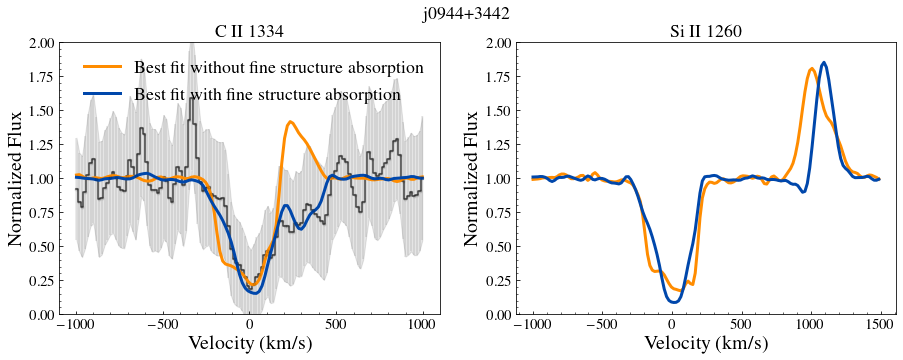

No handles with labels found to put in legend.


noFS:  74.36491007398736 54.705076568317644 129.069986642305
FS:  25.555032642101494 73.40847584097101 98.9635084830725


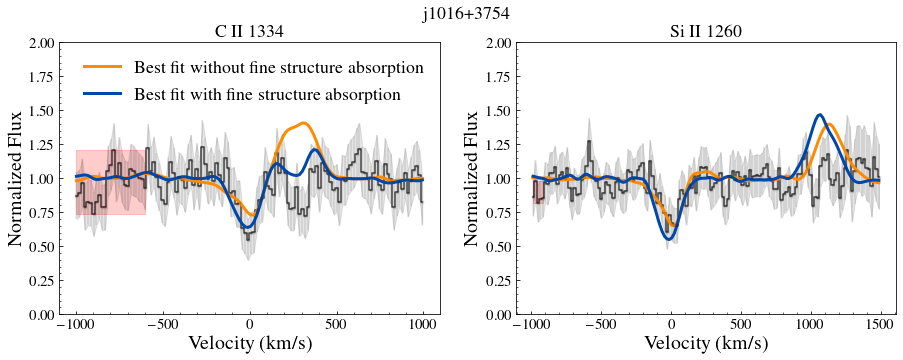

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
No handles with labels found to put in legend.


noFS:  0.0 65.37429573332572 65.37429573332572
FS:  0.0 75.60218330075985 75.60218330075985


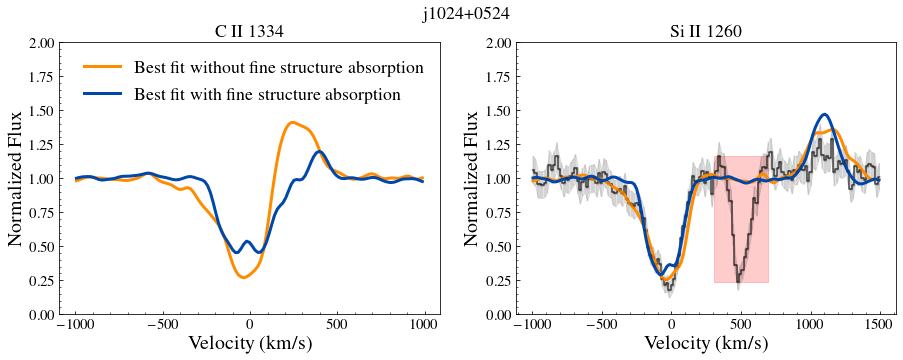

No handles with labels found to put in legend.


noFS:  99.1160125768862 42.603708559038914 141.7197211359251
FS:  68.3809526942738 31.512972327538055 99.89392502181185


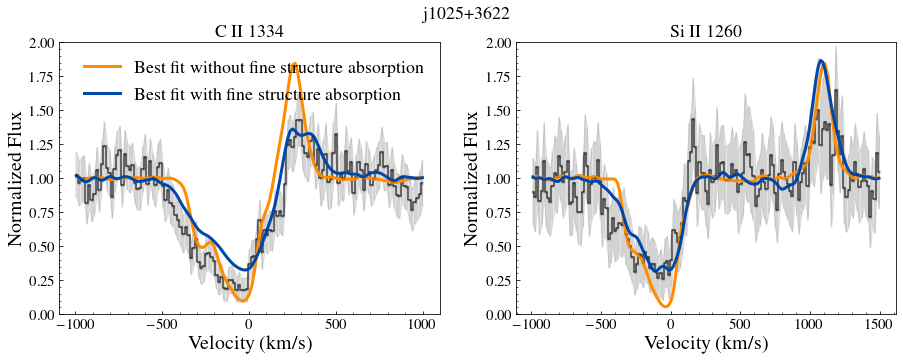

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-518-12eca64ccd54>:62: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-518-12eca64ccd54>:63: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')
No handles with labels found to put in legend.


noFS:  178.19494323701878 0.0 178.19494323701878
FS:  52.20953364407565 0.0 52.20953364407565


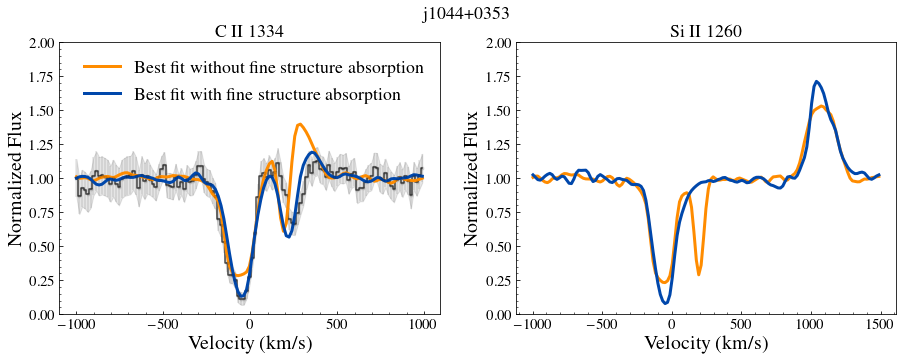

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-518-12eca64ccd54>:53: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),
No handles with labels found to put in legend.


noFS:  0.0 85.18002637548739 85.18002637548739
FS:  0.0 115.75097733800388 115.75097733800388


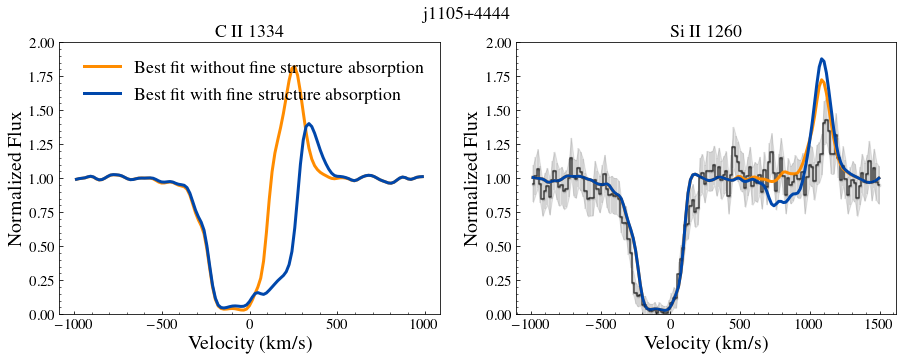

No handles with labels found to put in legend.


noFS:  699.7618224726152 152.30868469164807 852.0705071642633
FS:  797.783145163443 172.96035300587565 970.7434981693186


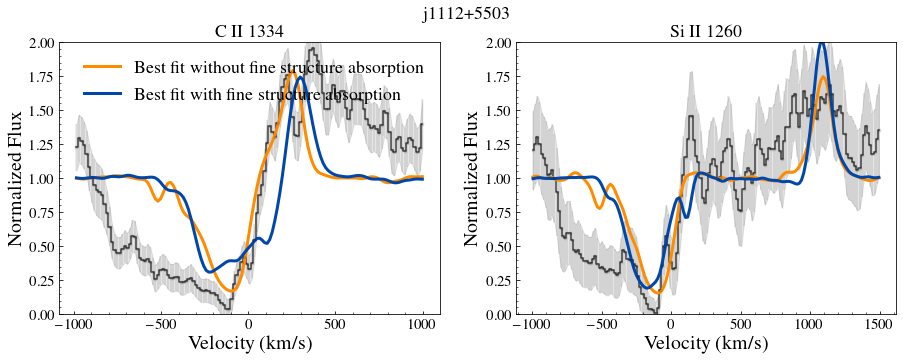

No handles with labels found to put in legend.


noFS:  132.78206215734042 78.72563693859279 211.50769909593322
FS:  44.39949041248142 86.90463388853074 131.30412430101217


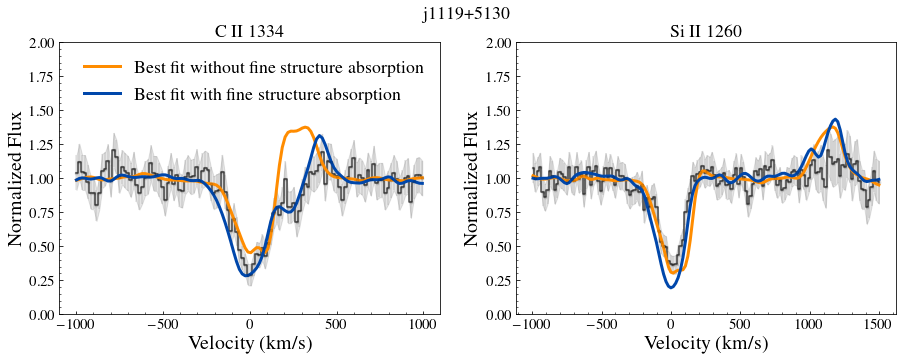

No handles with labels found to put in legend.


noFS:  359.88140364916626 184.87328203678217 544.7546856859484
FS:  95.97187404691995 162.37422097083345 258.3460950177534


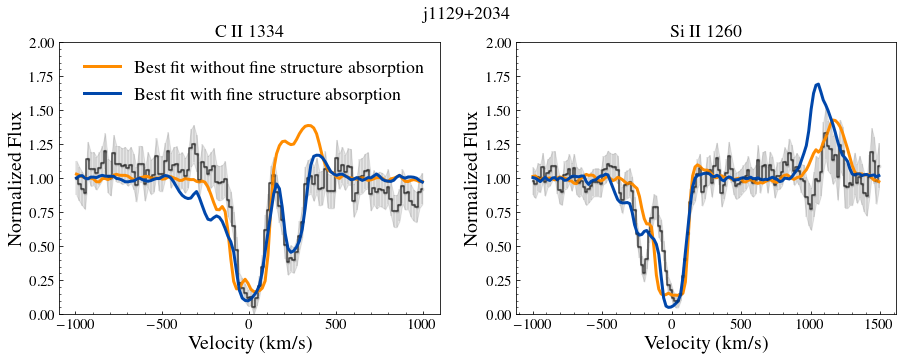

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
No handles with labels found to put in legend.


noFS:  131.1085403582956 0.0 131.1085403582956
FS:  31.81843227887269 0.0 31.81843227887269


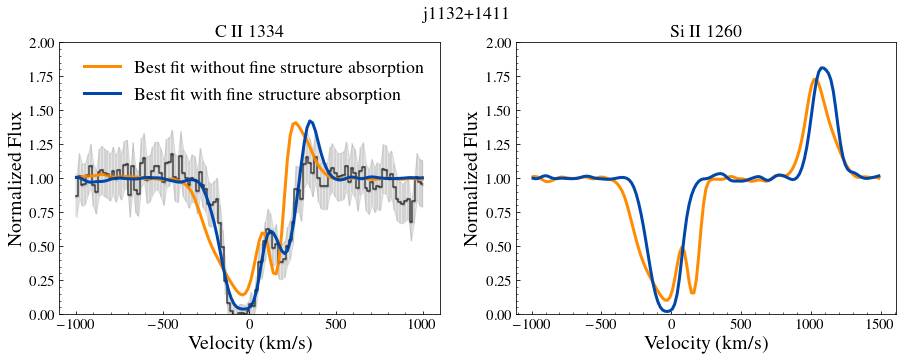

No handles with labels found to put in legend.


noFS:  32.1871456236369 22.321431875433944 54.508577499070846
FS:  10.202463617247641 27.197913193473763 37.400376810721404


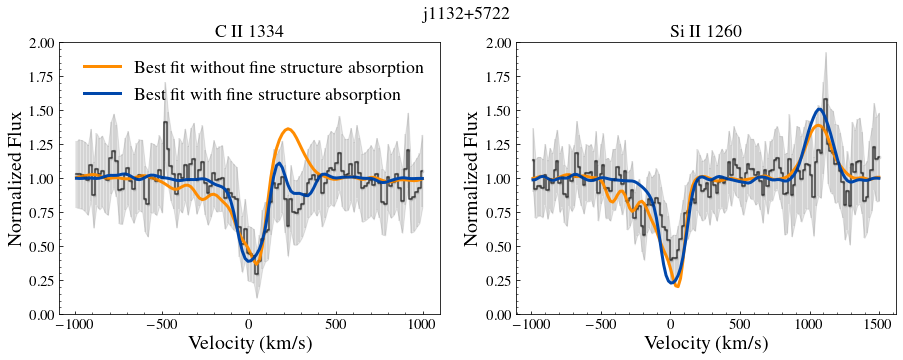

No handles with labels found to put in legend.


noFS:  286.39872186350397 114.43445375146355 400.8331756149675
FS:  258.41228362320885 98.10630724324182 356.51859086645067


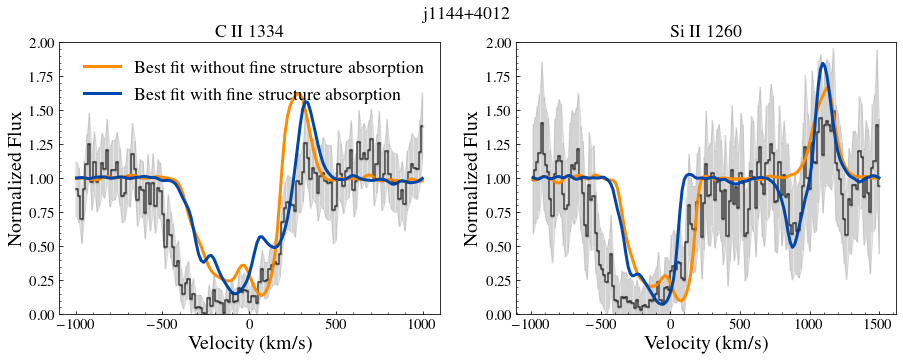

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-518-12eca64ccd54>:53: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),
No handles with labels found to put in legend.


noFS:  0.0 40.052867250161704 40.052867250161704
FS:  0.0 50.03575350191626 50.03575350191626


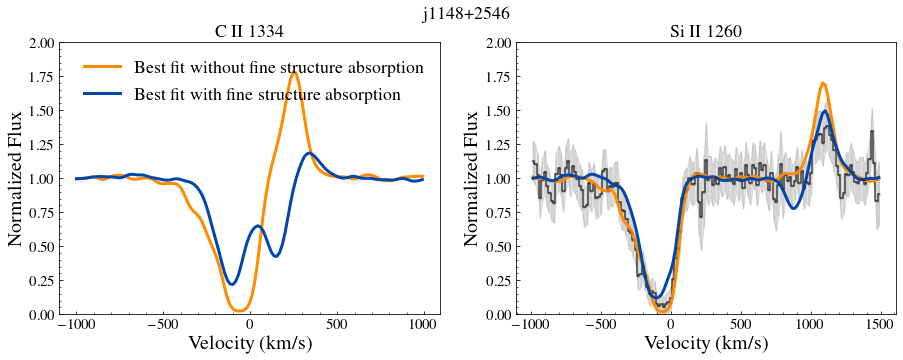

No handles with labels found to put in legend.


noFS:  438.7563572876357 209.82934132197104 648.5856986096068
FS:  105.89481629671272 207.69135547790225 313.58617177461497


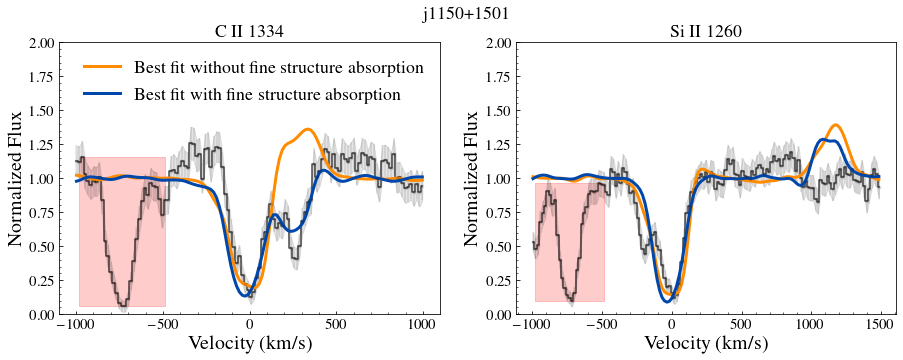

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-518-12eca64ccd54>:62: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-518-12eca64ccd54>:63: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')
No handles with labels found to put in legend.


noFS:  144.96051412546876 0.0 144.96051412546876
FS:  61.46831975570923 0.0 61.46831975570923


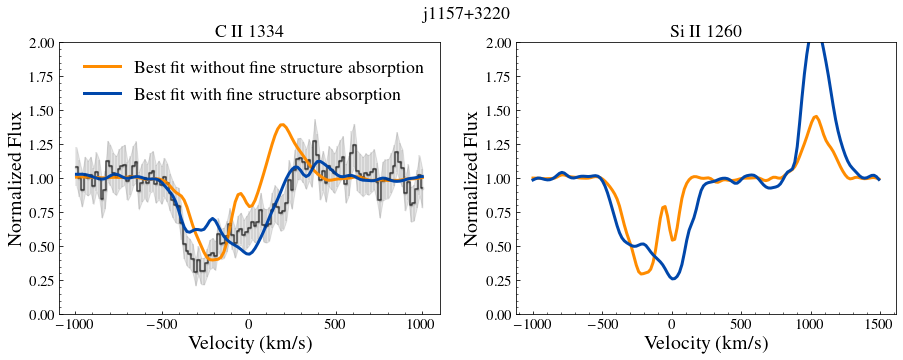

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
No handles with labels found to put in legend.


noFS:  0.0 48.750625142164225 48.750625142164225
FS:  0.0 47.23355430570479 47.23355430570479


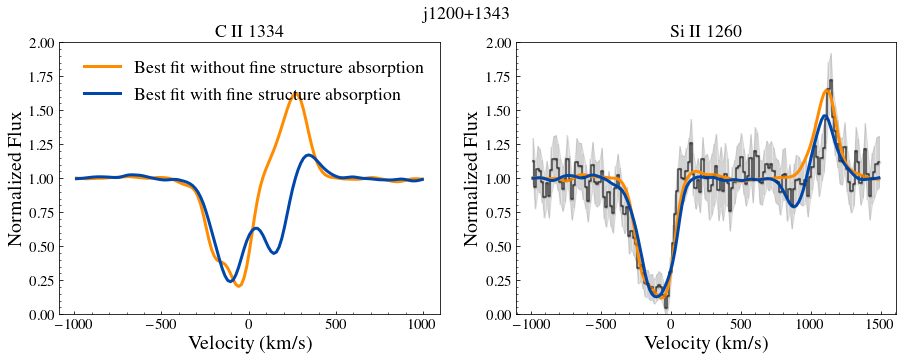

No handles with labels found to put in legend.


noFS:  305.7229612021743 202.44997273292694 508.17293393510124
FS:  50.2314572040631 196.99150229433764 247.22295949840074


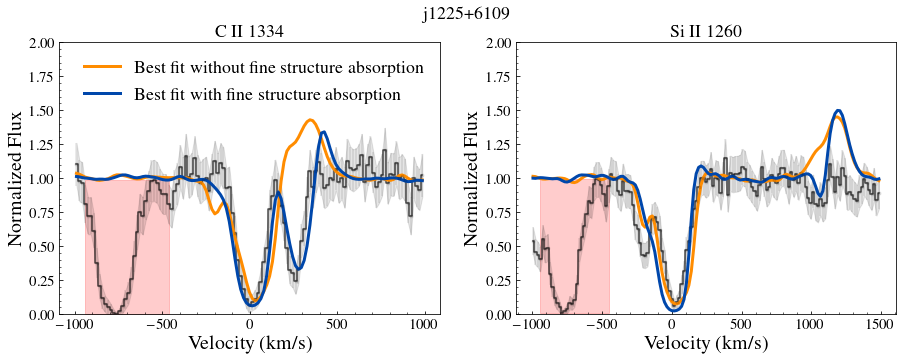

No handles with labels found to put in legend.


noFS:  261.98872851129806 215.48964696228938 477.47837547358745
FS:  130.95659061542065 122.763299273662 253.71988988908265


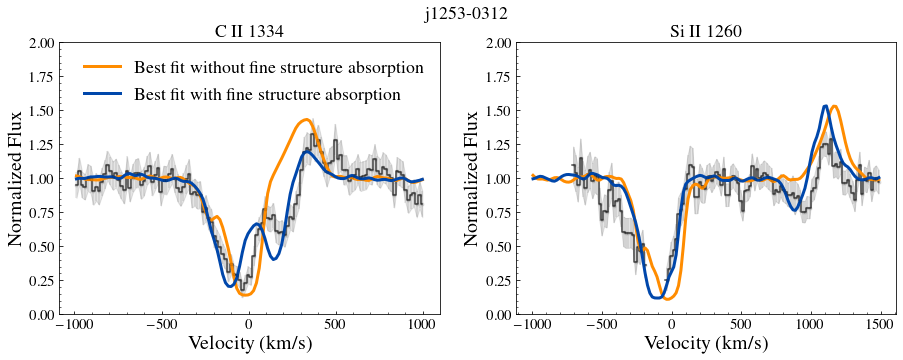

No handles with labels found to put in legend.


noFS:  829.0878716591943 411.9163101665504 1241.0041818257446
FS:  204.0520791060838 543.4101470556592 747.462226161743


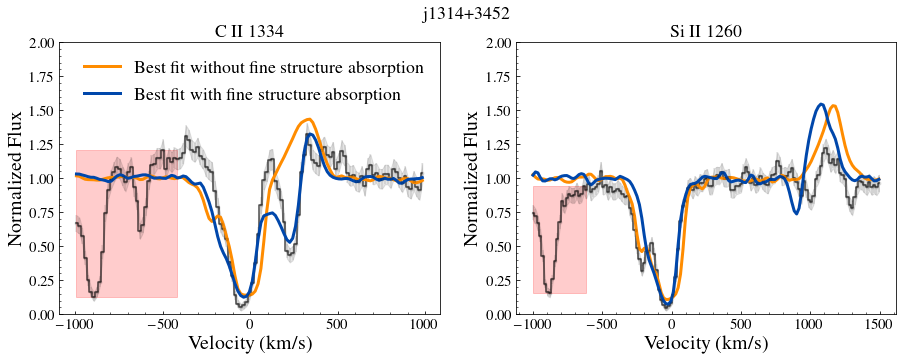

No handles with labels found to put in legend.


noFS:  56.75979090842138 103.13171986420502 159.89151077262642
FS:  47.54772932946206 114.92640555458964 162.4741348840517


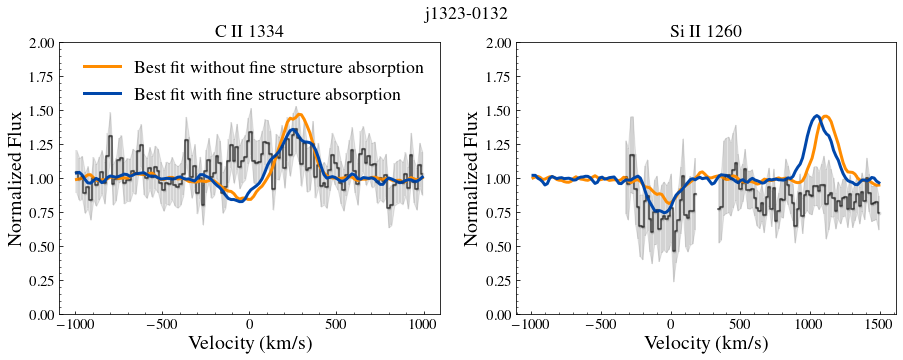

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-518-12eca64ccd54>:62: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-518-12eca64ccd54>:63: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')
No handles with labels found to put in legend.


noFS:  474.0475519679533 0.0 474.0475519679533
FS:  235.0392879417804 0.0 235.0392879417804


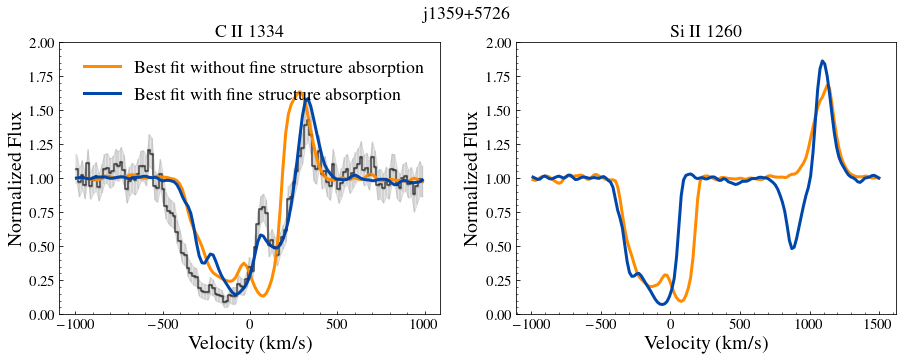

No handles with labels found to put in legend.


noFS:  710.8603860086305 60.2766697252254 771.1370557338558
FS:  565.5241272229944 70.92008629408122 636.4442135170756


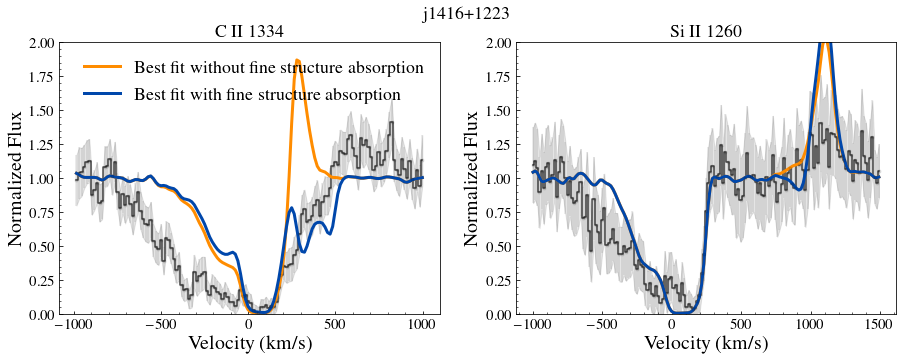

<ipython-input-518-12eca64ccd54>:62: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-518-12eca64ccd54>:63: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')
No handles with labels found to put in legend.


noFS:  99.50574217303728 32.47488452087383 131.98062669391112
FS:  25.30160987818297 25.18737734348533 50.488987221668296


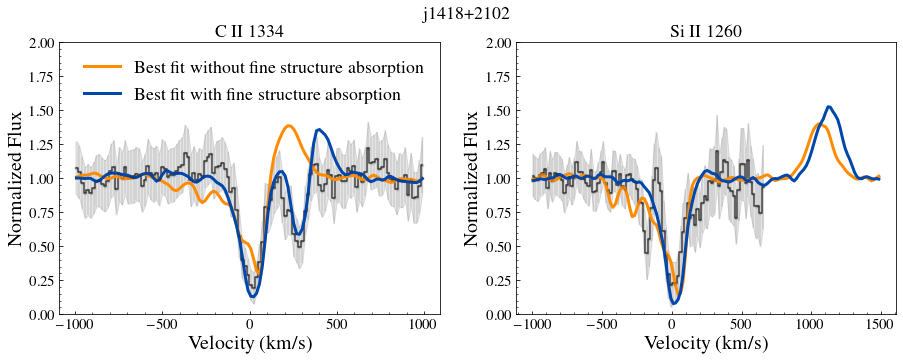

No handles with labels found to put in legend.


noFS:  33.60702037364108 24.353503420699308 57.96052379434039
FS:  29.458566480620338 26.35556511882021 55.81413159944054


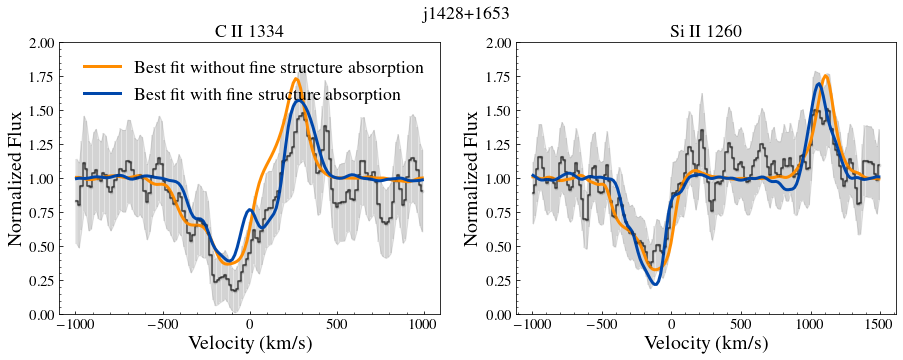

No handles with labels found to put in legend.


noFS:  52.720052683382505 47.15045388254386 99.87050656592636
FS:  28.07770984196808 53.76277427060818 81.84048411257626


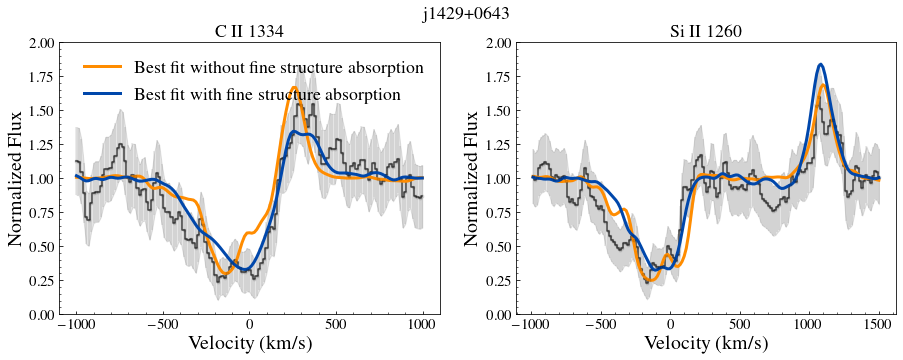

No handles with labels found to put in legend.


noFS:  60.30092265137616 81.89008784022575 142.1910104916019
FS:  33.46304755414847 85.63200100200888 119.09504855615734


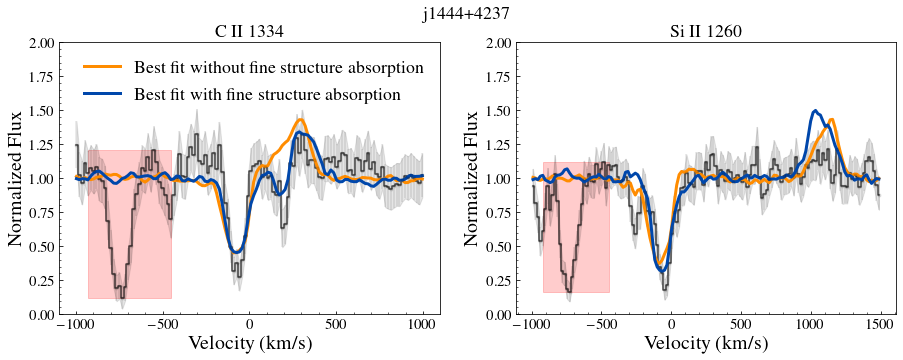

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
No handles with labels found to put in legend.


noFS:  0.0 62.055407641201626 62.055407641201626
FS:  0.0 66.16642802122063 66.16642802122063


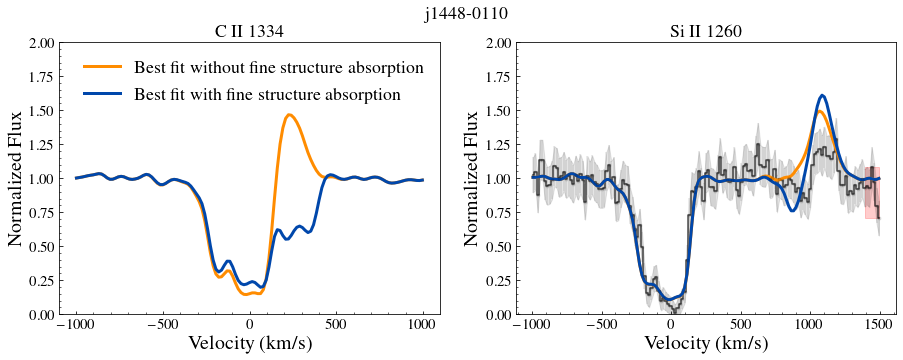

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
No handles with labels found to put in legend.


noFS:  178.539493378981 0.0 178.539493378981
FS:  88.47234769742013 0.0 88.47234769742013


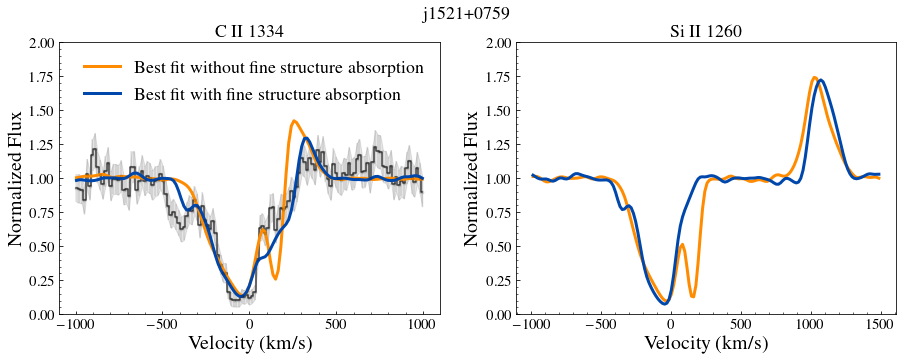

No handles with labels found to put in legend.


noFS:  862.2252562906341 234.18996146967459 1096.4152177603087
FS:  827.4031001016563 286.71486274194694 1114.1179628436032


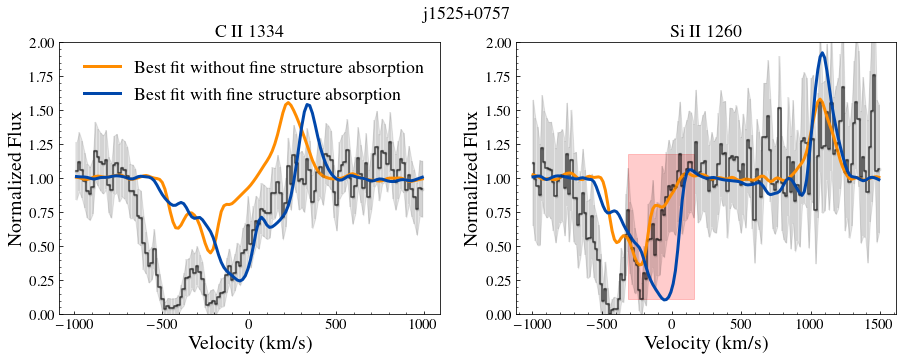

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1113: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
No handles with labels found to put in legend.


noFS:  0.0 26.886112567579733 26.886112567579733
FS:  0.0 27.754862936056952 27.754862936056952


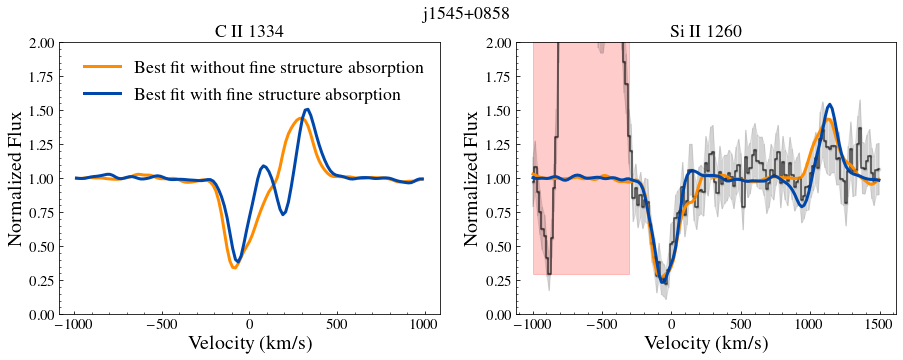

No handles with labels found to put in legend.


noFS:  1387.1957072769555 830.4713725116952 2217.667079788651
FS:  1552.9989529965817 838.2660623984383 2391.26501539502


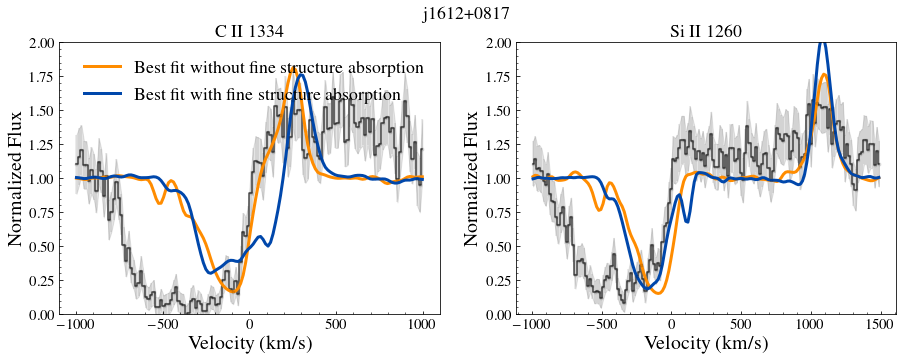

12 33


In [518]:
dfnoFS = pd.read_csv('Classy_noFS_fit.csv')
dfFS   = pd.read_csv('Classy_FS_fit.csv')
nnf = 0
nfs = 0
v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

for i in range(len(galaxy)):

    ## Plot galaxy spectra
    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    maskLya  = mask[cutLyaall]
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]

#     if(i == 4):
#         absflux[cutSiIIall] = absflux[cutSiIIall]/0.8

    rmedCII = ((vcII<-500) | (vcII > 700)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
                
        
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    axs[0].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[0].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' )#, label = 'Observed'
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[0].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
   
    
    axs[1].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[1].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  
#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[1].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')

    path_to_data1 = './CII_SiII/'   
    path_to_data2 = './CII_SiII_fine/' 

    #######################################################
    
    # no FS
    bestDir         = dfnoFS['DirAll'][i]
    bestOut         = dfnoFS['OutputAll'][i]
    bestChi2NF      = dfnoFS['x2All'][i]

    lcII, fluxcII   = read_spectrum_c(path_to_data1,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data1, bestOut )
        
        ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = res[i] /2.355/ ((vcII_s[50]-vcII_s[49]))
    model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    f              = interpolate.interp1d(vcII_s, model)
    modelNewcii    = f(vcII)
#     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
#                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
#     modelNewcii    *= alpha    
    rmedCII = ((vcII<-500) | (vcII > 700)) 
    fmedCII = np.nanmedian(modelNewcii[rmedCII])
    modelNewcii /= fmedCII
    axs[0].plot(vcII, modelNewcii, c =cnoFS, lw = 3, 
                label = 'Best fit without fine structure absorption')
#                 label = 'Best simu without FS - TS %d - Dir %d -Chi2 %.2f'%(bestOut, bestDir, bestChi2NF))
   

        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  = res[i]  /2.355/ ((vsiII_s[50]-vsiII_s[49]))
    model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
    f              = interpolate.interp1d(vsiII_s, model)
    modelNewsi     = f(vsiII)
#     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
#     modelNewsi   *= alpha
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
    fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
    modelNewsi /= fmedSiII  
    axs[1].plot(vsiII, modelNewsi, c =cnoFS, lw = 3)# label = 'fesc %.3f'%fesc900[bestOut-90, bestDir])
    
    lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
    lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
    lnlikeall  = lnlikecII + lnlikesiII
    print('noFS: ',lnlikecII, lnlikesiII, lnlikeall )
      ###################################################################                                                                                                      
                                                                                                            
    # with FS
    bestDir         = dfFS['DirAll'][i]
    bestOut         = dfFS['OutputAll'][i]
    bestChi2FS      = dfFS['x2All'][i]

    lcII, fluxcII   = read_spectrum_c(path_to_data2,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data2, bestOut )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = res[i] / 2.355/((vcII_s[50]-vcII_s[49]))
    model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    f              = interpolate.interp1d(vcII_s, model)
    modelNewcii    = f(vcII)
#     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
#                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
#     modelNewcii    *= alpha   
    rmedCII = ((vcII<-500) | (vcII > 700)) 
    fmedCII = np.nanmedian(modelNewcii[rmedCII])
    modelNewcii /= fmedCII
    axs[0].plot(vcII, modelNewcii, c =cFS, lw = 3, 
                                label = 'Best fit with fine structure absorption')

               #label = 'Best simu with FS - TS %d - Dir %d - Chi2 %.2f'%(bestOut, bestDir, bestChi2FS))
   

        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  = res[i] / 2.355/ ((vsiII_s[50]-vsiII_s[49]))
    model          = gaussian_filter(fluxsiII[bestDir,1:]/np.median(fluxsiII[bestDir,1:]), sigma = sigma_pixelsi)
    f              = interpolate.interp1d(vsiII_s, model)
    modelNewsi     = f(vsiII)
#     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
#     modelNewsi    *= alpha
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
    fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
    modelNewsi /= fmedSiII  
    axs[1].plot(vsiII, modelNewsi, c =cFS, lw = 3)# label = 'fesc %.3f'%fesc900[bestOut-90, bestDir])
    
    axs[0].legend(fontsize = 18, frameon = False)
    axs[1].legend(fontsize = 18, frameon = False)
    axs[0].set_xlabel('Velocity (km/s)', fontsize = 20,)
    axs[1].set_xlabel('Velocity (km/s)', fontsize = 20)
    axs[0].set_ylabel('Normalized Flux', fontsize = 20)
    axs[1].set_ylabel('Normalized Flux', fontsize = 20)
    
    
    axs[0].set_ylim(0,2)
    axs[1].set_ylim(0,2)
    lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
    lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
    lnlikeall  = lnlikecII + lnlikesiII
    print('FS: ',lnlikecII, lnlikesiII, lnlikeall )
    plt.suptitle(label[i])
    plt.savefig('Plots/'+label[i]+'compFS.pdf', bbox_inches = 'tight')
    if bestChi2NF < bestChi2FS:
        nnf +=1
    else:
        nfs +=1
    #
    plt.show()
print(nnf, nfs)

### Histograms of best outputs

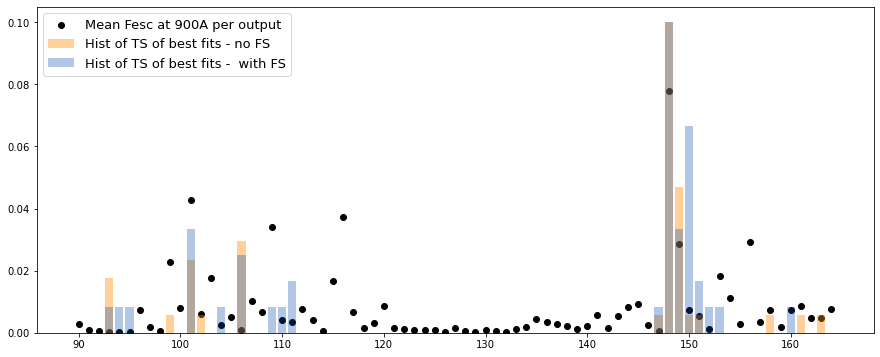

In [199]:
# OUTPUT and DIR
allOutnoFS = pd.read_csv('Classy_Zoom2_fit.csv')['Output']
outputBest = bestoutall[:,0]
# output10best = bestoutall
fig, axs = plt.subplots(1,1,figsize=(15,6))
# hist2 = axs[1].hist(allOutnoFS, bins = range(90,165,1), density = True)
# hist = axs[0].hist(outputBest, bins = range(90,165,1), density = True)
# axs[1].hist((output10best.flatten()), bins = range(90,165,1))
# axs.set_title('Best output with FS')
# axs[1].set_title('Best 10 outputs')
# print(fesc900M.shape)
allvalues = np.insert(hist[0],len(hist[0]),0)
allvalnoFS = np.insert(hist2[0],len(hist2[0]),0)
axs.scatter(range(90,165,1), fesc900M, label = 'Mean Fesc at 900A per output', c= 'k')
axs.bar(range(90,165,1), allvalnoFS/max(allvalnoFS)/10, alpha = 0.4,label = 'Hist of TS of best fits - no FS',
          color = cnoFS)
axs.bar(range(90,165,1), allvalues/max(allvalues)/10, alpha = 0.3,label = 'Hist of TS of best fits -  with FS',
           color = cFS)


axs.legend(fontsize = 13)


# axs[1].scatter(range(90,165,1), fescfesc900M_med, label = 'Median Fesc per output')
# axs[1].bar(range(90,165,1), allvalues/max(allvalues)/10, alpha = 0.5,label = 'Hist of best ouputs for CLASSY')
# axs[1].legend(fontsize = 15)




## Different dust model

FS:  64.50541241715376 43.798761666265406 108.30417408341917


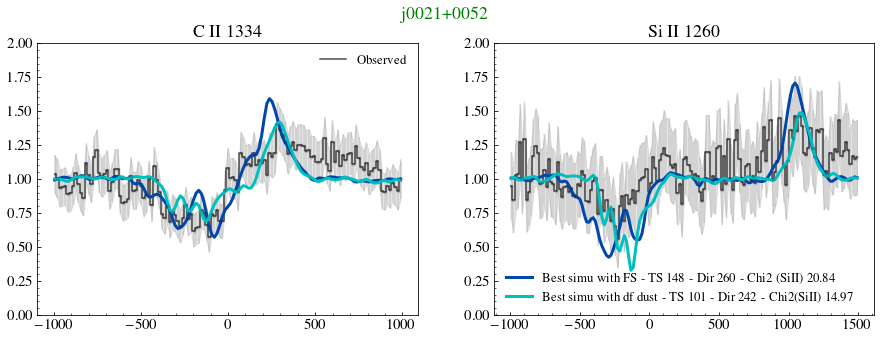

FS:  591.050215097876 388.49092684326115 979.5411419411372


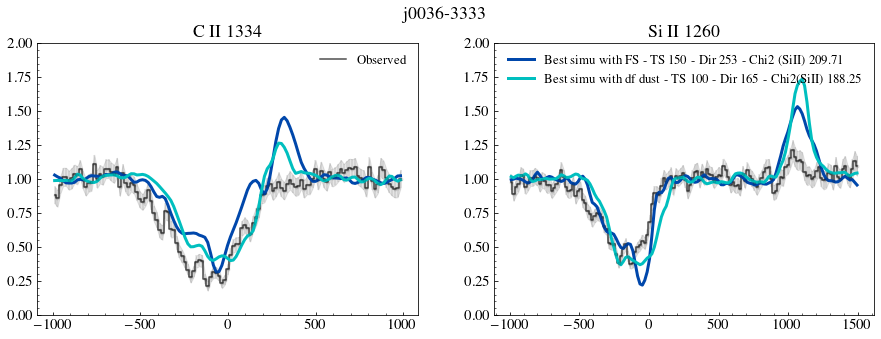

FS:  42.621940701260684 96.80012478174892 139.4220654830096


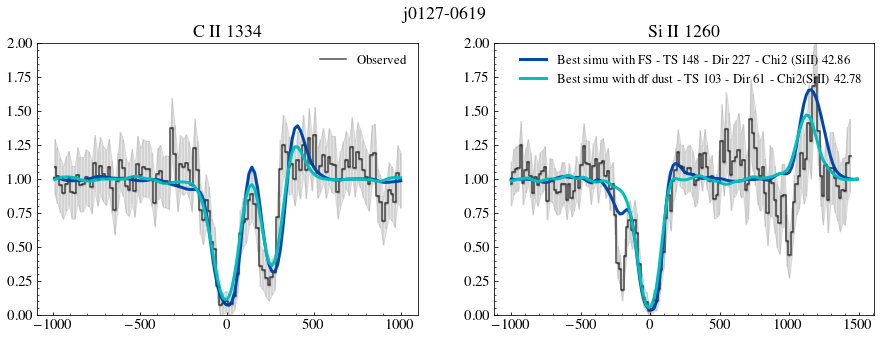

FS:  29.287093418495544 60.44541828986651 89.73251170836205


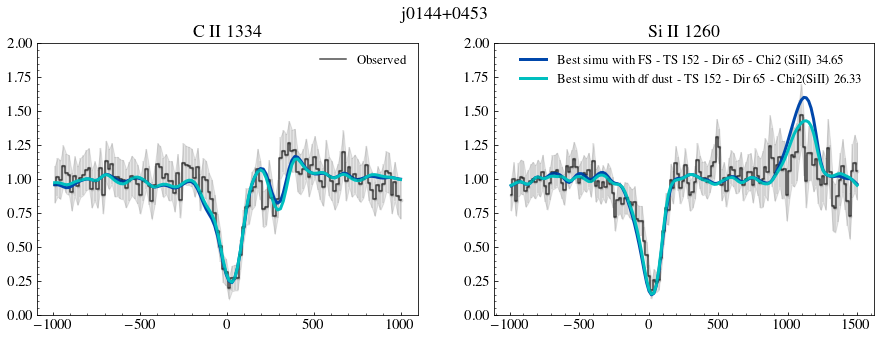

FS:  154.49157899872122 272.64907340995626 427.1406524086775


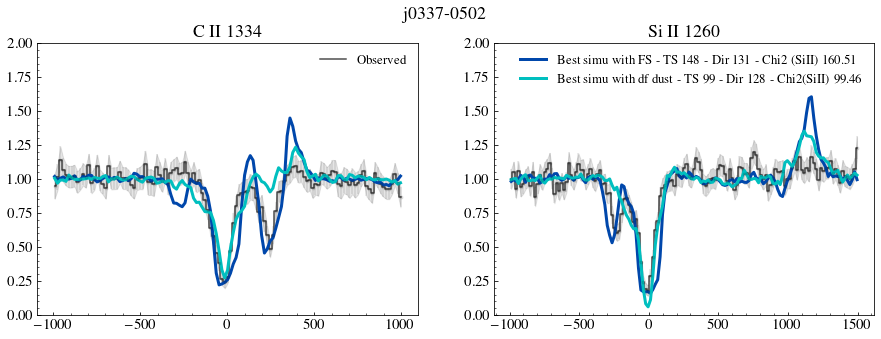

FS:  42.404051032801824 121.11656132476179 163.5206123575636


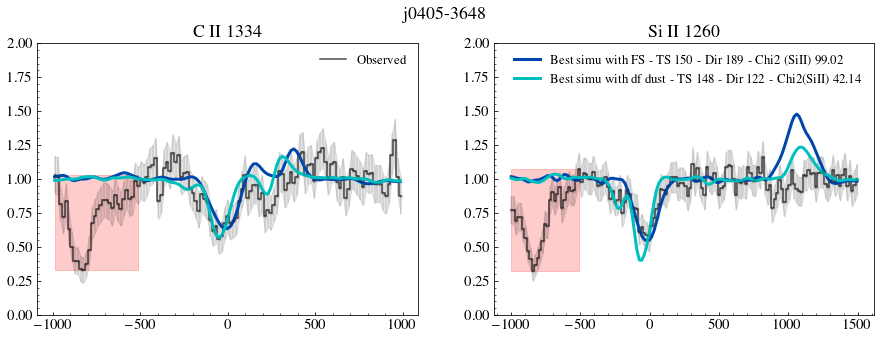

FS:  39.180496583766505 68.69774332744583 107.87823991121235


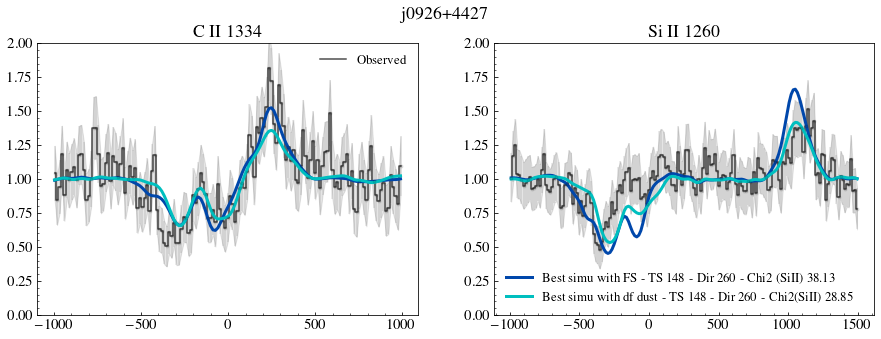

FS:  284.29755364150463 725.9688708237791 1010.2664244652838


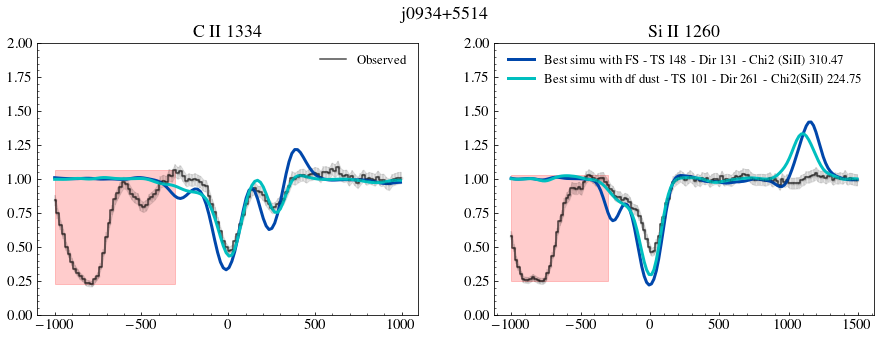

FS:  65.4343501539799 85.38044287209827 150.81479302607818


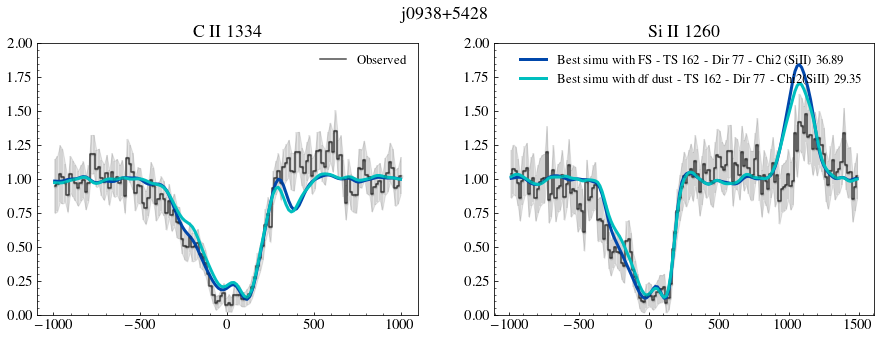

FS:  25.198683918759254 103.6472612614249 128.84594518018415


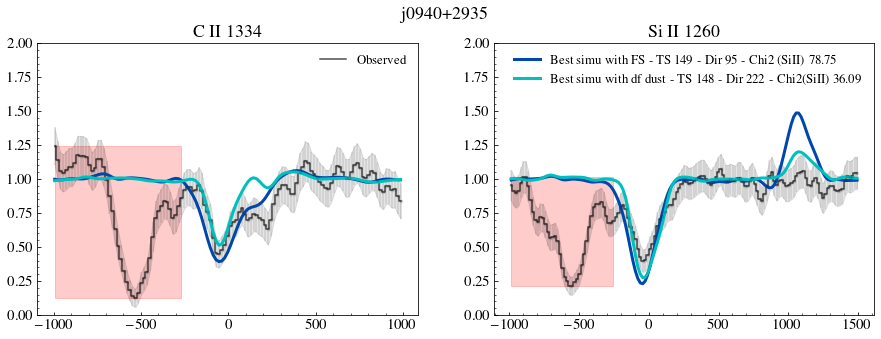

FS:  92.12858834381086 0.0 92.12858834381086


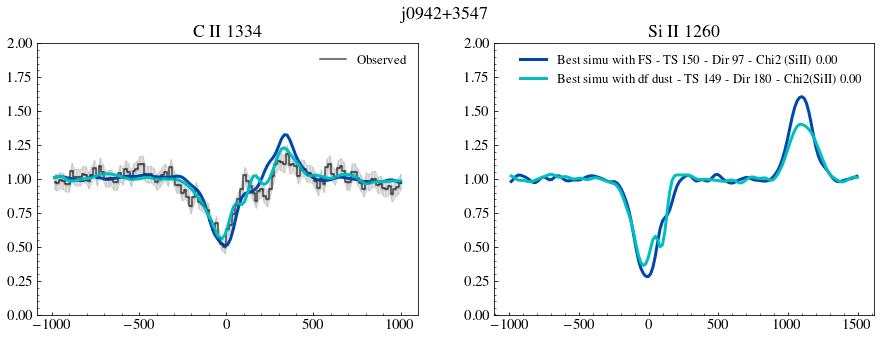

FS:  10.448542921558408 29.785120719585535 40.23366364114394


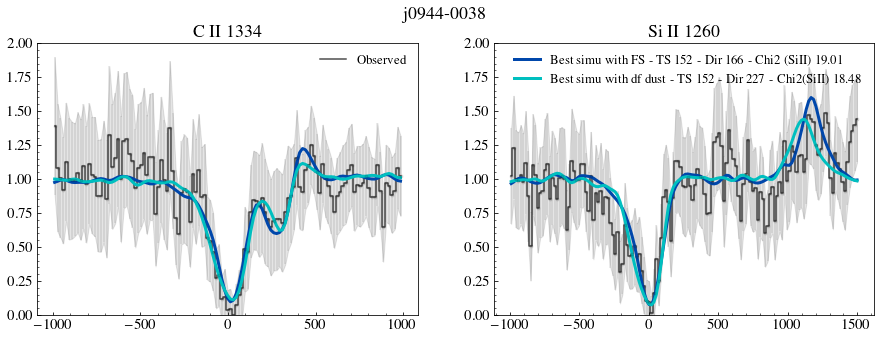

FS:  6.362239522170513 0.0 6.362239522170513


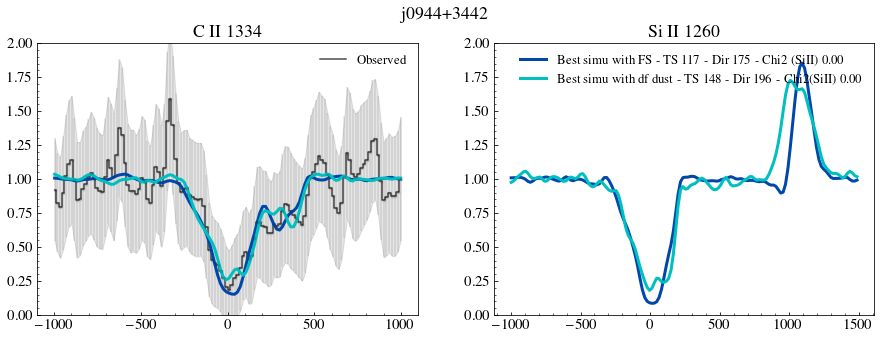

FS:  25.555032642101494 73.40847584097091 98.9635084830724


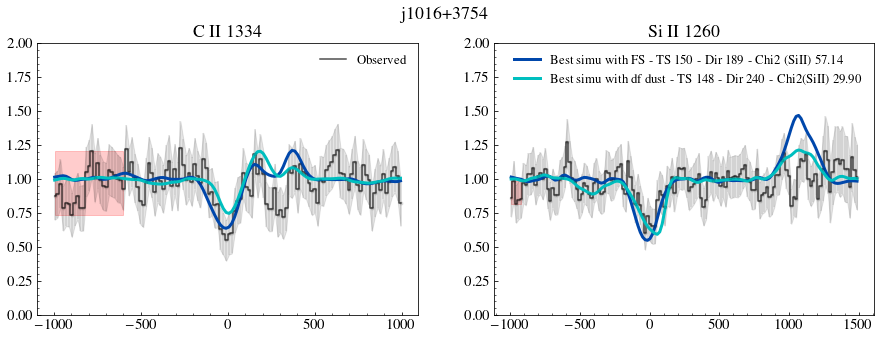

FS:  0.0 77.70570158003021 77.70570158003021


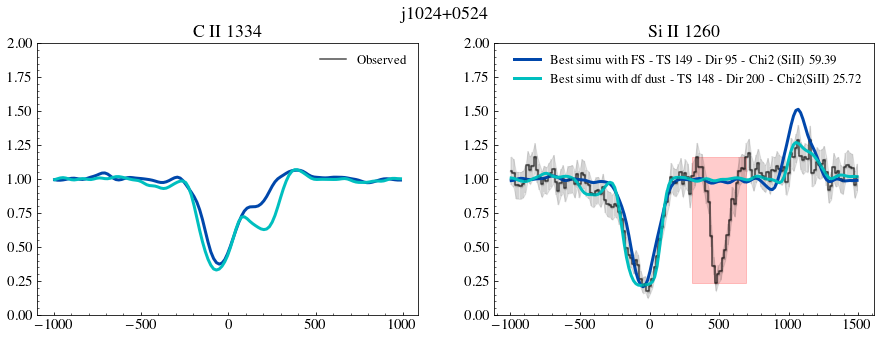

FS:  68.3809526942738 31.51297232753805 99.89392502181185


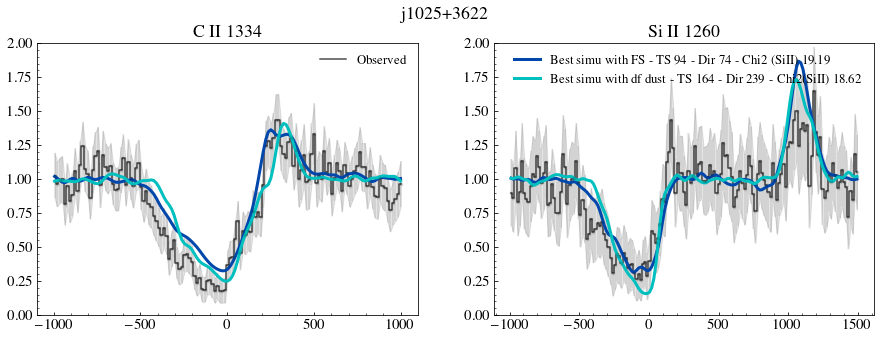

FS:  52.209533644075655 0.0 52.209533644075655


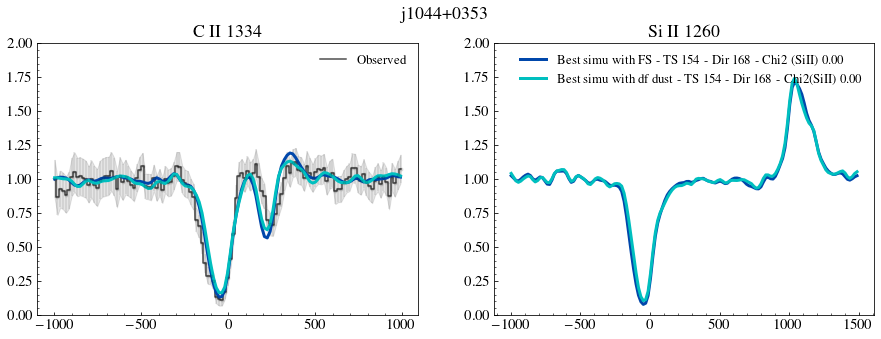

FS:  0.0 463.52779279380235 463.52779279380235


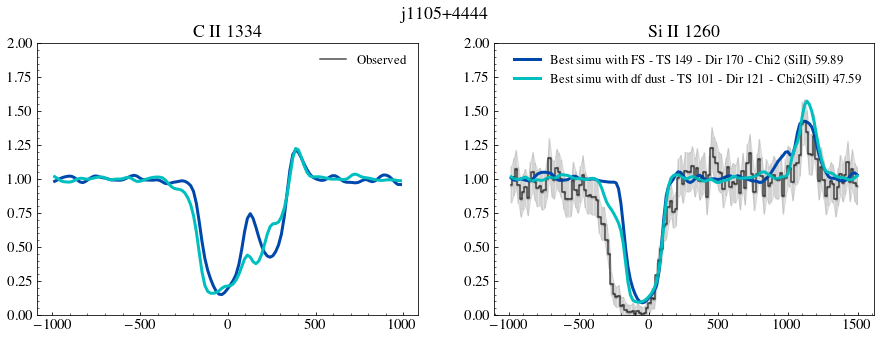

FS:  44.39949041248142 86.90463388853075 131.30412430101217


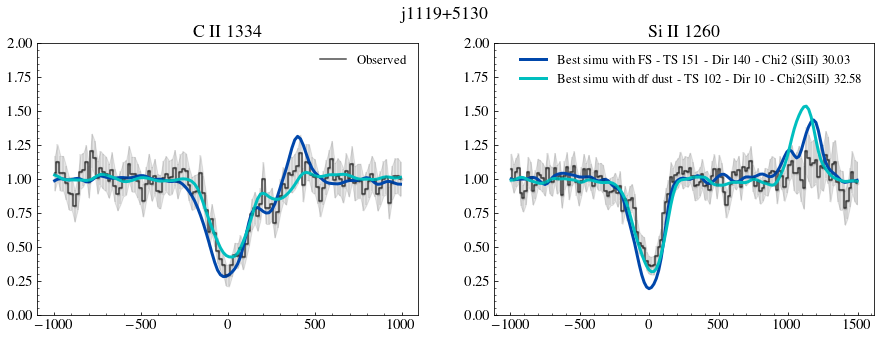

FS:  65.8441099922881 227.04371057900966 292.88782057129777


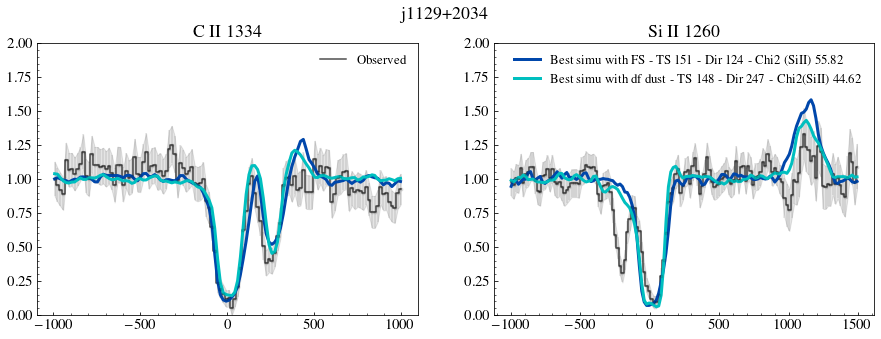

FS:  31.81843227887269 0.0 31.81843227887269


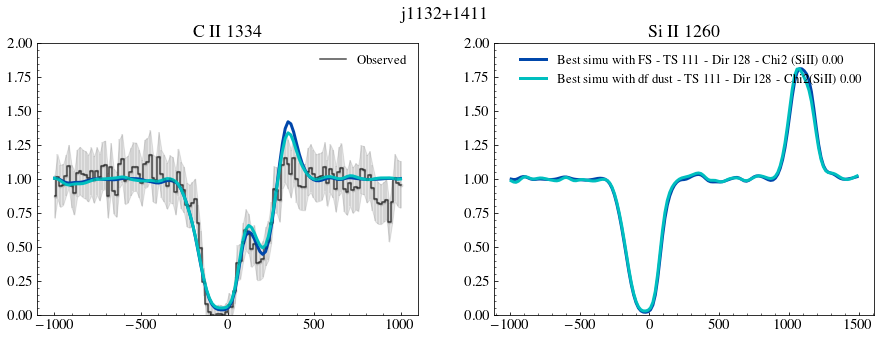

FS:  10.202463617247641 27.197913193473767 37.40037681072141


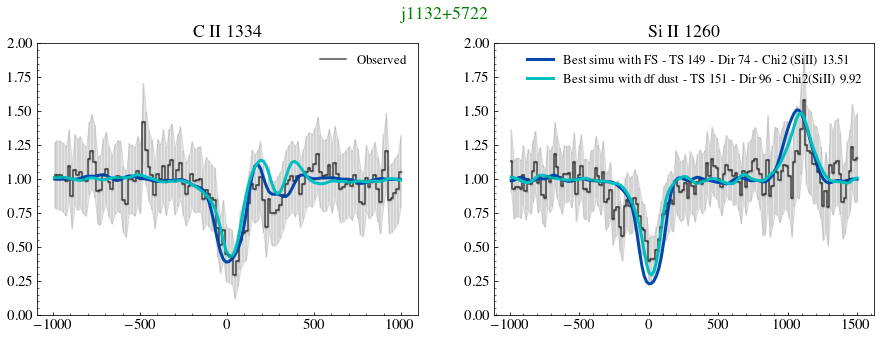

FS:  0.0 135.8822705088185 135.8822705088185


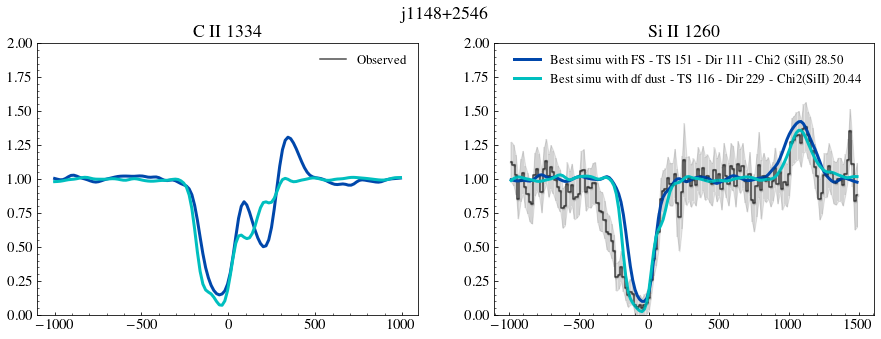

FS:  54.99018873525122 280.0728042409545 335.0629929762057


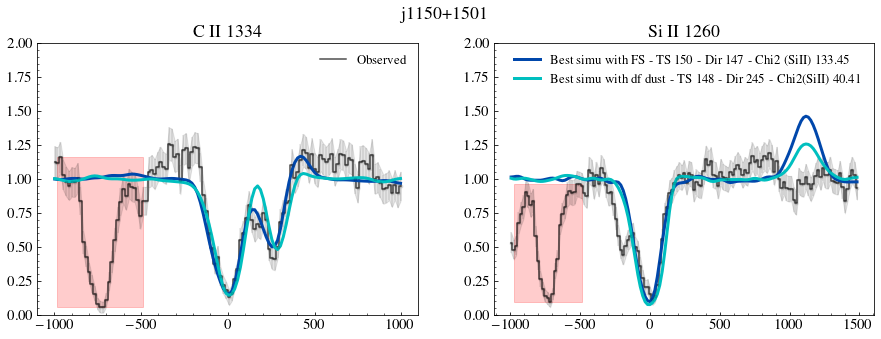

FS:  61.46831975570923 0.0 61.46831975570923


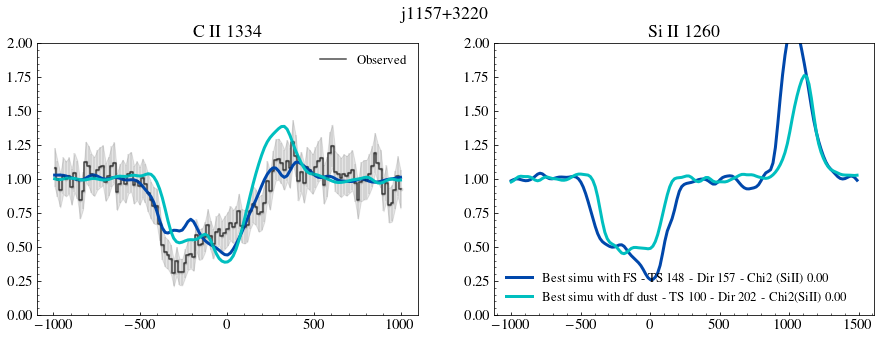

FS:  0.0 83.0553208031884 83.0553208031884


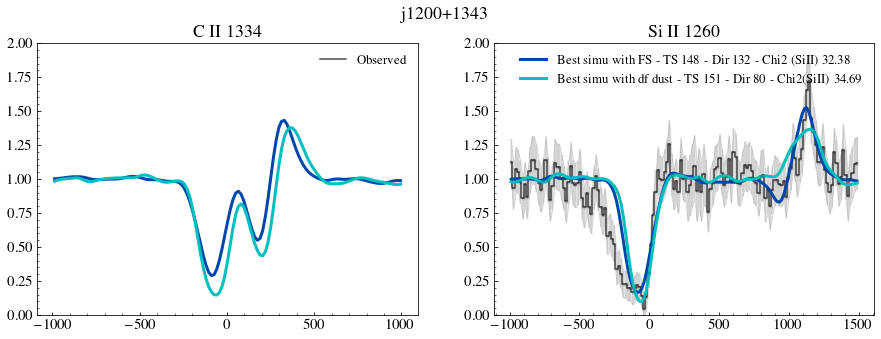

FS:  43.36987412788191 242.04406970641756 285.41394383429946


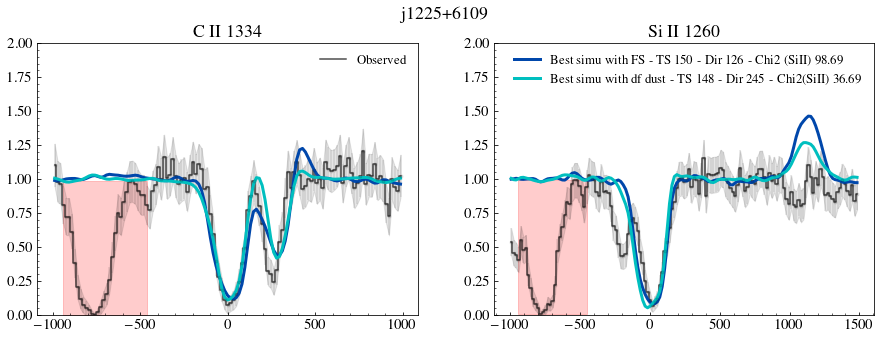

FS:  49.97317463713689 223.98140855760826 273.95458319474517


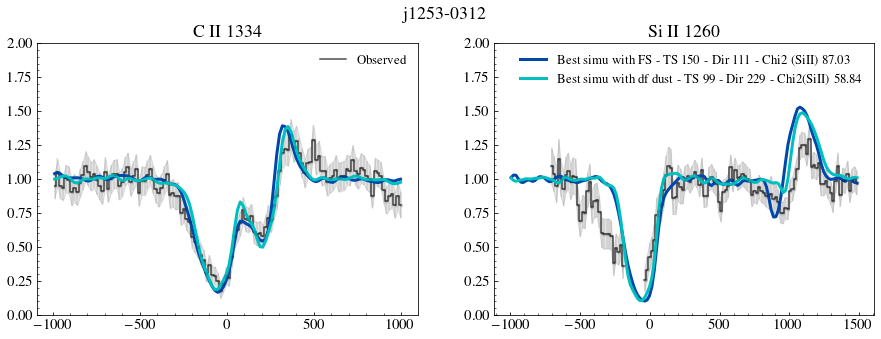

FS:  187.5321357806154 692.268242223706 879.8003780043214


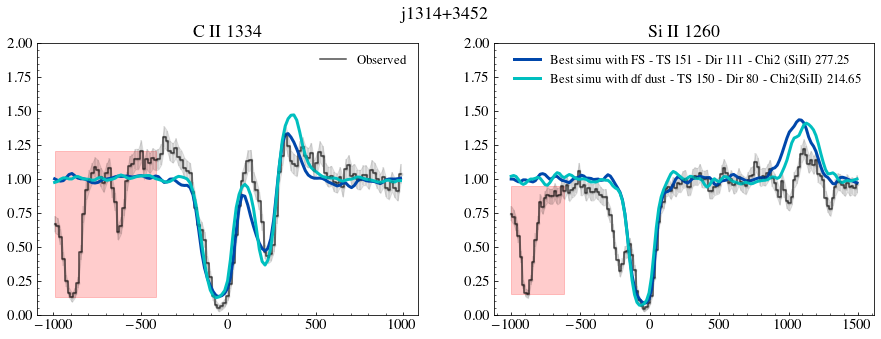

FS:  47.54772932946206 114.92640555458968 162.47413488405175


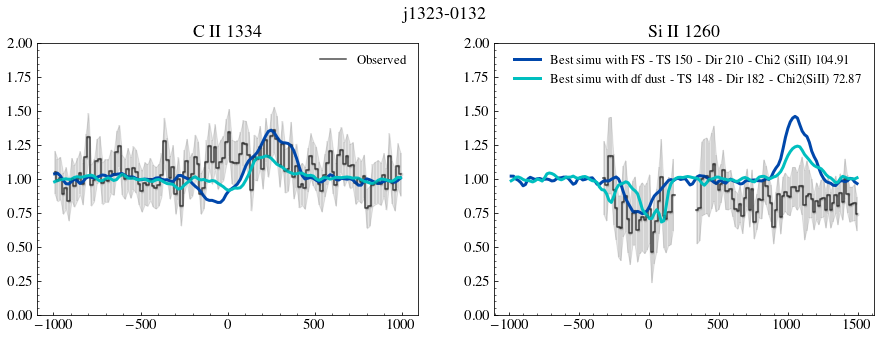

FS:  235.0392879417804 0.0 235.0392879417804


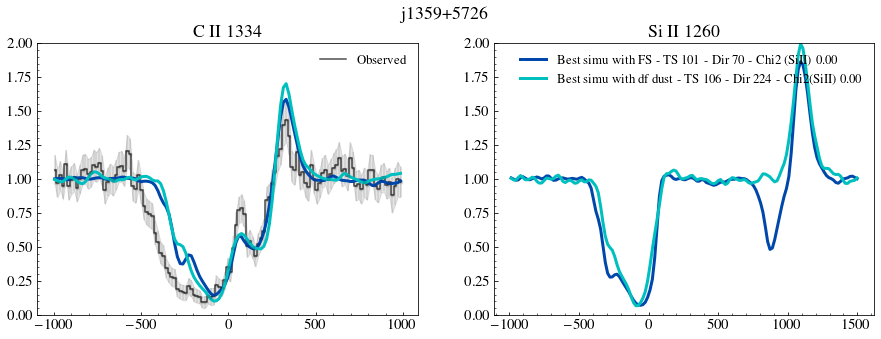

FS:  21.908795212047487 29.156029592527034 51.06482480457452


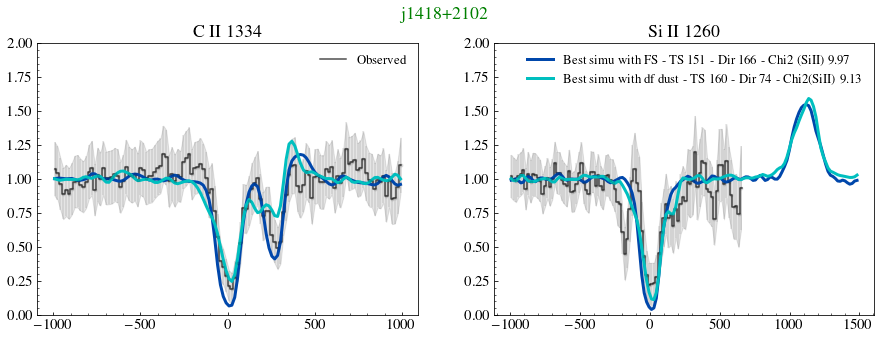

FS:  29.458566480620338 26.35556511882021 55.81413159944054


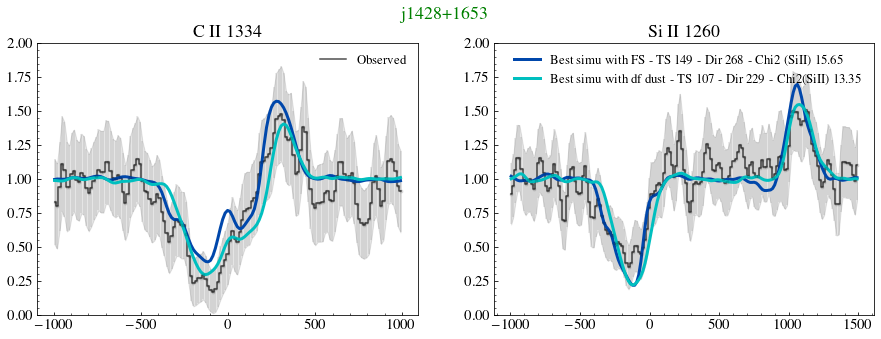

FS:  28.07770984196808 53.76277427060806 81.84048411257615


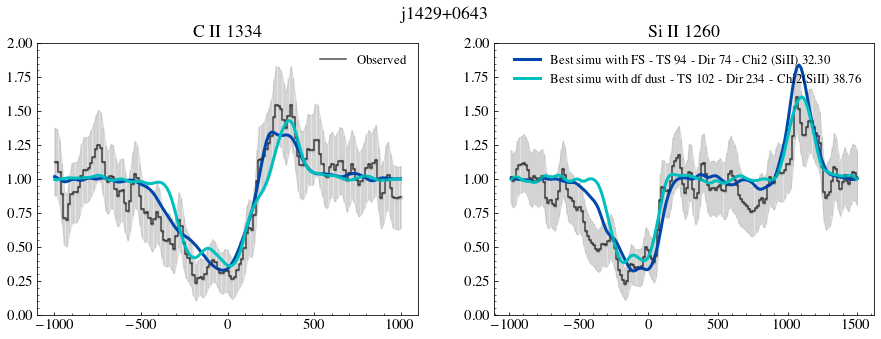

FS:  33.46304755414847 85.6320010020088 119.09504855615728


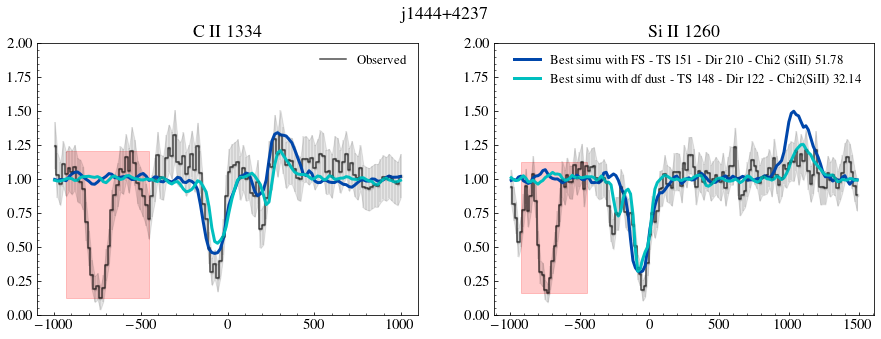

FS:  0.0 99.51610530220802 99.51610530220802


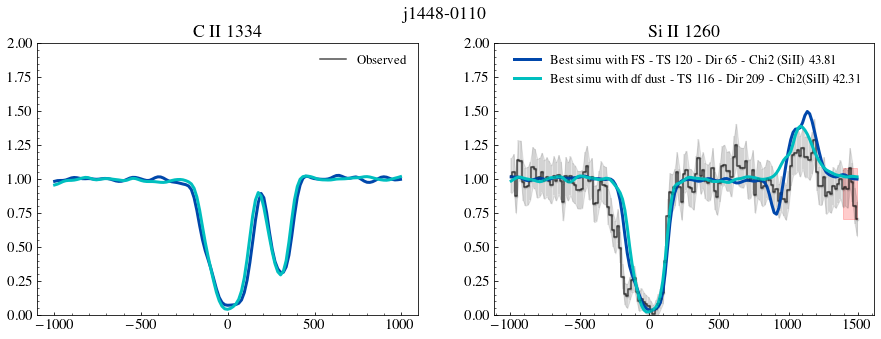

FS:  88.47234769742013 0.0 88.47234769742013


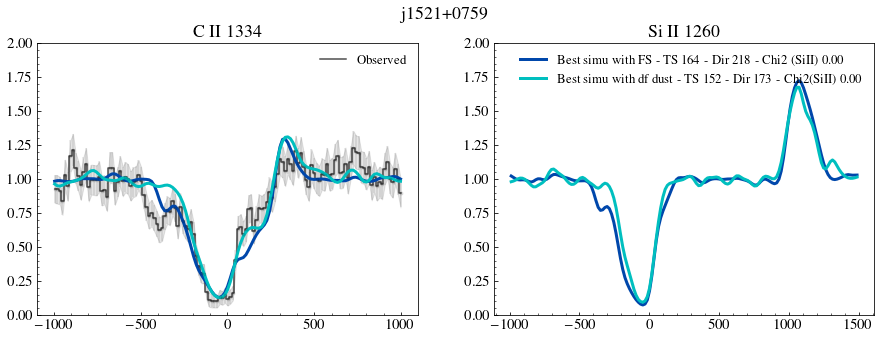

FS:  0.0 27.754862936056938 27.754862936056938


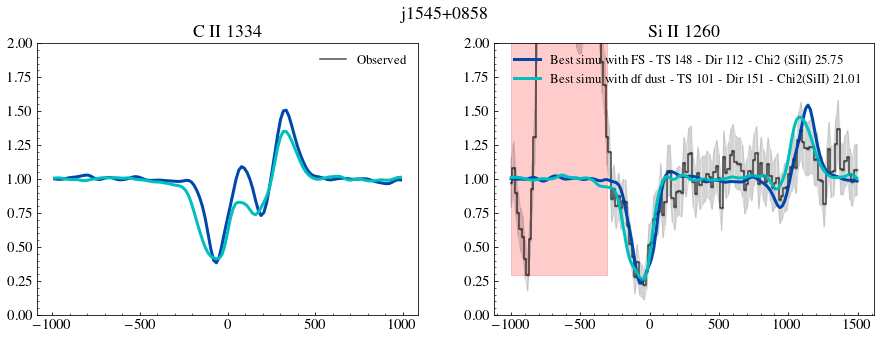

In [139]:
dfnoFS = pd.read_csv('csv/Classy_noFS_fit.csv')
dfFS   = pd.read_csv('csv/Classy_FS_fit.csv')
dfdust = pd.read_csv('csv/Classy_dust_fit.csv')
nnf = 0
nfs = 0
v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

for i in range(len(galaxy)):

    if(label[i].upper() in maskGal):
        continue
    ## Plot galaxy spectra
    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    maskLya  = mask[cutLyaall]
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]

#     if(i == 4):
#         absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
    
    rmedCII = ((vcII<-500) | (vcII > 700)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
        
        
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    axs[0].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[0].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[0].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
   
    
    axs[1].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[1].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  
#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[1].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')

    path_to_data1 = './CII_SiII/'   
    path_to_data2 = './CII_SiII_fine/' 
    path_to_data3 = './CII_SiII_ND/' 

    #######################################################
    
    # no FS
#     bestDir         = dfnoFS['DirAll'][i]
#     bestOut         = dfnoFS['OutputAll'][i]
#     bestChi2NF      = dfnoFS['x2siII'][i]

#     lcII, fluxcII   = read_spectrum_c(path_to_data1,  bestOut )
#     lsiII, fluxsiII = read_spectrum_si(path_to_data1, bestOut )
        
#         ## CII Plot
#     lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
#     lcII_systemic  = lcII_systemic[1:]
#     vcII_s         = (lcII_systemic/wcII1334 -1)*c
#     sigma_pixelcii = res[i] /2.355/ ((vcII_s[50]-vcII_s[49]))
#     model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
#     f              = interpolate.interp1d(vcII_s, model)
#     modelNewcii    = f(vcII)
# #     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
# #                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
# #     modelNewcii    *= alpha    
#     rmedCII = ((vcII<-500) | (vcII > 700)) 
#     fmedCII = np.nanmedian(modelNewcii[rmedCII])
#     modelNewcii /= fmedCII


#     axs[0].plot(vcII, modelNewcii, c =cnoFS, lw = 3)
   

#         ## Si II plot
#     lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
#     lsiII_systemic = lsiII_systemic[1:]
#     vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
#     sigma_pixelsi  = res[i]  /2.355/ ((vsiII_s[50]-vsiII_s[49]))
#     model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
#     f              = interpolate.interp1d(vsiII_s, model)
#     modelNewsi     = f(vsiII)
# #     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
# #                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
# #     modelNewsi   *= alpha
#     rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
#     fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
#     modelNewsi /= fmedSiII    
#     lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)

#     axs[1].plot(vsiII, modelNewsi, c =cnoFS, lw = 3,
#                label = 'Best simu without FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2NF))
    
#     lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
#     lnlikeall  = lnlikecII + lnlikesiII
#     print('noFS: ',lnlikecII, lnlikesiII, lnlikeall )
      ###################################################################                                                                                                      
                                                                                                            
    # with FS
    bestDir         = dfFS['DirAll'][i]
    bestOut         = dfFS['OutputAll'][i]
    bestChi2FS      = dfFS['x2siII'][i]

    lcII, fluxcII   = read_spectrum_c(path_to_data2,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data2, bestOut )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = res[i] / 2.355/((vcII_s[50]-vcII_s[49]))
    model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    f              = interpolate.interp1d(vcII_s, model)
    modelNewcii    = f(vcII)
#     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
#                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
#     modelNewcii    *= alpha  
    rmedCII = ((vcII<-500) | (vcII > 700)) 
    fmedCII = np.nanmedian(modelNewcii[rmedCII])
    modelNewcii /= fmedCII
    axs[0].plot(vcII, modelNewcii, c =cFS, lw = 3)
   

        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  = res[i] / 2.355/ ((vsiII_s[50]-vsiII_s[49]))
    model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
    f              = interpolate.interp1d(vsiII_s, model)
    modelNewsi     = f(vsiII)
#     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
#     modelNewsi    *= alpha    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
    fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
    modelNewsi /= fmedSiII  
    
    lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
    lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
    lnlikeall  = lnlikecII + lnlikesiII
    axs[1].plot(vsiII, modelNewsi, c =cFS, lw = 3, 
                label = 'Best simu with FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2FS))
    

    axs[0].set_ylim(0,2)
    axs[1].set_ylim(0,2)

    print('FS: ',lnlikecII, lnlikesiII, lnlikeall )
    t = plt.suptitle(label[i])
#     plt.savefig(label[i]+'comp.pdf', bbox_inches = 'tight')

    # DIFF DUST
      ###################################################################                                                                                                      

    bestDir         = dfdust['DirAll'][i]
    bestOut         = dfdust['OutputAll'][i]
    bestChi2dust      = dfdust['x2siII'][i]

    lcII, fluxcII   = read_spectrum_c(path_to_data3,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data3, bestOut )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = res[i] / 2.355/((vcII_s[50]-vcII_s[49]))
    model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    f              = interpolate.interp1d(vcII_s, model)
    modelNewcii    = f(vcII)
#     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
#                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
#     modelNewcii    *= alpha  
    rmedCII = ((vcII<-500) | (vcII > 700)) 
    fmedCII = np.nanmedian(modelNewcii[rmedCII])
    modelNewcii /= fmedCII
    axs[0].plot(vcII, modelNewcii, c ='c', lw = 3)
   

        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  = res[i] / 2.355/ ((vsiII_s[50]-vsiII_s[49]))
    model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
    f              = interpolate.interp1d(vsiII_s, model)
    modelNewsi     = f(vsiII)
#     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
#     modelNewsi    *= alpha 
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
    fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
    modelNewsi /= fmedSiII  
    
    lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
    lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
    lnlikeall  = lnlikecII + lnlikesiII
    axs[1].plot(vsiII, modelNewsi, c ='c', lw = 3, 
                label = 'Best simu with df dust - TS %d - Dir %d - Chi2(SiII) %.2f'%(bestOut, bestDir, bestChi2dust))
    axs[0].legend(fontsize = 13, frameon = False)
    axs[1].legend(fontsize = 13, frameon = False)

    if(bestChi2dust< bestChi2FS and bestChi2dust<bestChi2NF):
        plt.setp(t, color='g')         #set the color of title to red

    plt.show()

## Depletion Vturb - compared to diff dust

Depletion:  44.7095449080644 25.999245659793395 70.70879056785779


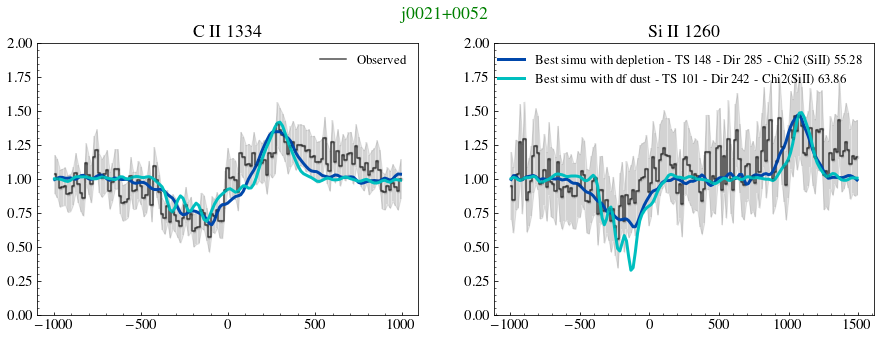

Depletion:  381.3864352933011 339.17503570435065 720.5614709976517


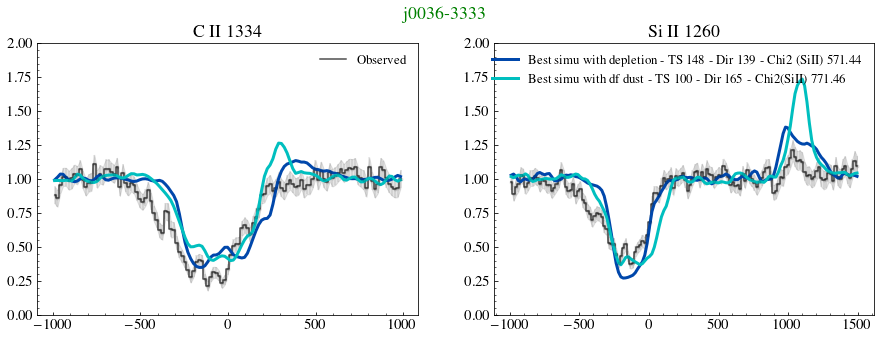

Depletion:  41.54219222218556 123.66268493943362 165.20487716161918


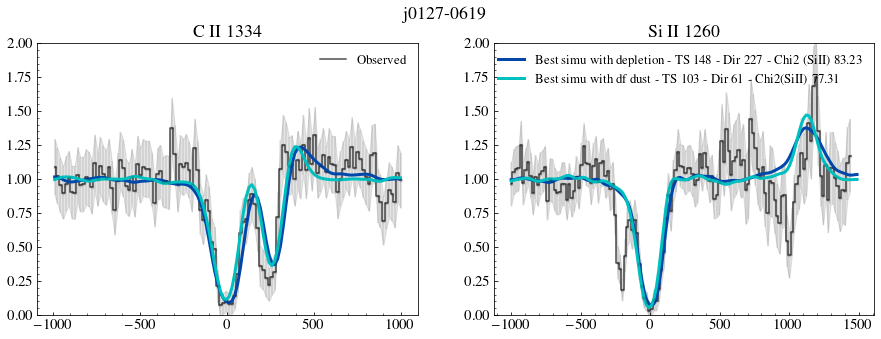

Depletion:  37.667537813858836 40.08567756652007 77.7532153803789


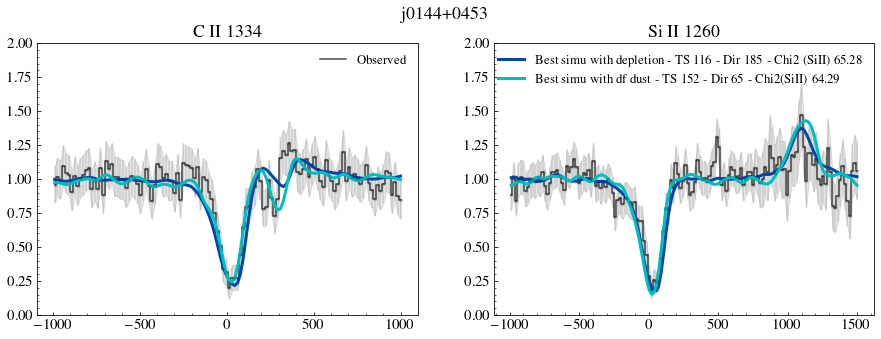

Depletion:  105.8217689510768 191.57150109557116 297.39327004664796


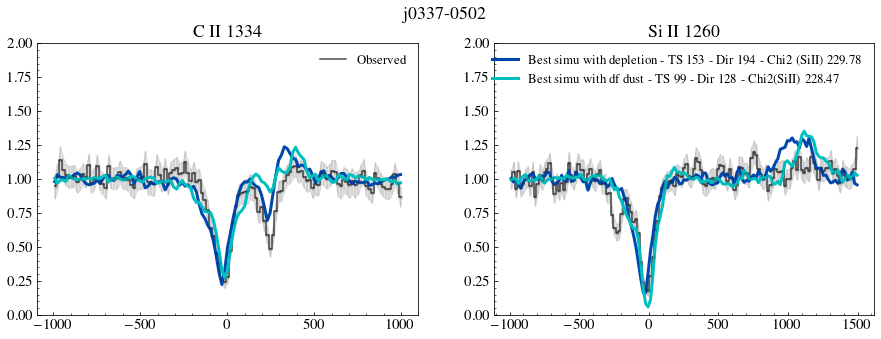

Depletion:  28.6591916871529 52.693394784031724 81.35258647118462


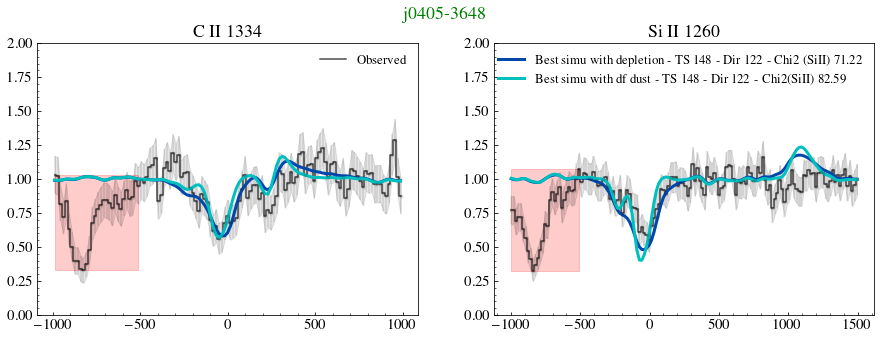

Depletion:  43.71570255542912 56.938976635158966 100.65467919058808


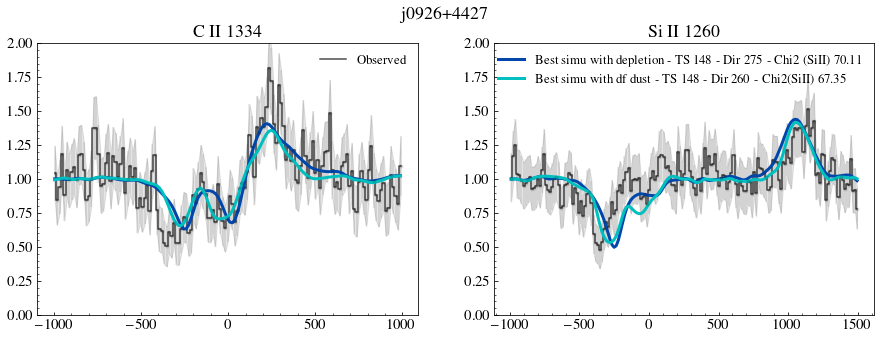

Depletion:  101.70705278102209 421.66303378383265 523.3700865648548


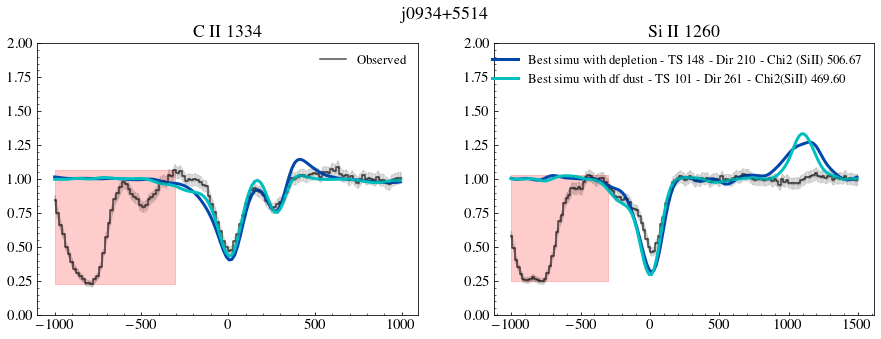

Depletion:  74.8916611312159 64.65803487417877 139.54969600539465


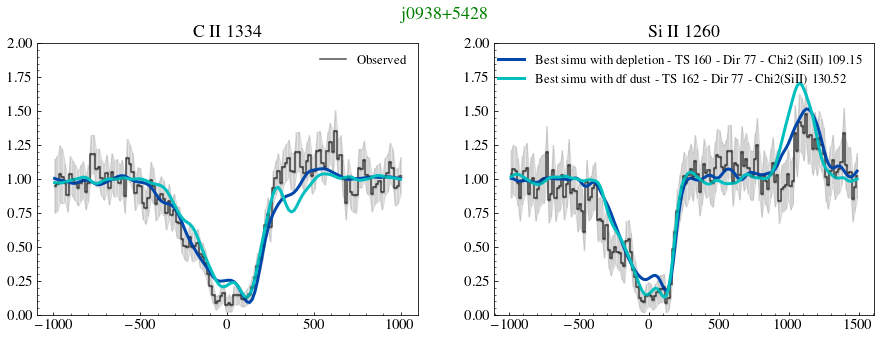

Depletion:  31.03174139267592 35.464490769219104 66.49623216189502


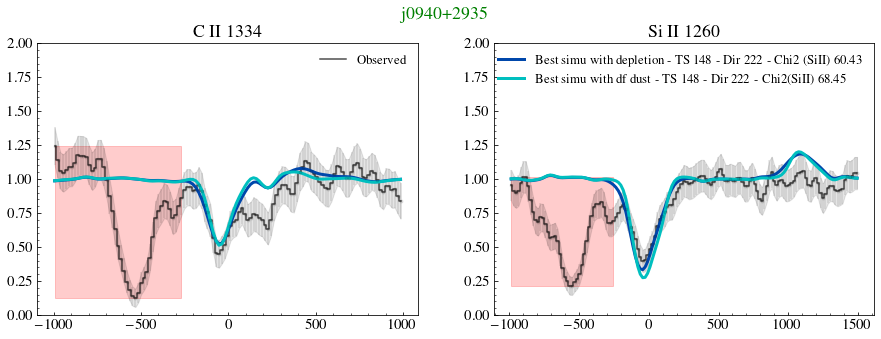

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1739567052.py:67: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1739567052.py:68: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


Depletion:  42.50221423506925 0.0 42.50221423506925


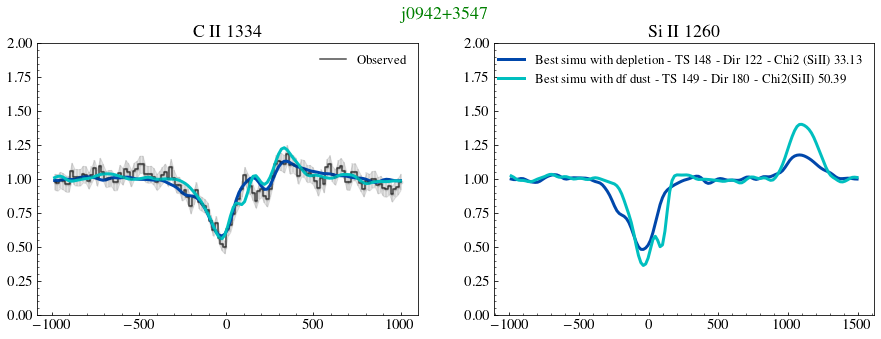

Depletion:  11.133825497059833 31.010179092221154 42.14400458928099


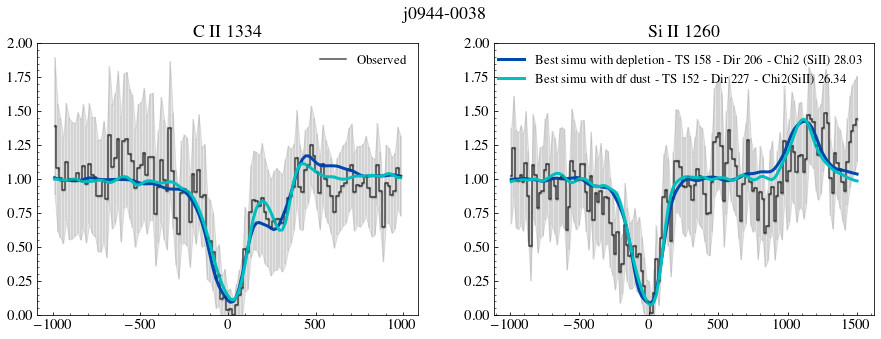

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1739567052.py:67: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1739567052.py:68: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


Depletion:  5.4776317862812265 0.0 5.4776317862812265


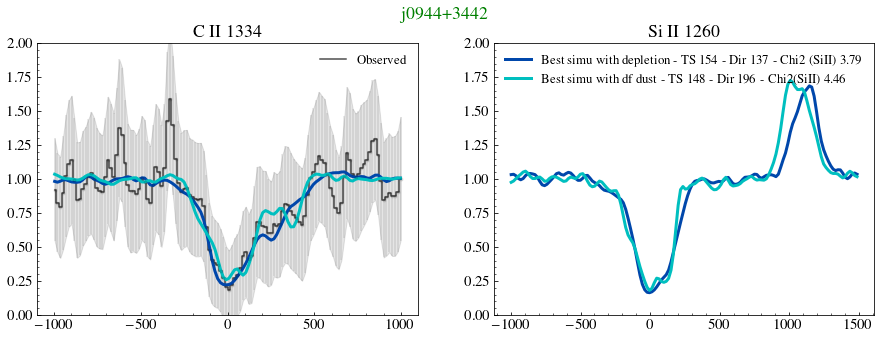

Depletion:  28.424283994003975 38.17736222458314 66.60164621858712


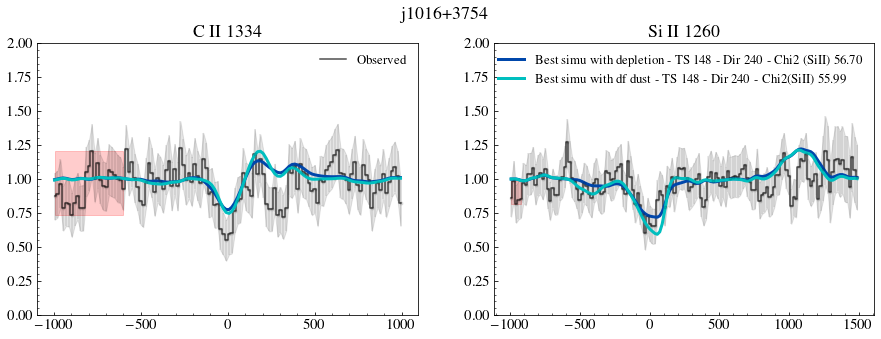

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


Depletion:  0.0 43.447949580468 43.447949580468


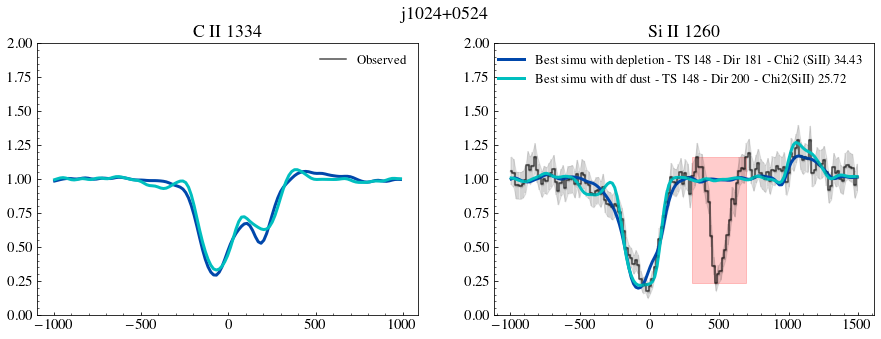

Depletion:  47.54044530606198 38.07076831964875 85.61121362571073


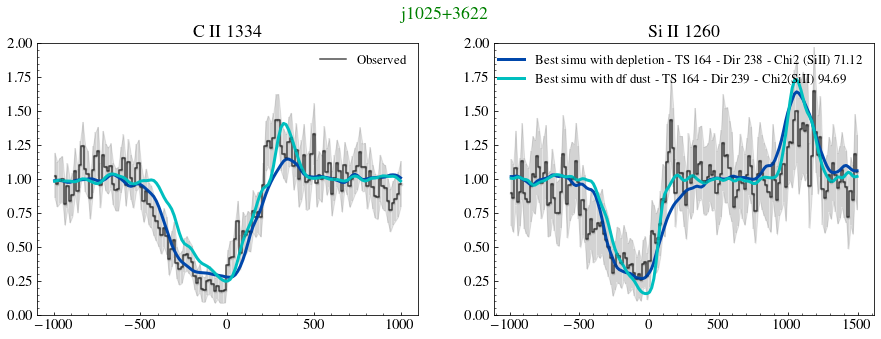

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1739567052.py:67: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1739567052.py:68: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


Depletion:  58.93324960102158 0.0 58.93324960102158


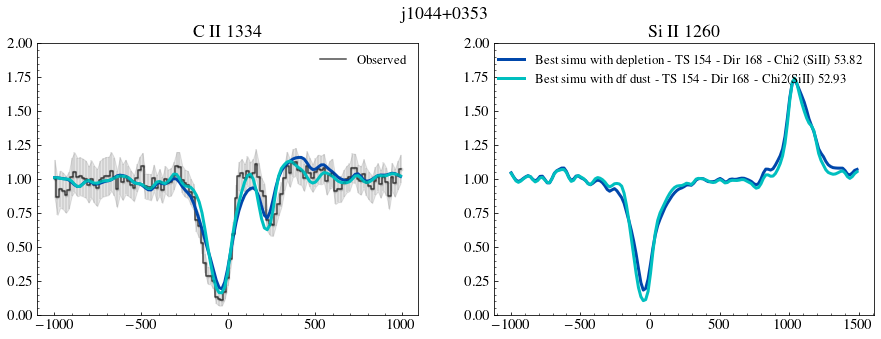

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1739567052.py:58: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),


Depletion:  0.0 215.18744569250032 215.18744569250032


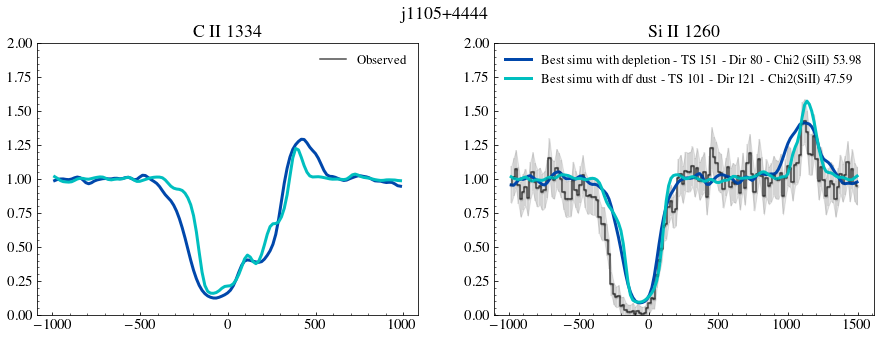

Depletion:  43.99531619103981 40.43419225975466 84.42950845079447


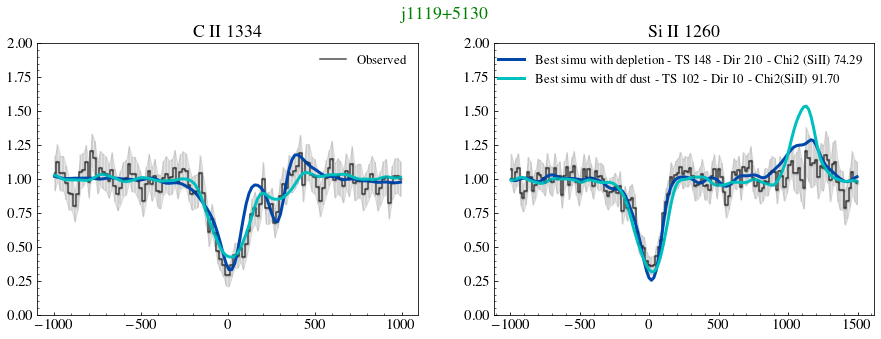

Depletion:  88.38271241403702 193.73899312510434 282.1217055391414


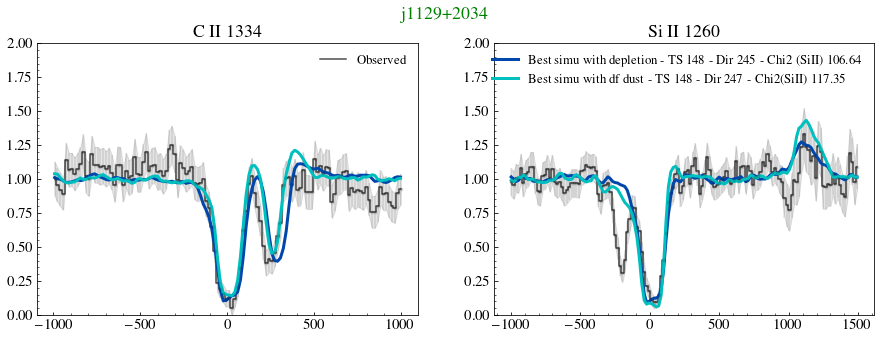

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


Depletion:  35.04410624155438 0.0 35.04410624155438


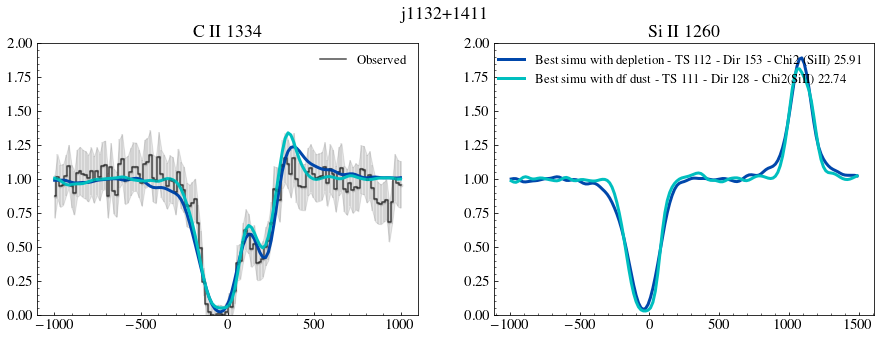

Depletion:  11.027599608750448 19.302643825603013 30.330243434353463


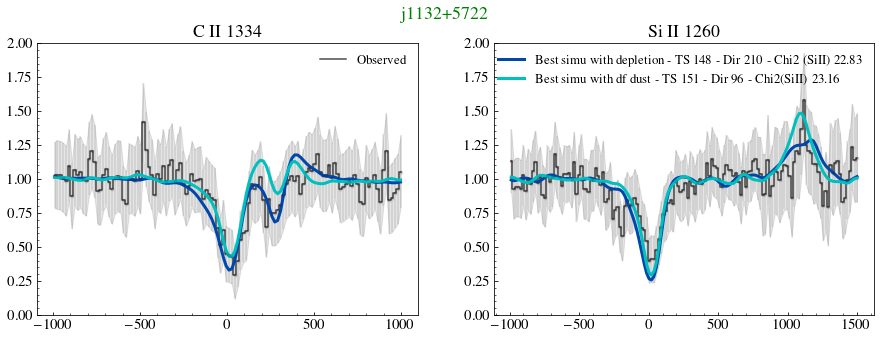

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1739567052.py:58: RuntimeWarning: All-NaN slice encountered
  axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]),


Depletion:  0.0 84.15608193070662 84.15608193070662


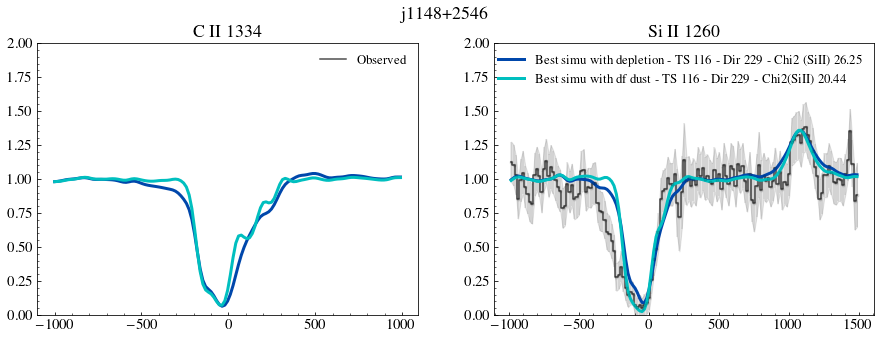

Depletion:  108.31862120461037 192.3434809179488 300.6621021225592


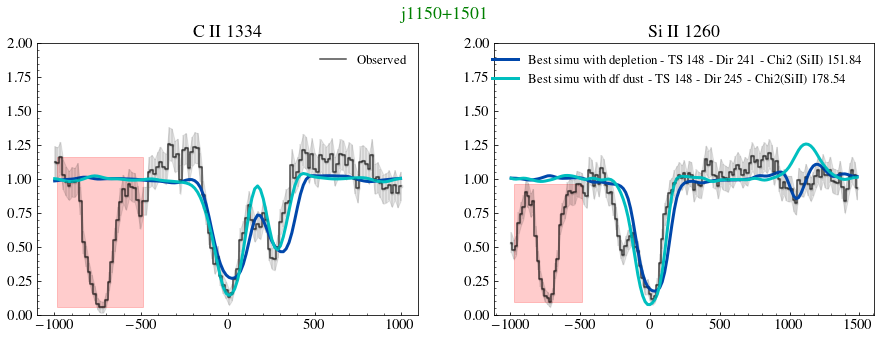

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1739567052.py:67: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1739567052.py:68: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


Depletion:  62.317840981206615 0.0 62.317840981206615


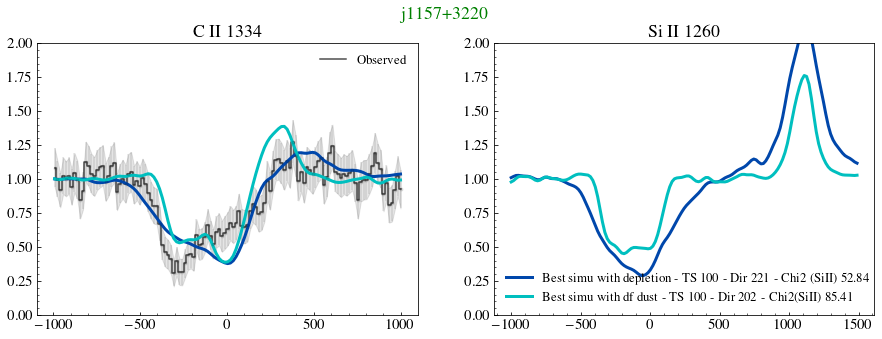

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


Depletion:  0.0 51.500666936364354 51.500666936364354


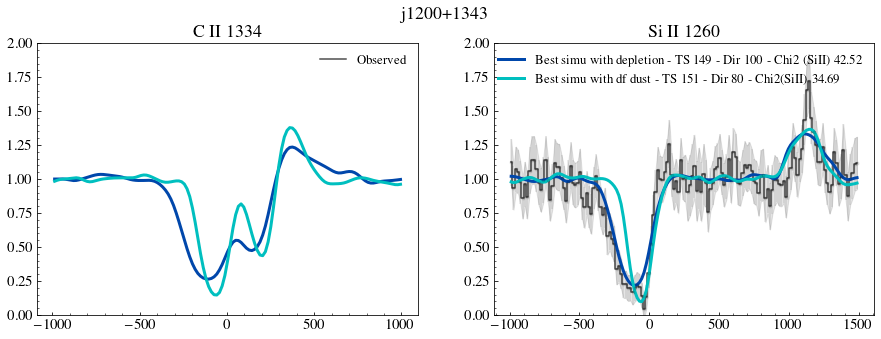

Depletion:  71.67435909607607 147.59390378032668 219.26826287640276


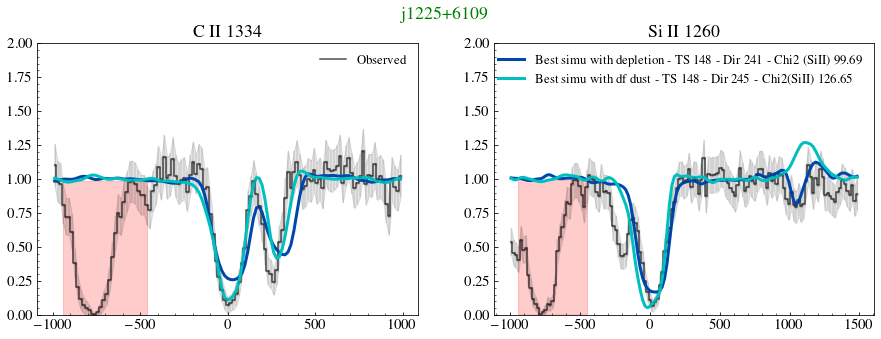

Depletion:  75.65184964273361 119.60392623702293 195.25577587975653


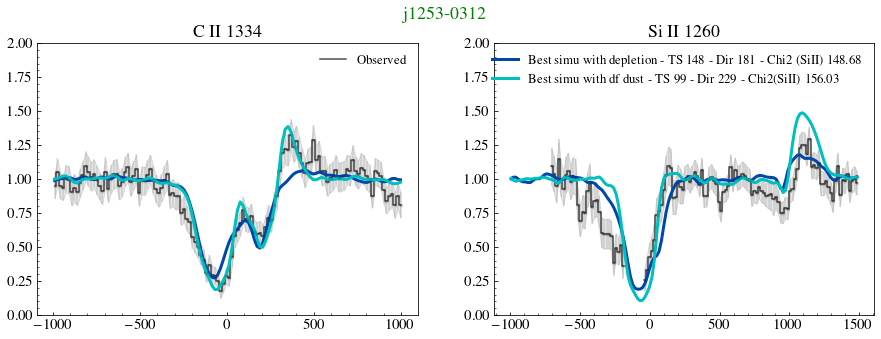

Depletion:  240.59009792901395 782.8333941678889 1023.4234920969028


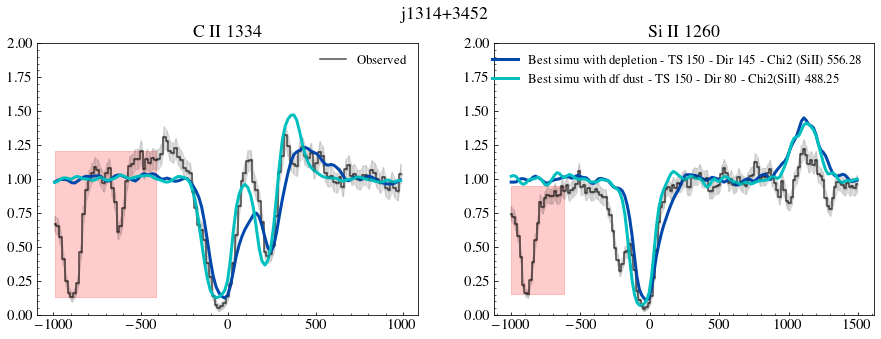

Depletion:  35.526113087275746 84.11077917749955 119.6368922647753


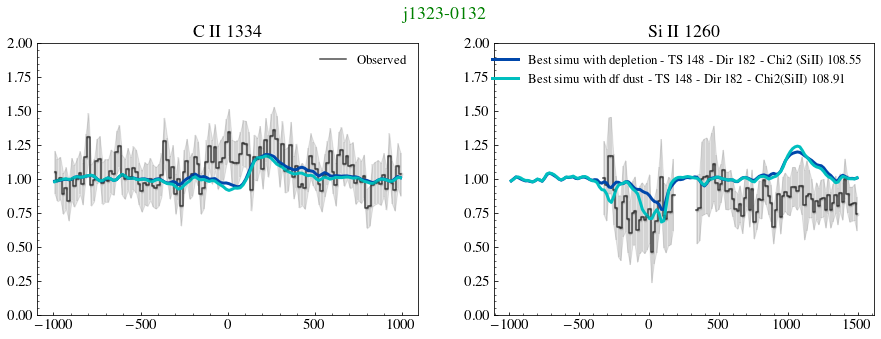

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1216: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)
/tmp/ipykernel_2749329/1739567052.py:67: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1739567052.py:68: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


Depletion:  166.78917468095779 0.0 166.78917468095779


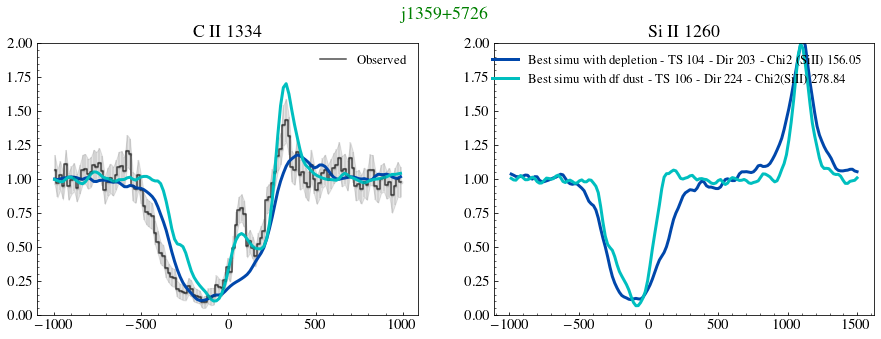

/tmp/ipykernel_2749329/1739567052.py:67: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
/tmp/ipykernel_2749329/1739567052.py:68: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


Depletion:  19.967457627012426 21.798364376120226 41.765822003132655


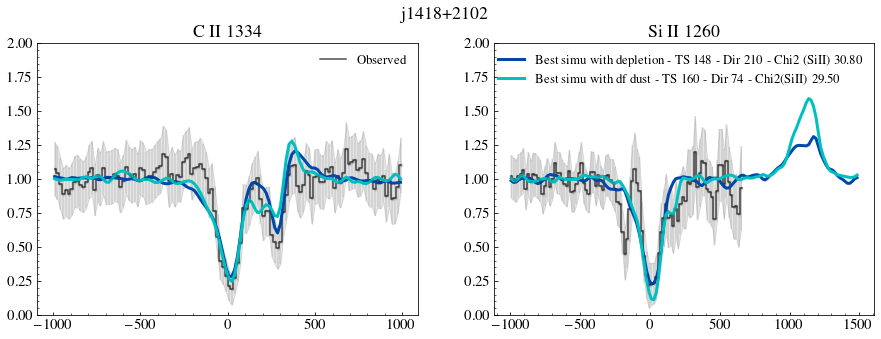

Depletion:  19.102413928597766 29.438346639895784 48.54076056849355


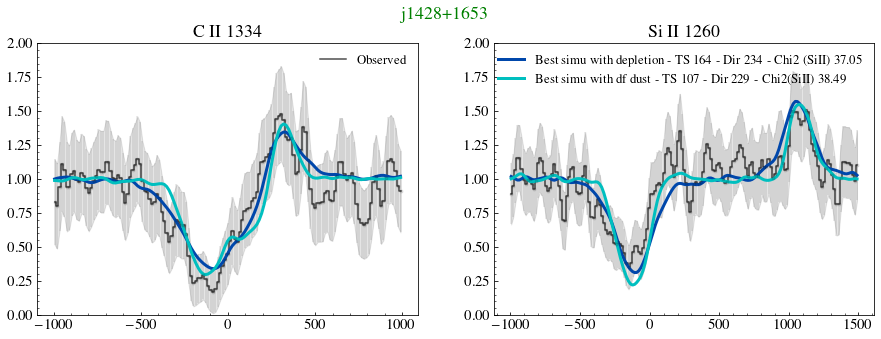

Depletion:  24.856567608657862 59.12168806358365 83.97825567224152


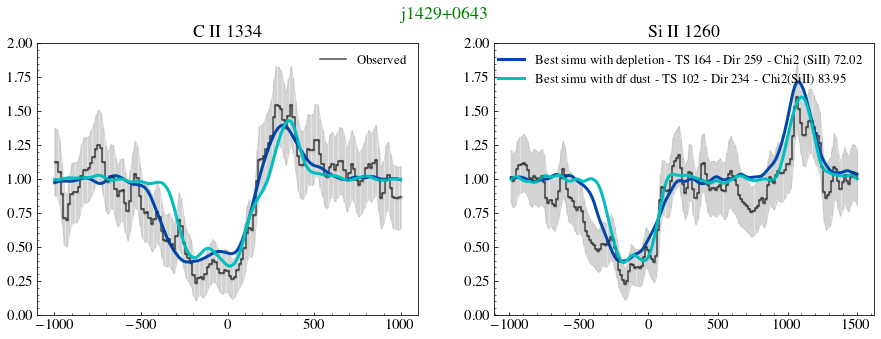

Depletion:  41.78460478332088 57.66679554601922 99.4514003293401


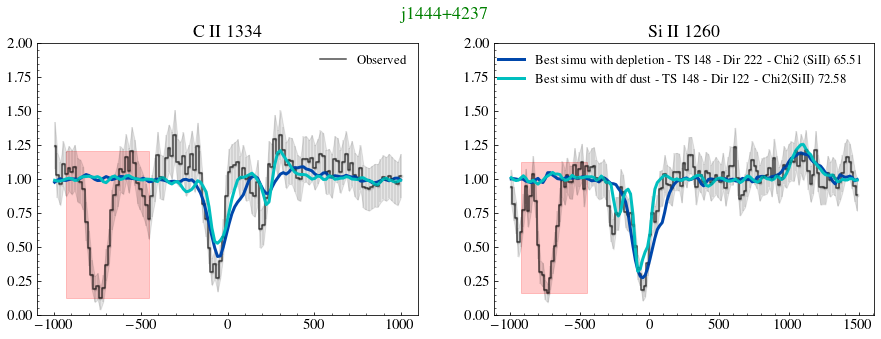

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


Depletion:  0.0 94.27616195603174 94.27616195603174


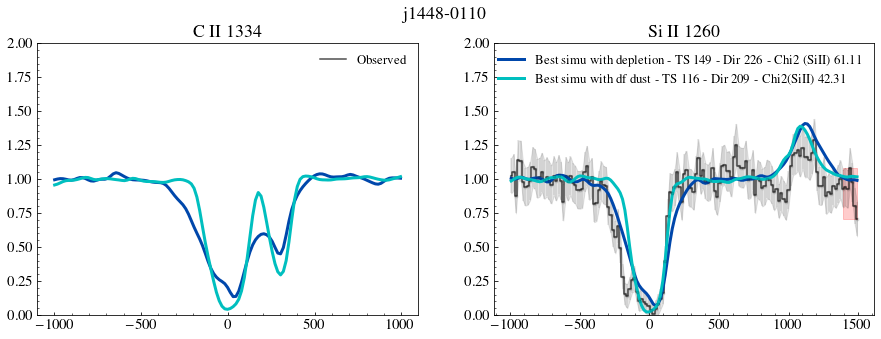

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


Depletion:  58.86082551881467 0.0 58.86082551881467


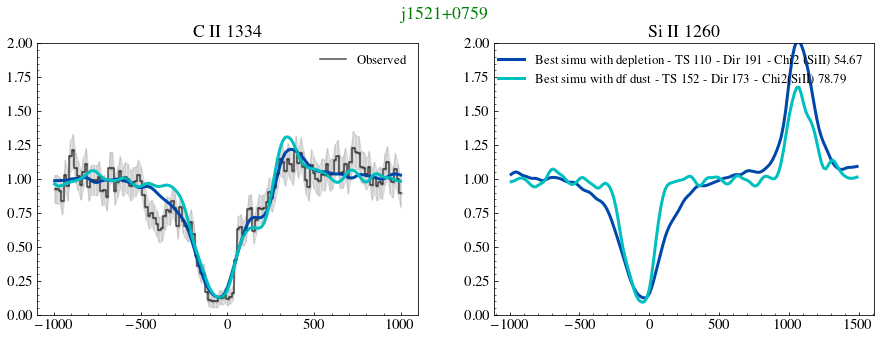

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1218: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/home/simon/anaconda3/lib/python3.9/site-packages/matplotlib/axes/_base.py:2283: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


Depletion:  0.0 23.01744247328435 23.01744247328435


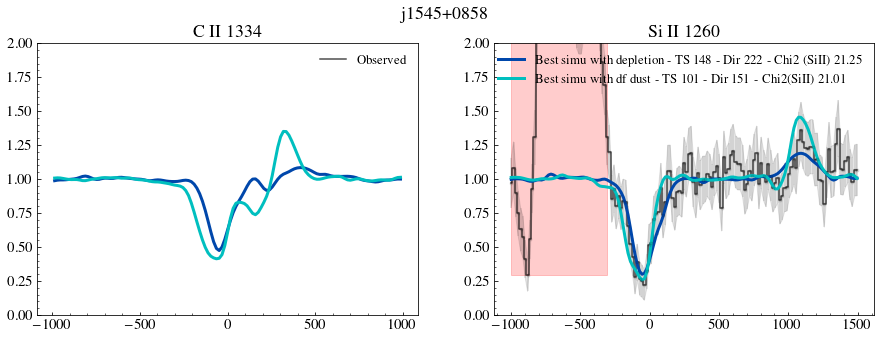

In [22]:
# dfnoFS = pd.read_csv('csv/Classy_noFS_fit.csv')
# dfFS   = pd.read_csv('csv/Classy_FS_fit.csv')
dfdust = pd.read_csv('csv/Classy_dust_fit.csv')
dfdep = pd.read_csv('csv/Classy_depletion_fit.csv')

nnf = 0
nfs = 0
v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

for i in range(len(galaxy)):

    if(label[i].upper() in maskGal):
        continue
    ## Plot galaxy spectra
    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    maskLya  = mask[cutLyaall]
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]

#     if(i == 4):
#         absflux[cutSiIIall] = absflux[cutSiIIall]/0.8
    
    rmedCII = ((vcII<-500) | (vcII > 700)) & maskCII
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) & maskSiII
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
        
        
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    axs[0].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[0].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[0].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
   
    
    axs[1].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[1].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  
#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[1].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')

#     path_to_data1 = './CII_SiII/'   
    path_to_data2 = './CII_SiII_depletion/' 
    path_to_data3 = './CII_SiII_ND/' 

    #######################################################
    
    # no FS
#     bestDir         = dfnoFS['DirAll'][i]
#     bestOut         = dfnoFS['OutputAll'][i]
#     bestChi2NF      = dfnoFS['x2siII'][i]

#     lcII, fluxcII   = read_spectrum_c(path_to_data1,  bestOut )
#     lsiII, fluxsiII = read_spectrum_si(path_to_data1, bestOut )
        
#         ## CII Plot
#     lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
#     lcII_systemic  = lcII_systemic[1:]
#     vcII_s         = (lcII_systemic/wcII1334 -1)*c
#     sigma_pixelcii = res[i] /2.355/ ((vcII_s[50]-vcII_s[49]))
#     model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
#     f              = interpolate.interp1d(vcII_s, model)
#     modelNewcii    = f(vcII)
# #     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
# #                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
# #     modelNewcii    *= alpha    
#     rmedCII = ((vcII<-500) | (vcII > 700)) 
#     fmedCII = np.nanmedian(modelNewcii[rmedCII])
#     modelNewcii /= fmedCII


#     axs[0].plot(vcII, modelNewcii, c =cnoFS, lw = 3)
   

#         ## Si II plot
#     lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
#     lsiII_systemic = lsiII_systemic[1:]
#     vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
#     sigma_pixelsi  = res[i]  /2.355/ ((vsiII_s[50]-vsiII_s[49]))
#     model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
#     f              = interpolate.interp1d(vsiII_s, model)
#     modelNewsi     = f(vsiII)
# #     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
# #                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
# #     modelNewsi   *= alpha
#     rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
#     fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
#     modelNewsi /= fmedSiII    
#     lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)

#     axs[1].plot(vsiII, modelNewsi, c =cnoFS, lw = 3,
#                label = 'Best simu without FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2NF))
    
#     lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
#     lnlikeall  = lnlikecII + lnlikesiII
#     print('noFS: ',lnlikecII, lnlikesiII, lnlikeall )
      ###################################################################                                                                                                      
                                                                                                            
    # with FS
    bestDir         = dfdep['DirAll'][i]
    bestOut         = dfdep['OutputAll'][i]
    bestChi2dep      = dfdep['x2All'][i]

    lcII, fluxcII   = read_spectrum_c(path_to_data2,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data2, bestOut )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = res[i] / 2.355/((vcII_s[50]-vcII_s[49]))
    model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    f              = interpolate.interp1d(vcII_s, model)
    modelNewcii    = f(vcII)
#     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
#                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
#     modelNewcii    *= alpha  
    rmedCII = ((vcII<-500) | (vcII > 700)) 
    fmedCII = np.nanmedian(modelNewcii[rmedCII])
    modelNewcii /= fmedCII
    axs[0].plot(vcII, modelNewcii, c =cFS, lw = 3)
   

        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  = res[i] / 2.355/ ((vsiII_s[50]-vsiII_s[49]))
    model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
    f              = interpolate.interp1d(vsiII_s, model)
    modelNewsi     = f(vsiII)
#     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
#     modelNewsi    *= alpha    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
    fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
    modelNewsi /= fmedSiII  
    
    lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
    lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
    lnlikeall  = lnlikecII + lnlikesiII
    axs[1].plot(vsiII, modelNewsi, c =cFS, lw = 3, 
                label = 'Best simu with depletion - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2dep))
    

    axs[0].set_ylim(0,2)
    axs[1].set_ylim(0,2)

    print('Depletion: ',lnlikecII, lnlikesiII, lnlikeall )
    t = plt.suptitle(label[i])
#     plt.savefig(label[i]+'comp.pdf', bbox_inches = 'tight')

    # DIFF DUST
      ###################################################################                                                                                                      

    bestDir         = dfdust['DirAll'][i]
    bestOut         = dfdust['OutputAll'][i]
    bestChi2dust      = dfdust['x2All'][i]

    lcII, fluxcII   = read_spectrum_c(path_to_data3,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data3, bestOut )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = res[i] / 2.355/((vcII_s[50]-vcII_s[49]))
    model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    f              = interpolate.interp1d(vcII_s, model)
    modelNewcii    = f(vcII)
#     alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
#                     np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
#     modelNewcii    *= alpha  
    rmedCII = ((vcII<-500) | (vcII > 700)) 
    fmedCII = np.nanmedian(modelNewcii[rmedCII])
    modelNewcii /= fmedCII
    axs[0].plot(vcII, modelNewcii, c ='c', lw = 3)
   

        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  = res[i] / 2.355/ ((vsiII_s[50]-vsiII_s[49]))
    model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
    f              = interpolate.interp1d(vsiII_s, model)
    modelNewsi     = f(vsiII)
#     alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
#                     np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
#     modelNewsi    *= alpha 
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
    fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
    modelNewsi /= fmedSiII  
    
    lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
    lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
    lnlikeall  = lnlikecII + lnlikesiII
    axs[1].plot(vsiII, modelNewsi, c ='c', lw = 3, 
                label = 'Best simu with df dust - TS %d - Dir %d - Chi2(SiII) %.2f'%(bestOut, bestDir, bestChi2dust))
    axs[0].legend(fontsize = 13, frameon = False)
    axs[1].legend(fontsize = 13, frameon = False)

    if(bestChi2dust> bestChi2dep):
        plt.setp(t, color='g')         #set the color of title to red

    plt.show()

### Same Dir 

noFS:  61.56255636925876 35.15548622394557 96.71804259320433
FS:  75.84995418438719 48.96841624411861 124.8183704285058


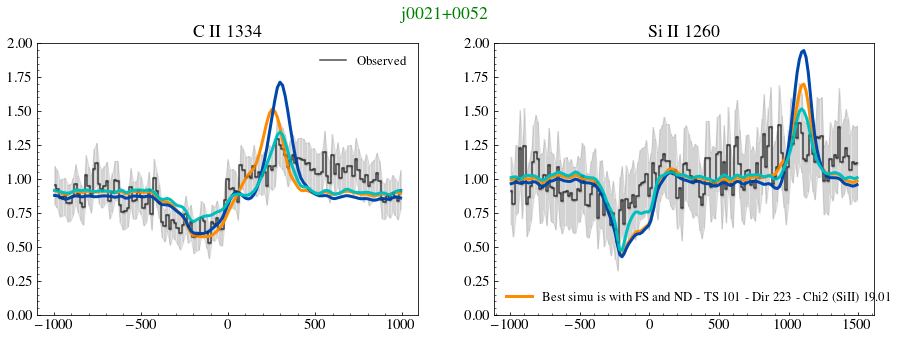

noFS:  413.3262509397029 498.78670271333874 912.1129536530416
FS:  209.9864887677308 616.4549285234273 826.4414172911581


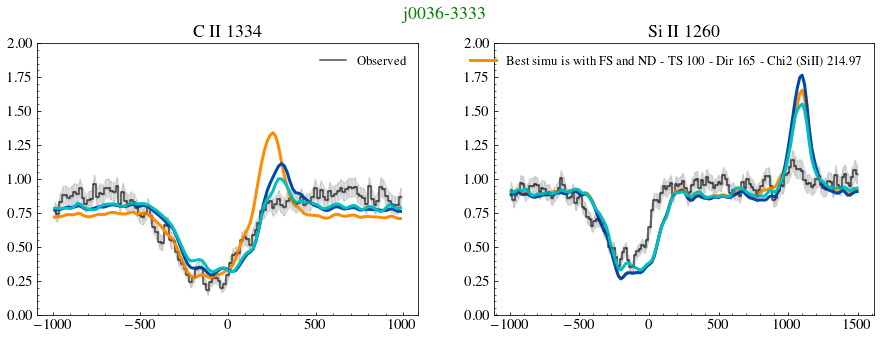

noFS:  167.78984403455385 80.73533464703632 248.52517868159018
FS:  50.756490292887236 69.92348385471638 120.67997414760362


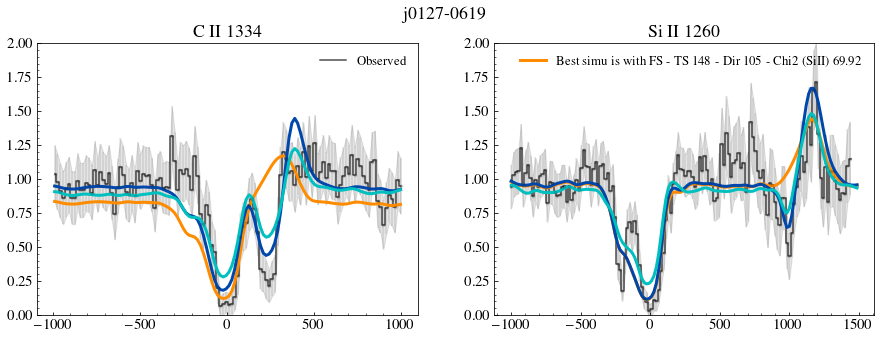

noFS:  101.86213140950288 68.91708639065013 170.779217800153
FS:  24.912735909532 68.16931105172533 93.08204696125733


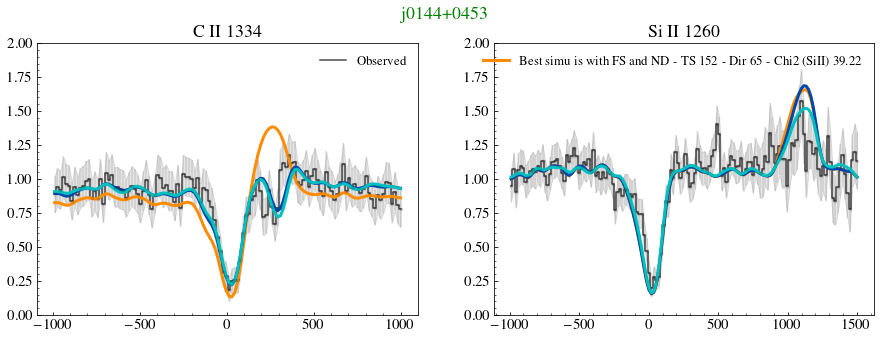

noFS:  683.2849864565256 274.9686645949919 958.2536510515175
FS:  283.039968896586 418.8631338484108 701.9031027449969


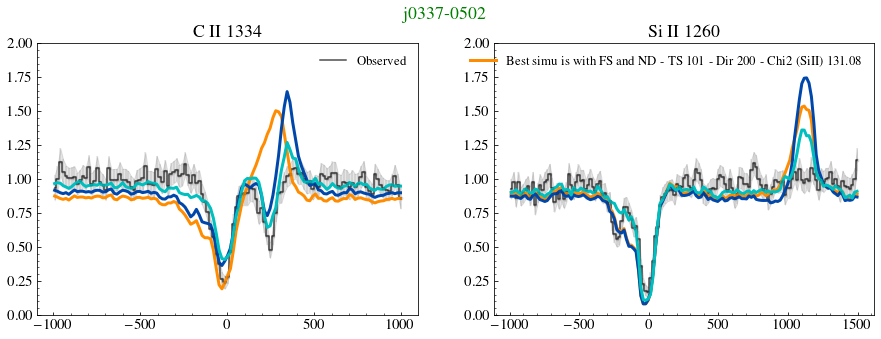

noFS:  82.52610878691817 103.75878758420397 186.28489637112216
FS:  88.85165983939514 230.90331719251412 319.7549770319093


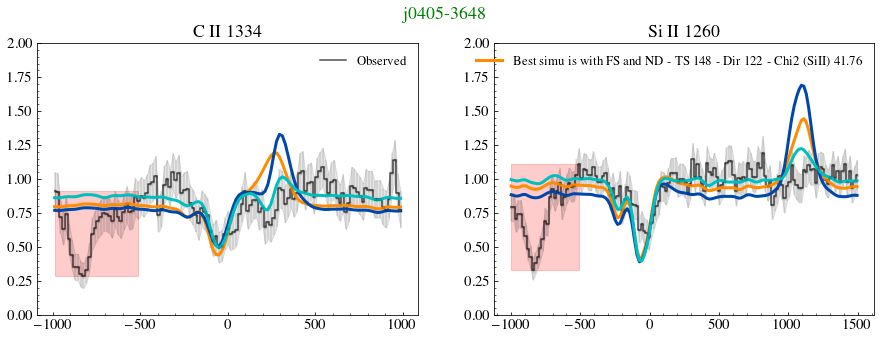

noFS:  40.63137566990791 46.14396964015336 86.77534531006127
FS:  43.31946837054271 53.436412446044116 96.75588081658682


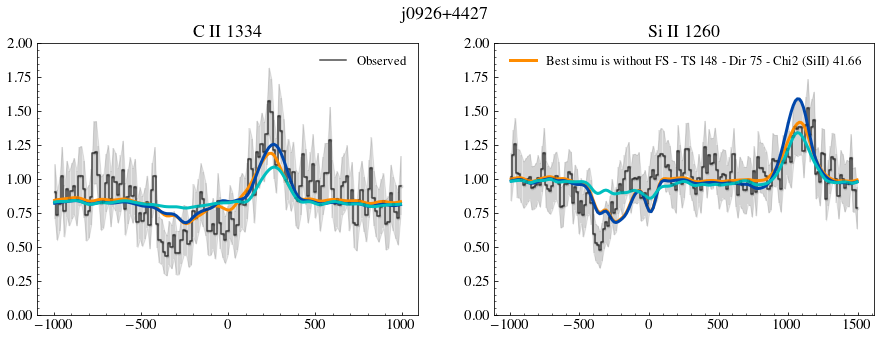

noFS:  511.57237790874245 606.8098918083795 1118.382269717122
FS:  331.8272571883605 891.0117956871838 1222.8390528755444


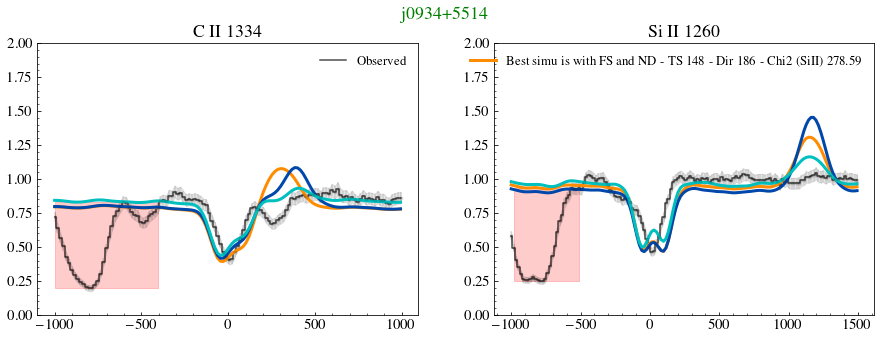

noFS:  96.07886847894503 50.32639548563273 146.40526396457776
FS:  139.32825057143248 67.70646690695439 207.03471747838688


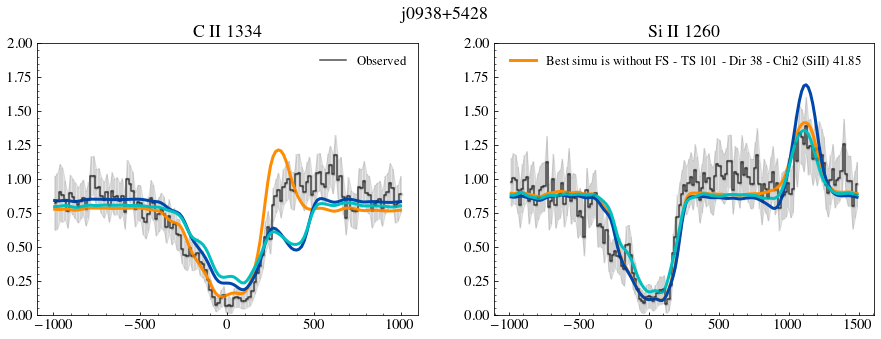

noFS:  101.98905099313306 78.18381464627498 180.17286563940803
FS:  33.64214409384424 113.73517629139995 147.3773203852442


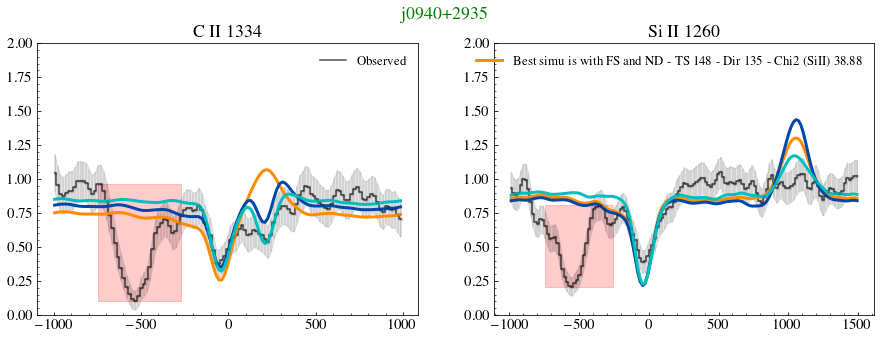

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-52-498670c76fc6>:58: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-52-498670c76fc6>:59: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')
<ipython-input-52-498670c76fc6>:114: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:156: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:204: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[m

noFS:  194.40338486458805 0.0 194.40338486458805
FS:  108.1023185419751 0.0 108.1023185419751


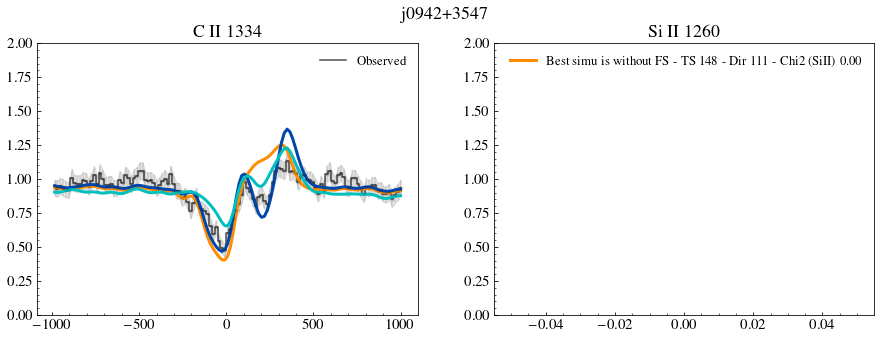

noFS:  20.145121797688304 24.488892358813885 44.63401415650219
FS:  13.714171166203629 24.942087206476167 38.656258372679794


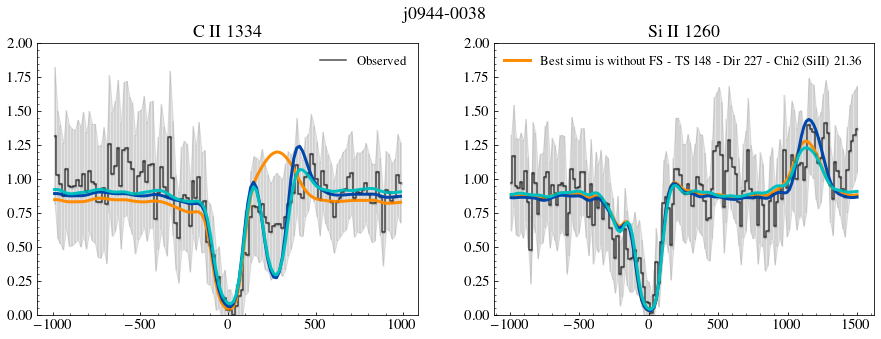

<ipython-input-52-498670c76fc6>:114: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:156: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:204: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \


noFS:  18.6482398490637 0.0 18.6482398490637
FS:  7.168916461004932 0.0 7.168916461004932


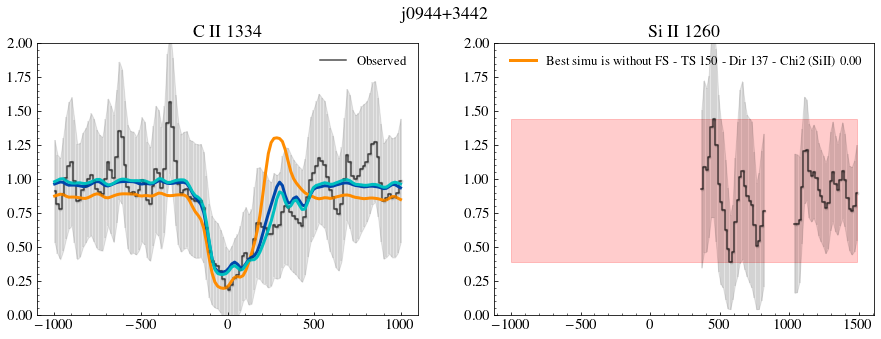

noFS:  45.2008764712229 98.18116274670392 143.38203921792683
FS:  27.515632844050373 85.85660379898917 113.37223664303954


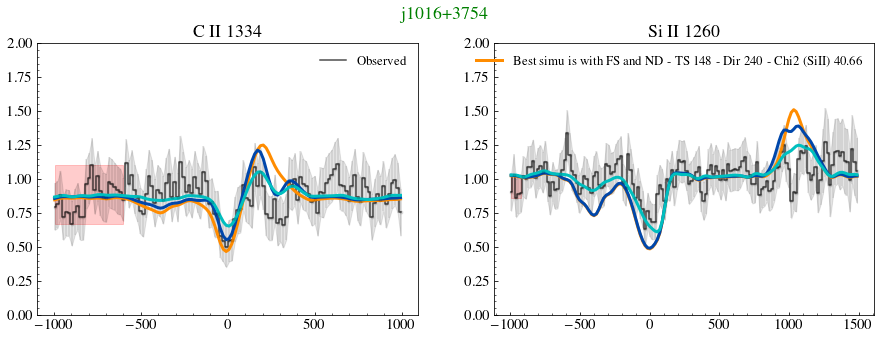

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-52-498670c76fc6>:100: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:142: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:190: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \


noFS:  0.0 87.02609822443785 87.02609822443785
FS:  0.0 82.24025516532846 82.24025516532846


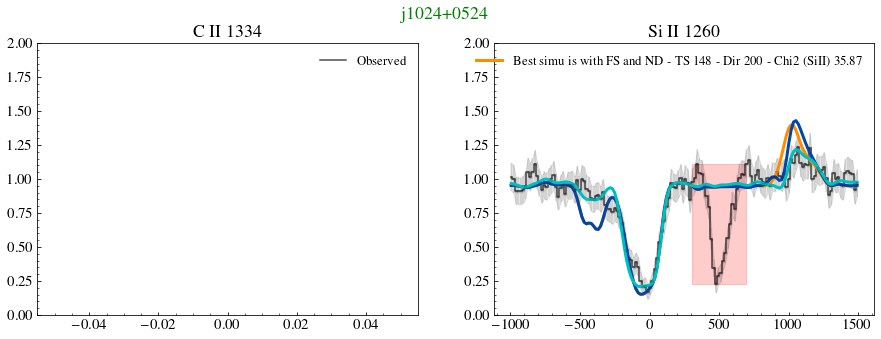

noFS:  70.77160991657739 26.854801048782953 97.62641096536035
FS:  76.0616721885215 33.8584614998056 109.9201336883271


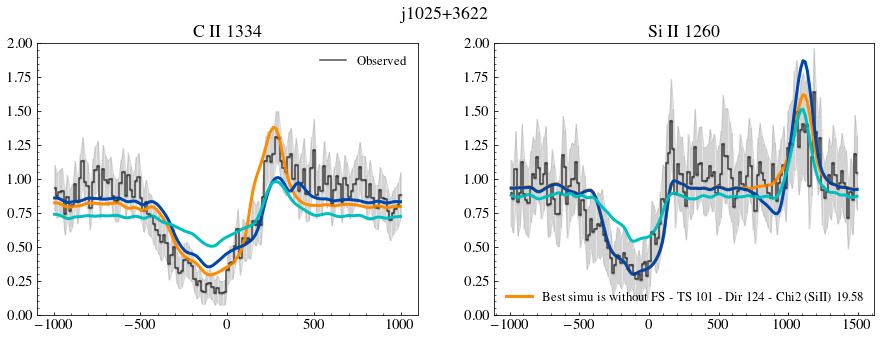

<ipython-input-52-498670c76fc6>:114: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:156: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:204: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \


noFS:  157.96715489697792 0.0 157.96715489697792
FS:  213.65774793772283 0.0 213.65774793772283


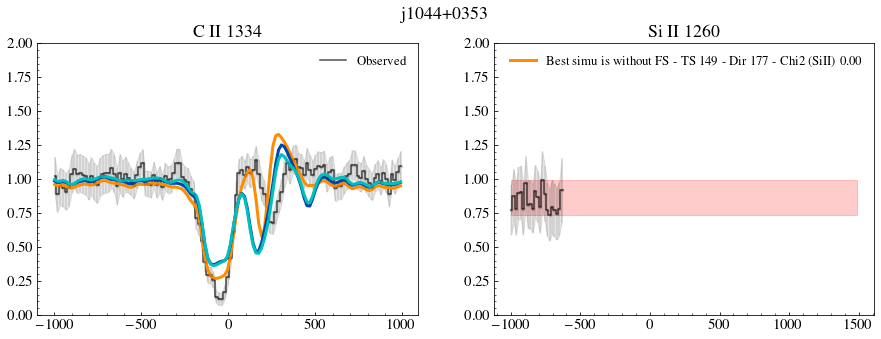

<ipython-input-52-498670c76fc6>:100: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:142: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:190: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \


noFS:  0.0 64.28281497051556 64.28281497051556
FS:  0.0 95.07348135066381 95.07348135066381


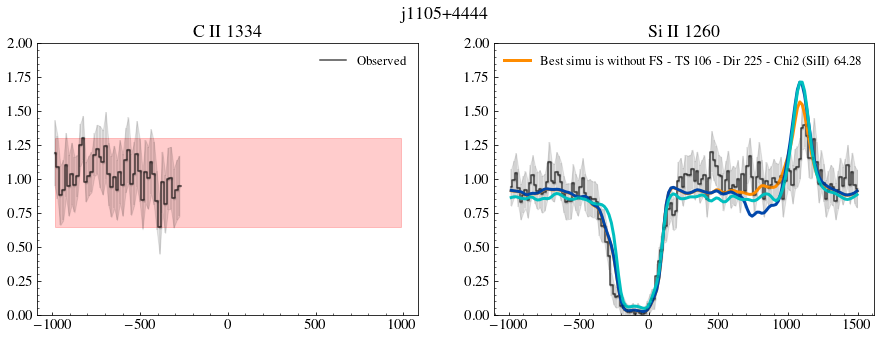

noFS:  142.08908007429434 68.93535215638289 211.02443223067723
FS:  70.10646200034529 69.01783053665352 139.1242925369988


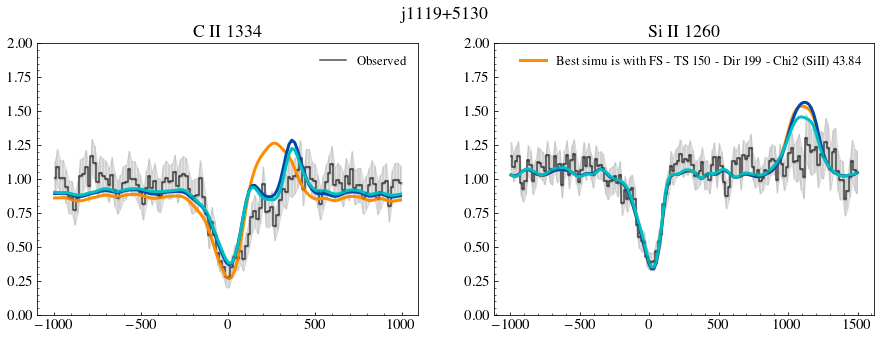

noFS:  320.6312247467968 118.42142564923059 439.0526503960274
FS:  72.70660994152571 131.126528704645 203.8331386461707


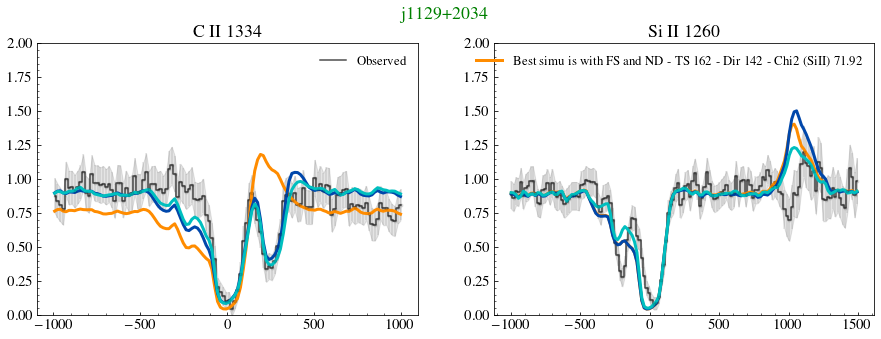

noFS:  270.0613675658102 4.590802022625848 274.65216958843604
FS:  32.27399883343018 4.896449331309292 37.17044816473947


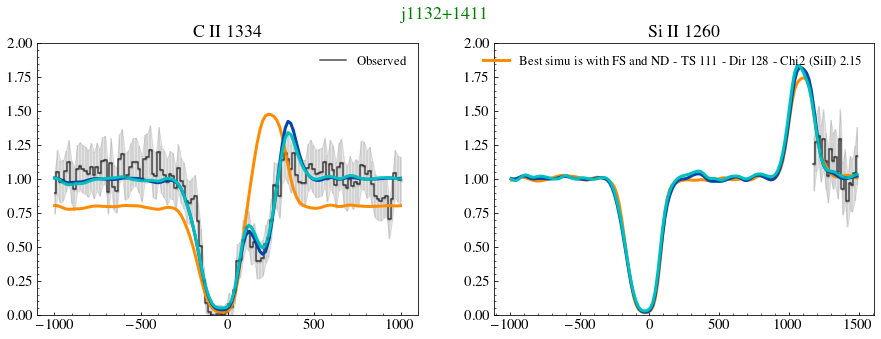

noFS:  43.55574693426541 27.70953151371906 71.26527844798447
FS:  18.09093651187137 35.47435305695516 53.56528956882653


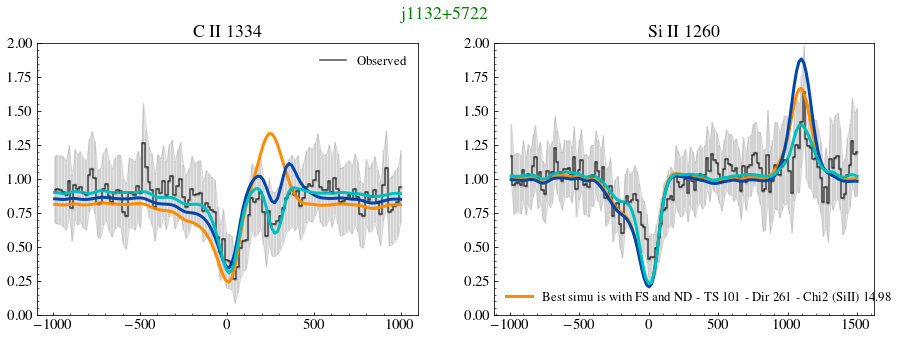

<ipython-input-52-498670c76fc6>:100: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:142: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:190: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \


noFS:  0.0 33.18331075243844 33.18331075243844
FS:  0.0 49.40832042361791 49.40832042361791


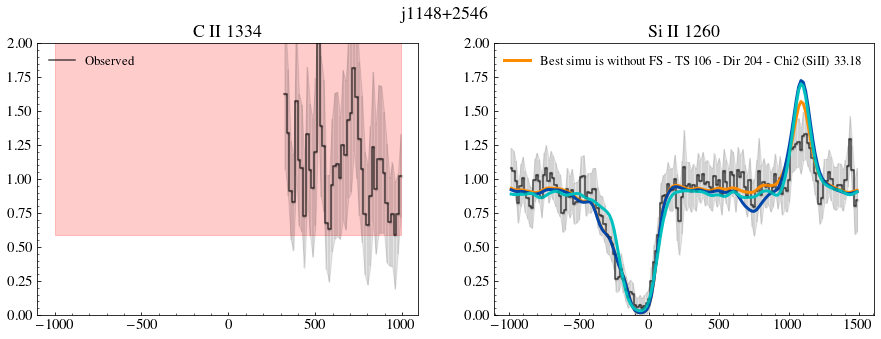

noFS:  365.9505634130878 204.9698039975291 570.9203674106169
FS:  78.97737247951703 269.66295126053797 348.640323740055


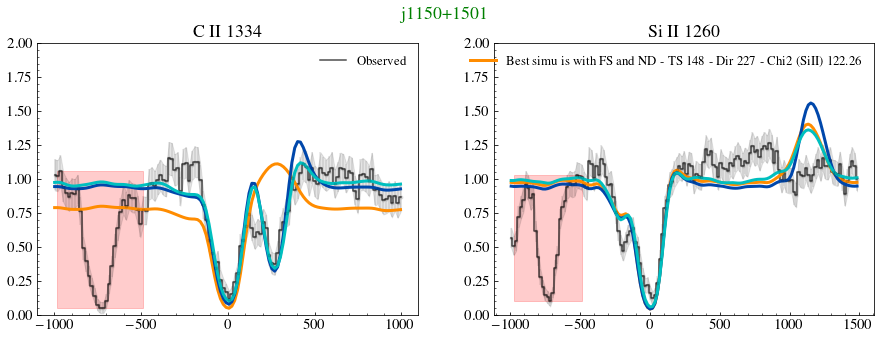

<ipython-input-52-498670c76fc6>:114: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:156: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:204: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \


noFS:  101.05898431594153 0.0 101.05898431594153
FS:  90.14913675445246 0.0 90.14913675445246


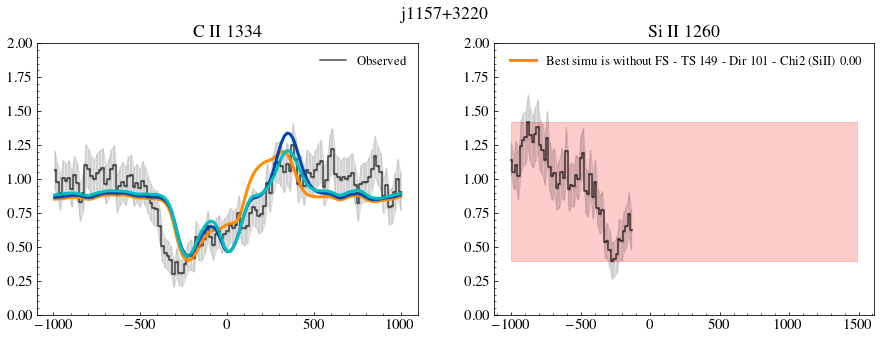

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-52-498670c76fc6>:100: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:142: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:190: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \


noFS:  0.0 37.03721946271388 37.03721946271388
FS:  0.0 43.944882745494205 43.944882745494205


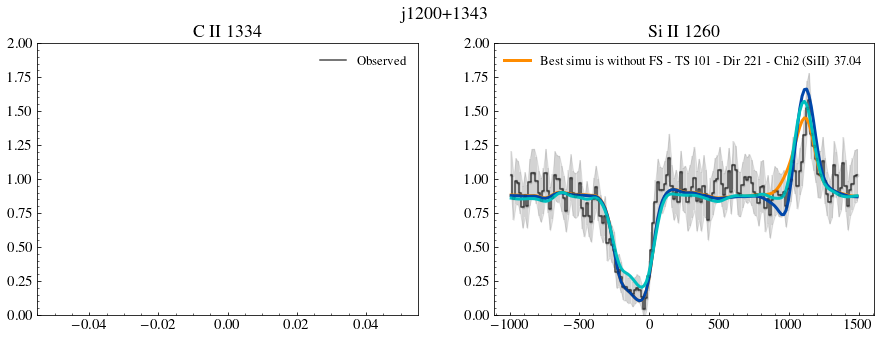

noFS:  260.26204720480365 166.64482511160887 426.90687231641255
FS:  43.862286103066765 198.9277598733565 242.79004597642327


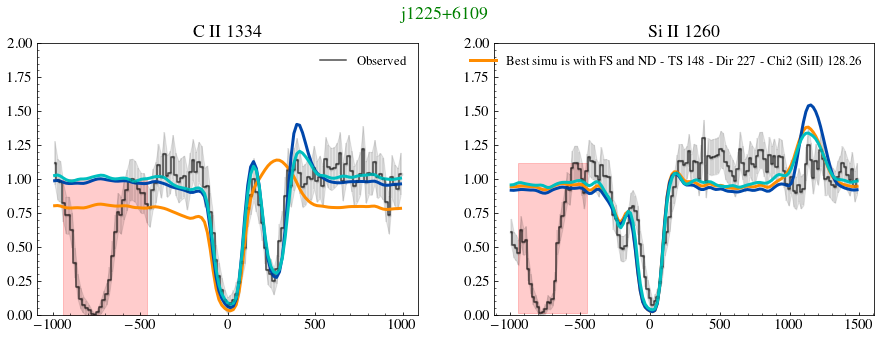

noFS:  200.92674575848972 147.89278603899862 348.81953179748837
FS:  115.49360640483265 216.14596390746254 331.6395703122952


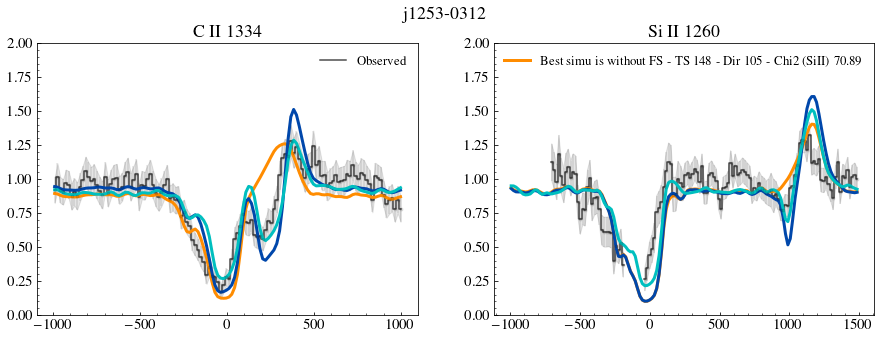

noFS:  943.9001437180511 323.9256896264629 1267.825833344514
FS:  190.15837901162635 354.80947604113675 544.9678550527631


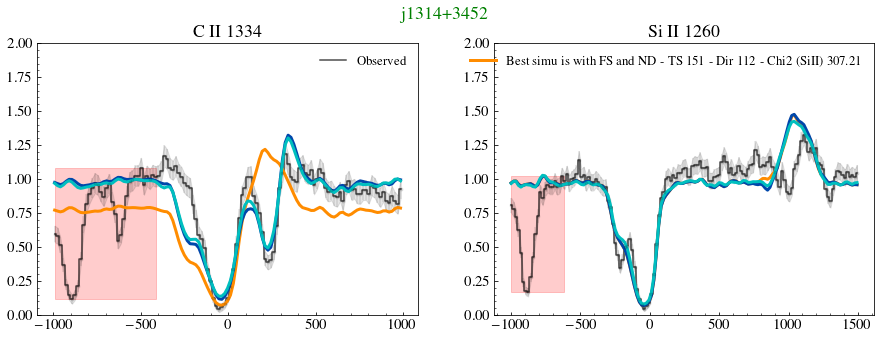

noFS:  31.954281674700656 46.92779931990367 78.88208099460432
FS:  30.486404179295914 77.96536901745677 108.45177319675268


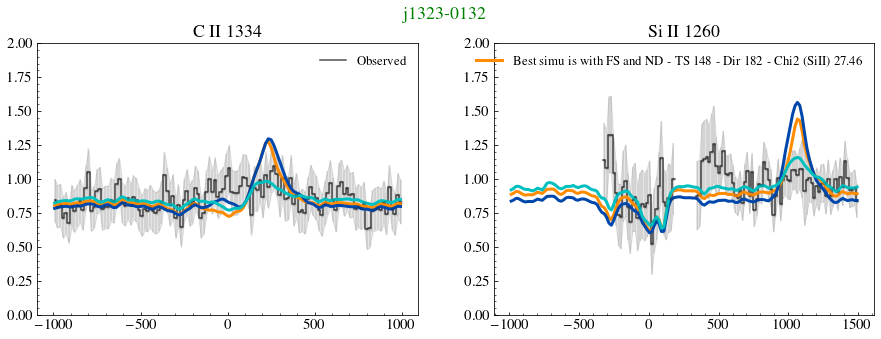

<ipython-input-52-498670c76fc6>:114: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:156: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:204: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \


noFS:  319.31914207799696 0.0 319.31914207799696
FS:  418.51204838770826 0.0 418.51204838770826


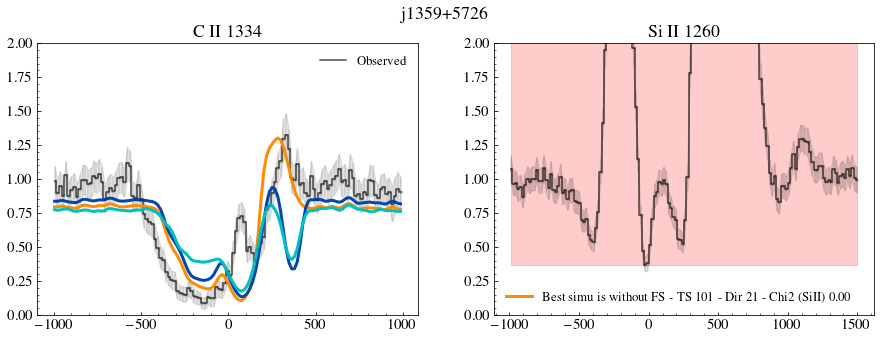

<ipython-input-52-498670c76fc6>:58: RuntimeWarning: All-NaN slice encountered
  axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]),
<ipython-input-52-498670c76fc6>:59: RuntimeWarning: All-NaN slice encountered
  np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')


noFS:  131.39136767933658 22.416216185145053 153.80758386448164
FS:  50.38000069407834 22.444134426243878 72.82413512032221


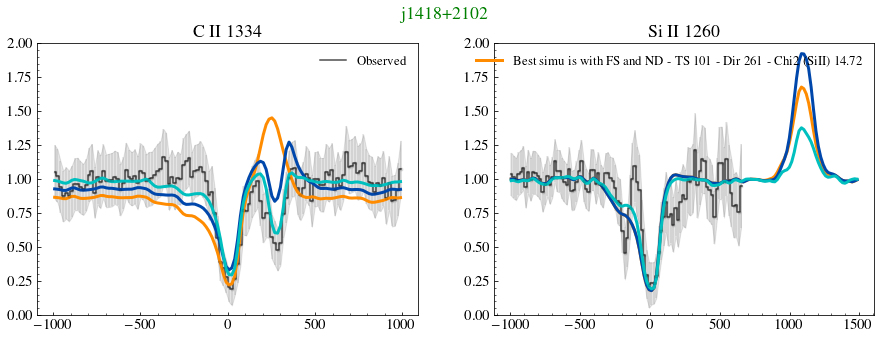

noFS:  20.212726665299158 26.602631264981856 46.81535793028101
FS:  23.093564682990333 35.861920457786304 58.95548514077664


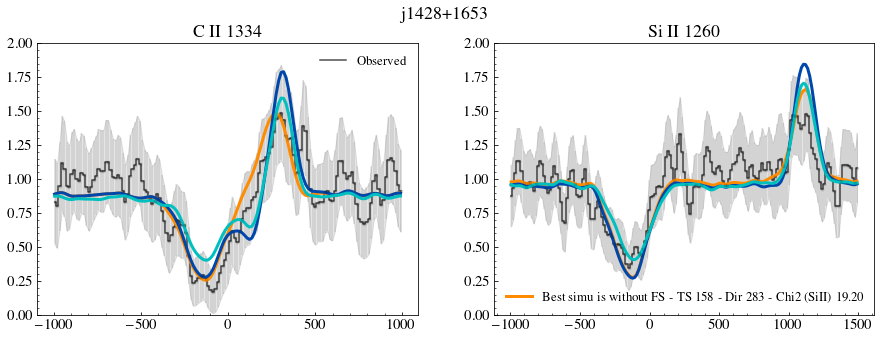

noFS:  45.62145196201813 28.911943655780874 74.533395617799
FS:  29.77090730772712 32.0209247280952 61.791832035822324


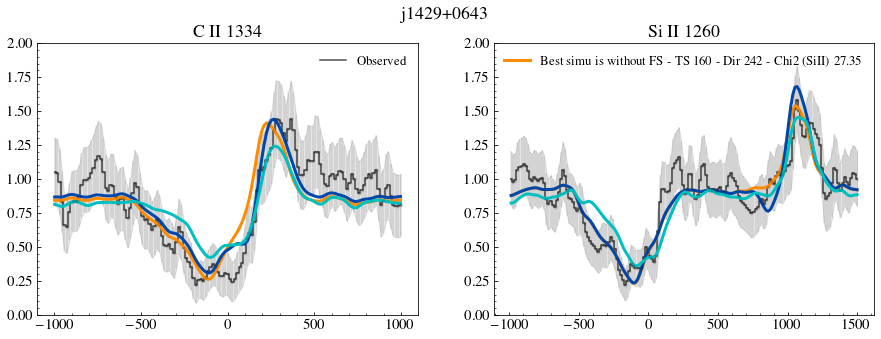

noFS:  94.03487311416484 84.56304563743385 178.59791875159868
FS:  34.78130696755182 84.43258440563108 119.21389137318289


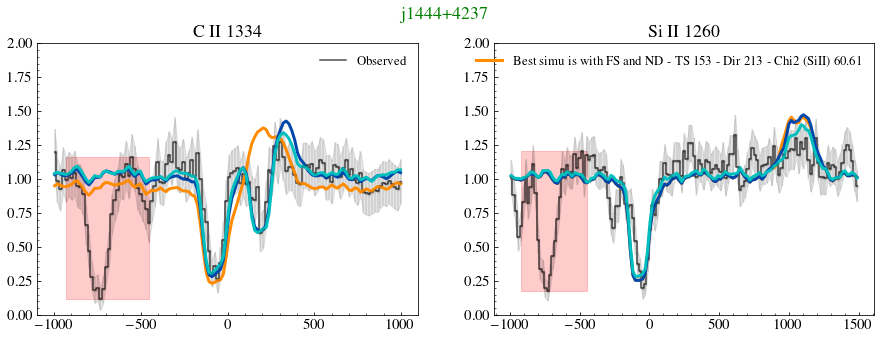

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-52-498670c76fc6>:100: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:142: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:190: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \


noFS:  0.0 52.115756995786754 52.115756995786754
FS:  0.0 58.216005957750895 58.216005957750895


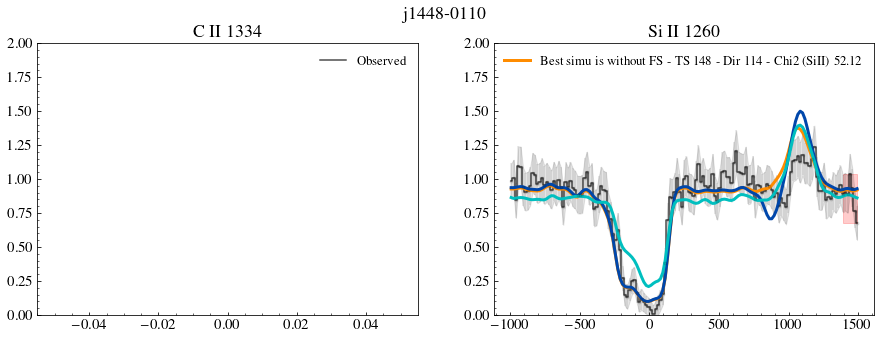

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-52-498670c76fc6>:114: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:156: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
<ipython-input-52-498670c76fc6>:204: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \


noFS:  144.7917365588538 0.0 144.7917365588538
FS:  161.259351080279 0.0 161.259351080279


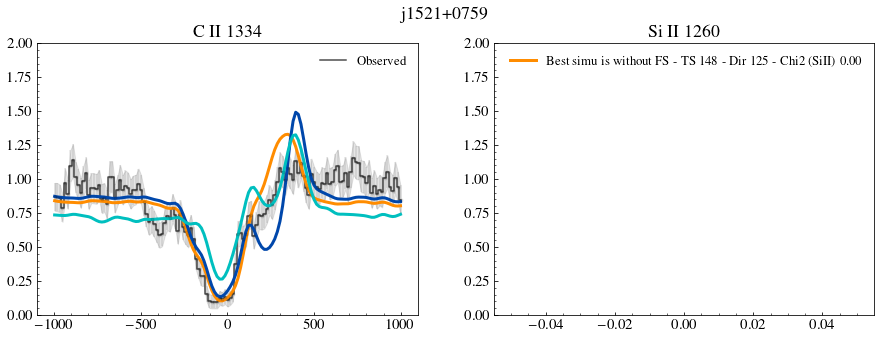

/home/Simon/anaconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
<ipython-input-52-498670c76fc6>:100: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:142: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
<ipython-input-52-498670c76fc6>:190: RuntimeWarning: invalid value encountered in double_scalars
  alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \


noFS:  0.0 33.623406741427445 33.623406741427445
FS:  0.0 48.77552527146391 48.77552527146391


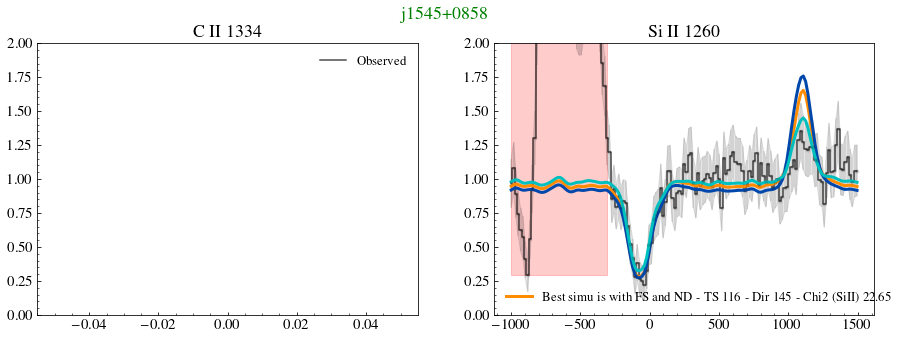

In [52]:
dfnoFS = pd.read_csv('Classy_noFS_fit.csv')
dfFS   = pd.read_csv('Classy_FS_fit.csv')
dfdust = pd.read_csv('Classy_dust_fit.csv')
nnf = 0
nfs = 0
v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)

for i in range(len(galaxy)):

    if(label[i].upper() in maskGal):
        continue
    ## Plot galaxy spectra
    hduin  = fits.open('../Classy/%s/%s_SB99fit.fits'%(galaxy[i].replace("_", ""), label[i].upper()))
    data   = hduin[1].data
    wave   = data['wave']
    flux   = data['flux']
    err    = data['err']
    mask   = mask_all[i]

    
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c
    vLyad  = (wave/wLya-1)*c

    cutCIIall = (vcIId>-1000) & (vcIId<1000) 
    cutSiIIall = (vsiIId>-1000) & (vsiIId<1500) 
    cutLyaall = (vLyad>-4000) & (vLyad<4000) 
    
    maskCII  = mask[cutCIIall]
    maskSiII = mask[cutSiIIall]    
    maskLya  = mask[cutLyaall]
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]

#     if(i == 4):
#         absflux[cutSiIIall] = absflux[cutSiIIall]/0.8

        
        
    fig, axs = plt.subplots(1,2,figsize=(15,5))
    axs[0].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.1)
    axs[0].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    if(len(fcII[~maskCII])>0):
        axs[0].fill_between(vcII[~maskCII], np.nanmin(fcII[~maskCII]), np.nanmax(fcII[~maskCII]), 
                            alpha=0.2, color= 'r')
    axs[0].fill_between(vcII,fcII - ecII, fcII + ecII,color= 'k', alpha = 0.1)
    axs[0].set_title('C II 1334')
   
    
    axs[1].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.1)
    axs[1].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    if(len(fsiII[~maskSiII])>0):
        axs[1].fill_between(vsiII[~maskSiII], np.nanmin(fsiII[~maskSiII]), 
                        np.nanmax(fsiII[~maskSiII]), alpha=0.2, color= 'r')  
#     axs[1].plot(vsiIId[cutSiIIall], absflux[cutSiIIall],   c = 'k' )
    axs[1].fill_between(vsiII,fsiII-esiII, fsiII+esiII, color = 'k', alpha = 0.1)
    axs[1].set_title('Si II 1260')

    path_to_data1 = './CII_SiII/'   
    path_to_data2 = './CII_SiII_fine/' 
    path_to_data3 = './CII_SiII_ND/' 

    #######################################################
    
    # no FS

    bestChi2NF      = dfnoFS['x2siII'][i]
    bestChi2FS      = dfFS['x2siII'][i]
    bestChi2dust      = dfdust['x2siII'][i]
    
    if(np.argmin([bestChi2NF,bestChi2FS,bestChi2dust]) == 0):
        bestDir         = dfnoFS['DirAll'][i]
        bestOut         = dfnoFS['OutputAll'][i]
        labels= 'Best simu is without FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2NF)
    elif(np.argmin([bestChi2NF,bestChi2FS,bestChi2dust]) == 1):
        bestDir         = dfFS['DirAll'][i]
        bestOut         = dfFS['OutputAll'][i]
        labels= 'Best simu is with FS - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2FS)
    else:
        bestDir         = dfdust['DirAll'][i]
        bestOut         = dfdust['OutputAll'][i]    
        labels= 'Best simu is with FS and ND - TS %d - Dir %d - Chi2 (SiII) %.2f'%(bestOut, bestDir, bestChi2dust)

    lcII, fluxcII   = read_spectrum_c(path_to_data1,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data1, bestOut )
        
        ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = res[i] /2.355/ ((vcII_s[50]-vcII_s[49]))
    model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    f              = interpolate.interp1d(vcII_s, model)
    modelNewcii    = f(vcII)
    alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
                    np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
    modelNewcii    *= alpha    
    axs[0].plot(vcII, modelNewcii, c =cnoFS, lw = 3)
   

        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  = res[i]  /2.355/ ((vsiII_s[50]-vsiII_s[49]))
    model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
    f              = interpolate.interp1d(vsiII_s, model)
    modelNewsi     = f(vsiII)
    alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
                    np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
    modelNewsi   *= alpha
    
    lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)

    axs[1].plot(vsiII, modelNewsi, c =cnoFS, lw = 3,
               label = labels)
    
    lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
    lnlikeall  = lnlikecII + lnlikesiII
    print('noFS: ',lnlikecII, lnlikesiII, lnlikeall )
      ###################################################################                                                                                                      
                                                                                                            
    # with FS


    lcII, fluxcII   = read_spectrum_c(path_to_data2,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data2, bestOut )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = res[i] / 2.355/((vcII_s[50]-vcII_s[49]))
    model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    f              = interpolate.interp1d(vcII_s, model)
    modelNewcii    = f(vcII)
    alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
                    np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
    modelNewcii    *= alpha      
    axs[0].plot(vcII, modelNewcii, c =cFS, lw = 3)
   

        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  = res[i] / 2.355/ ((vsiII_s[50]-vsiII_s[49]))
    model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
    f              = interpolate.interp1d(vsiII_s, model)
    modelNewsi     = f(vsiII)
    alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
                    np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
    modelNewsi    *= alpha    
    
    lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
    lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
    lnlikeall  = lnlikecII + lnlikesiII
    axs[1].plot(vsiII, modelNewsi, c =cFS, lw = 3, 
               )
    

    axs[0].set_ylim(0,2)
    axs[1].set_ylim(0,2)

    print('FS: ',lnlikecII, lnlikesiII, lnlikeall )
    t = plt.suptitle(label[i])
#     plt.savefig(label[i]+'comp.pdf', bbox_inches = 'tight')

    # DIFF DUST
      ###################################################################                                                                                                      



    lcII, fluxcII   = read_spectrum_c(path_to_data3,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data3, bestOut )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = res[i] / 2.355/((vcII_s[50]-vcII_s[49]))
    model          = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    f              = interpolate.interp1d(vcII_s, model)
    modelNewcii    = f(vcII)
    alpha          = np.nansum((modelNewcii[maskCII]*fcII[maskCII]/(ecII[maskCII])**2))/ \
                    np.nansum(modelNewcii[maskCII]**2/ecII[maskCII]**2)     
    modelNewcii    *= alpha      
    axs[0].plot(vcII, modelNewcii, c ='c', lw = 3)
   

        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  = res[i] / 2.355/ ((vsiII_s[50]-vsiII_s[49]))
    model          = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
    f              = interpolate.interp1d(vsiII_s, model)
    modelNewsi     = f(vsiII)
    alpha          = np.nansum((modelNewsi[maskSiII]*fsiII[maskSiII]/(esiII[maskSiII])**2))/ \
                    np.nansum(modelNewsi[maskSiII]**2/esiII[maskSiII]**2)
    modelNewsi    *= alpha    
    
    lnlikecII  =  0.5*np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) 
    lnlikesiII =  0.5*np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)
    lnlikeall  = lnlikecII + lnlikesiII
    axs[1].plot(vsiII, modelNewsi, c ='c', lw = 3, 
                )
    axs[0].legend(fontsize = 13, frameon = False)
    axs[1].legend(fontsize = 13, frameon = False)

    if(bestChi2dust< bestChi2FS and bestChi2dust<bestChi2NF):
        plt.setp(t, color='g')         #set the color of title to red

    plt.show()

# Analysis


## Histograms


In [ ]:
# OUTPUT and DIR
bestChi2NF      = dfnoFS['x2siII']
bestChi2FS      = dfFS['x2siII']
bestChi2dust    = dfdust['x2siII']

bestDirnoFS       = dfnoFS['DirAll']
bestOutnoFS       = dfnoFS['OutputAll']
bestDirFS         = dfFS['DirAll']
bestOutFS         = dfFS['OutputAll']
bestDirDU         = dfdust['DirAll']
bestOutDU         = dfdust['OutputAll']  
# outputBest = bestoutall[:,0]
# output10best = bestoutall
plt.rcParams['hatch.linewidth'] = 2  # previous pdf hatch linewidth

fig, axs = plt.subplots(1,1,figsize=(20,6))
histnoFS,bin_edges = np.histogram(bestOutnoFS, bins = range(90,165,1), density = True)
histFS,_ = np.histogram(bestOutFS, bins = range(90,165,1), density = True)
histDU,_ = np.histogram(bestOutDU, bins = range(90,165,1), density = True)
# axs[1].hist((output10best.flatten()), bins = range(90,165,1))
# axs.set_title('Best output with FS')
# axs[1].set_title('Best 10 outputs')
# print(fesc900M.shape)
# allvalues = np.insert(hist[0],len(hist[0]),0)
# allvalnoFS = np.insert(hist2[0],len(hist2[0]),0)
axs.scatter(range(90,165,1), fesc900M, label = 'Mean Fesc at 900A per output', c= 'k', zorder = 10)
axs.bar(bin_edges[:-1], histnoFS/2, alpha = 0.4,label = 'Hist of TS of best fits - no FS',
          color = cnoFS, edgecolor = 'k', hatch = '//', zorder = 3)
axs.bar(bin_edges[:-1], histFS/2, alpha = 0.4,label = 'Hist of TS of best fits -  with FS',
           color = cFS, edgecolor = 'k', hatch = '--')
axs.bar(bin_edges[:-1], histDU/2, alpha = 0.4,label = 'Hist of TS of best fits -  with FS and ND',
           color = 'g', edgecolor = 'k', hatch = '\\\\ ')

axs.plot(range(90,165,1), SFR10/40, label = 'SFR', c= 'k', zorder = 10)
# axs.plot(range(90,165,1), np.log10(Mhalo)/50, label = 'SFR', c= 'k', zorder = 10)

axs.legend(fontsize = 13)

axs.set_xlim(89,165)
# axs[1].scatter(range(90,165,1), fescfesc900M_med, label = 'Median Fesc per output')
# axs[1].bar(range(90,165,1), allvalues/max(allvalues)/10, alpha = 0.5,label = 'Hist of best ouputs for CLASSY')
# axs[1].legend(fontsize = 15)




## Fesc plots

In [ ]:
dfnoFS = pd.read_csv('Classy_noFS_fit.csv')
dfFS   = pd.read_csv('Classy_FS_fit.csv')
dfdust = pd.read_csv('Classy_dust_fit.csv')
nnf = 0
nfs = 0
v_cm = np.genfromtxt('./CII_SiII/vcm_90_164.dat',unpack=True)
plt.figure(figsize = (10,10))
for i in range(len(galaxy)):

    if(label[i].upper() in maskGal):
        continue


#     bestChi2NF      = dfnoFS['x2siII'][i]
#     bestChi2FS      = dfFS['x2siII'][i]
#     bestChi2dust      = dfdust['x2siII'][i]
    bestChi2NF      = dfnoFS['x2siII'][i]
    bestChi2FS      = dfFS['x2siII'][i]
    bestChi2dust    = dfdust['x2siII'][i]

    bestDirnoFS       = dfnoFS['DirAll'][i]
    bestOutnoFS       = dfnoFS['OutputAll'][i]
    bestDirFS         = dfFS['DirAll'][i]
    bestOutFS         = dfFS['OutputAll'][i]
    bestDirDU         = dfdust['DirAll'][i]
    bestOutDU         = dfdust['OutputAll']  [i]
  
    if(classy.loc[classy.Galaxy == label[i].upper(), 'RSiII1260'].values>-0.1):
        Resi = classy.loc[classy.Galaxy == label[i].upper(), 'RSiII1260'].values
    else:
        Resi = classy.loc[classy.Galaxy == label[i].upper(), 'RCII334'].values
        
#     plt.scatter((1-Resi)*10**(-0.4*12.7*classy.loc[classy.Galaxy == label[i].upper(), 'EbvNew'].values),
#                                  fesc[bestOutnoFS-90][bestDirnoFS], color =cFS, lw = 3)
   
#     plt.scatter((1-Resi)*10**(-0.4*12.7*classy.loc[classy.Galaxy == label[i].upper(), 'EbvNew'].values),
#                                  fesc[bestOutFS-90][bestDirFS], color =cnoFS, lw = 3)
#     plt.scatter((1-Resi)*10**(-0.4*12.7*classy.loc[classy.Galaxy == label[i].upper(), 'EbvNew'].values),
#                                  fesc[bestOutDU-90][bestDirDU], color ='c', lw = 3) 
    
    plt.scatter(classy.loc[classy.Galaxy == label[i].upper(), 'EWtotLya'].values,
                                 fesc[bestOutnoFS-90][bestDirnoFS], color =cFS, lw = 3)
   
    plt.scatter(classy.loc[classy.Galaxy == label[i].upper(), 'EWtotLya'].values,
                                 fesc[bestOutFS-90][bestDirFS], color =cnoFS, lw = 3)
    plt.scatter(classy.loc[classy.Galaxy == label[i].upper(), 'EWtotLya'].values,
                                 fesc[bestOutDU-90][bestDirDU], color ='c', lw = 3) 
    
#     meanfesc = np.mean([fesc[bestOutnoFS-90][bestDirnoFS],fesc[bestOutFS-90][bestDirFS], fesc[bestOutDU-90][bestDirDU]])
#     stdfesc = np.std([fesc[bestOutnoFS-90][bestDirnoFS],fesc[bestOutFS-90][bestDirFS], fesc[bestOutDU-90][bestDirDU]])
#     plt.errorbar(classy.loc[classy.Galaxy == label[i].upper(), 'fescLya'].values,
#                                  meanfesc,yerr= stdfesc ,color ='k', lw = 3, marker = '*') 
    

# Plan Next

Paper outline:
To do: Residual flux plots, plots with fesc issue, plot with third dimension, fit with only si ii emi abs same cii, turbulent velocity
Histogram contour, spectres dans cercles avec rcos